# TRABAJO FIN DE MASTER - EDA
# **Author**: Cristóbal León-Salas
# **Date**: 2025-10-12

# LIBRERIAS

Se cargan las siguietnes librerias:

-  pandas --> Para tablas de datos.
-  numpy --> para cálculos numéricos y para trabajar con matrices y vectores.
-  os --> Para trabajar con directorios, archivos, carpetas,...
-  json --> Para trabajar con datos en formato JSON
-  shap --> Para explicar las predicciones de modelos de machine learning mediante valores de contribución basados en teoría de juegos.
-  matplotlib --> Para hacer visualizaciones gráficas básicas.
-  seaborn --> Para gráficos estadísticos más profesionales y de fácil interpretación.
-  warnings --> Para evitar mensajes de advertencias
-  product -->  Para sacar todas las combinaciones posibles entre los elementos de dos o más lista
-  display --> Para sacar tablas con formato.
-  KNeighborsRegressor --> Para obtener pronóstico con K-vecinos
-  ExponentialSmoothing --> Para hacer predicciones con suavizados exponenciales (Holt-Winters)
-  folium --> Para representación georreferenciada
-  unicodedata --> Permite manejar caracteres Unicode, como letras con acentos, eñes, tildes, etc.
-  re --> Es la librería estándar de Python para trabajar con expresiones regulares. Se usa para encontrar o reemplazar patrones de texto.
-  StandardScaler --> Para el normalizado y escalado de las variables
-  PCA --> Para llevar a cabo la técnica de componentes principales
-  mean_absolute_error, mean_squared_error --> Para hallar las métricas de los modelos
-  LGBMRegressor --> Para aplicar modelo LGBM
-  XGBRegressor--> Para aplicar modelos XGBOOST
-  Prophet --> Para aplciar modelos Prophet


In [1]:
import pandas as pd
import numpy as np
import os
import json
import shap
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from sklearn.neighbors import KNeighborsRegressor
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from itertools import product
from IPython.display import display
import folium
from ydata_profiling import ProfileReport
from skimpy import skim
import unicodedata
import re
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from pandas.api.types import CategoricalDtype
from sklearn.metrics import mean_absolute_error, mean_squared_error, make_scorer
from sklearn.inspection import permutation_importance
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from prophet import Prophet
import lightgbm as lgb
from openpyxl import load_workbook
from pathlib import Path

# Ignorar el SettingWithCopyWarning
warnings.filterwarnings("ignore", category=pd.errors.SettingWithCopyWarning)
sns.set()

# FUNCIONES

## FUNCIÓN make_design_matrix

Se diseña una función para preparar una matriz de diseño lista para alimentar un modelo de Lightgbm

In [2]:
# Función auxiliar: prepara X, y (numéricas + one-hot de dow y month)
def make_design_matrix(df):
    d = df.copy()
    # Fecha a datetime para ordenar
    if "DIA/MES/ANO" in d.columns:
        d["__fecha__"] = pd.to_datetime(d["DIA/MES/ANO"], errors="coerce")
    else:
        d["__fecha__"] = pd.NaT

    # One-hot para dow y month si existen
    for cat_col in ["dow", "month"]:
        if cat_col in d.columns:
            d[cat_col] = d[cat_col].astype("category")
            d = pd.get_dummies(d, columns=[cat_col], prefix=cat_col, drop_first=True)

    # Seleccionar features: numéricas + dummies creadas; excluir columnas no deseadas
    candidate_cols = [c for c in d.columns if c not in EXCLUDE_COLS and c != "__fecha__"]
    # Nos quedamos con numéricas y boolean (dummies)
    num_cols = d[candidate_cols].select_dtypes(include=["number", "bool"]).columns.tolist()
    X = d[num_cols].copy()
    y = d["MEDICION_ugm3"].copy() if "MEDICION_ugm3" in d.columns else None

    # Orden cronológico
    if d["__fecha__"].notna().any():
        order_idx = d["__fecha__"].argsort(kind="mergesort")
        X = X.iloc[order_idx]
        y = y.iloc[order_idx]

    # Quitar filas con NA en y o en cualquier feature
    mask_valid = y.notna()
    mask_valid &= X.notna().all(axis=1)
    X = X.loc[mask_valid]
    y = y.loc[mask_valid]

    return X, y

## FUNCIÓN neg_rmse

Esta función calcula el RMSE (Root Mean Squared Error) y lo multiplica por -1 para convertirla en métrica negativa

In [3]:

# --- scorer: NEG-RMSE (para que "decrease in score" se convierta en ↑RMSE) ---
def neg_rmse(y_true, y_pred):
    return -np.sqrt(mean_squared_error(y_true, y_pred))


## FUNCIÓN make_Xy

Esta función prepara de forma automatizada la matriz de diseño X y la variable objetivo, dejándolos listos para alimentar un modelo de machine learning

In [4]:

def make_Xy(df):
    d = df.copy()
    d["__fecha__"] = pd.to_datetime(d.get("DIA/MES/ANO"), errors="coerce")

    for c in ["dow", "month"]:
        if c in d.columns:
            d[c] = d[c].astype("category")
            d = pd.get_dummies(d, columns=[c], prefix=c, drop_first=True)

    candidates = [c for c in d.columns if c not in EXCLUDE and c != "__fecha__"]
    X = d[candidates].select_dtypes(include=["number", "bool"]).copy()
    y = d["MEDICION_ugm3"].copy() if "MEDICION_ugm3" in d.columns else None

    if d["__fecha__"].notna().any():
        order = d["__fecha__"].argsort(kind="mergesort")
        X, y = X.iloc[order], y.iloc[order]

    mask = y.notna() & X.notna().all(axis=1)
    return X.loc[mask], y.loc[mask]
    

## FUNCIÓN resaltar_columnas_rojas

Se aplica color rojo a las letras de celdas concretas para columnas y magnitudes concretas 

In [5]:
def resaltar_columnas_rojas(row):
    columnas_objetivo = ["MAGNITUD - NOM","VALOR MEDIO (µg/m³)", "VALOR MÁXIMO", "VALORES 2025 (µg/m³)"]
    estilos = []
    for col in df_conclusiones.columns:
        if row["MAGNITUD - NUM"] in [10, 14, 8, 9] and col in columnas_objetivo:
            estilos.append('color: red')
        else:
            estilos.append('')
    return estilos

## FUNCIÓN sanitize

Función para limpiar nombres de archivo

In [6]:

def sanitize(name: str) -> str:
    name = name.strip()
    name = name.replace("/", "_").replace("\\", "_")
    name = re.sub(r"\s+", "_", name)
    name = re.sub(r"[^A-Za-z0-9_\-°º%]", "_", name)
    return re.sub(r"_+", "_", name).strip("_").lower()
    

Las siguientes línea de código se van a ejecutar con el objeto de proceder con un Exploratory Data Analysis (EDA) el cual me va a permitir identificar patrones, tendencias y anomalías en los datos. Se utilizarán técnicas estadísticas y visualizaciones para entender la distribución y las relaciones entre las variables.

# LECTURA DE DATASET

In [7]:
df_orig = pd.read_parquet("05_DATASET_FINAL.parquet")

In [8]:
df_orig.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 186780 entries, 0 to 186779
Data columns (total 30 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   DIA/MES/ANO               186780 non-null  datetime64[ns]
 1   MAGNITUD                  186780 non-null  category      
 2   ZONA_ESTACION             186780 non-null  category      
 3   MEDICION_ugm3             186780 non-null  float64       
 4   TEMPERATURA_MAX (°C)      186780 non-null  float64       
 5   TEMPERATURA_MIN (°C)      186780 non-null  float64       
 6   TEMPERATURA_MED (°C)      186780 non-null  float64       
 7   PRECIPITACIONES (mm)      186780 non-null  float64       
 8   HUMEDAD_MAX (%)           186780 non-null  float64       
 9   HUMEDAD_MIN (%)           186780 non-null  float64       
 10  HUMEDAD_MED (%)           186780 non-null  float64       
 11  NIEVE (cm)                186780 non-null  float64       
 12  VI

## VARIABLES CATEGÓRICAS Y RENOMBRE NIVELES

In [9]:
df_orig["dow"] = df_orig["dow"].astype("category")
df_orig["month"] = df_orig["month"].astype("category")

In [10]:
# --- Renombrar niveles de 'dow' (0-6 -> Lunes-Domingo) ---
dias_semana = {
    0: "Lunes",
    1: "Martes",
    2: "Miércoles",
    3: "Jueves",
    4: "Viernes",
    5: "Sábado",
    6: "Domingo"
}
df_orig["dow"] = df_orig["dow"].cat.rename_categories(dias_semana)

# --- Renombrar niveles de 'month' (1-12 -> Enero-Diciembre) ---
meses = {
    1: "Enero",
    2: "Febrero",
    3: "Marzo",
    4: "Abril",
    5: "Mayo",
    6: "Junio",
    7: "Julio",
    8: "Agosto",
    9: "Septiembre",
    10: "Octubre",
    11: "Noviembre",
    12: "Diciembre"
}
df_orig["month"] = df_orig["month"].cat.rename_categories(meses)

# --- Verificación ---
print (df_orig["dow"].unique())
print (df_orig["month"].unique())

['Viernes', 'Sábado', 'Domingo', 'Lunes', 'Martes', 'Miércoles', 'Jueves']
Categories (7, object): ['Lunes', 'Martes', 'Miércoles', 'Jueves', 'Viernes', 'Sábado', 'Domingo']
['Enero', 'Febrero', 'Marzo', 'Abril', 'Mayo', ..., 'Agosto', 'Septiembre', 'Octubre', 'Noviembre', 'Diciembre']
Length: 12
Categories (12, object): ['Enero', 'Febrero', 'Marzo', 'Abril', ..., 'Septiembre', 'Octubre', 'Noviembre', 'Diciembre']


In [11]:
df_orig.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 186780 entries, 0 to 186779
Data columns (total 30 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   DIA/MES/ANO               186780 non-null  datetime64[ns]
 1   MAGNITUD                  186780 non-null  category      
 2   ZONA_ESTACION             186780 non-null  category      
 3   MEDICION_ugm3             186780 non-null  float64       
 4   TEMPERATURA_MAX (°C)      186780 non-null  float64       
 5   TEMPERATURA_MIN (°C)      186780 non-null  float64       
 6   TEMPERATURA_MED (°C)      186780 non-null  float64       
 7   PRECIPITACIONES (mm)      186780 non-null  float64       
 8   HUMEDAD_MAX (%)           186780 non-null  float64       
 9   HUMEDAD_MIN (%)           186780 non-null  float64       
 10  HUMEDAD_MED (%)           186780 non-null  float64       
 11  NIEVE (cm)                186780 non-null  float64       
 12  VI

In [12]:
df_orig.sample(20)

,DIA/MES/ANO,MAGNITUD,ZONA_ESTACION,MEDICION_ugm3,TEMPERATURA_MAX (°C),TEMPERATURA_MIN (°C),TEMPERATURA_MED (°C),PRECIPITACIONES (mm),HUMEDAD_MAX (%),HUMEDAD_MIN (%),...,NUBES (%),HORAS_SOL (min),RADIACION_SOLAR (W/mÂ²),PRESION_MAX (hPa),PRESION_MIN (hPa),PRESION_MED (hPa),TOTAL_HOR_EXT,Superficie_incendiada_HA,dow,month
107023,2018-11-18,6,NORTE,350.000000,12.123577,9.163577,10.467328,11.400001,91.094720,81.760660,...,82.804170,50.39730,980.0,1010.7,1003.6,1006.41670,244224.333333,0.00,Domingo,Noviembre
88705,2017-05-12,35,NORTE,0.200000,16.833578,10.503577,13.416077,0.600000,90.481270,56.202263,...,43.050000,474.46463,5109.0,1013.5,1005.8,1008.24590,487019.666667,0.00,Viernes,Mayo
60277,2015-01-01,1,CENTRO,13.666667,11.773578,-4.356423,1.798577,0.000000,93.432950,37.844090,...,0.000000,563.75000,2664.0,1037.7,1032.4,1035.48330,1195855.333333,0.00,Jueves,Enero
16605,2011-05-19,7,CENTRO,8.666667,18.133577,12.093577,15.331493,0.200000,78.191350,49.165127,...,70.041664,217.31178,5122.0,1018.3,1015.0,1016.20844,1939586.333333,0.00,Jueves,Mayo
145310,2022-01-21,8,SUR,40.500000,10.183578,-1.586423,3.353577,0.000000,90.021210,31.611032,...,11.875000,542.90906,2888.0,1029.2,1024.7,1026.91250,188218.666667,0.00,Viernes,Enero
68688,2015-09-13,30,NORTE,0.325000,24.293577,16.843576,20.228994,0.000000,66.694244,27.704115,...,50.004166,438.69696,5632.0,1012.7,1008.9,1010.85420,680494.333333,5.46,Domingo,Septiembre
180135,2024-12-11,10,CENTRO,15.568462,7.523577,3.363577,4.997327,0.000000,72.505590,52.401090,...,58.916668,180.82828,1789.0,1021.2,1017.7,1019.15400,217510.666667,0.00,Miércoles,Diciembre
55522,2014-08-10,30,NORTE,0.350000,33.213577,16.943577,25.772330,0.000000,64.653210,16.632153,...,3.487500,828.47560,7680.0,1013.1,1010.5,1011.79156,780131.666667,30.38,Domingo,Agosto
38322,2013-03-07,8,NORTE,32.388889,14.793577,10.003577,11.656076,4.800000,94.332110,80.101920,...,75.708336,176.03702,1752.0,1004.9,998.0,1002.27496,1079272.333333,0.00,Jueves,Marzo
48685,2014-01-15,8,NORTE,42.388889,9.703577,4.893577,7.489827,1.700000,97.734634,84.162240,...,72.395836,71.17139,1056.0,1018.8,1012.6,1016.36670,940682.0,0.00,Miércoles,Enero


# EDA VARIABLES INDEPENDIENTES

## TODAS LAS VARIABLES, EXCEPTO TOTAL_HOR_EXT

Voy a hacer un primer EDA de todas las variables, excepto la relativa al tráfico (TOTAL_HOR_EXT), ya que esta es la única que tiene valores distintos en función de cada una de las zonas. Por tanto, como indico, comienzo por todas las demás

### DATOS ESTADÍSTICOS

In [13]:

# --- Renombrar niveles de 'dow' (0-6 -> Lunes-Domingo) ---
dias_semana = {
    0: "Lunes",
    1: "Martes",
    2: "Miércoles",
    3: "Jueves",
    4: "Viernes",
    5: "Sábado",
    6: "Domingo"
}

# --- Renombrar niveles de 'month' (1-12 -> Enero-Diciembre) ---
meses = {
    1: "Enero",
    2: "Febrero",
    3: "Marzo",
    4: "Abril",
    5: "Mayo",
    6: "Junio",
    7: "Julio",
    8: "Agosto",
    9: "Septiembre",
    10: "Octubre",
    11: "Noviembre",
    12: "Diciembre"
}

COL_FECHA = "DIA/MES/ANO"

# Variables independientes (meteorológicas e incendios)
variables_ind = [
    "TEMPERATURA_MAX (°C)", "TEMPERATURA_MIN (°C)", "TEMPERATURA_MED (°C)",
    "PRECIPITACIONES (mm)", "HUMEDAD_MAX (%)", "HUMEDAD_MIN (%)", "HUMEDAD_MED (%)",
    "NIEVE (cm)", "VIENTO_MAX_10 (km/h)", "VIENTO_MIN_10 (km/h)", "VIENTO_MED_10 (km/h)",
    "VIENTO_DIR_10 (°)", "VIENTO_MAX_100 (km/h)", "VIENTO_MIN_100 (km/h)",
    "VIENTO_MED_100 (km/h)", "VIENTO_DIR_100 (°)", "NUBES (%)", "HORAS_SOL (min)",
    "RADIACION_SOLAR (W/mÂ²)", "PRESION_MAX (hPa)", "PRESION_MIN (hPa)",
    "PRESION_MED (hPa)", "Superficie_incendiada_HA"
]

# COMRPOBACIONES

df_orig[COL_FECHA] = pd.to_datetime(df_orig[COL_FECHA], errors="coerce")
if df_orig[COL_FECHA].isna().any():
    df_orig[COL_FECHA] = pd.to_datetime(df_orig[COL_FECHA], errors="coerce", dayfirst=True)

# --- AGREGACIÓN DIARIA ---
df_diario = (
    df_orig.groupby(COL_FECHA, as_index=False)[variables_ind]
      .mean()
      .sort_values(COL_FECHA)
      .reset_index(drop=True)
)


# --- VARIABLES TEMPORALES DERIVADAS ---
df_diario["year"] = df_diario[COL_FECHA].dt.year
df_diario["month"] = df_diario[COL_FECHA].dt.month
df_diario["month"] = pd.Categorical(df_diario["month"])
df_diario["month"] = df_diario["month"].cat.rename_categories(meses)
df_diario["quarter"] = df_diario[COL_FECHA].dt.quarter
df_diario["dow"] = df_diario[COL_FECHA].dt.dayofweek
df_diario["dow"] = pd.Categorical(df_diario["dow"])
df_diario["dow"] = df_diario["dow"].cat.rename_categories(dias_semana)

# --- ESTADÍSTICOS REDONDEADOS ---
stats = df_diario[variables_ind].describe().T.round(2)
stats["na"] = df_diario[variables_ind].isna().sum().values

print("\n=== Estadísticos descriptivos (redondeados a 2 decimales) ===")
display (stats[["count", "na", "mean", "std", "min", "25%", "50%", "75%", "max"]])





=== Estadísticos descriptivos (redondeados a 2 decimales) ===


,count,na,mean,std,min,25%,50%,75%,max
TEMPERATURA_MAX (°C),5660.0,0,21.18,8.95,0.31,13.45,20.10,28.86,40.99
TEMPERATURA_MIN (°C),5660.0,0,9.33,6.75,-8.61,4.00,8.98,14.84,25.18
TEMPERATURA_MED (°C),5660.0,0,15.18,7.90,-2.27,8.58,14.12,21.90,32.58
PRECIPITACIONES (mm),5660.0,0,1.16,3.58,0.00,0.00,0.00,0.30,46.60
HUMEDAD_MAX (%),5660.0,0,77.57,15.85,23.54,65.51,82.03,90.83,100.07
HUMEDAD_MIN (%),5660.0,0,38.74,19.13,3.76,22.50,35.61,51.71,94.44
HUMEDAD_MED (%),5660.0,0,57.83,18.68,16.00,41.37,58.46,73.40,97.25
NIEVE (cm),5660.0,0,0.01,0.29,0.00,0.00,0.00,0.00,16.80
VIENTO_MAX_10 (km/h),5660.0,0,13.77,5.34,4.33,9.50,12.98,17.02,39.28
VIENTO_MIN_10 (km/h),5660.0,0,3.58,2.78,0.00,1.53,2.90,4.81,22.67


In [14]:
df_diario

,DIA/MES/ANO,TEMPERATURA_MAX (°C),TEMPERATURA_MIN (°C),TEMPERATURA_MED (°C),PRECIPITACIONES (mm),HUMEDAD_MAX (%),HUMEDAD_MIN (%),HUMEDAD_MED (%),NIEVE (cm),VIENTO_MAX_10 (km/h),...,HORAS_SOL (min),RADIACION_SOLAR (W/mÂ²),PRESION_MAX (hPa),PRESION_MIN (hPa),PRESION_MED (hPa),Superficie_incendiada_HA,year,month,quarter,dow
0,2010-01-01,8.833577,4.033577,5.879828,0.100000,81.779030,63.816715,75.354380,0.0,29.671074,...,227.164660,1329.000000,1017.50,1007.300000,1011.066650,0.000000,2010,Enero,1,Viernes
1,2010-01-02,7.433577,1.633577,5.113994,0.000000,91.992530,78.912926,85.837580,0.0,6.840000,...,92.617860,1262.000000,1022.70,1017.600000,1020.666560,0.000000,2010,Enero,1,Sábado
2,2010-01-03,6.893577,3.553577,5.551910,3.200000,95.715294,83.991780,91.829384,0.0,6.297428,...,40.621723,725.000000,1020.70,1015.500000,1018.645800,0.000000,2010,Enero,1,Domingo
3,2010-01-04,8.423577,5.983577,7.413578,10.900001,97.863980,91.812260,95.082640,0.0,7.568566,...,0.676768,498.000000,1014.80,1001.500000,1007.650100,0.000000,2010,Enero,1,Lunes
4,2010-01-05,10.783577,6.013578,8.091077,1.900000,96.731870,69.086680,83.976160,0.0,7.636753,...,214.730650,1436.000000,1004.40,1000.000000,1001.499940,0.000000,2010,Enero,1,Martes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5655,2025-06-26,32.203580,14.313578,24.527327,0.000000,74.444820,19.840967,41.856327,0.0,6.725354,...,906.466600,8618.000000,1020.60,1017.900000,1019.150100,4.761060,2025,Junio,2,Jueves
5656,2025-06-27,35.553577,18.293577,27.409828,0.000000,55.928905,13.678853,33.797398,0.0,8.225035,...,906.133300,8633.000000,1023.80,1019.600000,1021.629100,7.174435,2025,Junio,2,Viernes
5657,2025-06-28,37.423576,19.893578,28.952332,0.000000,49.371860,16.764837,32.478390,0.0,11.525623,...,862.887200,8412.000000,1023.90,1018.900000,1021.533450,6.396657,2025,Junio,2,Sábado
5658,2025-06-29,37.433580,22.563578,30.162743,0.400000,47.426750,16.073263,29.906588,0.0,19.803272,...,779.573800,8031.000000,1021.80,1016.200000,1019.429140,7.155476,2025,Junio,2,Domingo


Anotar, para que no haya dudas, que los valores de RADIACION_SOLAR (W/mÂ²) están medidos en términos de energía, esto es en Wh/m2. De este modo, tendría más sentido los datos que se obtienen

### GRÁFICOS

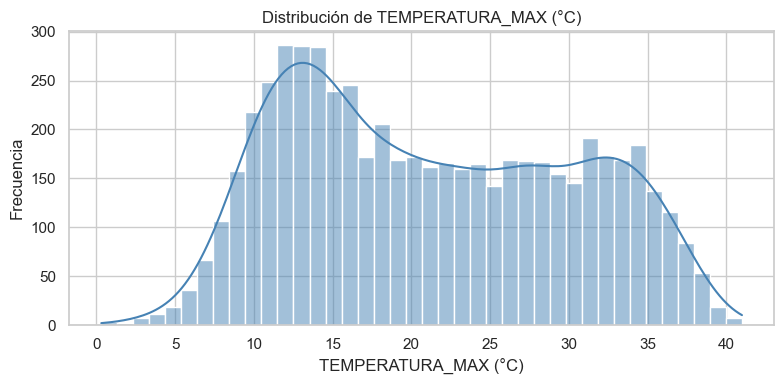

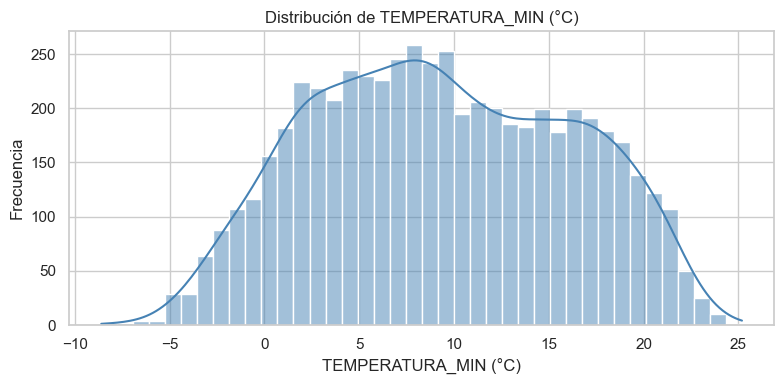

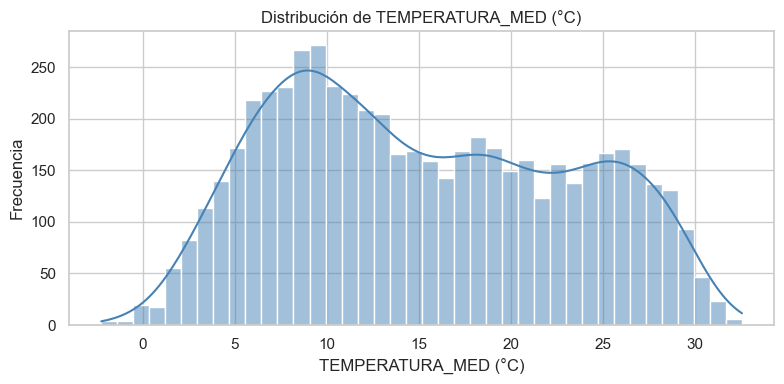

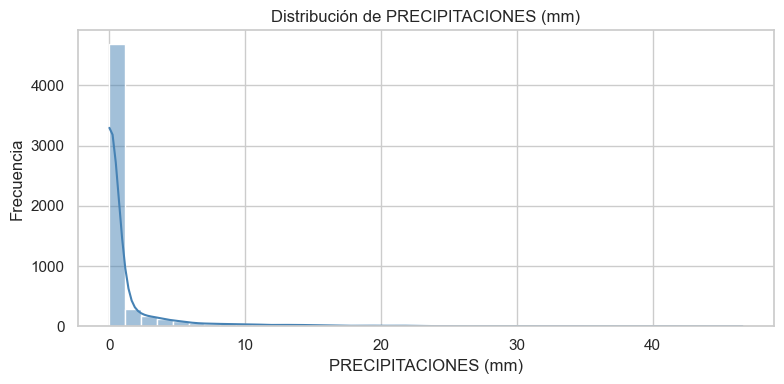

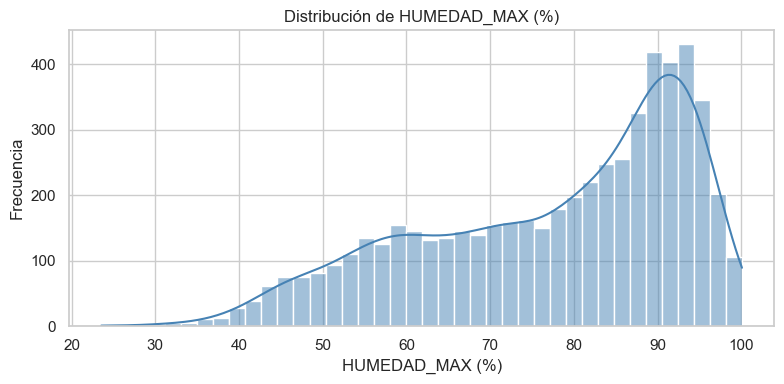

...

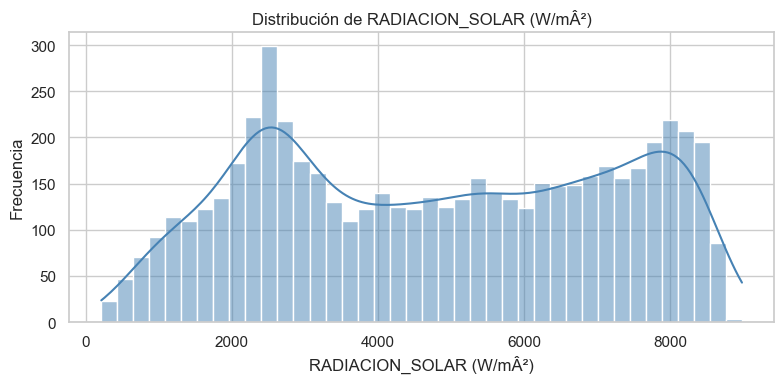

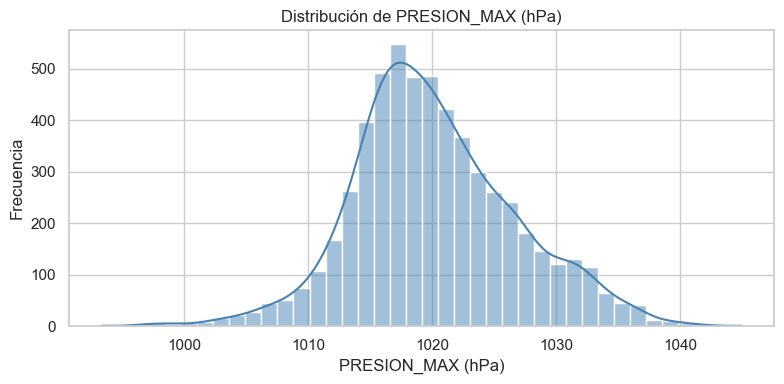

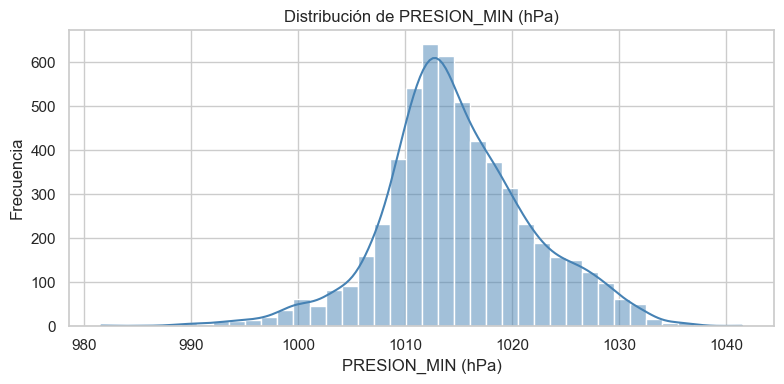

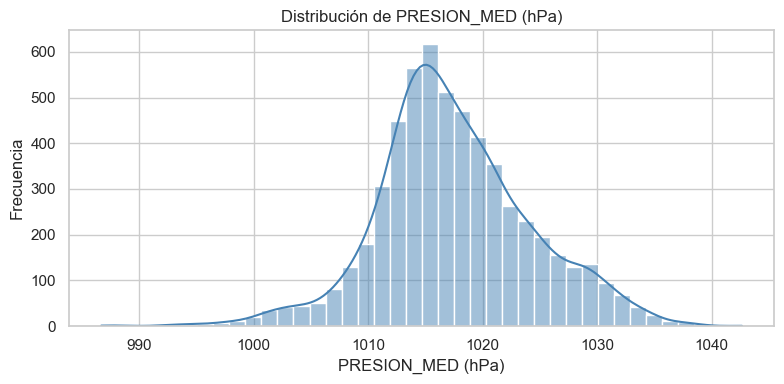

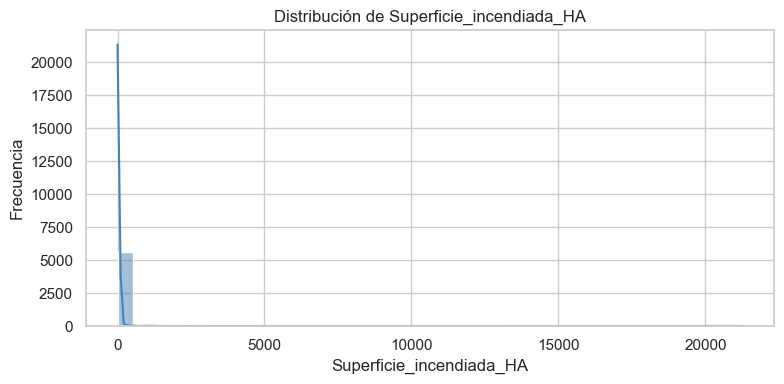

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


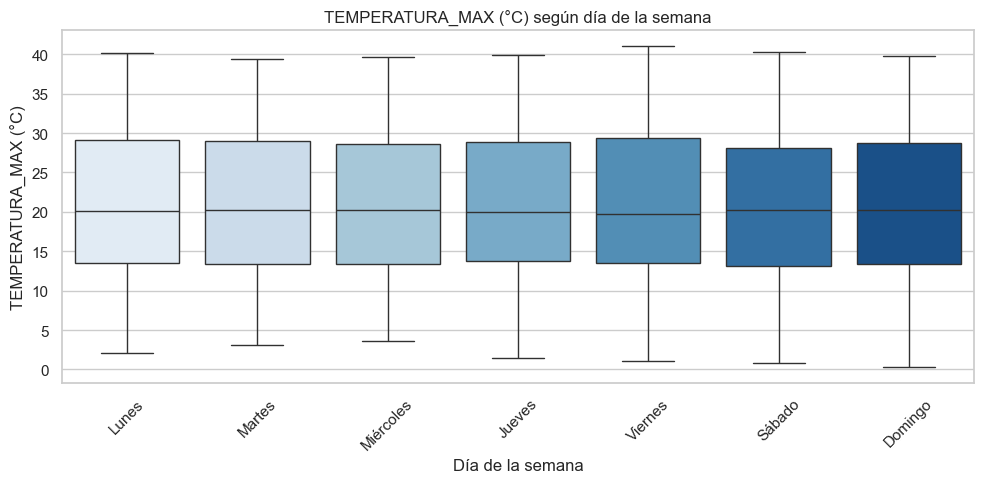

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


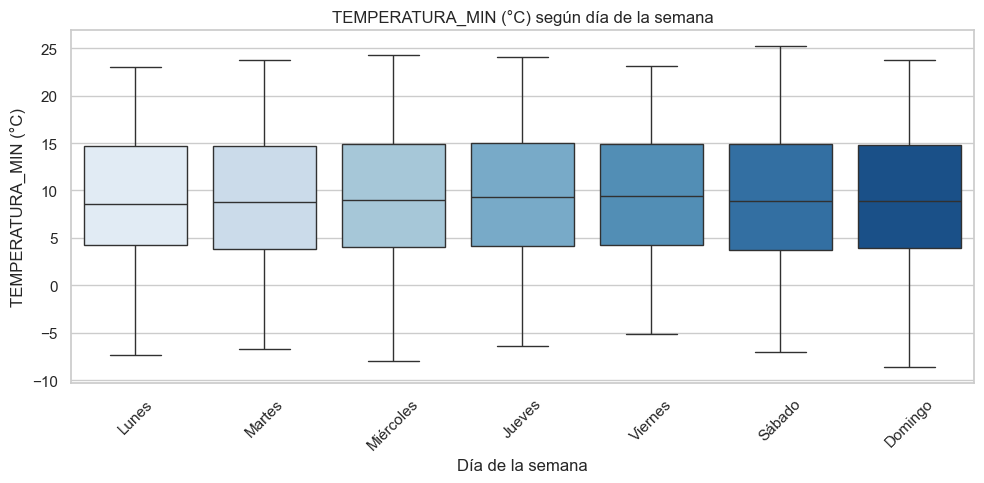

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


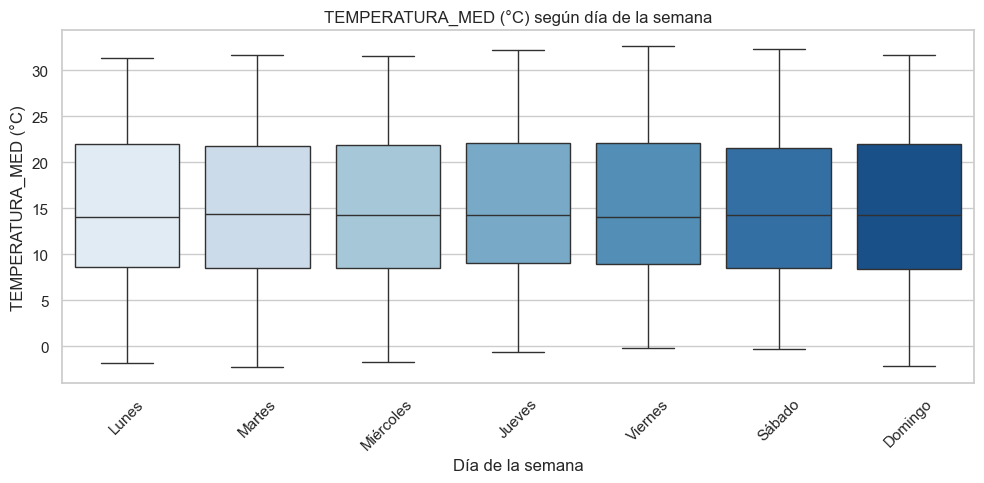

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


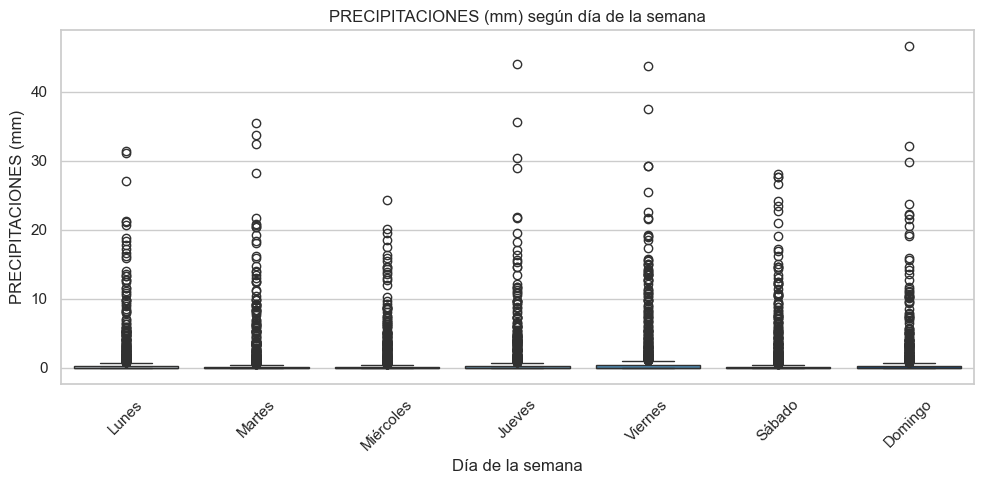

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


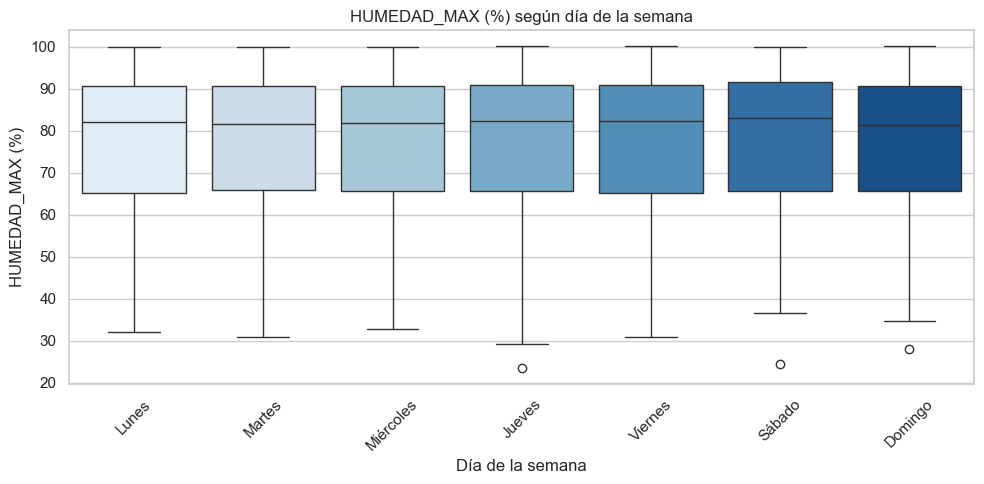

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


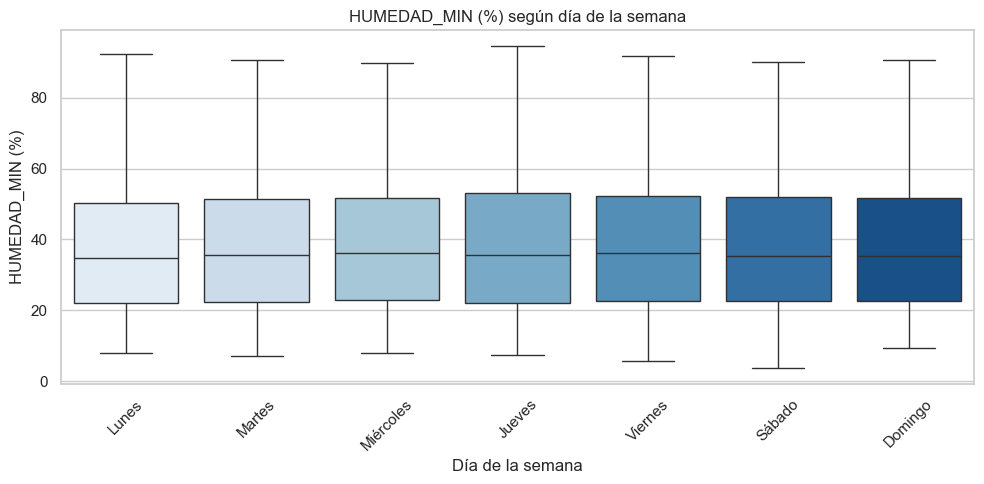

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


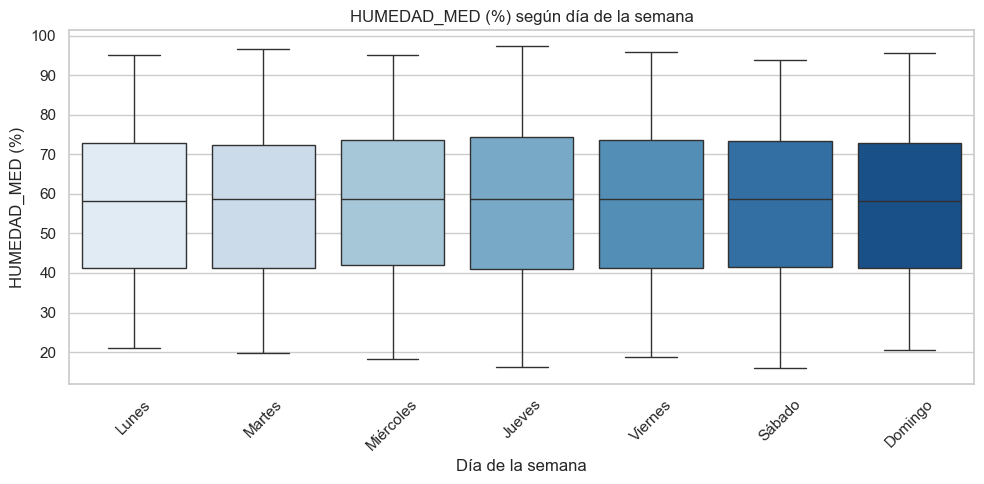

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


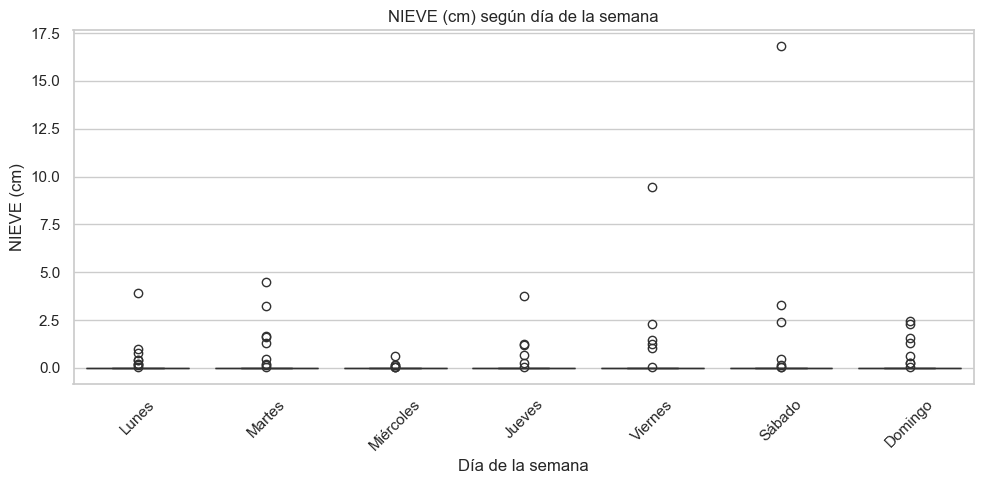

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


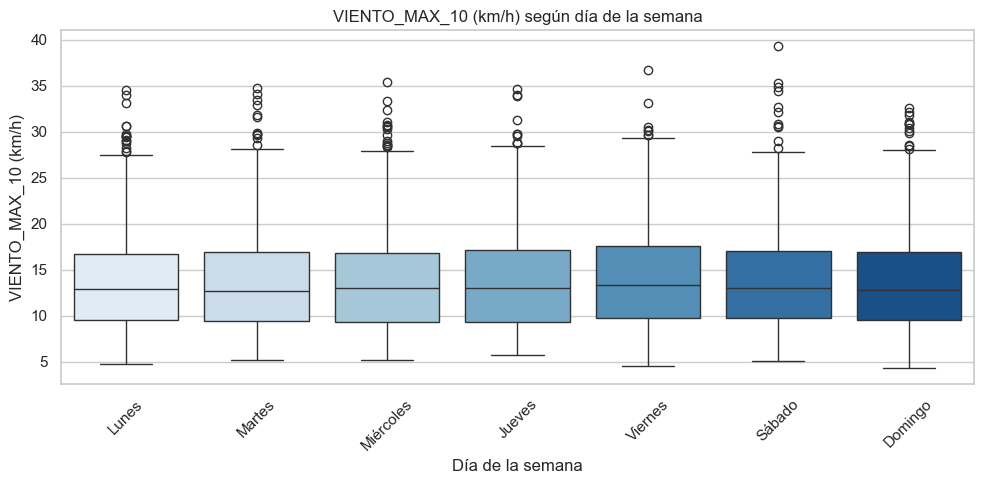

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


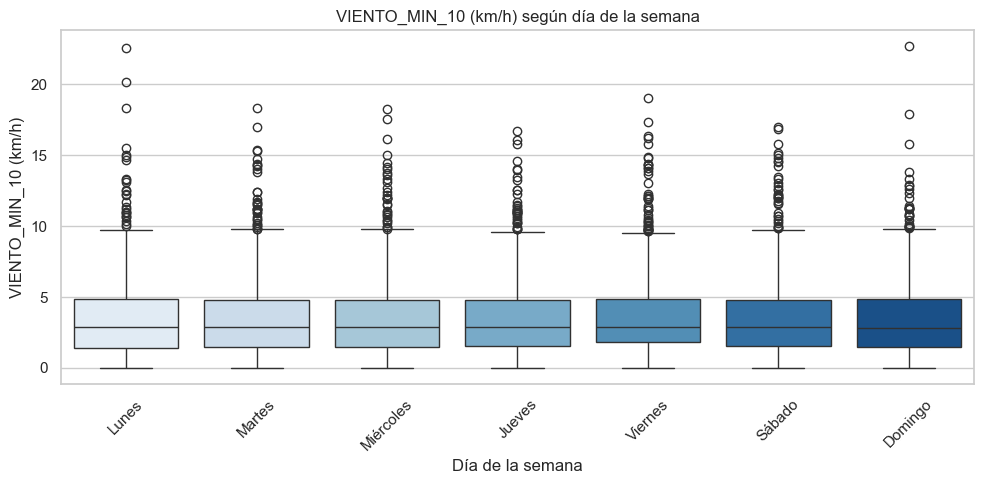

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


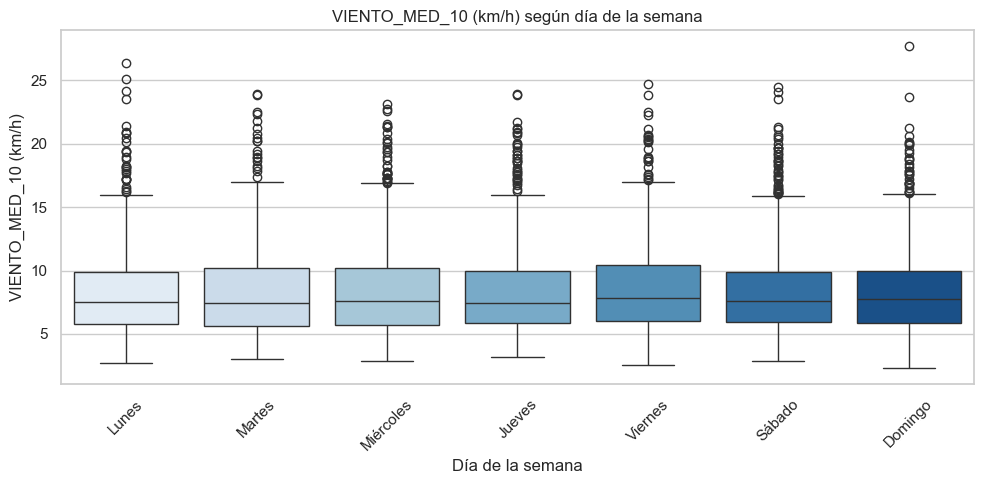

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


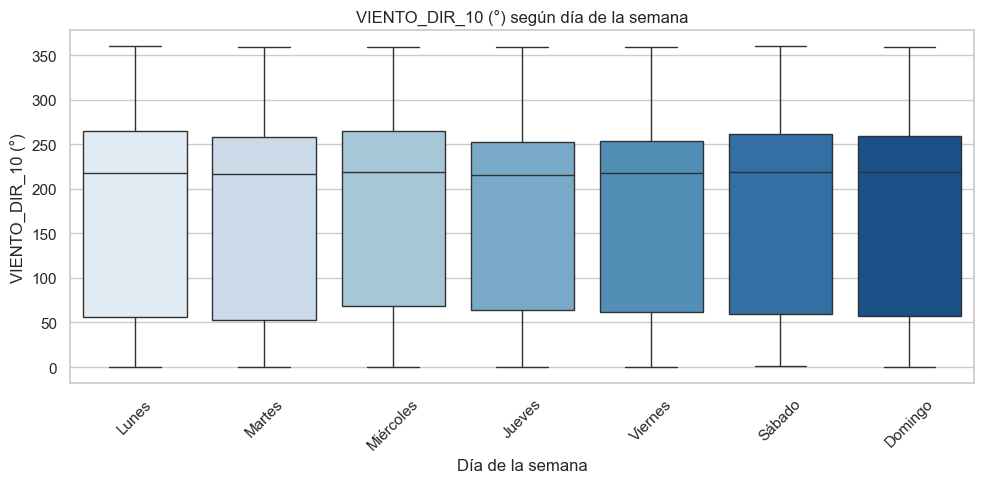

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


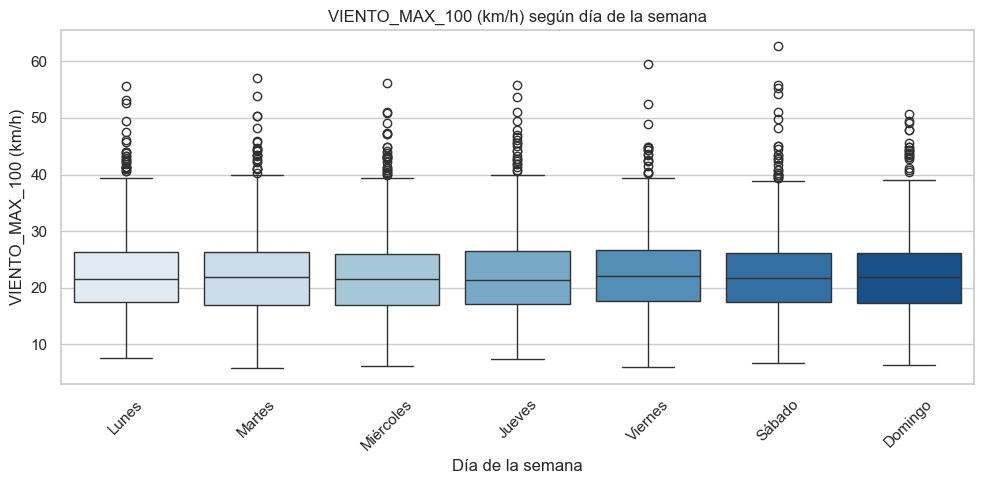

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


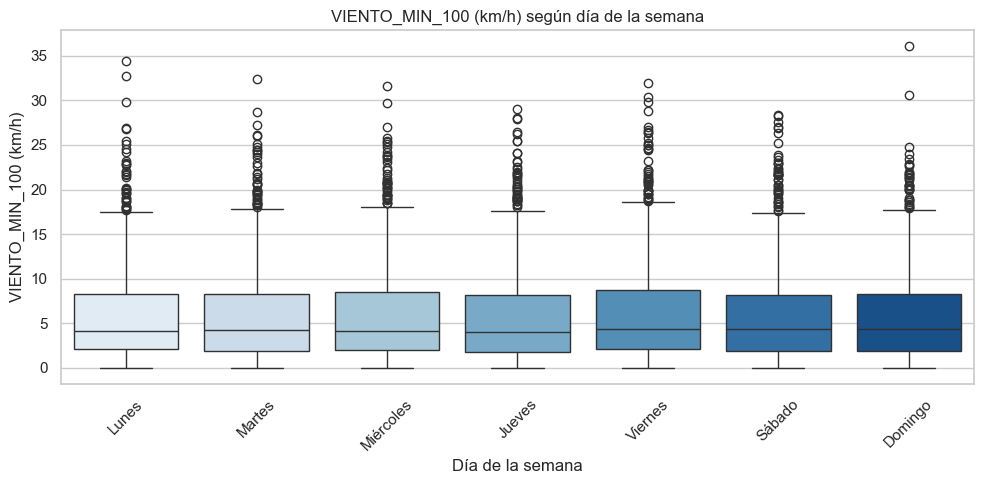

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


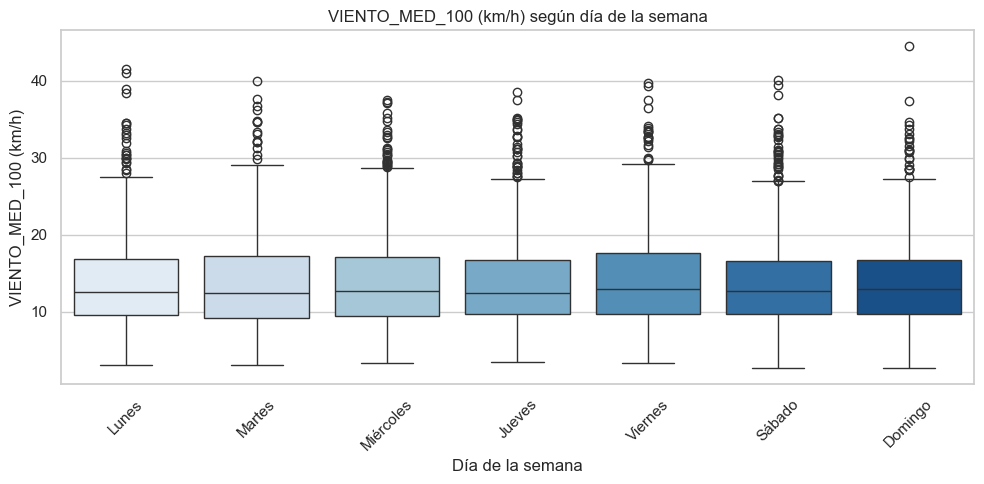

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


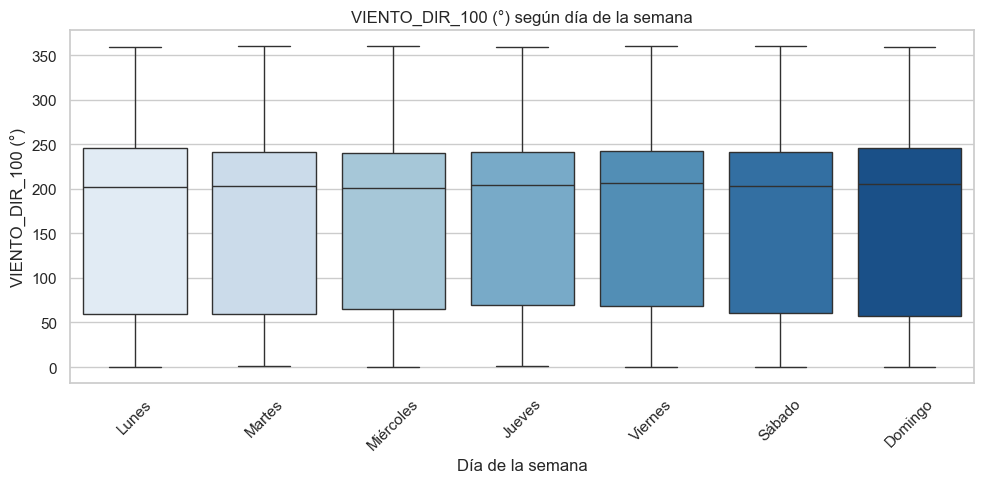

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


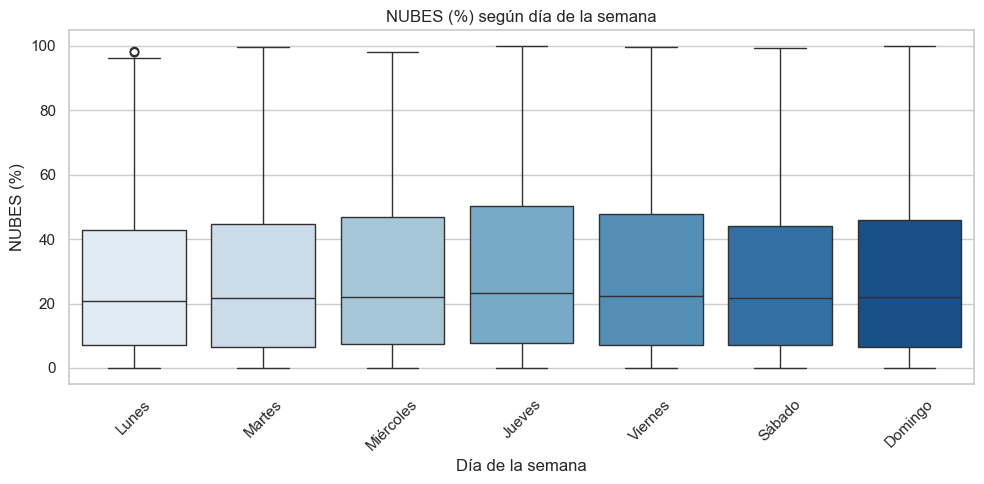

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


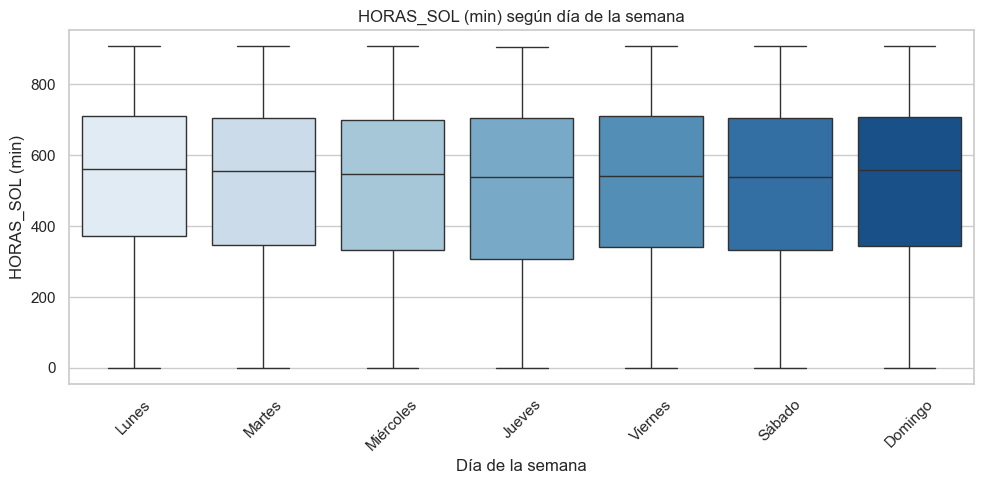

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


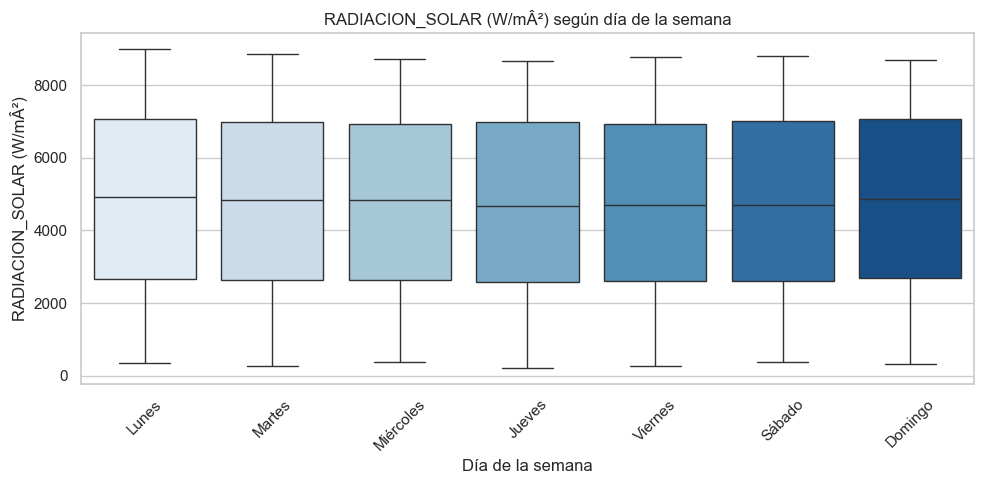

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


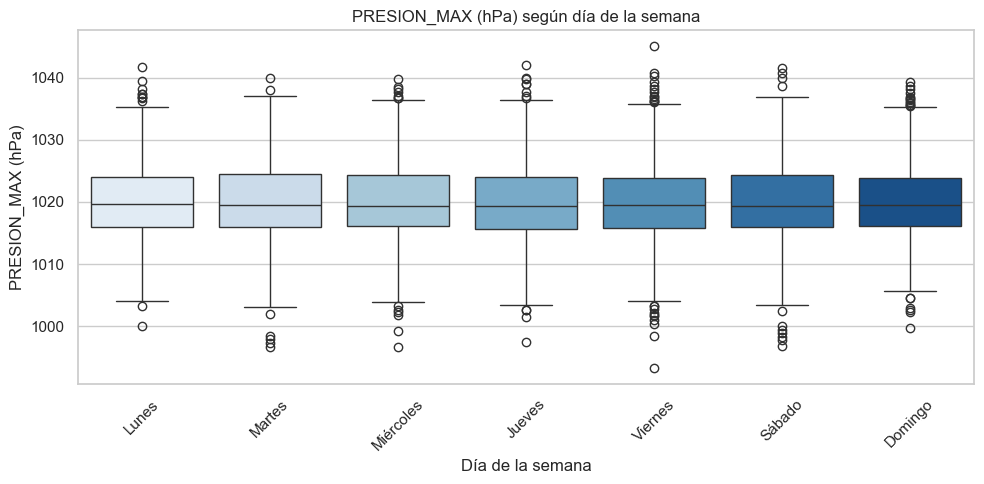

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


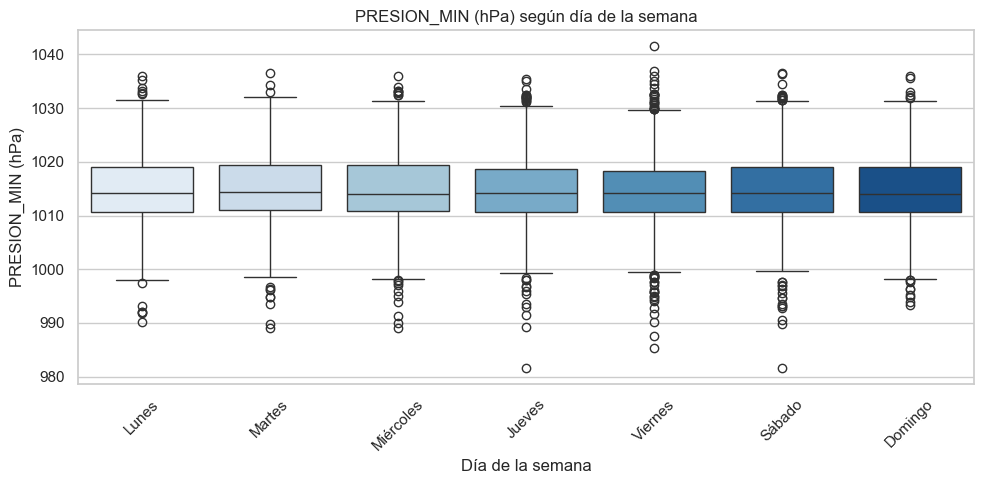

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


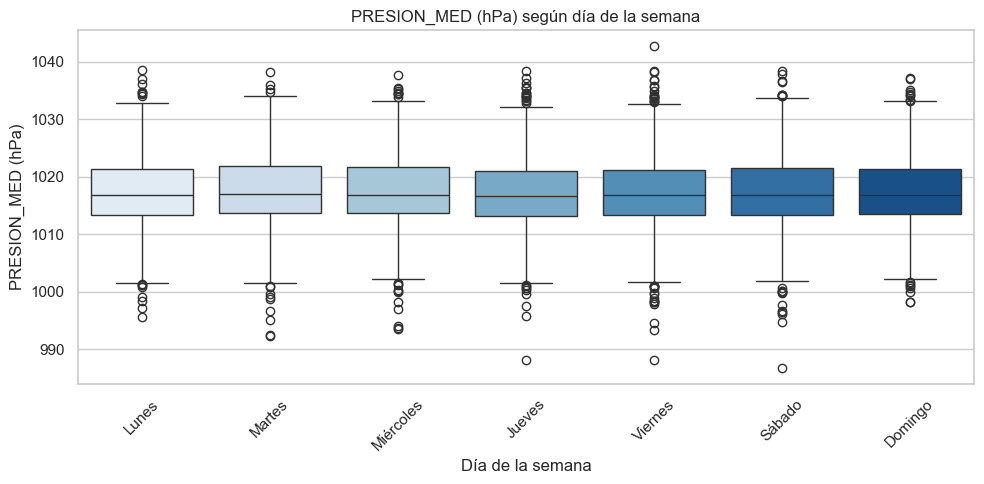

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:39: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")


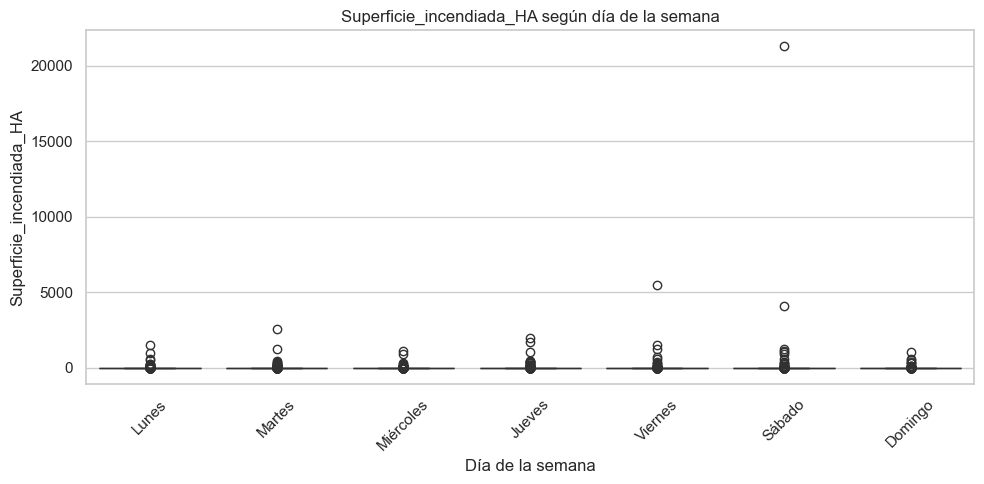

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


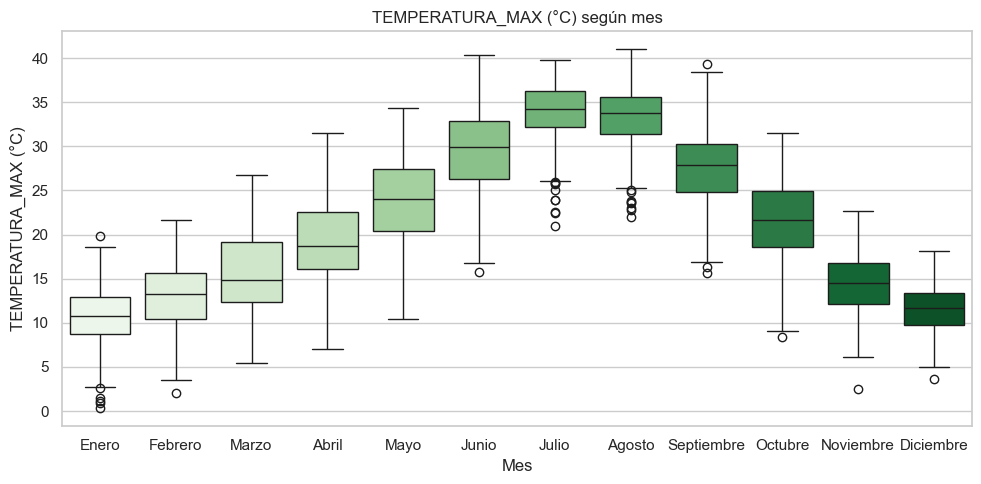

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


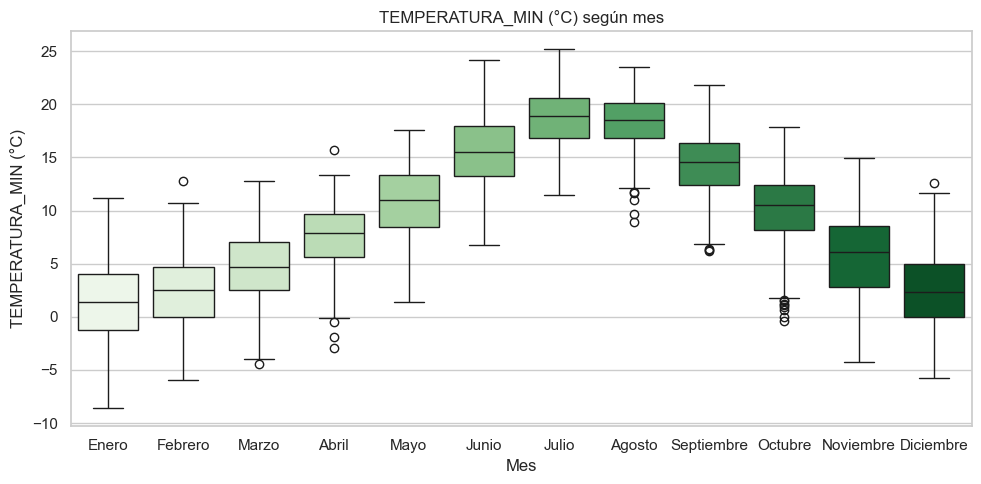

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


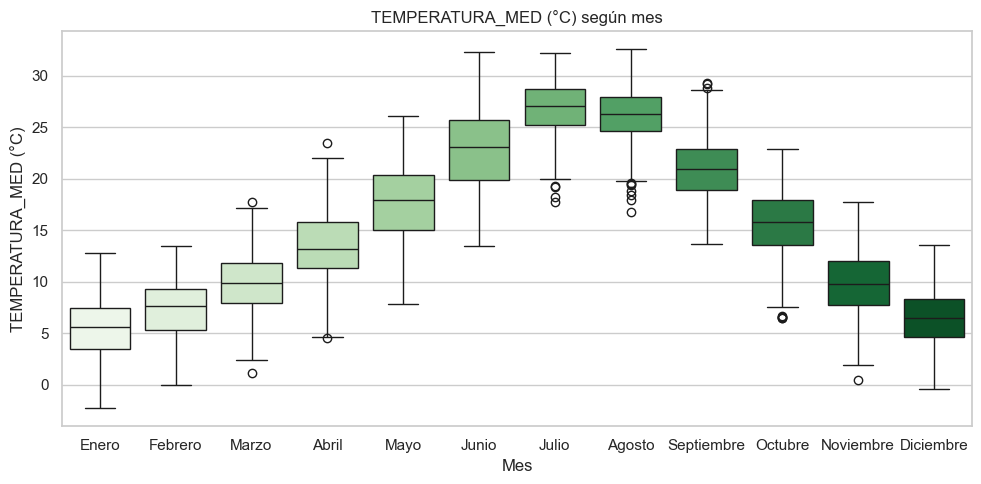

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


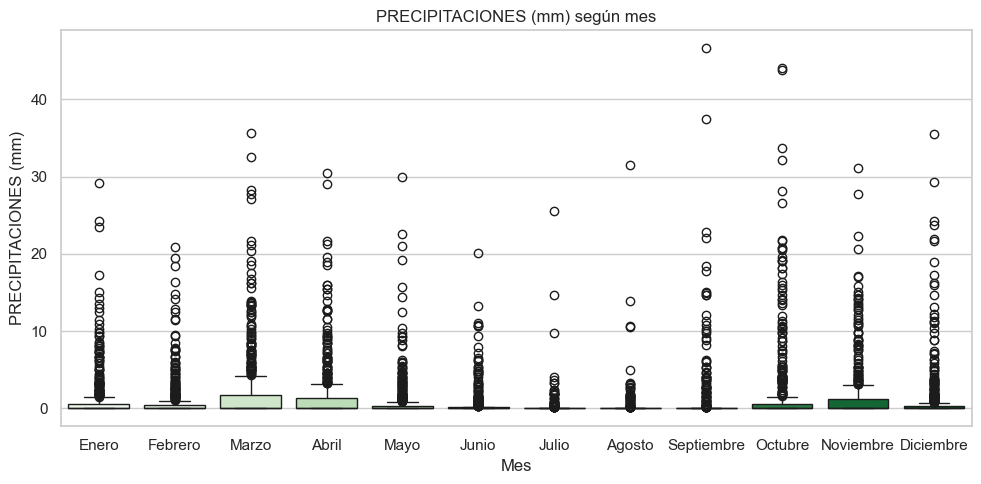

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


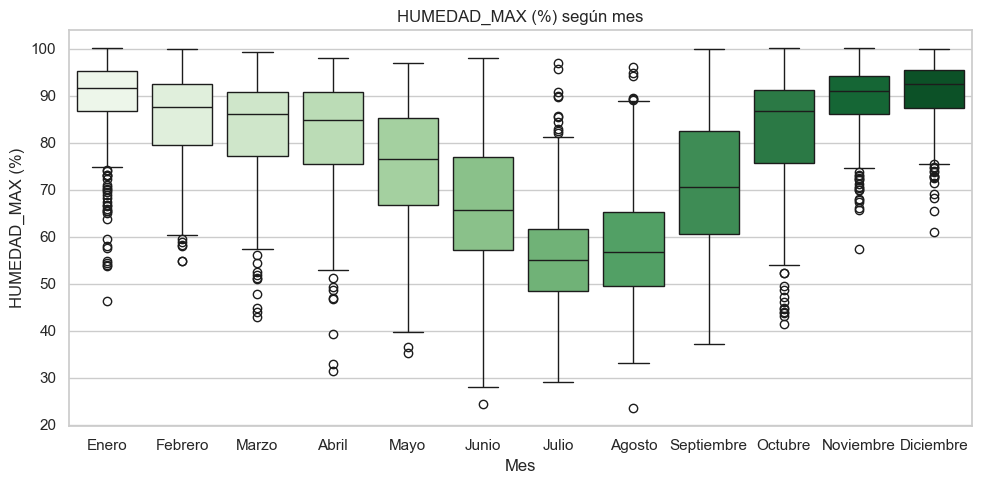

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


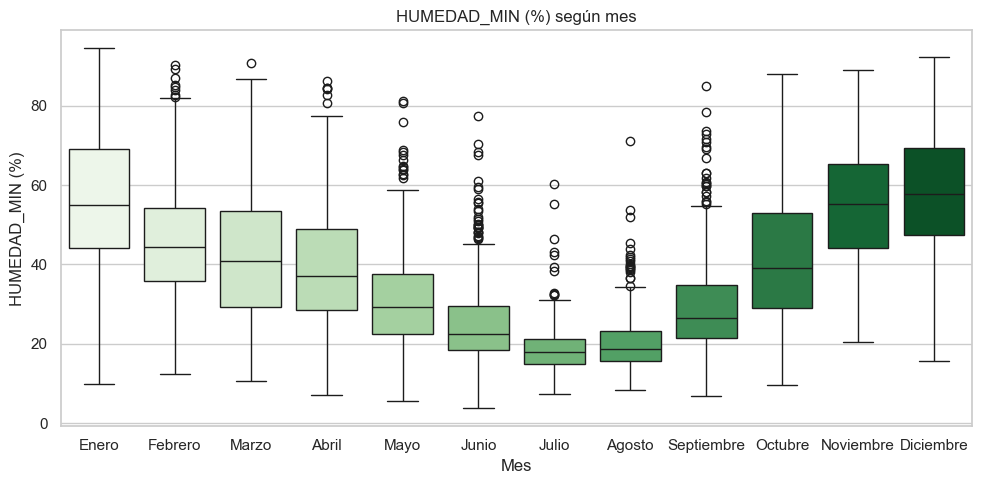

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


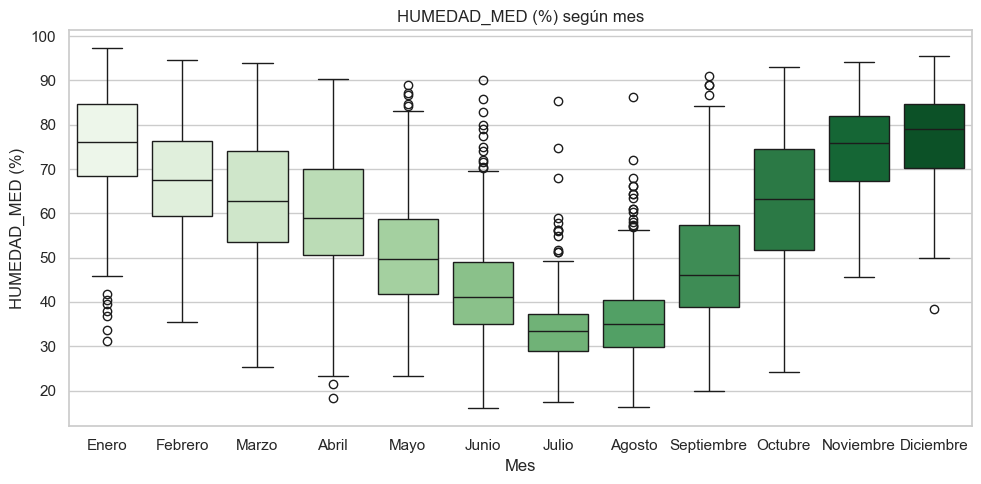

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


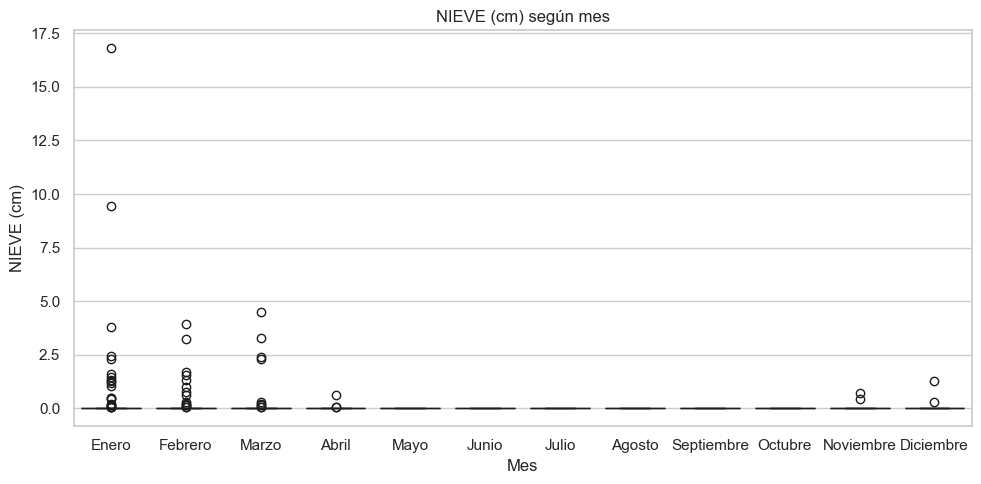

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


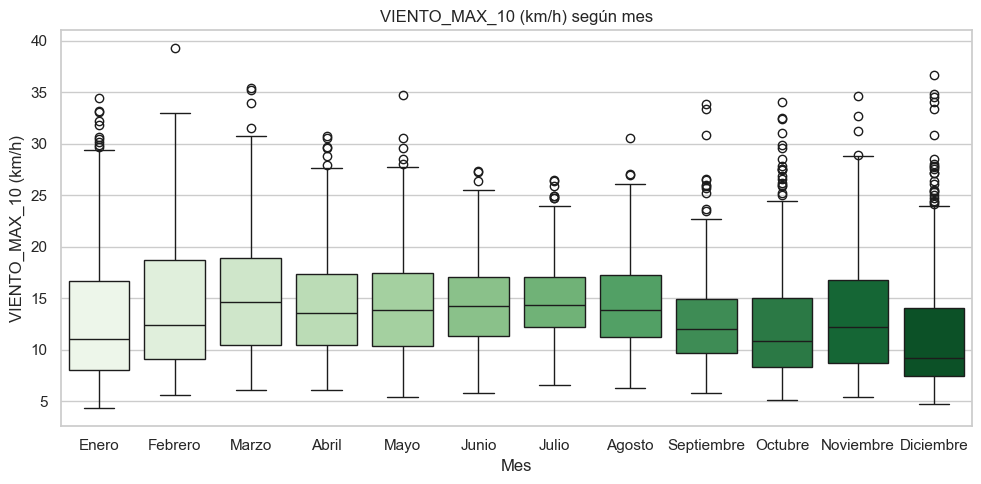

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


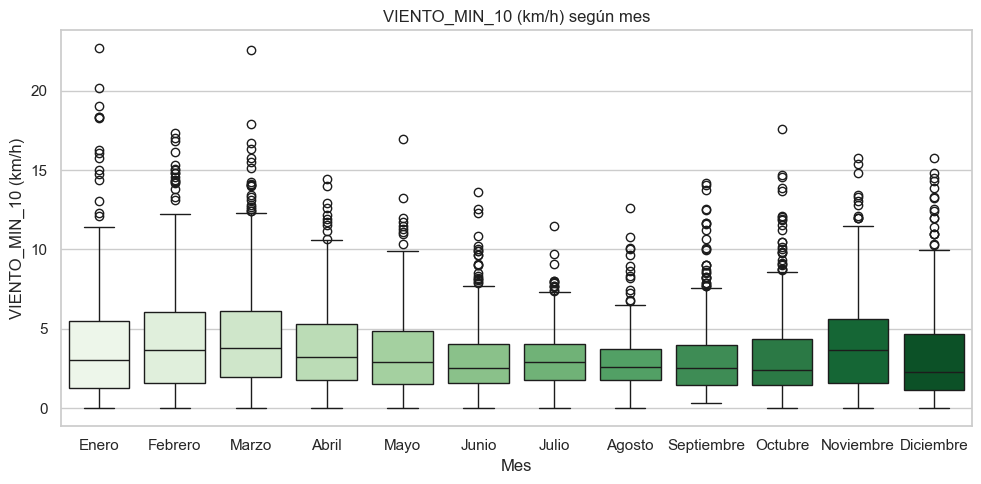

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


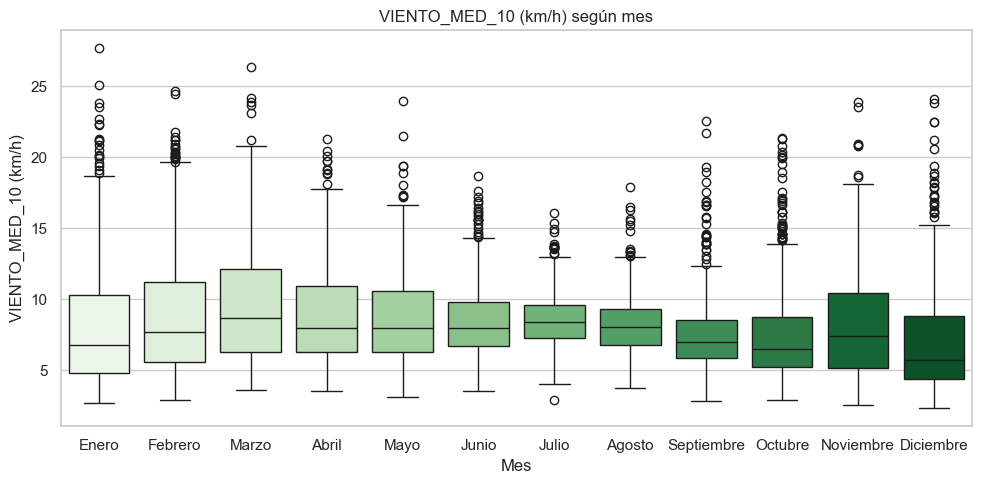

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


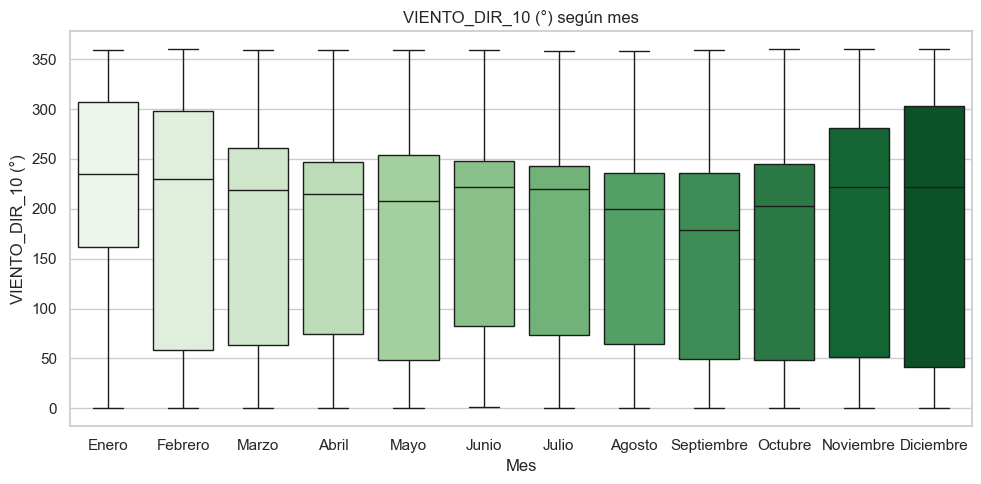

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


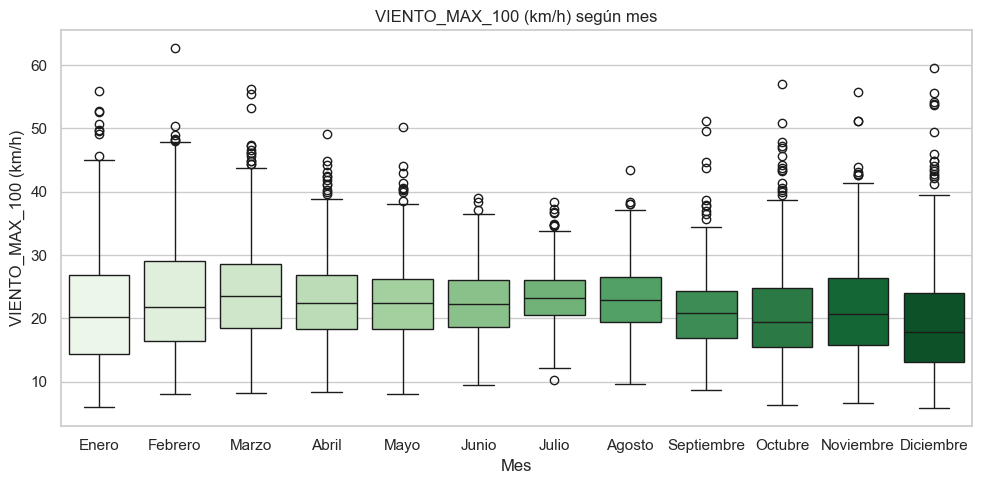

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


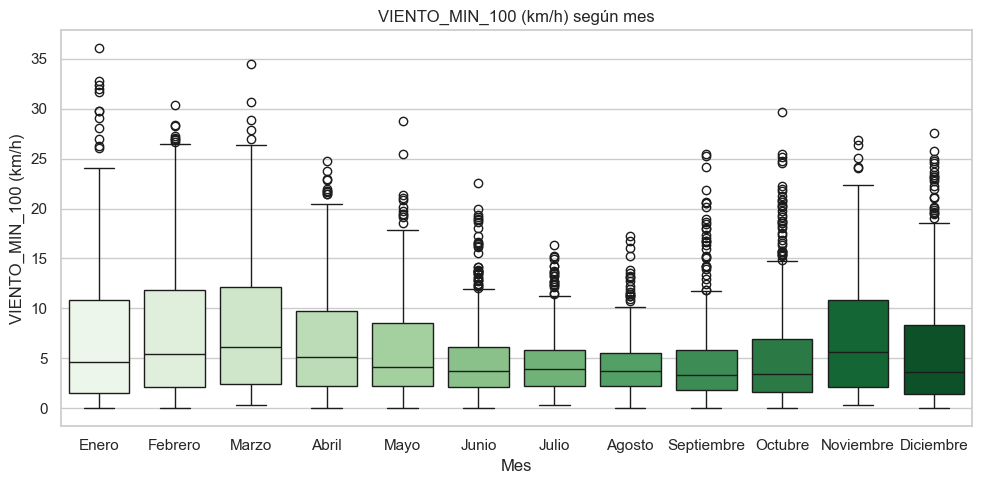

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


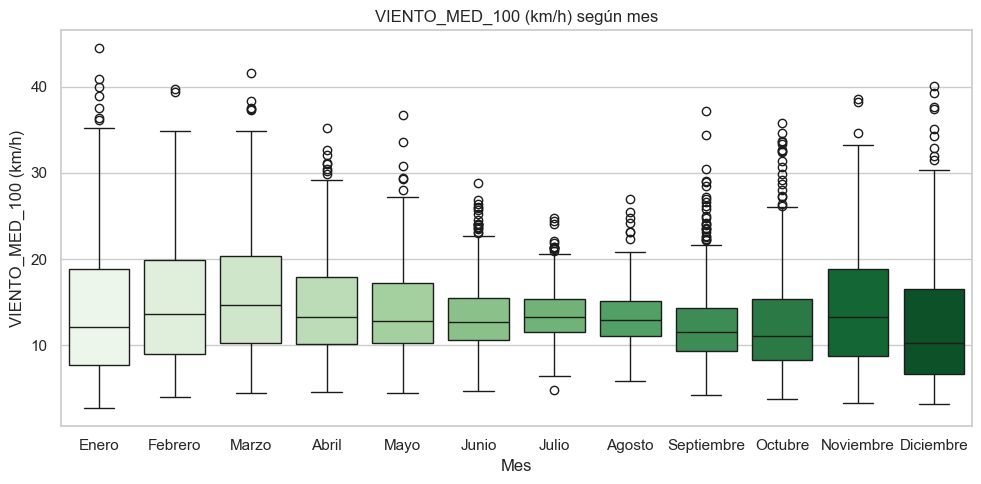

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


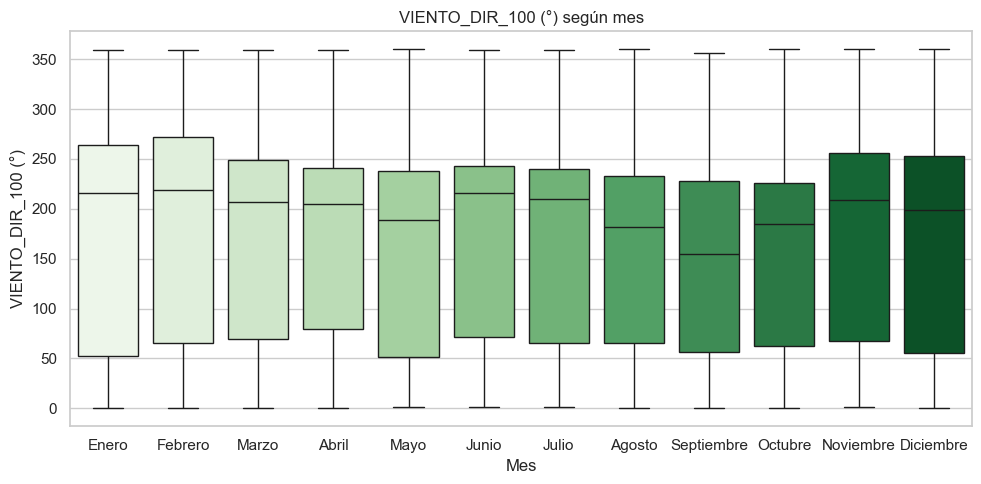

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


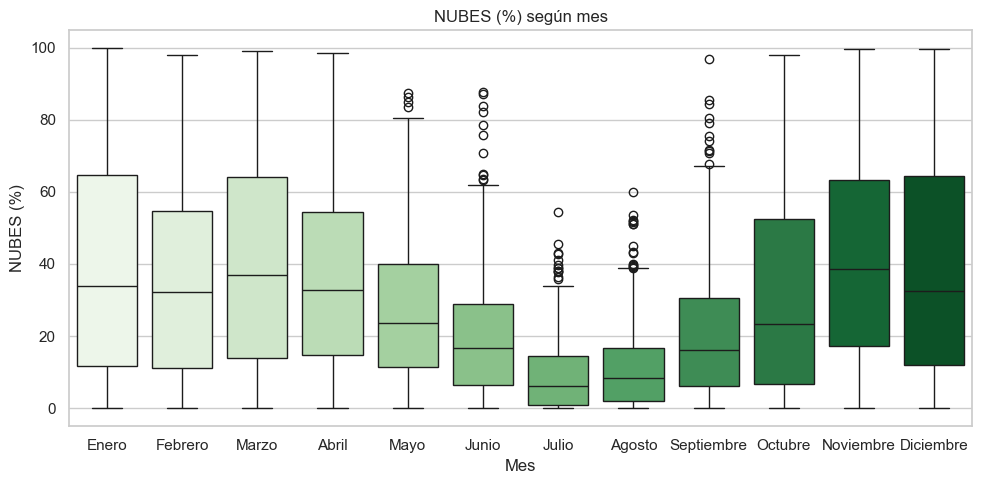

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


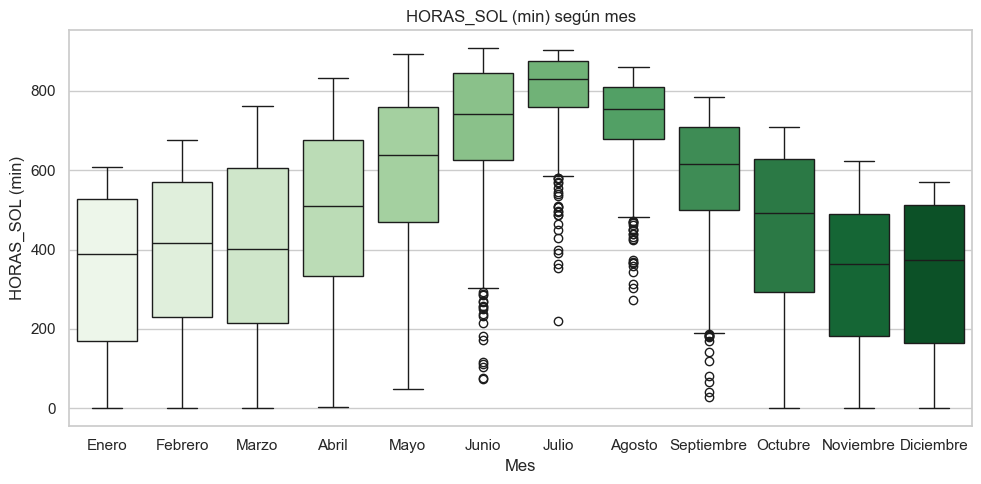

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


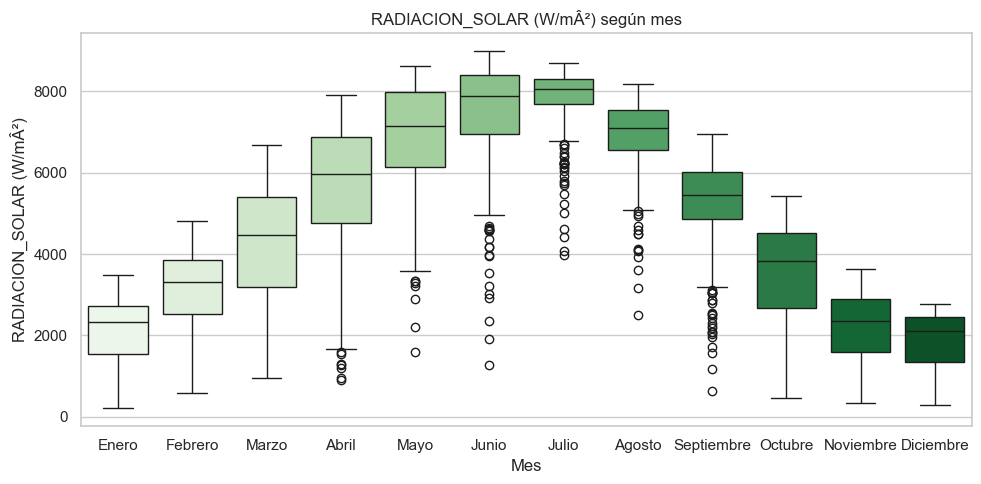

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


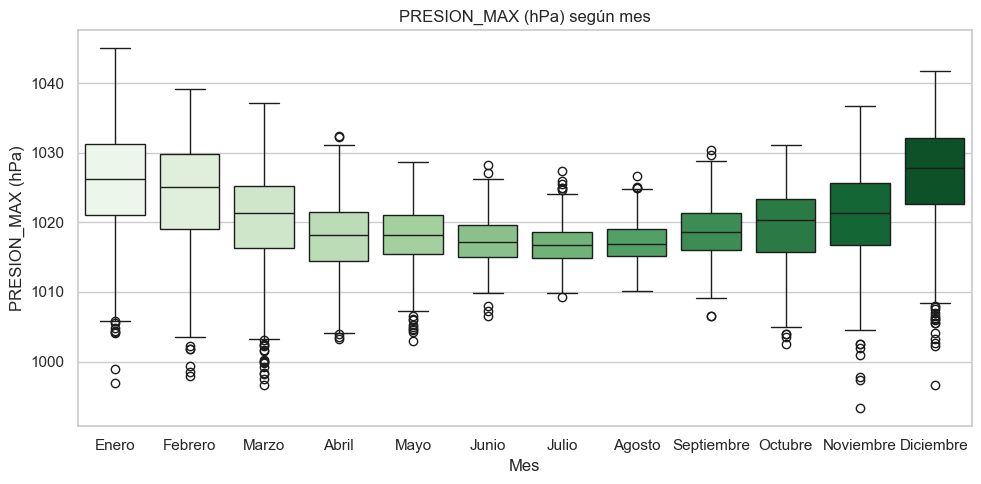

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


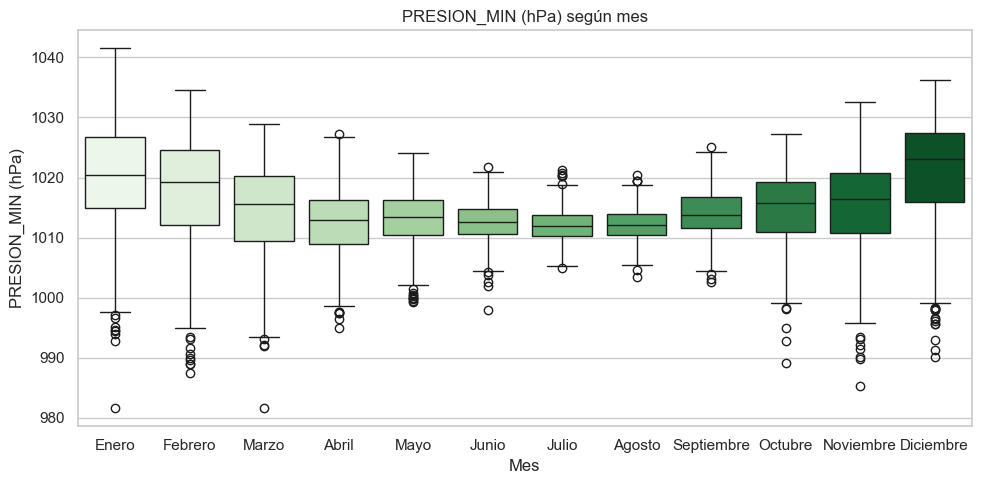

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


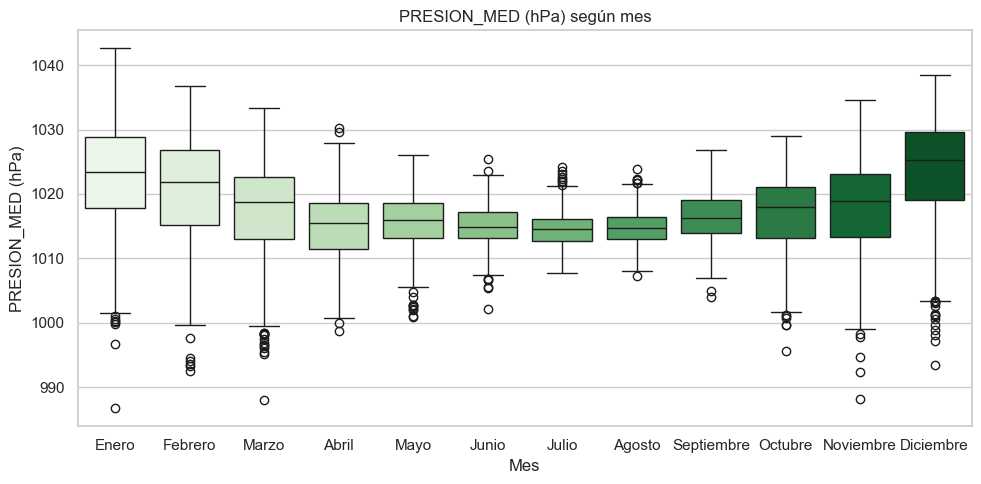

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:52: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")


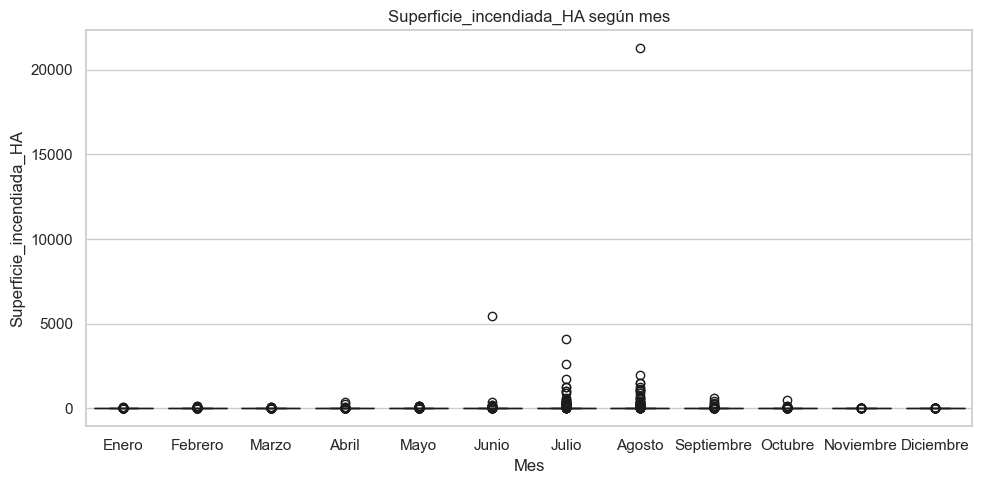

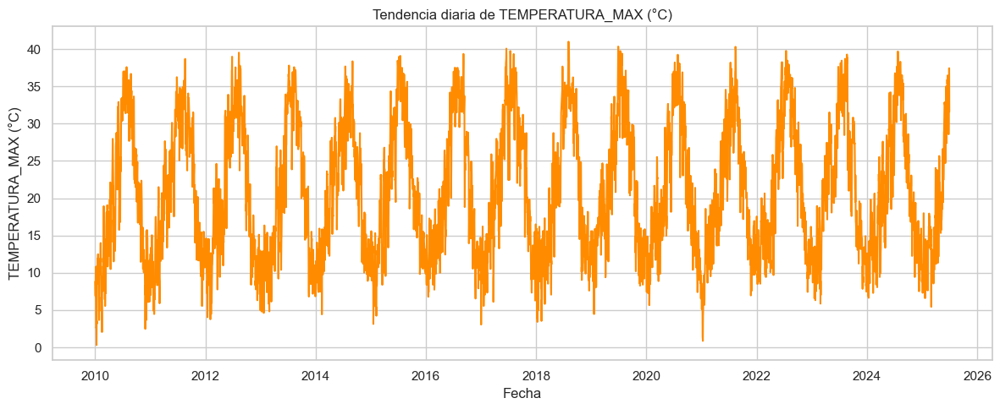

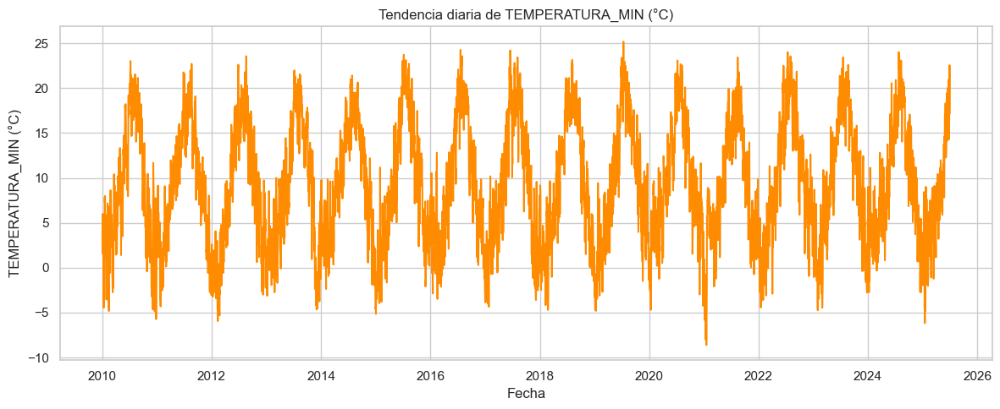

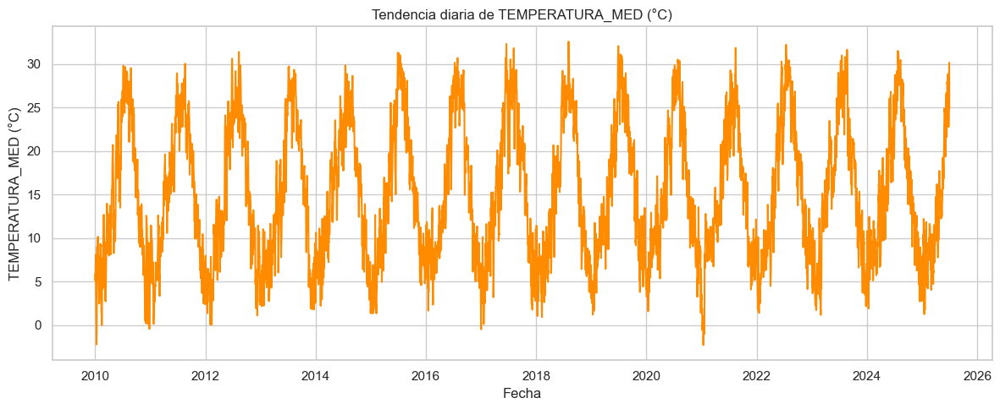

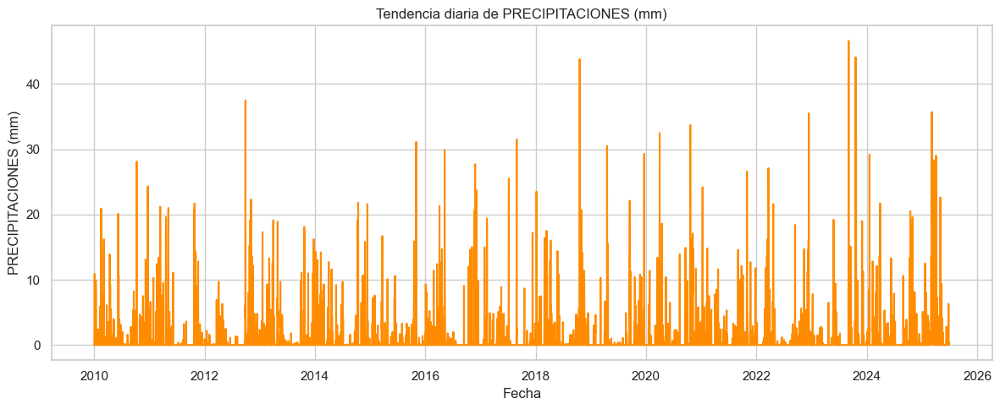

...

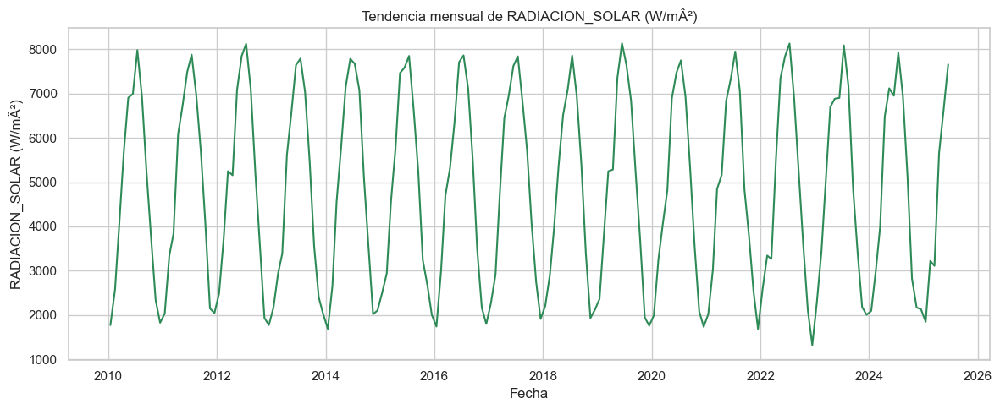

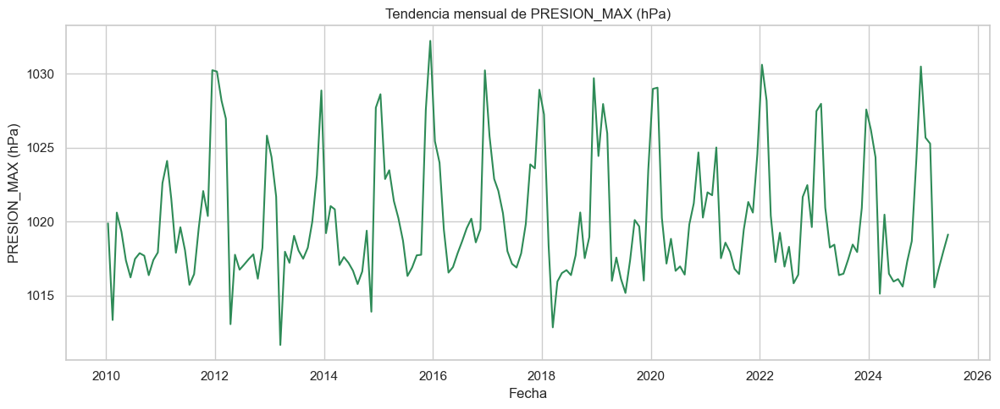

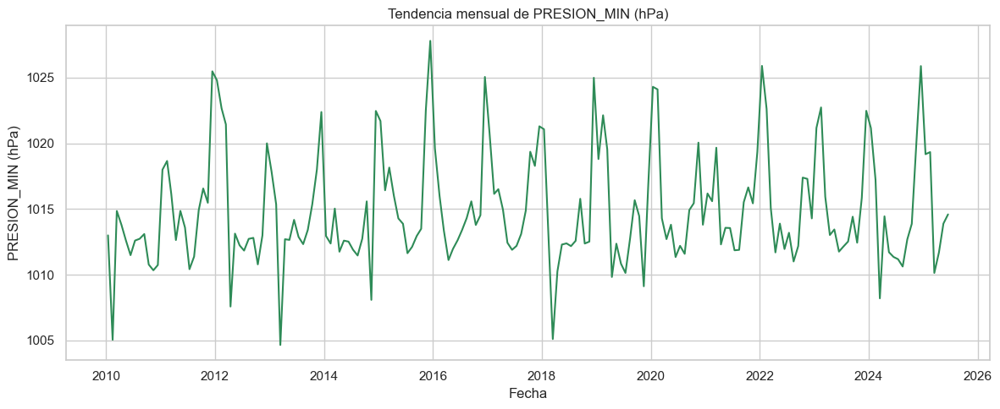

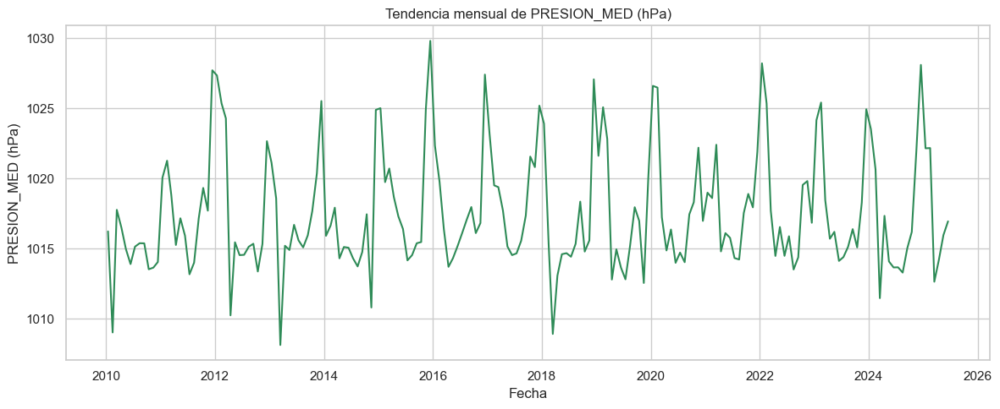

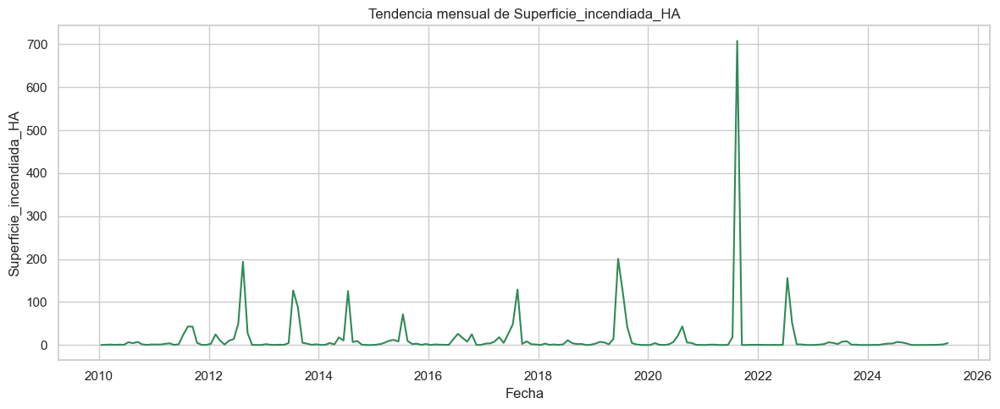

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\136012897.py:94: FutureWarning: Constructing PeriodIndex from fields is deprecated. Use PeriodIndex.from_fields instead.
  df_trim["fecha_trim"] = pd.PeriodIndex(


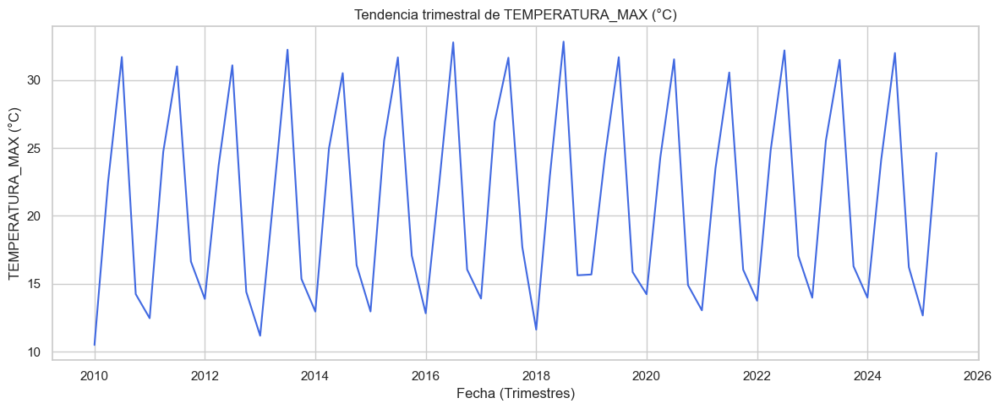

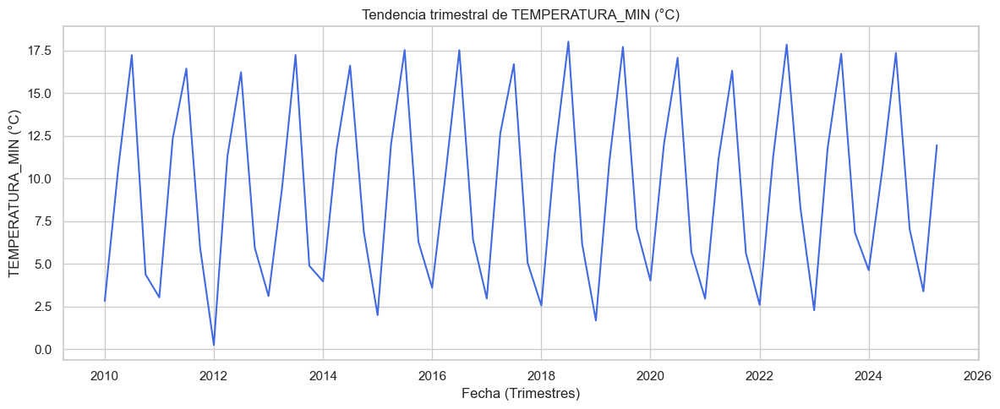

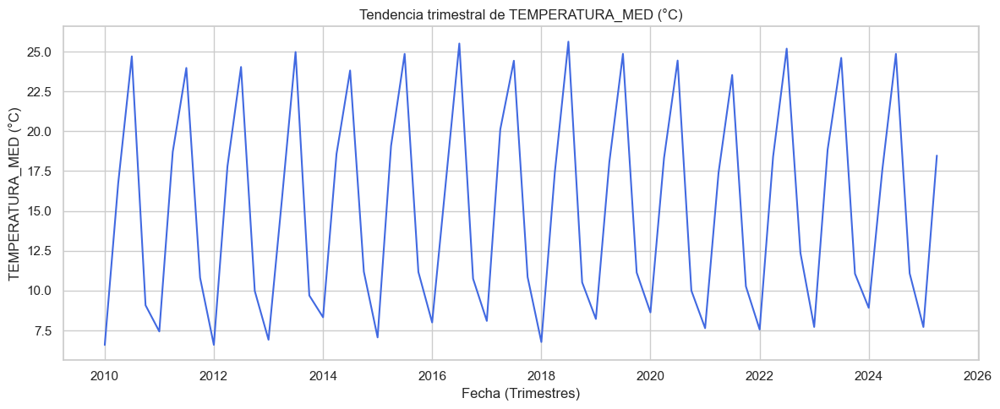

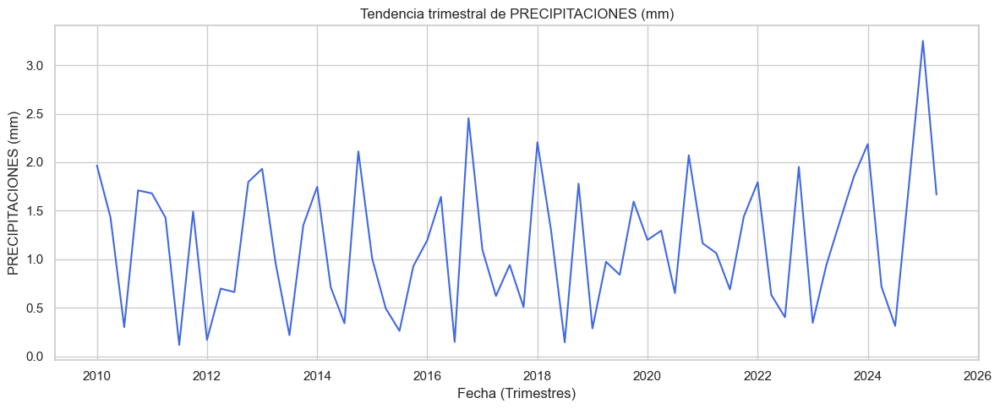

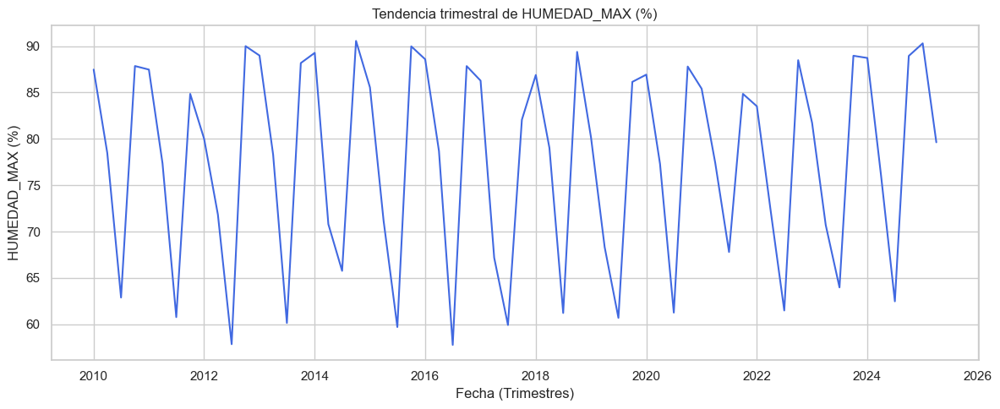

...

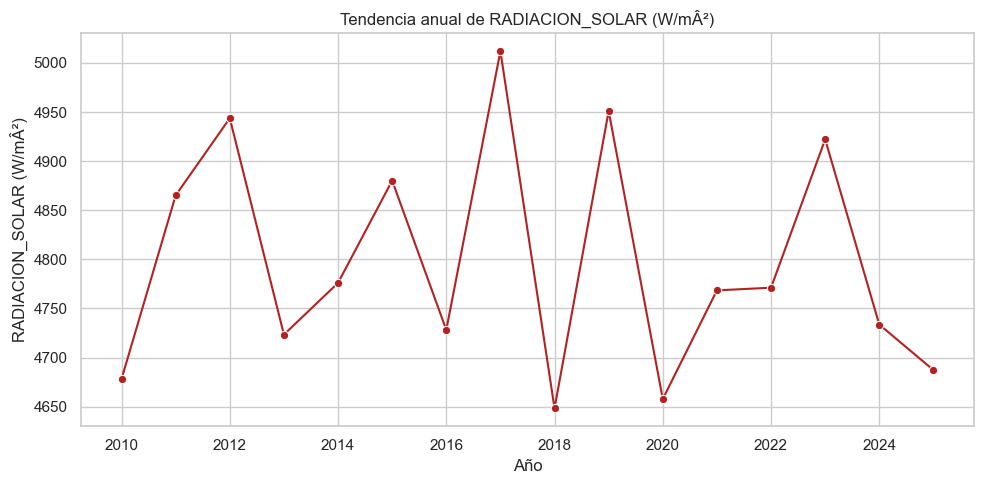

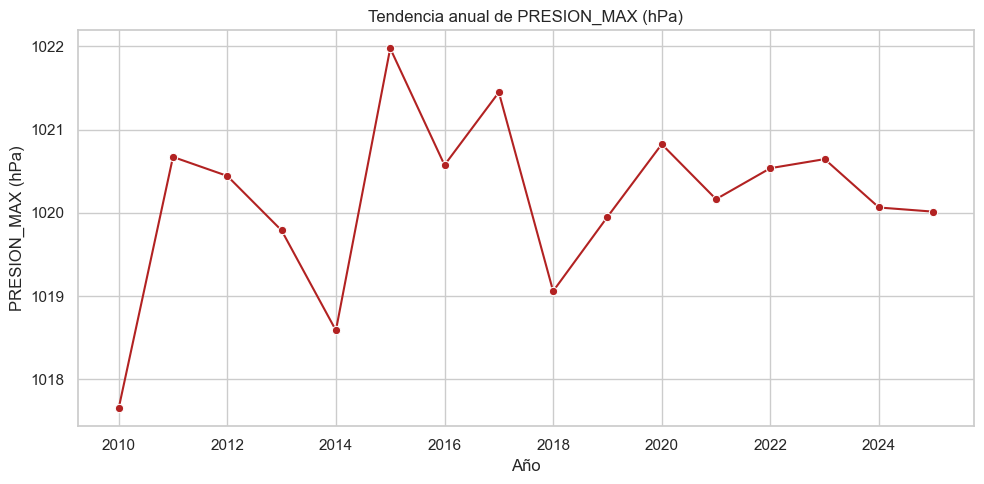

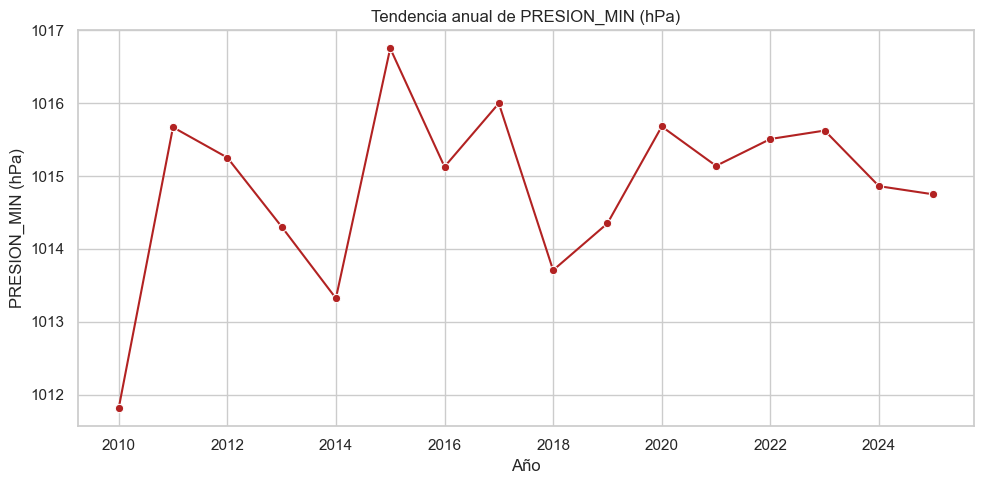

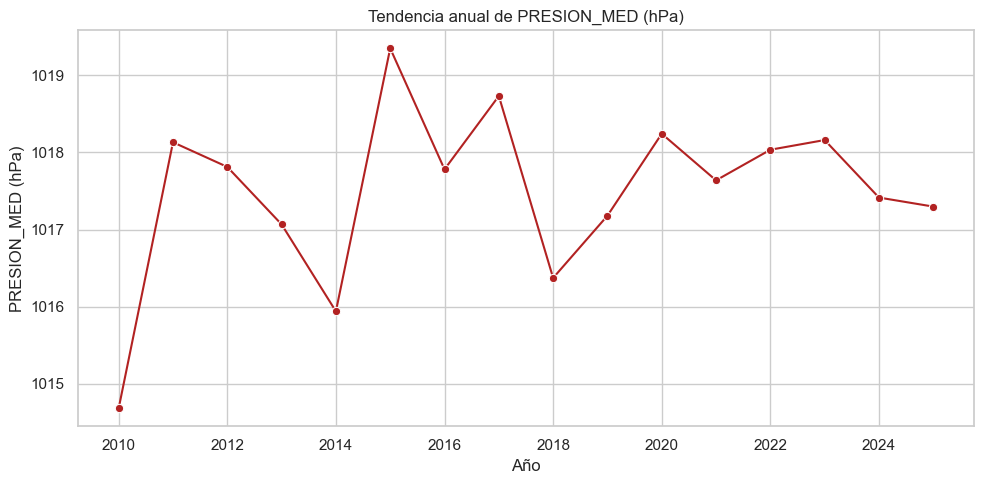

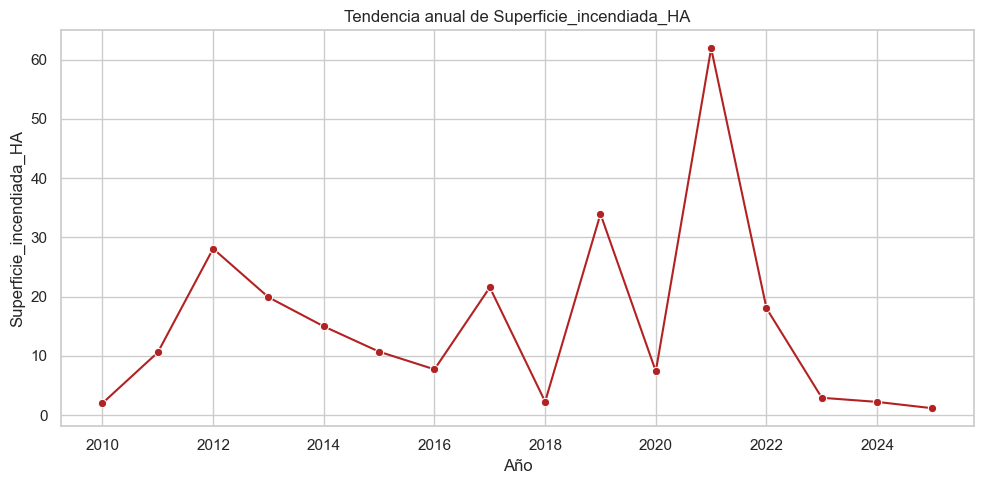

In [15]:
# =====================================================
# VISUALIZACIÓN EXPLORATORIA (MOSTRAR + GUARDAR EN CARPETA)
# =====================================================

sns.set_theme(style="whitegrid")

# Carpeta base para guardar gráficos
BASE_DIR = "06_figs_variables_ind"
os.makedirs(BASE_DIR, exist_ok=True)

# Subcarpetas por tipo de gráfico
subdirs = {
    "hist": os.path.join(BASE_DIR, "histogramas"),
    "box_dow": os.path.join(BASE_DIR, "box_dow"),
    "box_month": os.path.join(BASE_DIR, "box_month"),
    "ts_daily": os.path.join(BASE_DIR, "ts_diaria"),
    "ts_monthly": os.path.join(BASE_DIR, "ts_mensual"),
    "ts_quarterly": os.path.join(BASE_DIR, "ts_trimestral"),
    "ts_yearly": os.path.join(BASE_DIR, "ts_anual"),
}
for p in subdirs.values():
    os.makedirs(p, exist_ok=True)

# --------- HISTOGRAMAS ----------
for var in variables_ind:
    plt.figure(figsize=(8, 4))
    sns.histplot(df_diario[var], bins=40, kde=True, color="steelblue")
    plt.title(f"Distribución de {var}")
    plt.xlabel(var)
    plt.ylabel("Frecuencia")
    plt.tight_layout()
    fname = os.path.join(subdirs["hist"], f"{sanitize(var)}__hist.png")
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

# --------- BOXPLOTS por DÍA DE LA SEMANA ----------
for var in variables_ind:
    plt.figure(figsize=(10, 5))
    sns.boxplot(x="dow", y=var, data=df_diario, palette="Blues")
    plt.title(f"{var} según día de la semana")
    plt.xlabel("Día de la semana")
    plt.ylabel(var)
    plt.xticks(rotation=45)
    plt.tight_layout()
    fname = os.path.join(subdirs["box_dow"], f"{sanitize(var)}__box_dow.png")
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

# --------- BOXPLOTS por MES ----------
for var in variables_ind:
    plt.figure(figsize=(10, 5))
    sns.boxplot(x="month", y=var, data=df_diario, palette="Greens")
    plt.title(f"{var} según mes")
    plt.xlabel("Mes")
    plt.ylabel(var)
    plt.tight_layout()
    fname = os.path.join(subdirs["box_month"], f"{sanitize(var)}__box_month.png")
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

# --------- TENDENCIAS TEMPORALES ---------
# (1) Diaria
for var in variables_ind:
    plt.figure(figsize=(12, 5))
    sns.lineplot(x=COL_FECHA, y=var, data=df_diario, color="darkorange")
    plt.title(f"Tendencia diaria de {var}")
    plt.xlabel("Fecha")
    plt.ylabel(var)
    plt.tight_layout()
    fname = os.path.join(subdirs["ts_daily"], f"{sanitize(var)}__ts_diaria.png")
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

# (2) Mensual
df_diario["month_num"] = pd.to_datetime(df_diario[COL_FECHA]).dt.month
df_mensual = df_diario.groupby(["year", "month_num"])[variables_ind].mean().reset_index()
df_mensual["fecha_mensual"] = pd.to_datetime(
    df_mensual["year"].astype(str) + "-" + df_mensual["month_num"].astype(str) + "-15"
)

for var in variables_ind:
    plt.figure(figsize=(12, 5))
    sns.lineplot(x="fecha_mensual", y=var, data=df_mensual, color="seagreen")
    plt.title(f"Tendencia mensual de {var}")
    plt.xlabel("Fecha")
    plt.ylabel(var)
    plt.tight_layout()
    fname = os.path.join(subdirs["ts_monthly"], f"{sanitize(var)}__ts_mensual.png")
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

# (3) Trimestral
df_trim = df_diario.groupby(["year", "quarter"])[variables_ind].mean().reset_index()
df_trim["fecha_trim"] = pd.PeriodIndex(
    year=df_trim["year"], quarter=df_trim["quarter"], freq="Q"
).to_timestamp(how="start")

for var in variables_ind:
    plt.figure(figsize=(12, 5))
    sns.lineplot(x="fecha_trim", y=var, data=df_trim, color="royalblue")
    plt.title(f"Tendencia trimestral de {var}")
    plt.xlabel("Fecha (Trimestres)")
    plt.ylabel(var)
    plt.tight_layout()
    fname = os.path.join(subdirs["ts_quarterly"], f"{sanitize(var)}__ts_trimestral.png")
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

# (4) Anual
df_anual = df_diario.groupby("year")[variables_ind].mean().reset_index()

for var in variables_ind:
    plt.figure(figsize=(10, 5))
    sns.lineplot(x="year", y=var, data=df_anual, marker="o", color="firebrick")
    plt.title(f"Tendencia anual de {var}")
    plt.xlabel("Año")
    plt.ylabel(var)
    plt.tight_layout()
    fname = os.path.join(subdirs["ts_yearly"], f"{sanitize(var)}__ts_anual.png")
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()


In [16]:
fecha_max = df_diario.loc[df_diario["NIEVE (cm)"].idxmax(), "DIA/MES/ANO"]
print(fecha_max)

2021-01-09 00:00:00


In [17]:
fecha_max = df_diario.loc[df_diario["Superficie_incendiada_HA"].idxmax(), "DIA/MES/ANO"]
print(fecha_max)

2021-08-14 00:00:00


### CONCLUSIONES

En base a los resultados obtenido se han sacado las siguientes conclusiones para todas las variables explicativas, excepto para la variable referida al tráfico "TOTAL_HOR_EXT"

In [18]:
# 1) Leer la hoja "CONCLUSIONES"
df_conclusiones = pd.read_excel("89_Resumen_Climatico_2010_2025.xlsx", engine="openpyxl")

# 2) Limpieza suave de encabezados y strings
df_conclusiones.columns = df_conclusiones.columns.map(lambda c: str(c).strip())
for col in df_conclusiones.select_dtypes(include=["object"]).columns:
    df_conclusiones[col] = df_conclusiones[col].astype(str).str.strip()

# 3) Reemplazar '\\n' por saltos de línea reales '\n'
for col in df_conclusiones.select_dtypes(include=["object"]).columns:
    df_conclusiones[col] = df_conclusiones[col].str.replace(r"\\n", "\n", regex=True)

# 4) Mostrar tabla con saltos de línea visibles
pd.set_option('display.max_colwidth', None)
df_conclusiones.style.set_properties(**{'white-space': 'pre-wrap'})

,CATEGORÍA,VARIABLES CLAVES,TENDENCIA,CONCLUSIÓN
0,Temperatura,"Máxima, media, mínima",↑ Ascenso suave,Ligero aumento de las temperaturas
1,Presión atmosférica,"Máxima, media, mínima",→ Estabilidad general,"Estabilidad barométrica; altas presiónes en meses de invierno, bajas en verano"
2,Humedad relativa,"Mínima, media, máxima",→ Estabilidad general,Valores estables; humedad media con distribución claramente bimodal (concentración de dos rangos de valores)
3,Nubosidad,% de cobertura nubosa,→ Estabilidad general,"Distribución unimodal, sesgada a la derecha, con predominio de cielos despejados."
4,Radiación solar / insolación,"Radiación solar (Wh/m²), horas de sol (min)",→ Estabilidad general,"Distribución bimodal, con dos regímenes de radiación solar claramente diferenciados."
5,Precipitaciones,Precipitaciones,"↑ Incremento desde 2021, aunque irregular","Alternancia entre sequías y lluvias torrenciales; Mayor frecuencia en meses de marzo, abril y noviembre"
6,Nieve,Nieve,"≈ Díficil conclusion, picos extremos ocasionales",Destaca un evento en enero 2021 --> Filomena
7,Viento (10 m),"Velocidad máx, min, media y dirección",→ Estable; eventos extremos puntuales; predominio dirección sur,Circulación atmosférica constante; ráfagas >35 km/h ocasionales (valores máximos); Viento del suroeste predominante
8,Viento (100 m),"Velocidad máx, min, media y dirección",→ Estable; predominio dirección sur,Viento del suroeste predominante
9,Superficie incendiada,Superficie incendiada,"≈ Díficil conclusion, picos extremos ocasionales",Menor recurrencia de incendios extensos; riesgo asociado a condiciones locales secas o ventosas; Destaca evento en 2021


## VARIABLE TRÁFICO - TOTAL_HOR_EXT

### DATOS ESTADÍSTICOS

In [19]:
COL_FECHA = "DIA/MES/ANO"
ZONA = "ZONA_ESTACION"
variable_traf = "TOTAL_HOR_EXT"

# ------------------------------------------------------------------
# 1. Asegurar formato de fecha en df_orig
# ------------------------------------------------------------------
df_orig[COL_FECHA] = pd.to_datetime(df_orig[COL_FECHA], errors="coerce")
if df_orig[COL_FECHA].isna().any():
    df_orig[COL_FECHA] = pd.to_datetime(df_orig[COL_FECHA], errors="coerce", dayfirst=True)

# ------------------------------------------------------------------
# 2. Agrupación DIARIA POR ZONA (media diaria de tráfico)
#    -> un valor por (día, zona)
# ------------------------------------------------------------------
df_diario_zona = (
    df_orig
      .groupby([ZONA, df_orig[COL_FECHA].dt.floor("D")], observed=True)[variable_traf]
      .mean()
      .reset_index()
      .rename(columns={COL_FECHA: COL_FECHA, variable_traf: variable_traf})
)

# renombrar bien la columna de fecha por si el groupby le ha puesto un nombre raro
df_diario_zona.rename(columns={df_diario_zona.columns[1]: COL_FECHA}, inplace=True)

# ------------------------------------------------------------------
# 3. Variables temporales derivadas (year, month, quarter, dow)
# ------------------------------------------------------------------

df_diario_zona["year"]    = df_diario_zona[COL_FECHA].dt.year
df_diario_zona["month"]   = df_diario_zona[COL_FECHA].dt.month
df_diario_zona["month"] = pd.Categorical(df_diario_zona["month"])
df_diario_zona["month"] = df_diario_zona["month"].cat.rename_categories(meses)
df_diario_zona["quarter"] = df_diario_zona[COL_FECHA].dt.quarter
df_diario_zona["dow"]     = df_diario_zona[COL_FECHA].dt.dayofweek

# ------------------------------------------------------------------
# 4. Estadísticos globales por zona sobre la serie diaria agregada
#    (media diaria de TOTAL_HOR_EXT)
# ------------------------------------------------------------------
stats_por_zona = (
    df_diario_zona
      .groupby(ZONA, observed=True)[variable_traf]
      .describe()
)

# añadimos NA por zona (cuántos días sin dato después de la agregación)
na_series = (
    df_diario_zona
      .groupby(ZONA, observed=True)[variable_traf]
      .apply(lambda x: x.isna().sum())
      .astype(int)
)

stats_por_zona["na"] = na_series

# ------------------------------------------------------------------
# 5. Redondeo a entero porque hablamos de nº de vehículos
# ------------------------------------------------------------------
stats_por_zona = stats_por_zona.round(0).astype(int)

# ------------------------------------------------------------------
# 6. Mostrar en el mismo formato que antes
# ------------------------------------------------------------------
cols_orden = ["count", "na", "mean", "std", "min", "25%", "50%", "75%", "max"]

print("\n=== Estadísticos globales de TOTAL_HOR_EXT por zona (vehículos/día, enteros) ===")
display(stats_por_zona[cols_orden])


=== Estadísticos globales de TOTAL_HOR_EXT por zona (vehículos/día, enteros) ===


,count,na,mean,std,min,25%,50%,75%,max
ZONA_ESTACION,,,,,,,,,
CENTRO,5660,0,832867,672710,8808,208497,643035,1420715,2214757
NORTE,5660,0,552368,463691,828,122357,423566,954249,1504498
SUR,5660,0,759122,616614,20903,181149,584505,1301842,2020507


### GRÁFICOS

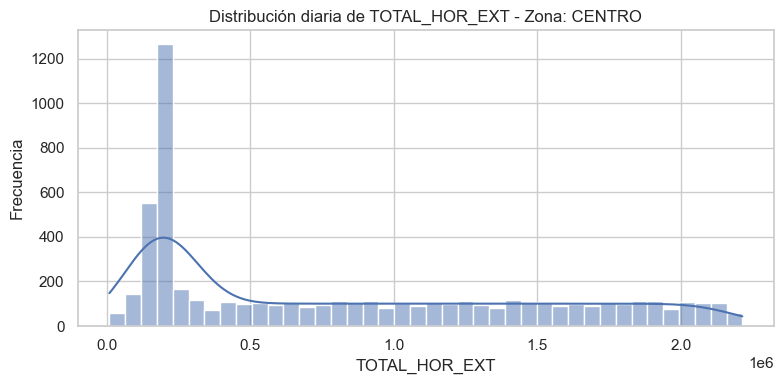

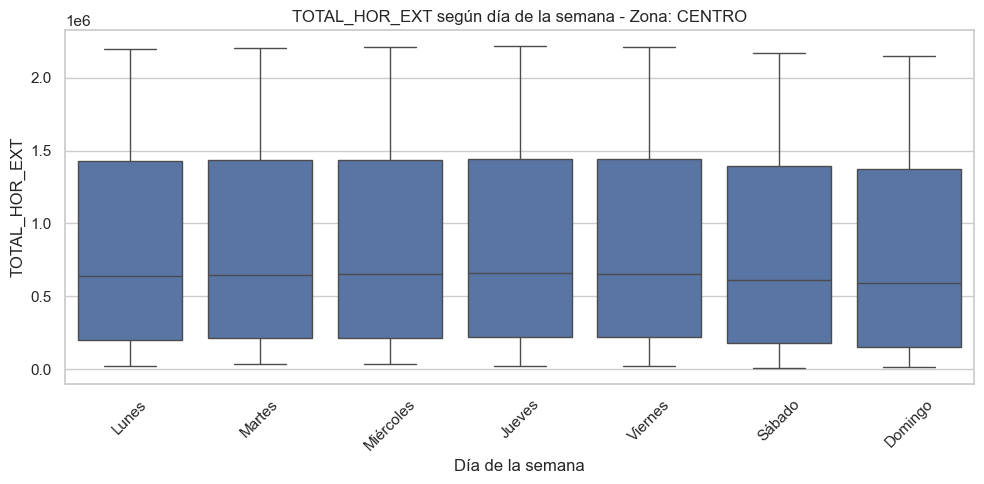

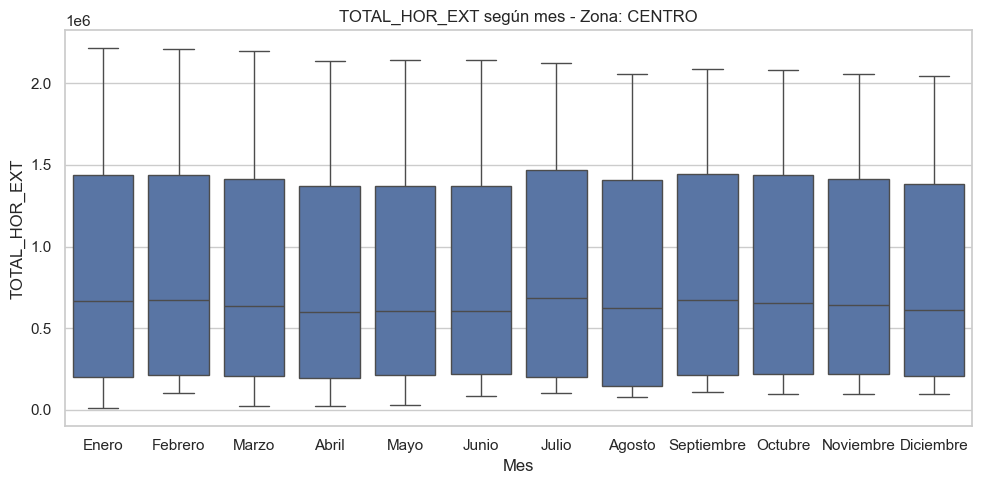

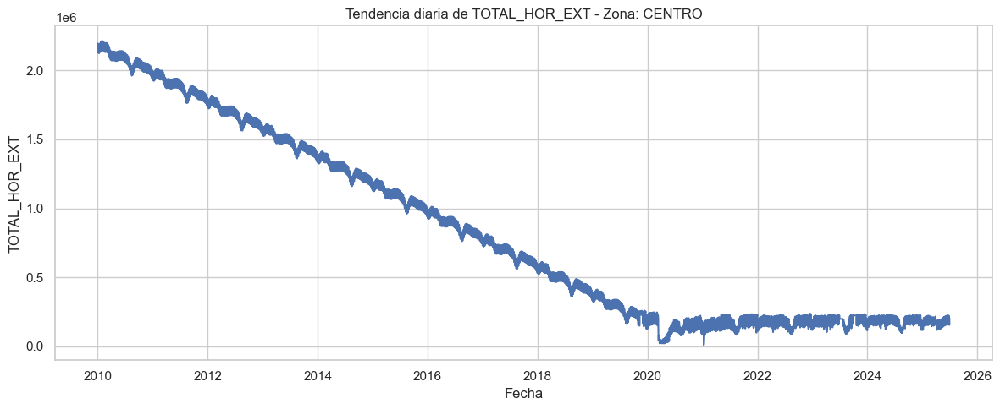

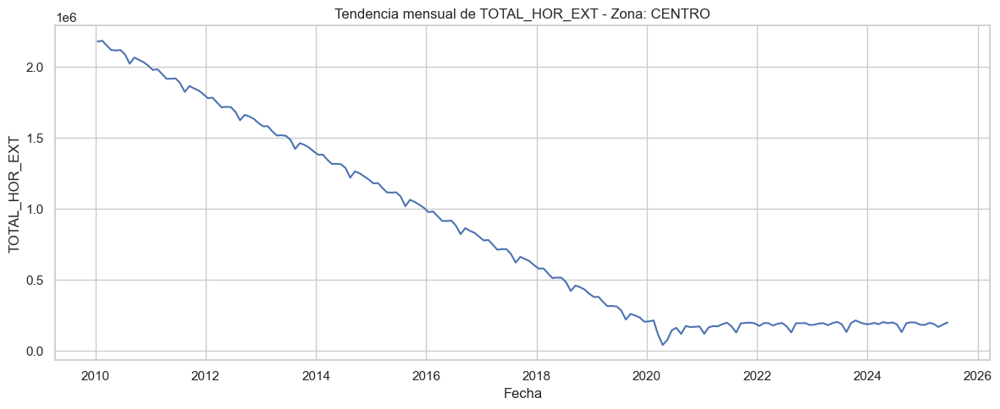

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\2950674204.py:167: FutureWarning: Constructing PeriodIndex from fields is deprecated. Use PeriodIndex.from_fields instead.
  df_trim["fecha_trim"] = pd.PeriodIndex(


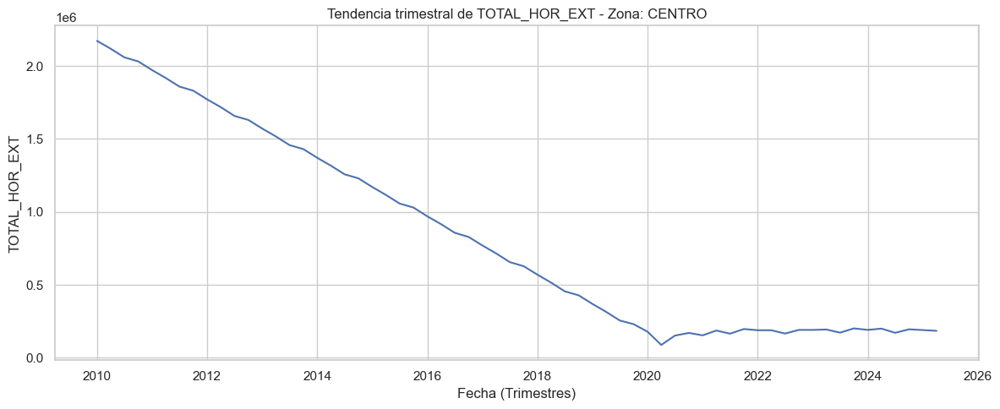

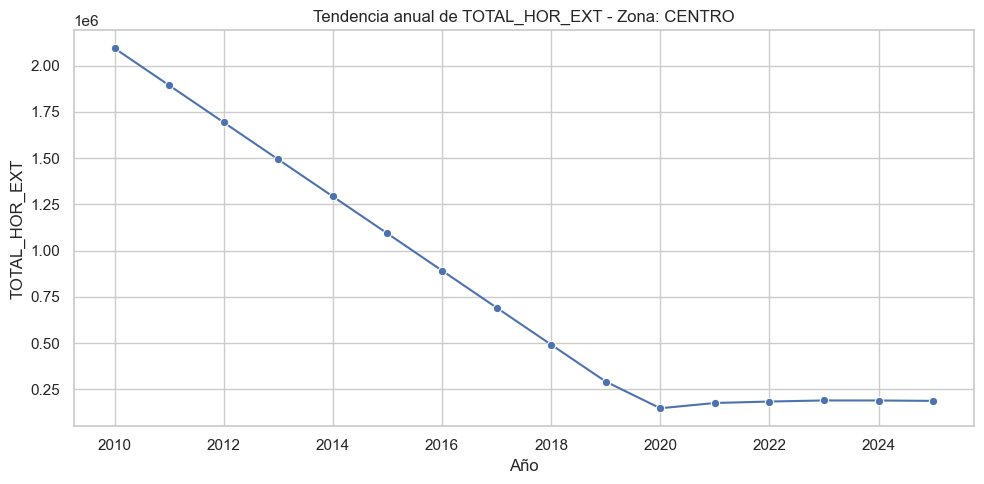

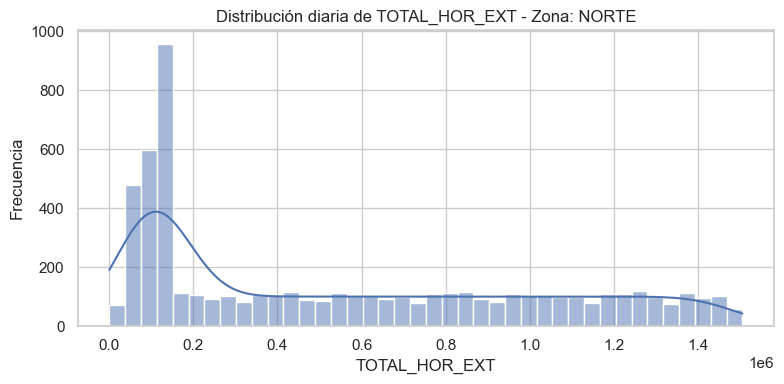

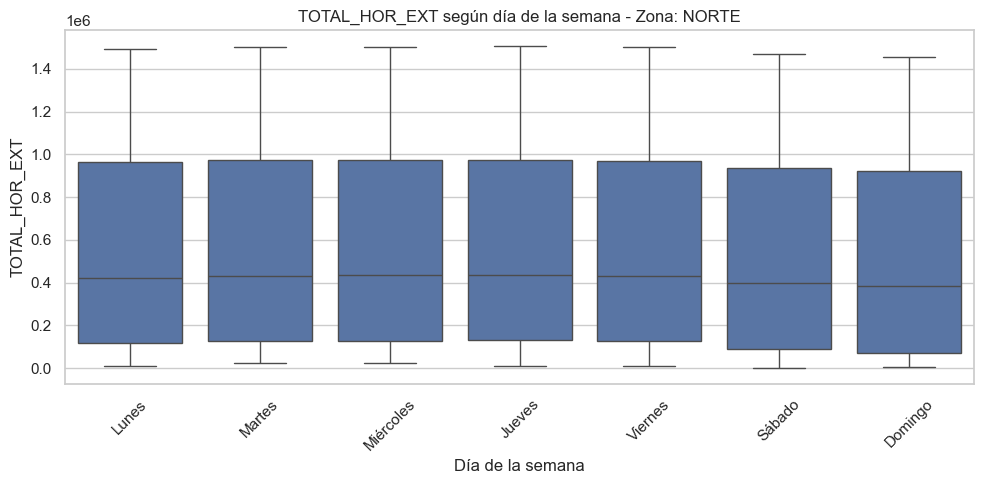

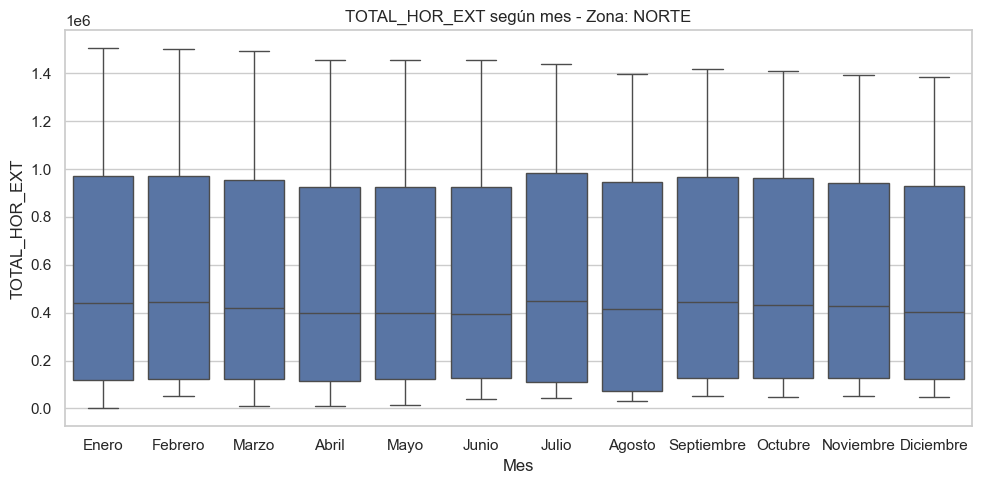

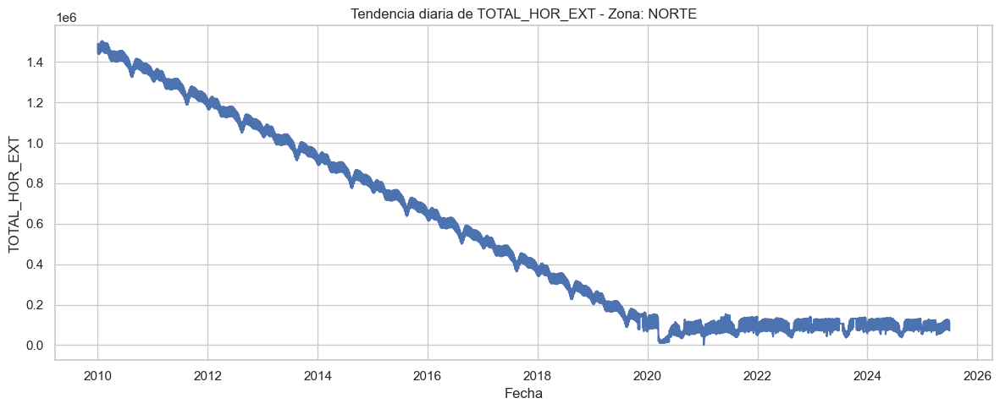

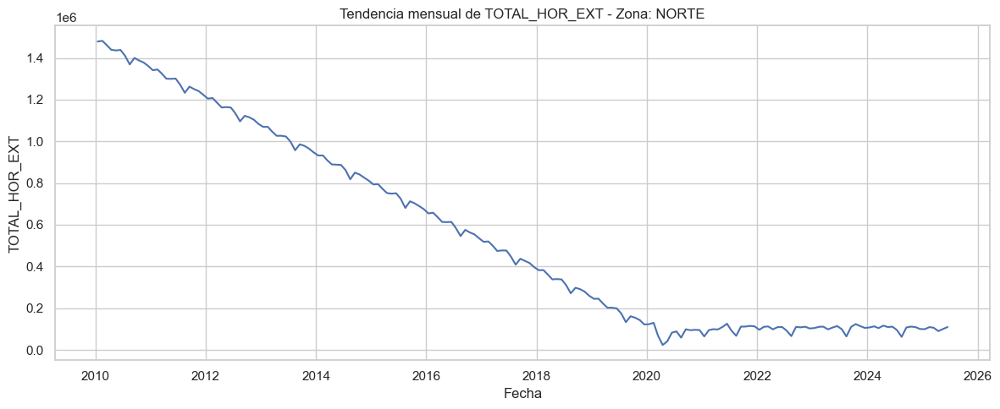

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\2950674204.py:167: FutureWarning: Constructing PeriodIndex from fields is deprecated. Use PeriodIndex.from_fields instead.
  df_trim["fecha_trim"] = pd.PeriodIndex(


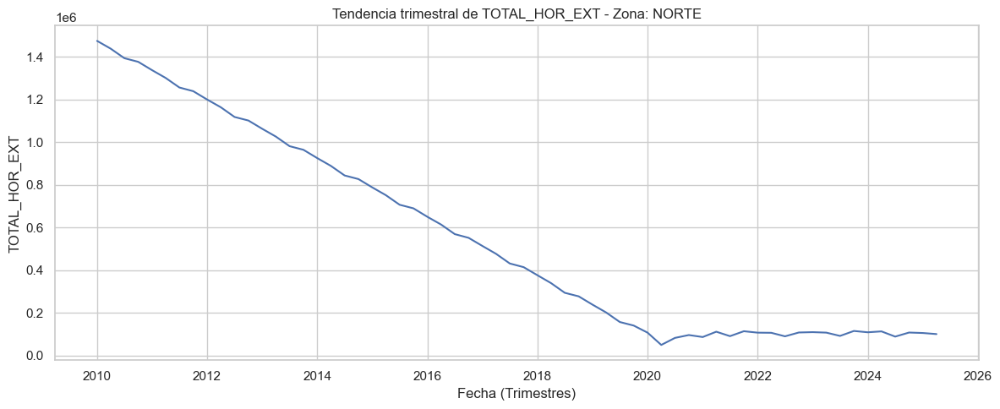

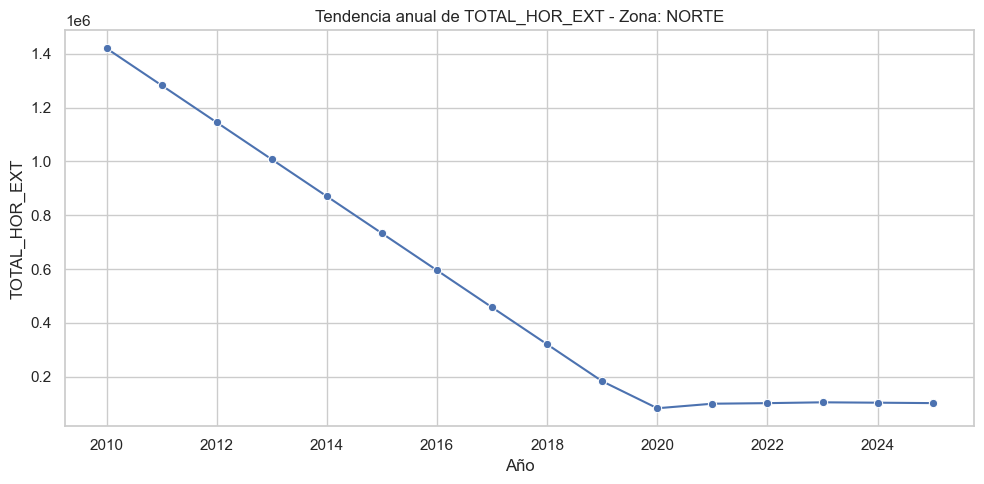

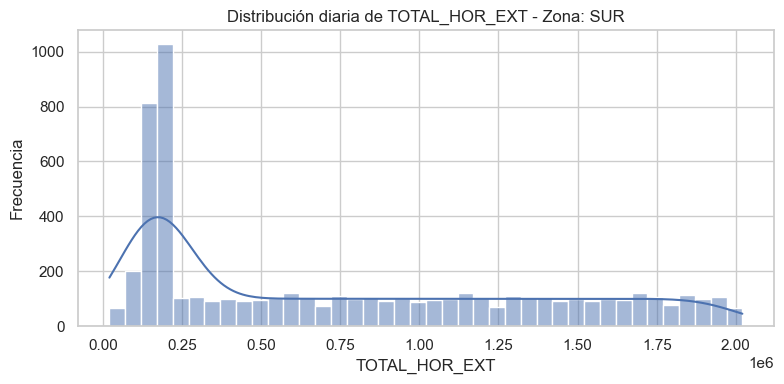

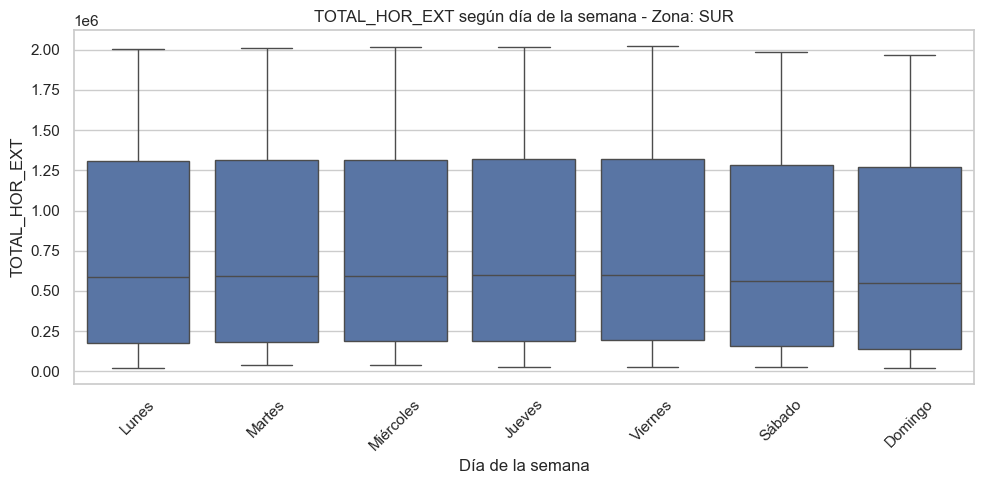

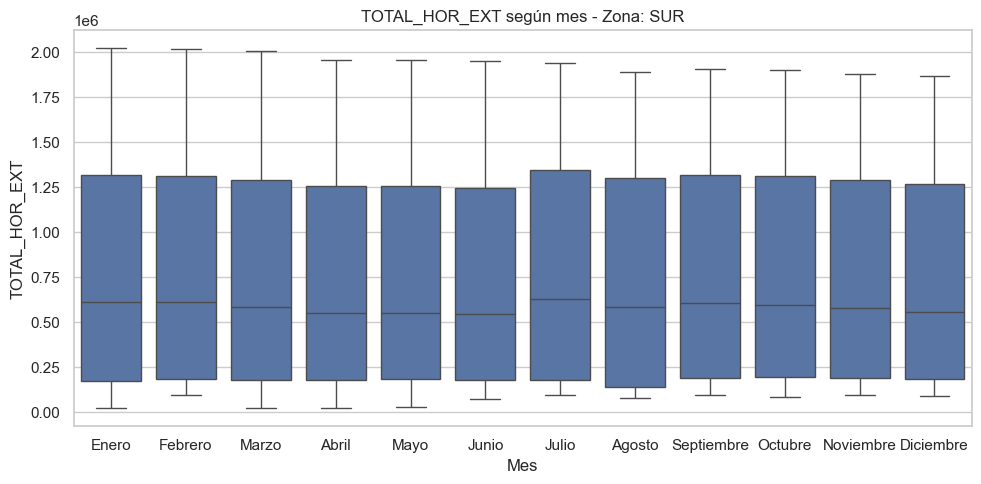

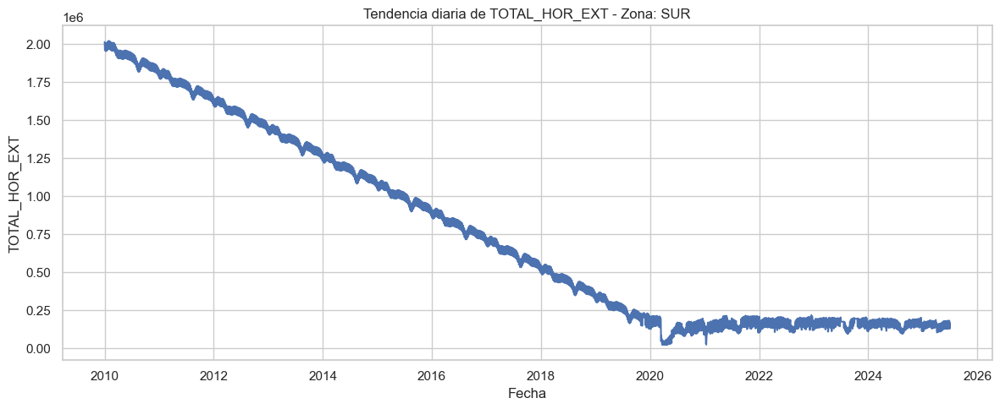

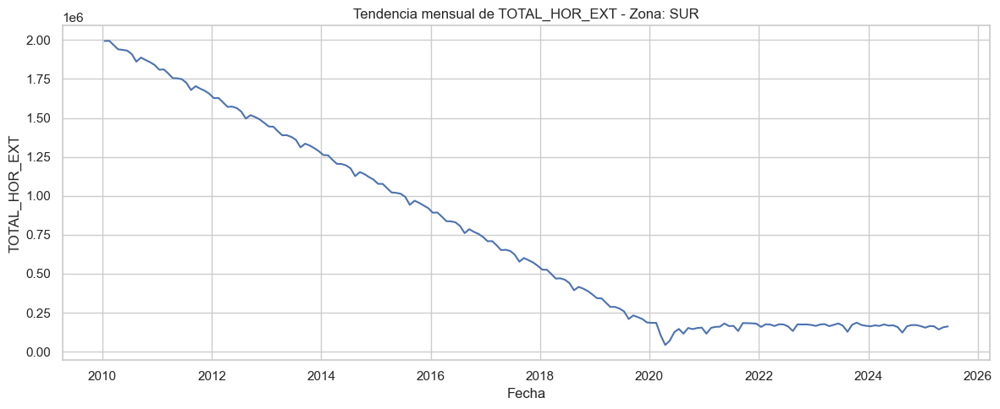

C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\2950674204.py:167: FutureWarning: Constructing PeriodIndex from fields is deprecated. Use PeriodIndex.from_fields instead.
  df_trim["fecha_trim"] = pd.PeriodIndex(


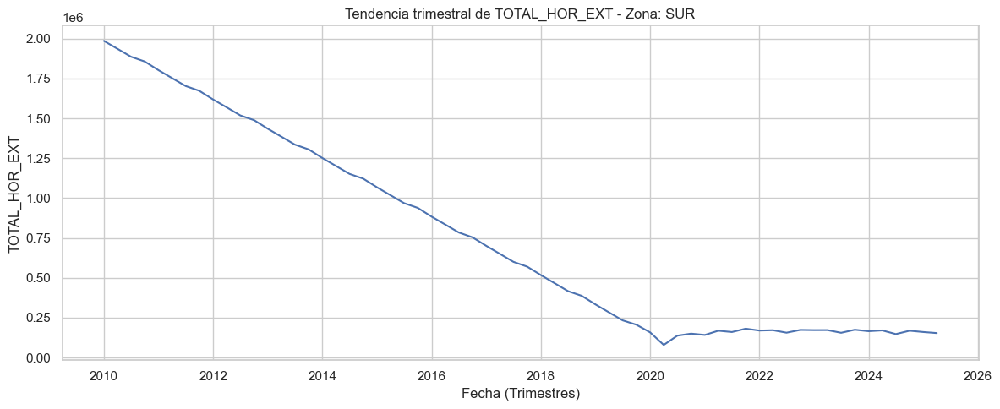

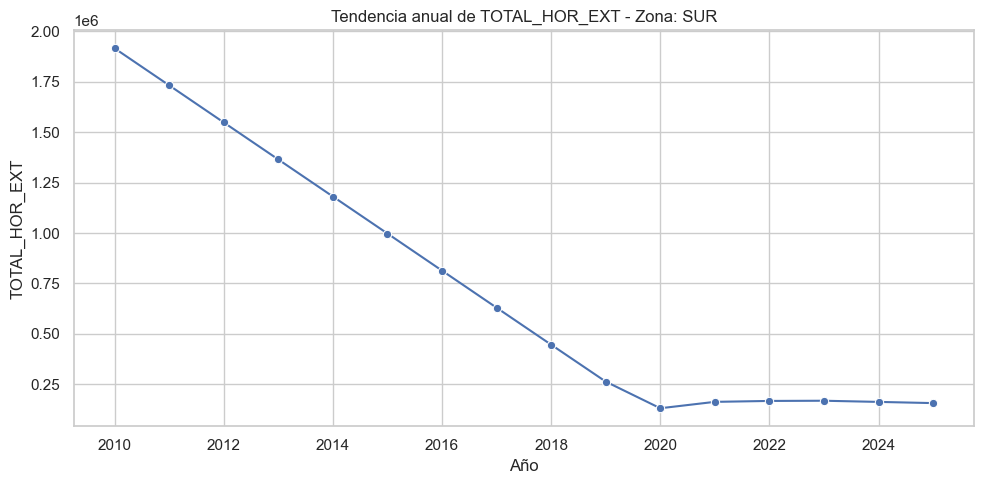

In [20]:
warnings.filterwarnings("ignore", category=pd.errors.SettingWithCopyWarning)
sns.set_theme(style="whitegrid")

COL_FECHA = "DIA/MES/ANO"
ZONA = "ZONA_ESTACION"
variable_traf = "TOTAL_HOR_EXT"

BASE_DIR = "06_figs_TOTAL_HOR_EXT"
os.makedirs(BASE_DIR, exist_ok=True)

subdirs = {
    "hist": os.path.join(BASE_DIR, "histogramas"),
    "box_dow": os.path.join(BASE_DIR, "box_dow"),
    "box_month": os.path.join(BASE_DIR, "box_month"),
    "ts_daily": os.path.join(BASE_DIR, "ts_diaria"),
    "ts_monthly": os.path.join(BASE_DIR, "ts_mensual"),
    "ts_quarterly": os.path.join(BASE_DIR, "ts_trimestral"),
    "ts_yearly": os.path.join(BASE_DIR, "ts_anual"),
}

zonas_unicas = df_diario_zona[ZONA].unique()

for tipo_plot, base_path in subdirs.items():
    for z in zonas_unicas:
        path_zona = os.path.join(base_path, sanitize(str(z)))
        os.makedirs(path_zona, exist_ok=True)

# ==========================
# BUCLE POR ZONA
# ==========================
for zona_actual in zonas_unicas:

    df_z = df_diario_zona[df_diario_zona[ZONA] == zona_actual].copy()

    # -------------------------------------------------
    # 1. HISTOGRAMA
    # -------------------------------------------------
    plt.figure(figsize=(8, 4))
    sns.histplot(df_z[variable_traf], bins=40, kde=True)
    plt.title(f"Distribución diaria de {variable_traf} - Zona: {zona_actual}")
    plt.xlabel(variable_traf)
    plt.ylabel("Frecuencia")
    plt.tight_layout()
    fname = os.path.join(
        subdirs["hist"],
        sanitize(str(zona_actual)),
        f"{sanitize(variable_traf)}__hist_{sanitize(str(zona_actual))}.png"
    )
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

    # -------------------------------------------------
    # 2. BOXPLOT por DÍA DE LA SEMANA
    # -------------------------------------------------
    df_plot_dow = df_z.copy()
    
    # Eliminar filas sin dato en la variable de tráfico
    df_plot_dow = df_plot_dow[df_plot_dow[variable_traf].notna()]
    
    # Mapear código de día de la semana → nombre
    df_plot_dow["dow_plot"] = df_plot_dow["dow"].map(dias_semana)
    
    # Orden teórico de los días
    orden_dias = list(dias_semana.values())   # ["Lunes", "Martes", ..., "Domingo"]
    
    # Orden REAL a usar: solo los días presentes
    dias_presentes = df_plot_dow["dow_plot"].unique()
    orden_dias_presentes = [d for d in orden_dias if d in dias_presentes]
    
    if len(orden_dias_presentes) == 0 or df_plot_dow.empty:
        print(f"No hay datos válidos para {variable_traf} en la zona {zona_actual}.")
    else:
        plt.figure(figsize=(10, 5))
        sns.boxplot(
            x="dow_plot",
            y=variable_traf,
            data=df_plot_dow,
            order=orden_dias_presentes
        )
        plt.title(f"{variable_traf} según día de la semana - Zona: {zona_actual}")
        plt.xlabel("Día de la semana")
        plt.ylabel(variable_traf)
        plt.xticks(rotation=45)
        plt.tight_layout()
    
        fname = os.path.join(
            subdirs["box_dow"],
            sanitize(str(zona_actual)),
            f"{sanitize(variable_traf)}__box_dow_{sanitize(str(zona_actual))}.png"
        )
        plt.savefig(fname, dpi=150, bbox_inches="tight")
        plt.show()



    # -------------------------------------------------
    # 3. BOXPLOT por MES
    # -------------------------------------------------
    # Aquí mes es numérico, no hay problema de categorías vacías
    plt.figure(figsize=(10, 5))
    sns.boxplot(x="month", y=variable_traf, data=df_z)
    plt.title(f"{variable_traf} según mes - Zona: {zona_actual}")
    plt.xlabel("Mes")
    plt.ylabel(variable_traf)
    plt.tight_layout()
    fname = os.path.join(
        subdirs["box_month"],
        sanitize(str(zona_actual)),
        f"{sanitize(variable_traf)}__box_month_{sanitize(str(zona_actual))}.png"
    )
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

    # ==========================
    # 4. SERIES TEMPORALES
    # ==========================

    # (a) Tendencia diaria
    df_daily = df_z.sort_values(COL_FECHA)

    plt.figure(figsize=(12, 5))
    sns.lineplot(x=COL_FECHA, y=variable_traf, data=df_daily)
    plt.title(f"Tendencia diaria de {variable_traf} - Zona: {zona_actual}")
    plt.xlabel("Fecha")
    plt.ylabel(variable_traf)
    plt.tight_layout()
    fname = os.path.join(
        subdirs["ts_daily"],
        sanitize(str(zona_actual)),
        f"{sanitize(variable_traf)}__ts_diaria_{sanitize(str(zona_actual))}.png"
    )
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

    # (b) Tendencia mensual (media mensual)
    df_z["month_num"] = pd.to_datetime(df_z[COL_FECHA]).dt.month
    df_mensual = (
        df_z
        .groupby(["year", "month_num"], as_index=False)[variable_traf]
        .mean()
    )
    df_mensual["fecha_mensual"] = pd.to_datetime(
        df_mensual["year"].astype(str) + "-" + df_mensual["month_num"].astype(str) + "-15"
    )
    df_mensual = df_mensual.sort_values("fecha_mensual")

    plt.figure(figsize=(12, 5))
    sns.lineplot(x="fecha_mensual", y=variable_traf, data=df_mensual)
    plt.title(f"Tendencia mensual de {variable_traf} - Zona: {zona_actual}")
    plt.xlabel("Fecha")
    plt.ylabel(variable_traf)
    plt.tight_layout()
    fname = os.path.join(
        subdirs["ts_monthly"],
        sanitize(str(zona_actual)),
        f"{sanitize(variable_traf)}__ts_mensual_{sanitize(str(zona_actual))}.png"
    )
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

    # (c) Tendencia trimestral (media trimestral)
    df_trim = (
        df_z
        .groupby(["year", "quarter"], as_index=False)[variable_traf]
        .mean()
    )
    df_trim["fecha_trim"] = pd.PeriodIndex(
        year=df_trim["year"],
        quarter=df_trim["quarter"],
        freq="Q"
    ).to_timestamp(how="start")
    df_trim = df_trim.sort_values("fecha_trim")

    plt.figure(figsize=(12, 5))
    sns.lineplot(x="fecha_trim", y=variable_traf, data=df_trim)
    plt.title(f"Tendencia trimestral de {variable_traf} - Zona: {zona_actual}")
    plt.xlabel("Fecha (Trimestres)")
    plt.ylabel(variable_traf)
    plt.tight_layout()
    fname = os.path.join(
        subdirs["ts_quarterly"],
        sanitize(str(zona_actual)),
        f"{sanitize(variable_traf)}__ts_trimestral_{sanitize(str(zona_actual))}.png"
    )
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

    # (d) Tendencia anual (media anual)
    df_anual = (
        df_z
        .groupby("year", as_index=False)[variable_traf]
        .mean()
        .sort_values("year")
    )

    plt.figure(figsize=(10, 5))
    sns.lineplot(x="year", y=variable_traf, data=df_anual, marker="o")
    plt.title(f"Tendencia anual de {variable_traf} - Zona: {zona_actual}")
    plt.xlabel("Año")
    plt.ylabel(variable_traf)
    plt.tight_layout()
    fname = os.path.join(
        subdirs["ts_yearly"],
        sanitize(str(zona_actual)),
        f"{sanitize(variable_traf)}__ts_anual_{sanitize(str(zona_actual))}.png"
    )
    plt.savefig(fname, dpi=150, bbox_inches="tight")
    plt.show()

### CONCLUSIONES

Las gráficas que refpresentan la evolución temporal no parecen muy coherentes para los años previos a 2020, por lo que se decide prescindir de esta variable para los siguientes estudios

# DIVISÓN DATASET POR MAGNITUD Y ZONA_ESTACIÓN

Antes de proceder con el EDA, voy a proceder ahora a dividir el dataset en tantos sub-dataframes como combinaciones únicas existan de MAGNITUD y Zona_Estación.
Entonces el siguiente paso será dividir el dataset en tantos sub–dataframes como combinaciones únicas existan de MAGNITUD y Zona_Estación:

## ELIMINACION DE VARIABLE TRÁFICO

In [21]:
df_orig.drop(columns=["TOTAL_HOR_EXT"], inplace=True)

## DIVISIÓN EN DATASETS

In [22]:
dfs_mag_zona = { # Creo un diccionario llamado dfs_mag_zona donde se irán guardando todos los sub-dataframes.
    (mag, zona): sub_df.copy() # tuplas (mag, zona) que representan combinaciones únicas de magnitud y zona de estación
    for (mag, zona), sub_df in df_orig.groupby(["MAGNITUD", "ZONA_ESTACION"])
}

# --- Muestro resumen ---
print(f"Se han creado {len(dfs_mag_zona)} sub–dataframes.")
print("Ejemplo de claves (combinaciones MAGNITUD–Zona_Estación):")
display (list(dfs_mag_zona.keys())[:33])  # muestra las 10 primeras combinaciones

Se han creado 33 sub–dataframes.
Ejemplo de claves (combinaciones MAGNITUD–Zona_Estación):


C:\Users\rosal\AppData\Local\Temp\ipykernel_13116\1956202853.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  for (mag, zona), sub_df in df_orig.groupby(["MAGNITUD", "ZONA_ESTACION"])


[('1', 'CENTRO'),
 ('1', 'NORTE'),
 ('1', 'SUR'),
 ('10', 'CENTRO'),
 ('10', 'NORTE'),
 ('10', 'SUR'),
 ('12', 'CENTRO'),
 ('12', 'NORTE'),
 ('12', 'SUR'),
 ('14', 'CENTRO'),
 ('14', 'NORTE'),
 ('14', 'SUR'),
 ('20', 'CENTRO'),
 ('20', 'NORTE'),
 ('20', 'SUR'),
 ('30', 'CENTRO'),
 ('30', 'NORTE'),
 ('30', 'SUR'),
 ('35', 'CENTRO'),
 ('35', 'NORTE'),
 ('35', 'SUR'),
 ('6', 'CENTRO'),
 ('6', 'NORTE'),
 ('6', 'SUR'),
 ('7', 'CENTRO'),
 ('7', 'NORTE'),
 ('7', 'SUR'),
 ('8', 'CENTRO'),
 ('8', 'NORTE'),
 ('8', 'SUR'),
 ('9', 'CENTRO'),
 ('9', 'NORTE'),
 ('9', 'SUR')]

EJEMPLOS

In [23]:
df_ejemplo = dfs_mag_zona[("20", "NORTE")]
df_ejemplo.head(10)

,DIA/MES/ANO,MAGNITUD,ZONA_ESTACION,MEDICION_ugm3,TEMPERATURA_MAX (°C),TEMPERATURA_MIN (°C),TEMPERATURA_MED (°C),PRECIPITACIONES (mm),HUMEDAD_MAX (%),HUMEDAD_MIN (%),...,VIENTO_DIR_100 (°),NUBES (%),HORAS_SOL (min),RADIACION_SOLAR (W/mÂ²),PRESION_MAX (hPa),PRESION_MIN (hPa),PRESION_MED (hPa),Superficie_incendiada_HA,dow,month
30,2010-01-01,20,NORTE,1.75,8.833577,4.033577,5.879828,0.100000,81.779030,63.816715,...,238.270250,55.933334,227.164660,1329.0,1017.5,1007.3,1011.06665,0.0,Viernes,Enero
64,2010-01-02,20,NORTE,4.00,7.433577,1.633577,5.113994,0.000000,91.992530,78.912926,...,214.303500,59.087498,92.617860,1262.0,1022.7,1017.6,1020.66656,0.0,Sábado,Enero
97,2010-01-03,20,NORTE,8.65,6.893577,3.553577,5.551910,3.200000,95.715294,83.991780,...,182.423770,89.041664,40.621723,725.0,1020.7,1015.5,1018.64580,0.0,Domingo,Enero
130,2010-01-04,20,NORTE,5.95,8.423577,5.983577,7.413578,10.900001,97.863980,91.812260,...,116.399930,90.250000,0.676768,498.0,1014.8,1001.5,1007.65010,0.0,Lunes,Enero
163,2010-01-05,20,NORTE,4.45,10.783577,6.013578,8.091077,1.900000,96.731870,69.086680,...,343.523130,74.708336,214.730650,1436.0,1004.4,1000.0,1001.49994,0.0,Martes,Enero
196,2010-01-06,20,NORTE,1.75,7.053577,3.103577,5.233994,0.000000,89.842606,55.515656,...,233.364470,46.458332,291.295300,1724.0,1007.5,1004.5,1005.58330,0.0,Miércoles,Enero
229,2010-01-07,20,NORTE,3.25,2.733577,1.463577,2.228577,9.700002,97.300790,55.985603,...,24.018875,98.416664,0.000000,533.0,1004.2,999.8,1001.56244,0.0,Jueves,Enero
261,2010-01-08,20,NORTE,2.60,2.613577,-0.406423,0.882327,0.000000,63.800697,47.614807,...,342.369400,44.041668,298.136350,2039.0,1015.3,1003.6,1009.61250,0.0,Viernes,Enero
295,2010-01-09,20,NORTE,1.95,2.673577,-3.186423,-0.200173,0.000000,70.919846,43.684740,...,299.896800,13.416667,382.100370,2441.0,1019.8,1015.3,1017.30426,0.0,Sábado,Enero
328,2010-01-10,20,NORTE,2.60,0.313577,-4.456423,-2.208090,3.200000,97.379400,61.301098,...,189.200400,53.108334,182.731520,2047.0,1019.6,1015.6,1017.62500,0.0,Domingo,Enero


In [24]:
df_ejemplo = dfs_mag_zona[("14", "CENTRO")]
df_ejemplo.head(10)

,DIA/MES/ANO,MAGNITUD,ZONA_ESTACION,MEDICION_ugm3,TEMPERATURA_MAX (°C),TEMPERATURA_MIN (°C),TEMPERATURA_MED (°C),PRECIPITACIONES (mm),HUMEDAD_MAX (%),HUMEDAD_MIN (%),...,VIENTO_DIR_100 (°),NUBES (%),HORAS_SOL (min),RADIACION_SOLAR (W/mÂ²),PRESION_MAX (hPa),PRESION_MIN (hPa),PRESION_MED (hPa),Superficie_incendiada_HA,dow,month
26,2010-01-01,14,CENTRO,61.833333,8.833577,4.033577,5.879828,0.100000,81.779030,63.816715,...,238.270250,55.933334,227.164660,1329.0,1017.5,1007.3,1011.06665,0.0,Viernes,Enero
60,2010-01-02,14,CENTRO,30.166667,7.433577,1.633577,5.113994,0.000000,91.992530,78.912926,...,214.303500,59.087498,92.617860,1262.0,1022.7,1017.6,1020.66656,0.0,Sábado,Enero
93,2010-01-03,14,CENTRO,10.666667,6.893577,3.553577,5.551910,3.200000,95.715294,83.991780,...,182.423770,89.041664,40.621723,725.0,1020.7,1015.5,1018.64580,0.0,Domingo,Enero
126,2010-01-04,14,CENTRO,11.500000,8.423577,5.983577,7.413578,10.900001,97.863980,91.812260,...,116.399930,90.250000,0.676768,498.0,1014.8,1001.5,1007.65010,0.0,Lunes,Enero
159,2010-01-05,14,CENTRO,25.666667,10.783577,6.013578,8.091077,1.900000,96.731870,69.086680,...,343.523130,74.708336,214.730650,1436.0,1004.4,1000.0,1001.49994,0.0,Martes,Enero
192,2010-01-06,14,CENTRO,39.166667,7.053577,3.103577,5.233994,0.000000,89.842606,55.515656,...,233.364470,46.458332,291.295300,1724.0,1007.5,1004.5,1005.58330,0.0,Miércoles,Enero
225,2010-01-07,14,CENTRO,34.833333,2.733577,1.463577,2.228577,9.700002,97.300790,55.985603,...,24.018875,98.416664,0.000000,533.0,1004.2,999.8,1001.56244,0.0,Jueves,Enero
257,2010-01-08,14,CENTRO,56.000000,2.613577,-0.406423,0.882327,0.000000,63.800697,47.614807,...,342.369400,44.041668,298.136350,2039.0,1015.3,1003.6,1009.61250,0.0,Viernes,Enero
291,2010-01-09,14,CENTRO,47.500000,2.673577,-3.186423,-0.200173,0.000000,70.919846,43.684740,...,299.896800,13.416667,382.100370,2441.0,1019.8,1015.3,1017.30426,0.0,Sábado,Enero
324,2010-01-10,14,CENTRO,27.833333,0.313577,-4.456423,-2.208090,3.200000,97.379400,61.301098,...,189.200400,53.108334,182.731520,2047.0,1019.6,1015.6,1017.62500,0.0,Domingo,Enero


In [25]:
df_ejemplo = dfs_mag_zona[("30", "SUR")]
df_ejemplo.head(10)

,DIA/MES/ANO,MAGNITUD,ZONA_ESTACION,MEDICION_ugm3,TEMPERATURA_MAX (°C),TEMPERATURA_MIN (°C),TEMPERATURA_MED (°C),PRECIPITACIONES (mm),HUMEDAD_MAX (%),HUMEDAD_MIN (%),...,VIENTO_DIR_100 (°),NUBES (%),HORAS_SOL (min),RADIACION_SOLAR (W/mÂ²),PRESION_MAX (hPa),PRESION_MIN (hPa),PRESION_MED (hPa),Superficie_incendiada_HA,dow,month
15,2010-01-01,30,SUR,0.900,8.833577,4.033577,5.879828,0.100000,81.779030,63.816715,...,238.270250,55.933334,227.164660,1329.0,1017.5,1007.3,1011.06665,0.0,Viernes,Enero
48,2010-01-02,30,SUR,1.800,7.433577,1.633577,5.113994,0.000000,91.992530,78.912926,...,214.303500,59.087498,92.617860,1262.0,1022.7,1017.6,1020.66656,0.0,Sábado,Enero
75,2010-01-03,30,SUR,2.600,6.893577,3.553577,5.551910,3.200000,95.715294,83.991780,...,182.423770,89.041664,40.621723,725.0,1020.7,1015.5,1018.64580,0.0,Domingo,Enero
112,2010-01-04,30,SUR,2.600,8.423577,5.983577,7.413578,10.900001,97.863980,91.812260,...,116.399930,90.250000,0.676768,498.0,1014.8,1001.5,1007.65010,0.0,Lunes,Enero
145,2010-01-05,30,SUR,0.725,10.783577,6.013578,8.091077,1.900000,96.731870,69.086680,...,343.523130,74.708336,214.730650,1436.0,1004.4,1000.0,1001.49994,0.0,Martes,Enero
172,2010-01-06,30,SUR,1.600,7.053577,3.103577,5.233994,0.000000,89.842606,55.515656,...,233.364470,46.458332,291.295300,1724.0,1007.5,1004.5,1005.58330,0.0,Miércoles,Enero
208,2010-01-07,30,SUR,1.700,2.733577,1.463577,2.228577,9.700002,97.300790,55.985603,...,24.018875,98.416664,0.000000,533.0,1004.2,999.8,1001.56244,0.0,Jueves,Enero
246,2010-01-08,30,SUR,1.200,2.613577,-0.406423,0.882327,0.000000,63.800697,47.614807,...,342.369400,44.041668,298.136350,2039.0,1015.3,1003.6,1009.61250,0.0,Viernes,Enero
271,2010-01-09,30,SUR,1.500,2.673577,-3.186423,-0.200173,0.000000,70.919846,43.684740,...,299.896800,13.416667,382.100370,2441.0,1019.8,1015.3,1017.30426,0.0,Sábado,Enero
310,2010-01-10,30,SUR,2.100,0.313577,-4.456423,-2.208090,3.200000,97.379400,61.301098,...,189.200400,53.108334,182.731520,2047.0,1019.6,1015.6,1017.62500,0.0,Domingo,Enero


# EDA VARIABLE DEPENDIENTE PARA COMBINACIÓN DE MAGNITUD Y ZONA DE ESTACIÓN

## CREACIÓN CARPETAS Y GENERACIÓN RESULTADOS

Con el siguiente código se va a realizar un análisis exploratorio automatizado (EDA) para cada combinación única de magnitud y zona de estación en un conjunto de datos de contaminación. Primero crea una carpeta principal para guardar los resultados, y luego recorre cada sub–dataframe agrupado por magnitud y zona. Para cada grupo, se generará una carpeta específica donde guarda: un resumen básico con número de filas, rango de fechas y nulos; estadísticas descriptivas; gráficos de distribución, boxplots por día de la semana, evolución temporal de las mediciones, y matriz de correlación entre variables numéricas. Todo se organiza de forma estructurada en carpetas separadas, facilitando la revisión visual y estadística de cada segmento del dataset.

In [26]:
sns.set_theme(style="whitegrid")

# 1) Carpeta principal de resultados
os.makedirs("06_EDA_resultados", exist_ok=True)

# Lista para guardar la tendencia anual en 2025 por MAGNITUD–ZONA
tendencias_anuales_2025 = []

# 2) Recorremos cada sub–dataframe del diccionario ya creado
for (mag, zona), sub_df in dfs_mag_zona.items():
    try:
        folder = f"06_EDA_resultados/MAG{mag}_{str(zona).replace(' ', '_')}"
        os.makedirs(folder, exist_ok=True)

        # 2.1) Resumen básico
        resumen = {
            "n_filas": int(len(sub_df)),
            "fechas_min": sub_df["DIA/MES/ANO"].min(),
            "fechas_max": sub_df["DIA/MES/ANO"].max(),
            "total_nulos": int(sub_df.isna().sum().sum())
        }
        with open(os.path.join(folder, "resumen.json"), "w", encoding="utf-8") as f:
            json.dump(resumen, f, ensure_ascii=False, indent=2, default=str)

        # 2.2) Estadísticos descriptivos
        desc = sub_df.describe(include="all")
        desc.to_csv(os.path.join(folder, "estadisticos.csv"))

        # 2.3) Gráficos solo si existe la variable objetivo
        if "MEDICION_ugm3" in sub_df.columns:
            # Distribución
            plt.figure(figsize=(8, 5))
            sns.histplot(sub_df["MEDICION_ugm3"], bins=30, kde=True)
            plt.title(f"Distribución de MEDICION_ugm3 ({zona} - MAGNITUD {mag})")
            plt.xlabel("MEDICION_ugm3"); plt.ylabel("Frecuencia")
            plt.tight_layout()
            plt.savefig(os.path.join(folder, "distribucion_MEDICION.png"))
            plt.close()

            # Boxplot por día de la semana
            if "dow" in sub_df.columns:
                plt.figure(figsize=(8, 5))
                sns.boxplot(x="dow", y="MEDICION_ugm3", data=sub_df)
                plt.title(f"Boxplot de MEDICION_ugm3 por día ({zona} - MAGNITUD {mag})")
                plt.xticks(rotation=45)
                plt.tight_layout()
                plt.savefig(os.path.join(folder, "boxplot_dow.png"))
                plt.close()

            # Boxplot por mes (month)
            if "month" in sub_df.columns and sub_df["month"].notna().any():
                orden_meses = [
                    "Enero","Febrero","Marzo","Abril","Mayo","Junio",
                    "Julio","Agosto","Septiembre","Octubre","Noviembre","Diciembre"
                ]
                sub_df_month = sub_df.copy()
                if sub_df_month["month"].dtype.name == "category":
                    categorias_presentes = [
                        m for m in orden_meses
                        if m in sub_df_month["month"].cat.categories
                    ]
                    sub_df_month["month"] = sub_df_month["month"].cat.set_categories(
                        categorias_presentes, ordered=True
                    )
                else:
                    sub_df_month["month"] = pd.Categorical(
                        sub_df_month["month"],
                        categories=orden_meses,
                        ordered=True
                    )
                plt.figure(figsize=(9, 5))
                sns.boxplot(x="month", y="MEDICION_ugm3", data=sub_df_month)
                plt.title(f"Boxplot de MEDICION_ugm3 por mes ({zona} - MAGNITUD {mag})")
                plt.xlabel("Mes"); plt.ylabel("MEDICION_ugm3")
                plt.xticks(rotation=45)
                plt.tight_layout()
                plt.savefig(os.path.join(folder, "boxplot_month.png"))
                plt.close()

            # =========================
            # TENDENCIAS (con medias móviles centradas - rolling mean)
            # =========================
            if "DIA/MES/ANO" in sub_df.columns:
                # 1) Diaria
                sub_df_sorted = sub_df.sort_values("DIA/MES/ANO").copy()
                idx = pd.to_datetime(sub_df_sorted["DIA/MES/ANO"], errors="coerce")
                y_d = pd.Series(sub_df_sorted["MEDICION_ugm3"].values, index=idx).dropna()
                if not y_d.empty:
                    plt.figure(figsize=(10, 5))
                    plt.plot(y_d.index, y_d.values, linewidth=1.2, label="Serie diaria")
                    w_d = max(7, len(y_d)//4)
                    trend_d = y_d.rolling(window=w_d, center=True, min_periods=1).mean()
                    plt.plot(
                        trend_d.index, trend_d.values,
                        linewidth=2, color="red",
                        label=f"Tendencia ({w_d}d MA)"
                    )
                    plt.title(f"Evolución temporal de MEDICION_ugm3 ({zona} - MAGNITUD {mag})")
                    plt.xlabel("Fecha"); plt.ylabel("MEDICION_ugm3")
                    plt.legend(); plt.tight_layout()
                    plt.savefig(os.path.join(folder, "tendencia_temporal.png"))
                    plt.close()

                # Serie base con índice de fechas
                ts = sub_df.copy()
                ts["__fecha__"] = pd.to_datetime(ts["DIA/MES/ANO"], errors="coerce")
                ts = (
                    ts.dropna(subset=["__fecha__"])
                      .sort_values("__fecha__")
                      .set_index("__fecha__")
                )
                y = ts["MEDICION_ugm3"].dropna()
                if not y.empty:
                    # 2) Mensual
                    y_m = y.resample("MS").mean()
                    if len(y_m) > 0:
                        plt.figure(figsize=(10,5))
                        plt.plot(y_m.index, y_m.values, linewidth=1.5, label="Serie mensual")
                        w_m = max(3, len(y_m)//4)
                        trend_m = y_m.rolling(w_m, center=True, min_periods=1).mean()
                        plt.plot(
                            trend_m.index, trend_m.values,
                            linewidth=2, color="red",
                            label=f"Tendencia ({w_m}m MA)"
                        )
                        plt.title(f"Evolución mensual de MEDICION_ugm3 ({zona} - MAGNITUD {mag})")
                        plt.xlabel("Fecha"); plt.ylabel("MEDICION_ugm3")
                        plt.legend(); plt.tight_layout()
                        plt.savefig(os.path.join(folder, "tendencia_mensual.png"))
                        plt.close()

                    # 3) Trimestral
                    y_q = y.resample("QS").mean()
                    if len(y_q) > 0:
                        plt.figure(figsize=(10,5))
                        plt.plot(y_q.index, y_q.values, linewidth=1.5, label="Serie trimestral")
                        w_q = max(2, len(y_q)//4)
                        trend_q = y_q.rolling(w_q, center=True, min_periods=1).mean()
                        plt.plot(
                            trend_q.index, trend_q.values,
                            linewidth=2, color="red",
                            label=f"Tendencia ({w_q}Q MA)"
                        )
                        plt.title(f"Evolución trimestral de MEDICION_ugm3 ({zona} - MAGNITUD {mag})")
                        plt.xlabel("Fecha"); plt.ylabel("MEDICION_ugm3")
                        plt.legend(); plt.tight_layout()
                        plt.savefig(os.path.join(folder, "tendencia_trimestral.png"))
                        plt.close()

                    # 4) Anual
                    y_y = y.resample("YS").mean()
                    if len(y_y) > 0:
                        plt.figure(figsize=(10,5))
                        plt.plot(y_y.index, y_y.values, linewidth=1.8, label="Serie anual")
                        w_y = max(2, len(y_y)//4)
                        trend_y = y_y.rolling(w_y, center=True, min_periods=1).mean()
                        plt.plot(
                            trend_y.index, trend_y.values,
                            linewidth=2, color="red",
                            label=f"Tendencia ({w_y}a MA)"
                        )
                        plt.title(f"Evolución anual de MEDICION_ugm3 ({zona} - MAGNITUD {mag})")
                        plt.xlabel("Fecha"); plt.ylabel("MEDICION_ugm3")
                        plt.legend(); plt.tight_layout()
                        plt.savefig(os.path.join(folder, "tendencia_anual.png"))
                        plt.close()

                        # Extraer valor de la tendencia anual para el año 2025
                        trend_2025 = trend_y[trend_y.index.year == 2025]
                        if not trend_2025.empty:
                            valor_trend_2025 = float(trend_2025.iloc[-1])
                        else:
                            valor_trend_2025 = np.nan

                        tendencias_anuales_2025.append({
                            "MAGNITUD": mag,
                            "ZONA": zona,
                            "trend_anual_2025": valor_trend_2025
                        })

        # 2.4) Correlación numérica (DENTRO del for)
        num_cols = sub_df.select_dtypes(include="number").columns
        excluir_vars = [
            "TEMPERATURA_MAX (°C)", "TEMPERATURA_MIN (°C)",
            "HUMEDAD_MAX (%)", "HUMEDAD_MIN (%)",
            "VIENTO_MAX_10 (km/h)", "VIENTO_MIN_10 (km/h)",
            "VIENTO_MAX_100 (km/h)", "VIENTO_MIN_100 (km/h)",
            "PRESION_MIN (hPa)", "PRESION_MED (hPa)"
        ]
        num_cols_filtradas = [c for c in num_cols if c not in excluir_vars]
        if len(num_cols_filtradas) > 1:
            corr = sub_df[num_cols_filtradas].corr()
            plt.figure(figsize=(10, 8))
            sns.heatmap(
                corr, annot=True, cmap="coolwarm", fmt=".2f",
                annot_kws={"size": 7}
            )
            plt.title(f"Matriz de correlación ({zona} - MAGNITUD {mag})\n(variables filtradas)")
            plt.xticks(rotation=90); plt.yticks(rotation=0)
            plt.tight_layout()
            plt.savefig(os.path.join(folder, "correlacion.png"))
            plt.close()

    except Exception as e:
        print(f"⚠️ Error en MAGNITUD={mag}, ZONA={zona}: {e}")

print("\n✅ EDA completado para todas las combinaciones. Resultados en '06_EDA_resultados/'.")



✅ EDA completado para todas las combinaciones. Resultados en '06_EDA_resultados/'.


In [27]:
# Exportar tendencias anuales 2025 si existen
if tendencias_anuales_2025:
    df_tend_2025 = pd.DataFrame(tendencias_anuales_2025)
    df_tend_2025.to_csv(
        "06_EDA_resultados/tendencias_anuales_2025.csv",
        index=False,
        encoding="utf-8"
    )
    print("✅ Tendencias anuales 2025 exportadas a 'tendencias_anuales_2025.csv'.")



✅ Tendencias anuales 2025 exportadas a 'tendencias_anuales_2025.csv'.


In [28]:
df_tend_2025

,MAGNITUD,ZONA,trend_anual_2025
0,1,CENTRO,3.104382
1,1,NORTE,2.774294
2,1,SUR,2.394006
3,10,CENTRO,18.083161
4,10,NORTE,18.529601
5,10,SUR,18.184013
6,12,CENTRO,32.311607
7,12,NORTE,38.168462
8,12,SUR,40.058394
9,14,CENTRO,57.963235


## VISUALIZACIÓN RESULTADOS


🔎 Se encontraron 33 combinaciones con resultados de EDA.

📊 Resultados para MAG10_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     19.729740
std      12.502069
min       2.666667
max     299.333333
25%      11.666667
50%      17.333333
75%      24.666667
Name: MEDICION_ugm3, dtype: float64


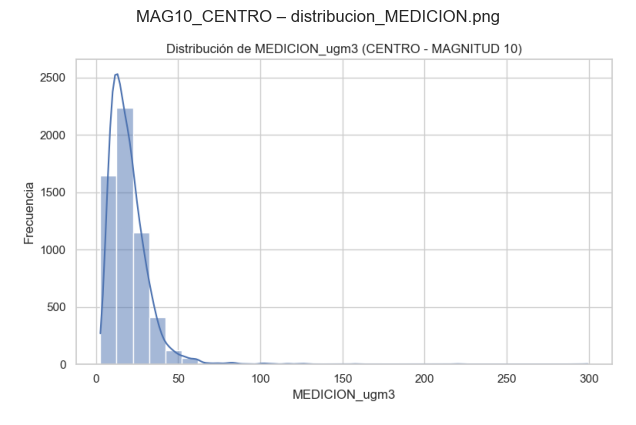

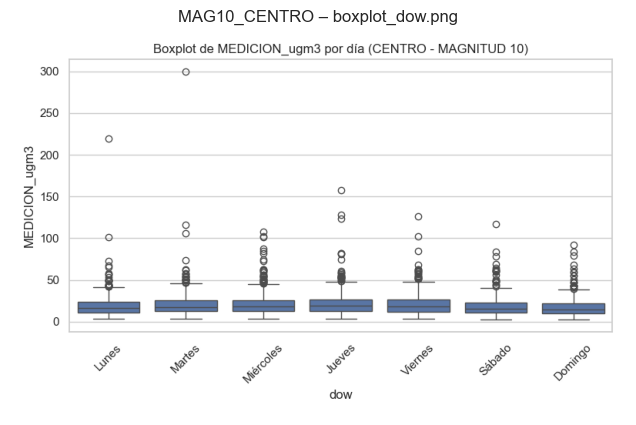

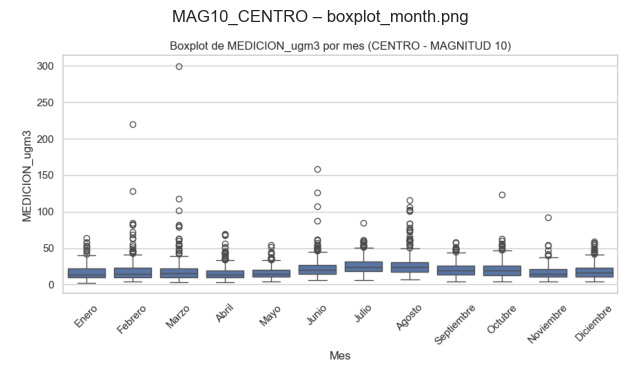

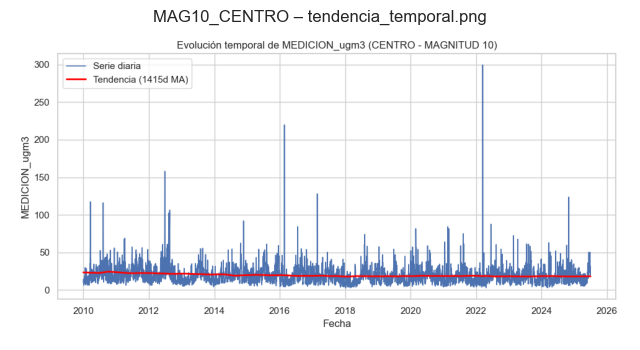

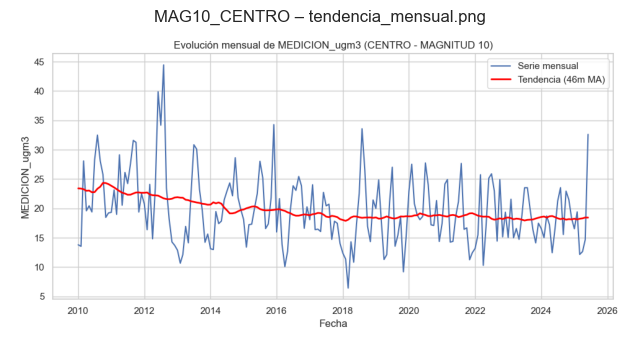

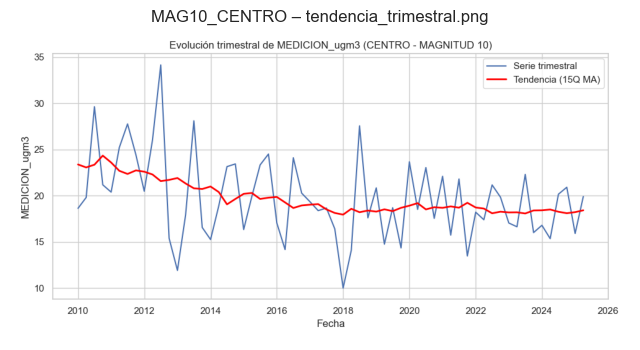

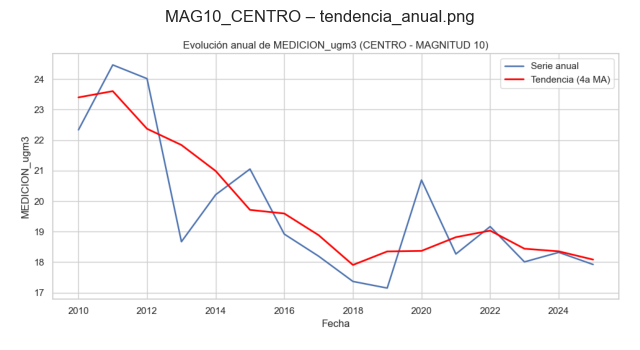

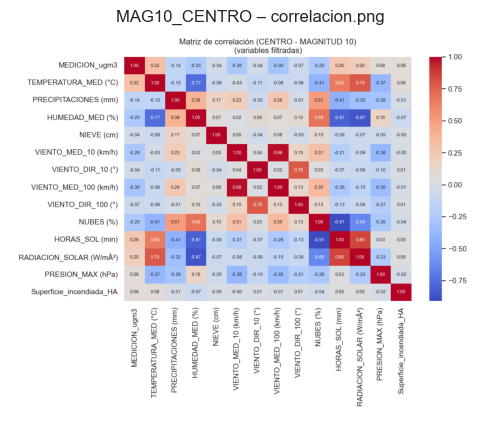



📊 Resultados para MAG10_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     20.629541
std      13.070300
min       1.666667
max     381.666667
25%      12.666667
50%      18.333333
75%      25.666667
Name: MEDICION_ugm3, dtype: float64


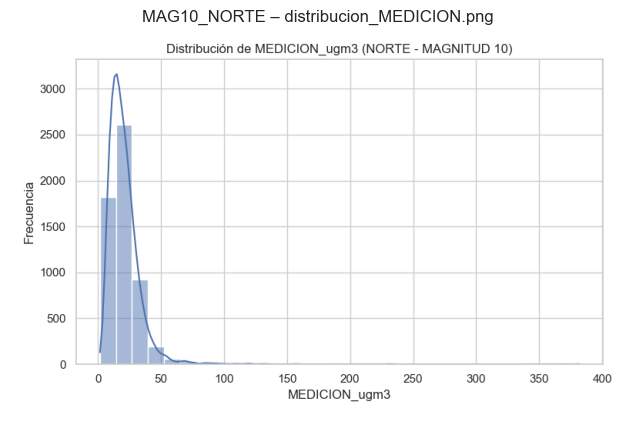

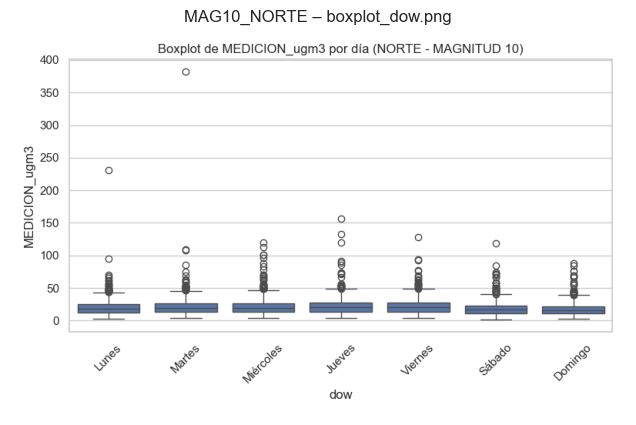

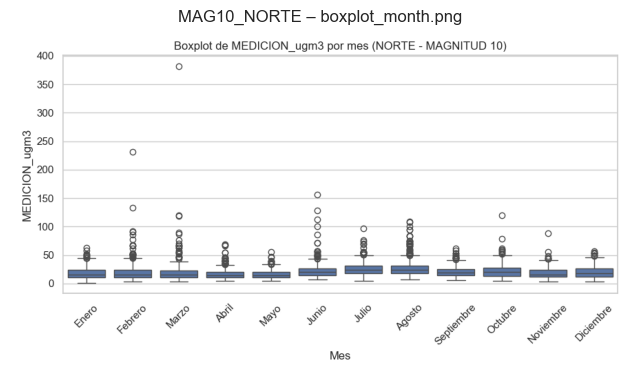

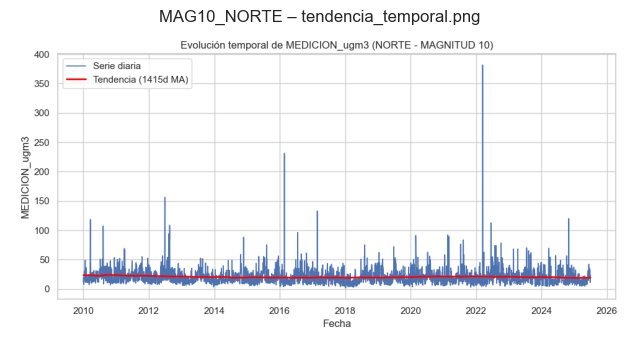

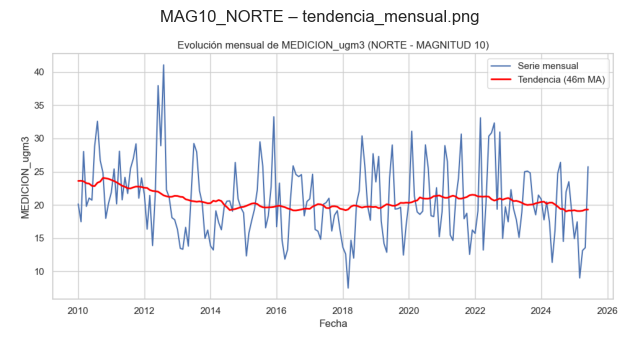

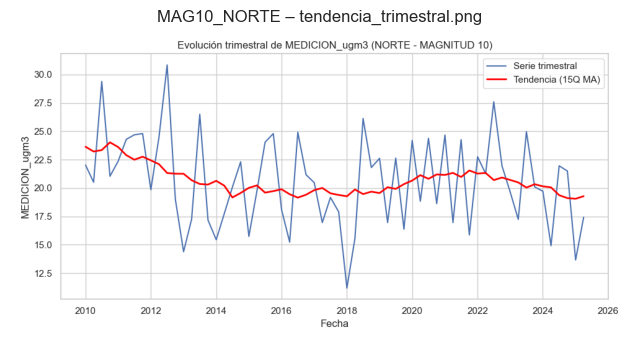

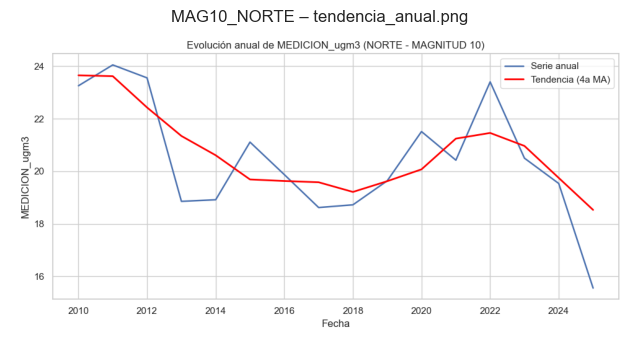

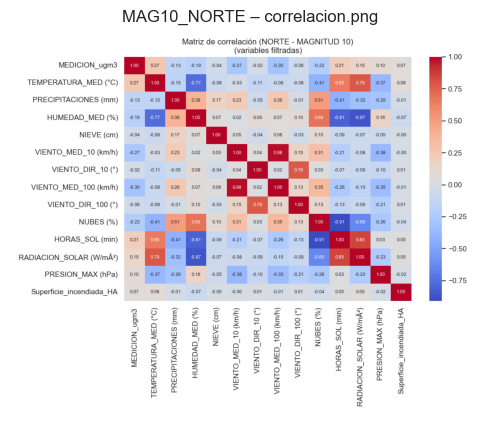



📊 Resultados para MAG10_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     20.223384
std      13.003136
min       3.000000
max     373.000000
25%      12.000000
50%      18.000000
75%      25.339288
Name: MEDICION_ugm3, dtype: float64


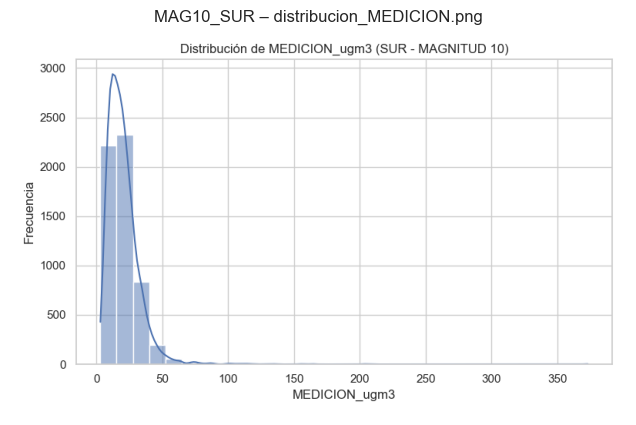

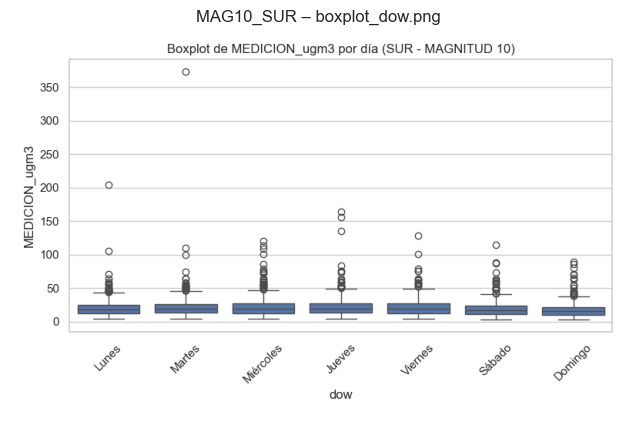

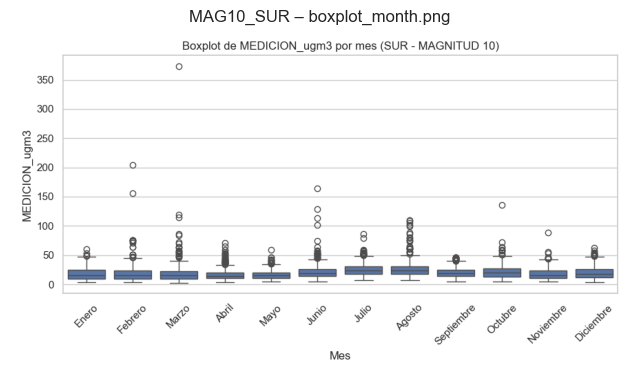

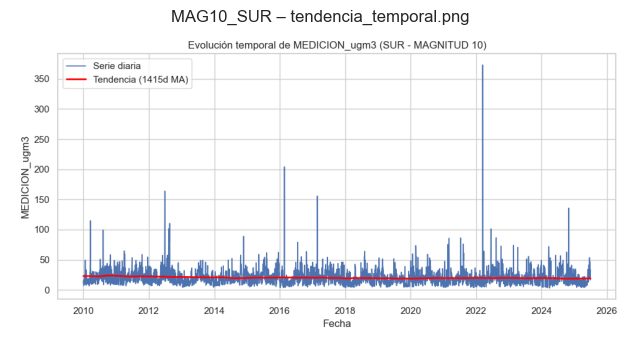

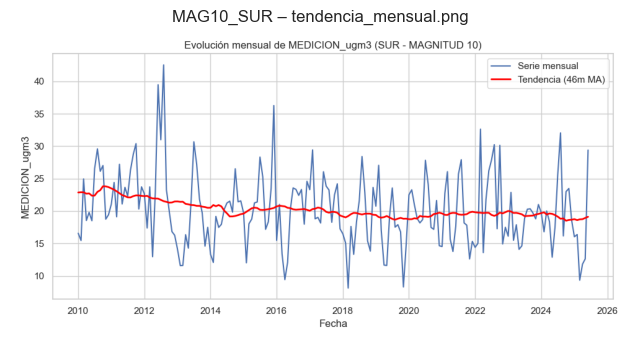

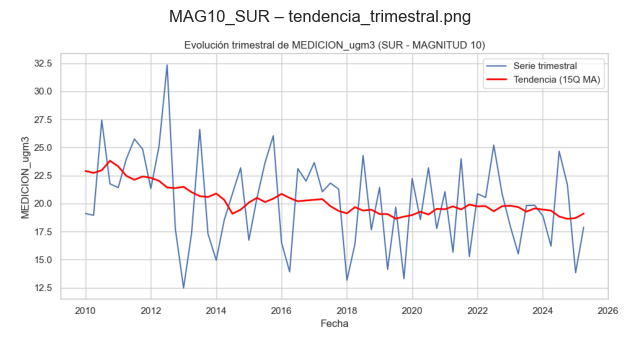

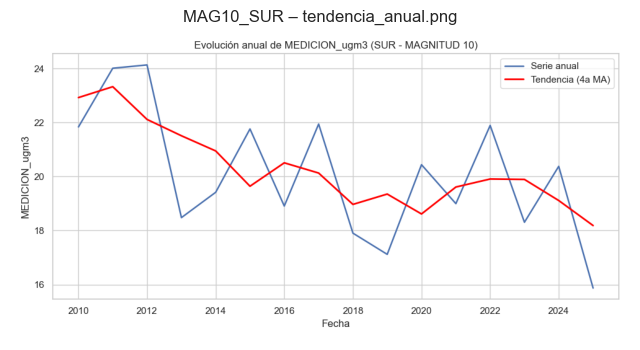

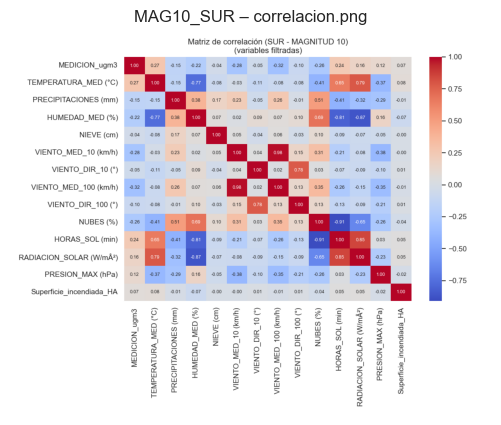



📊 Resultados para MAG12_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     55.701188
std      45.166696
min       6.000000
max     381.666667
25%      26.995680
50%      41.833333
75%      66.500000
Name: MEDICION_ugm3, dtype: float64


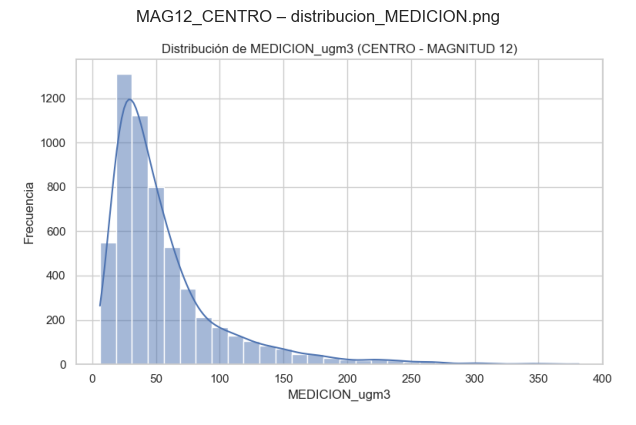

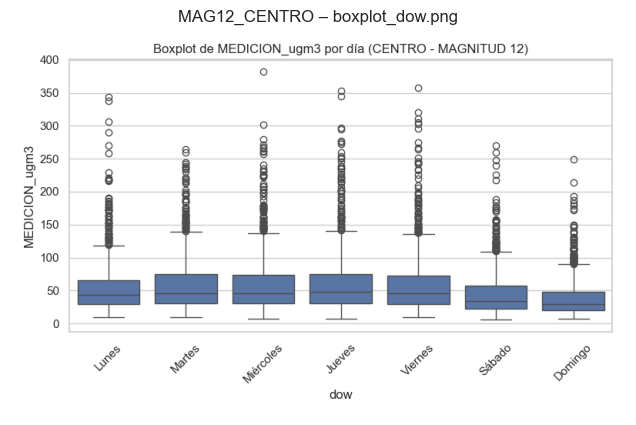

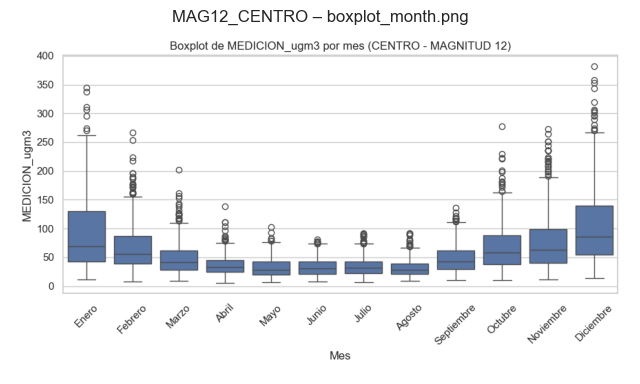

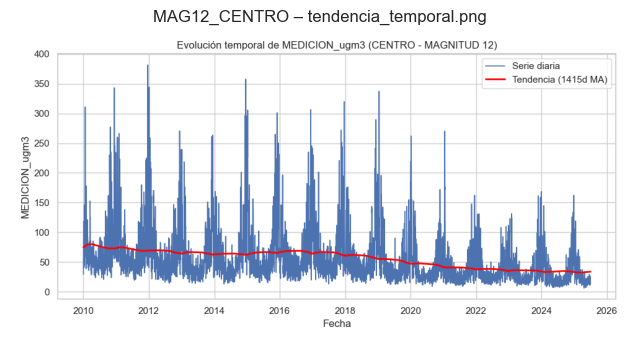

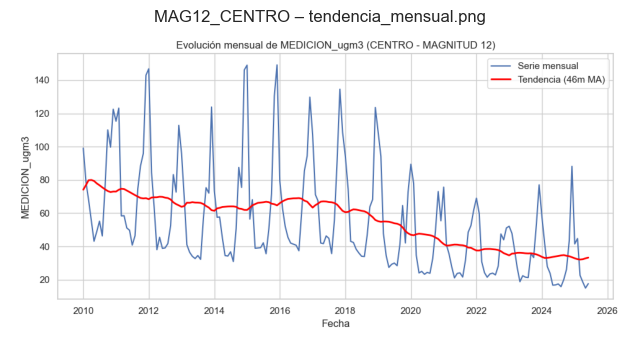

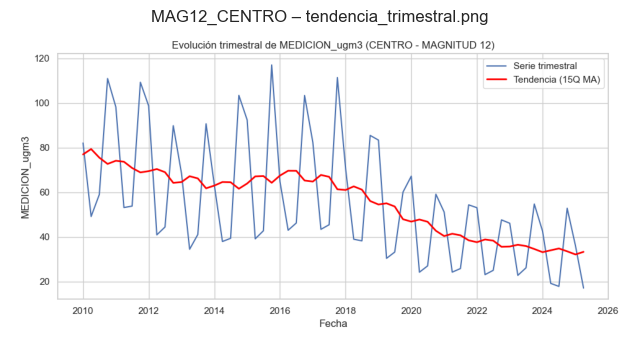

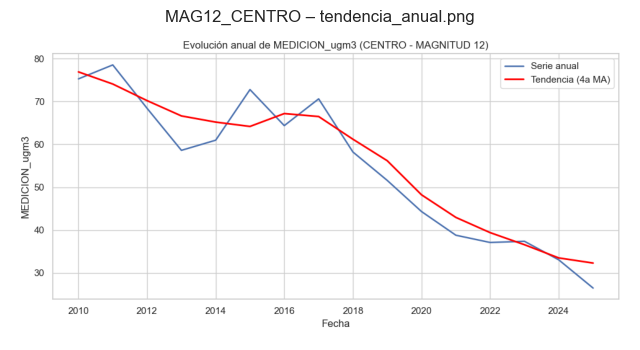

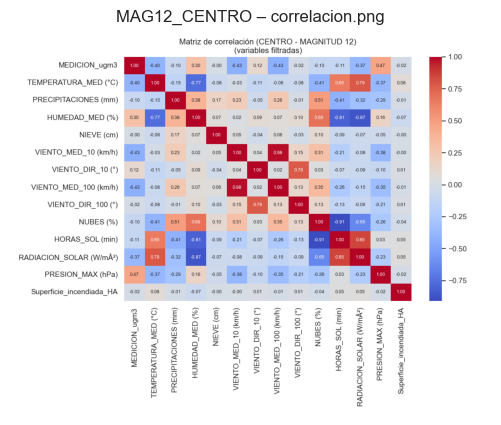



📊 Resultados para MAG12_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     62.268775
std      48.681460
min       6.277778
max     434.694444
25%      30.437500
50%      48.611111
75%      75.729167
Name: MEDICION_ugm3, dtype: float64


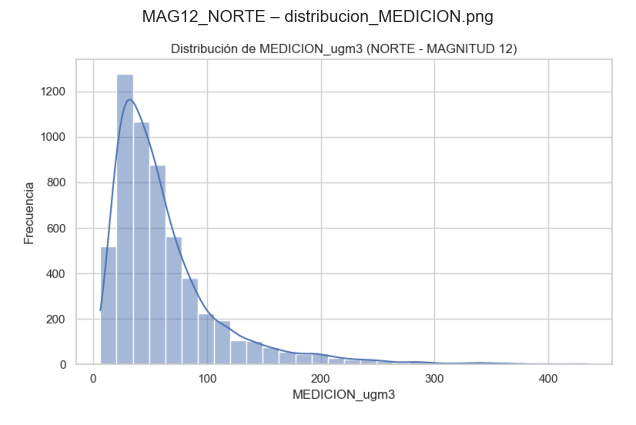

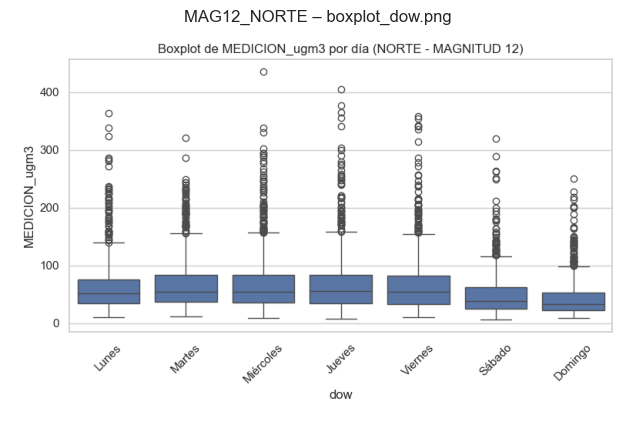

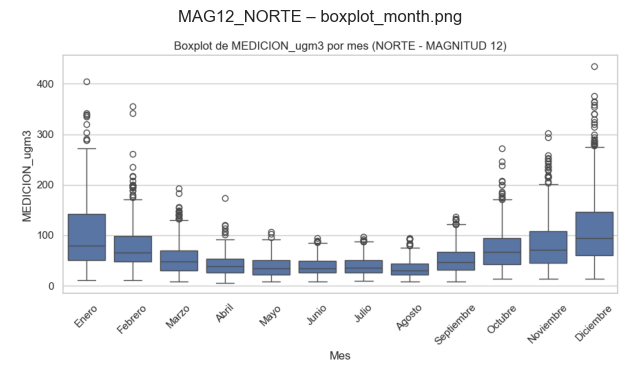

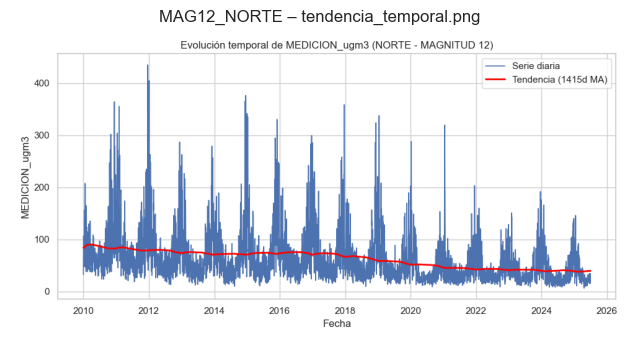

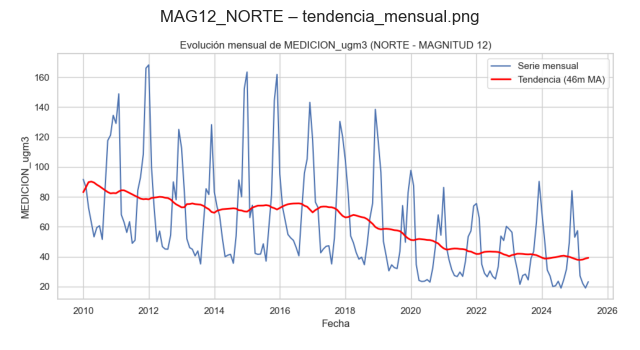

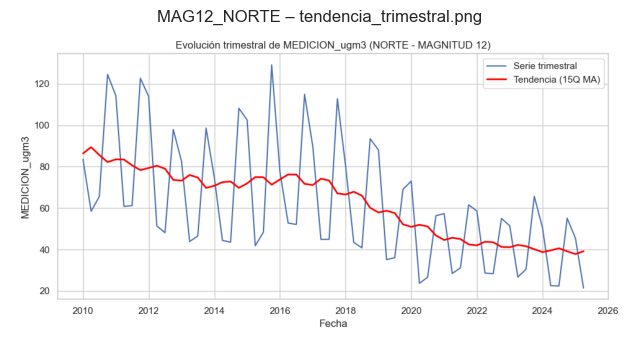

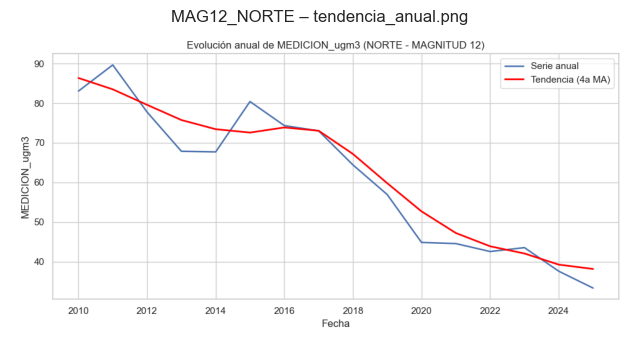

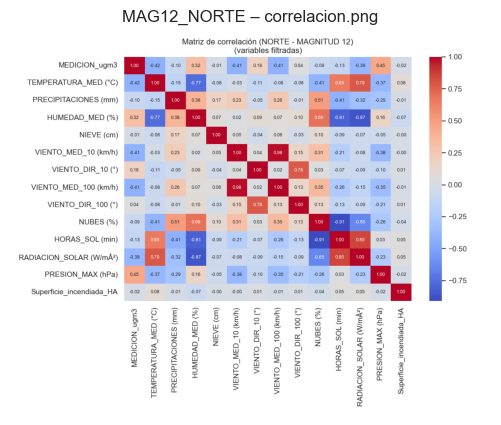



📊 Resultados para MAG12_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     61.379074
std      57.056491
min       5.833333
max     418.500000
25%      25.833333
50%      40.333333
75%      73.208333
Name: MEDICION_ugm3, dtype: float64


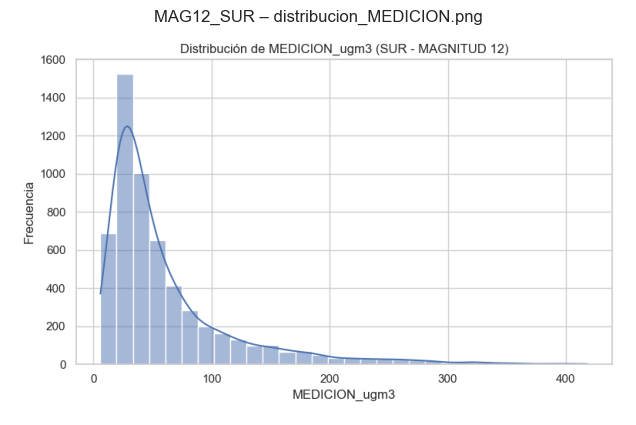

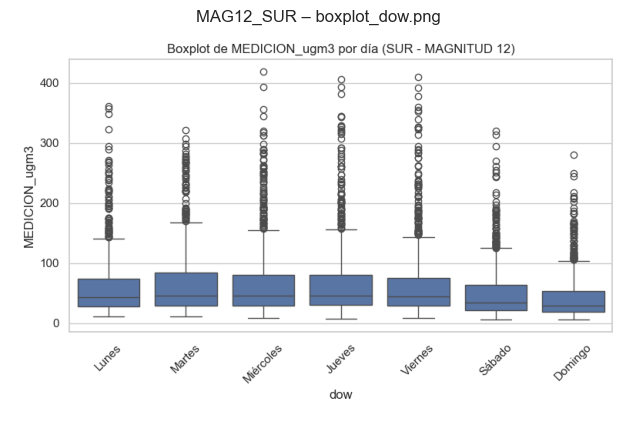

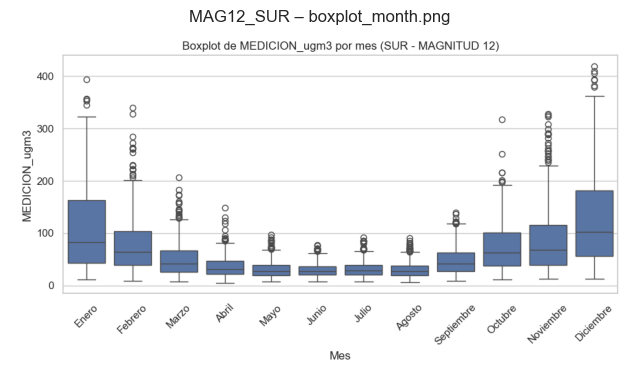

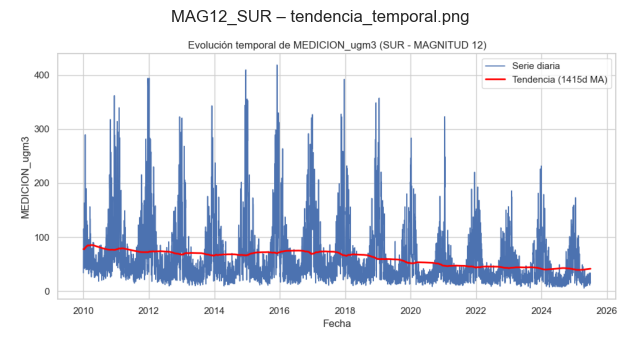

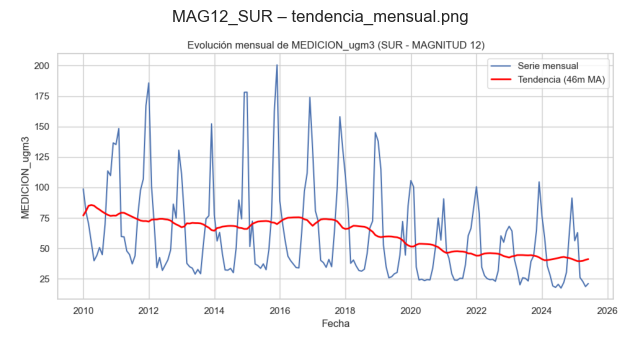

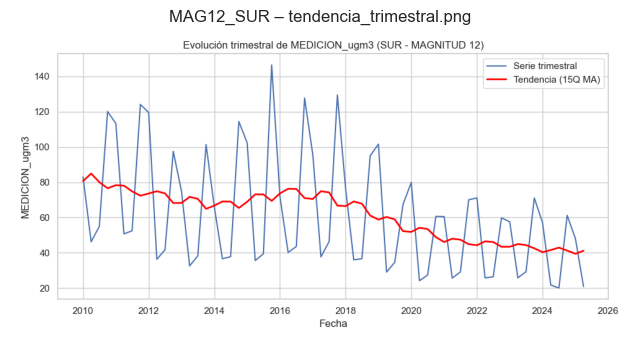

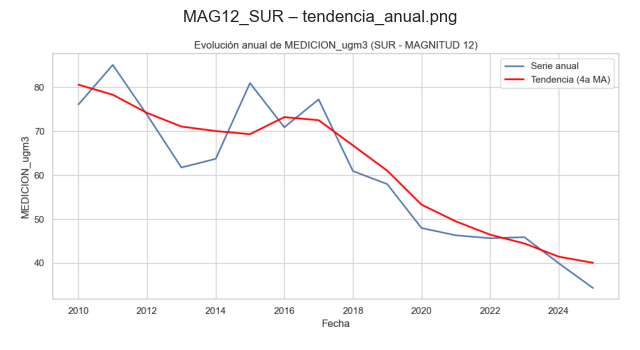

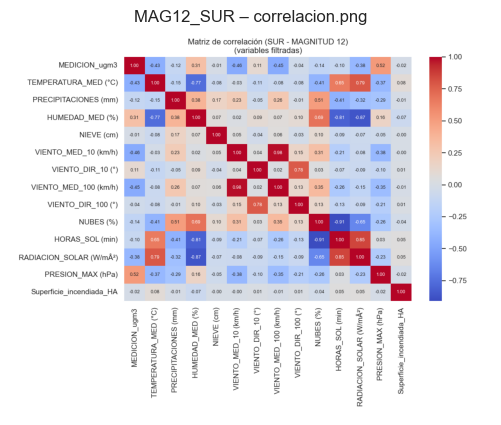



📊 Resultados para MAG14_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     50.026429
std      23.056443
min       1.833333
max     114.000000
25%      32.641556
50%      51.708333
75%      67.666667
Name: MEDICION_ugm3, dtype: float64


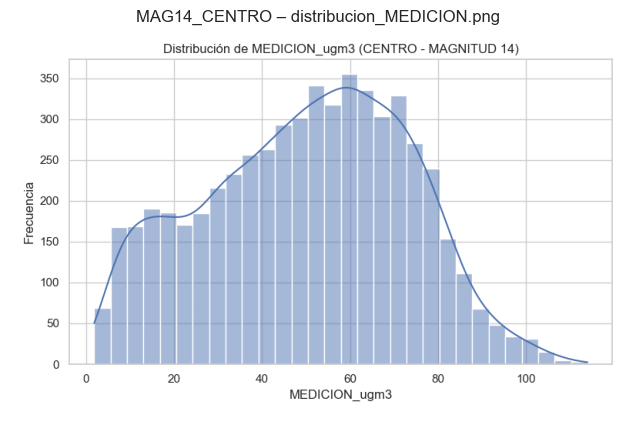

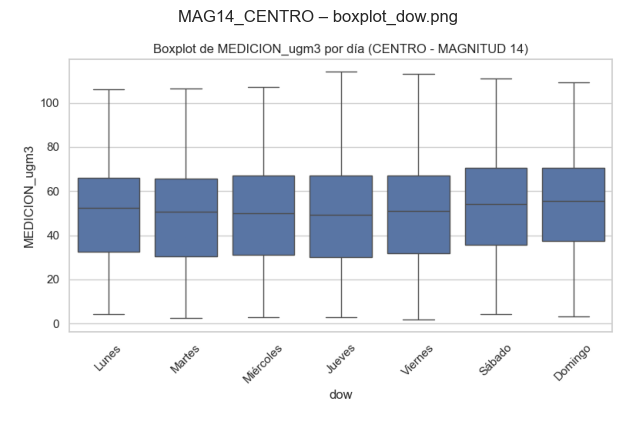

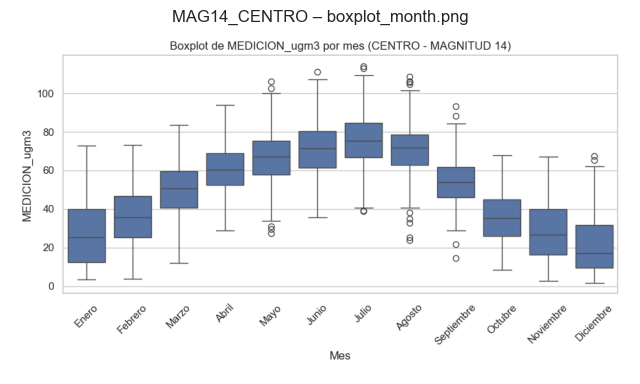

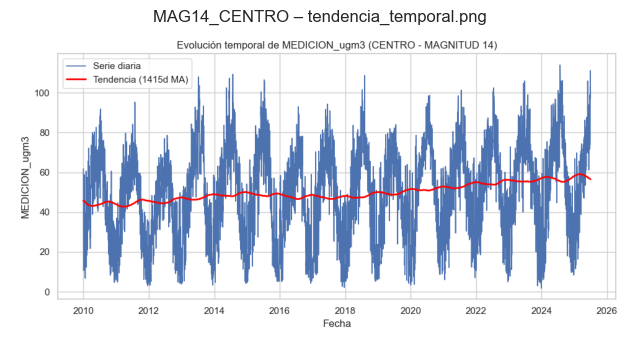

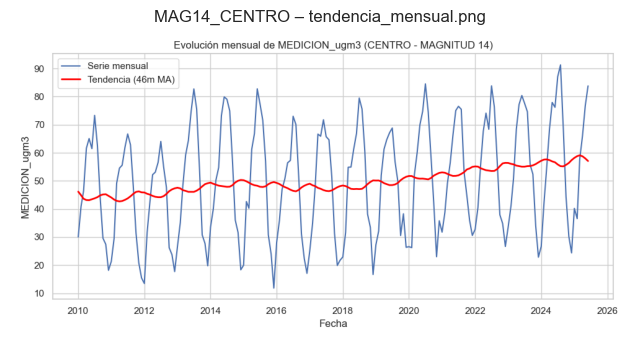

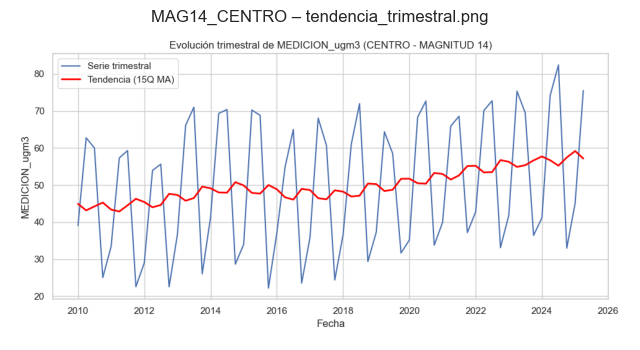

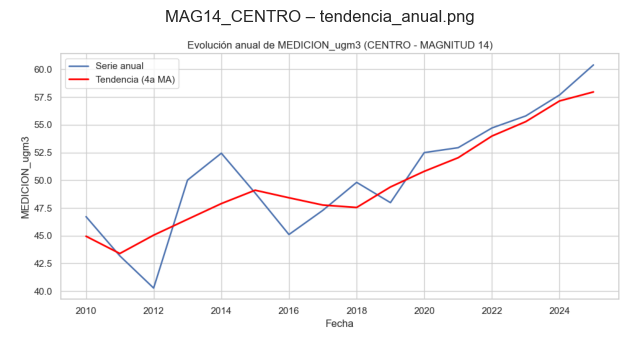

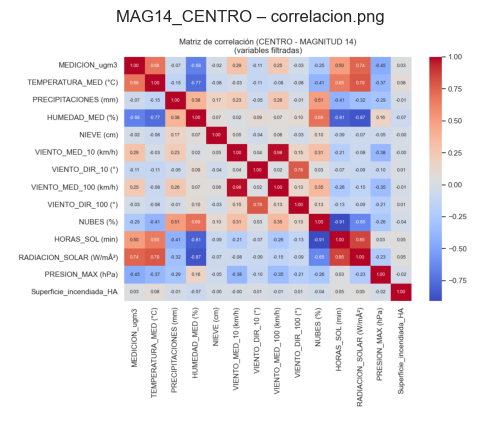



📊 Resultados para MAG14_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     53.000305
std      23.594076
min       2.750000
max     118.500000
25%      34.750000
50%      55.160354
75%      71.500000
Name: MEDICION_ugm3, dtype: float64


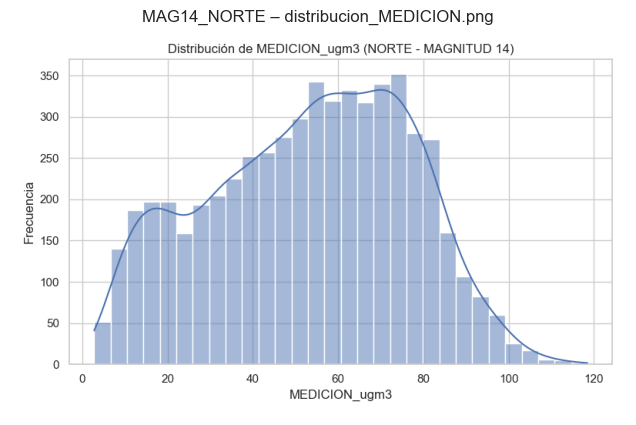

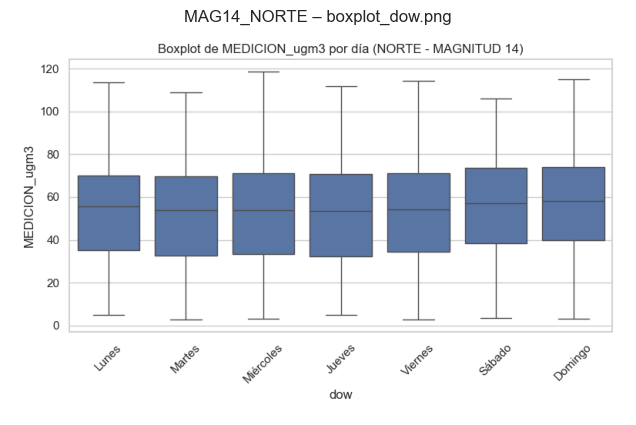

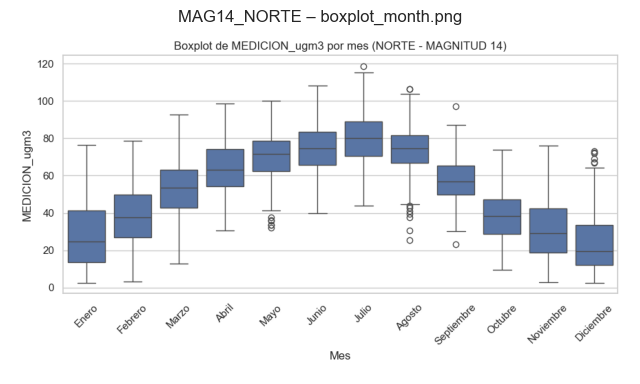

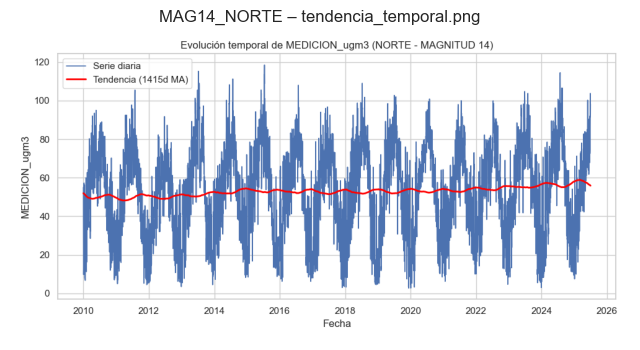

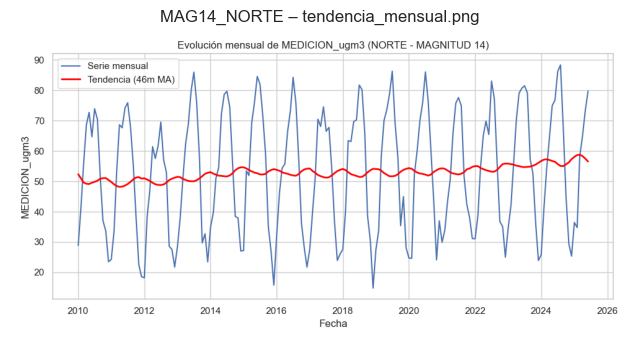

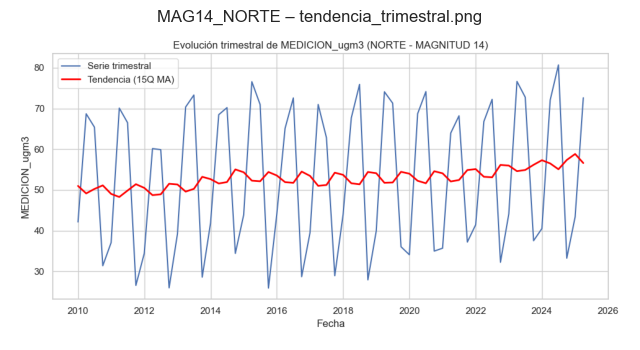

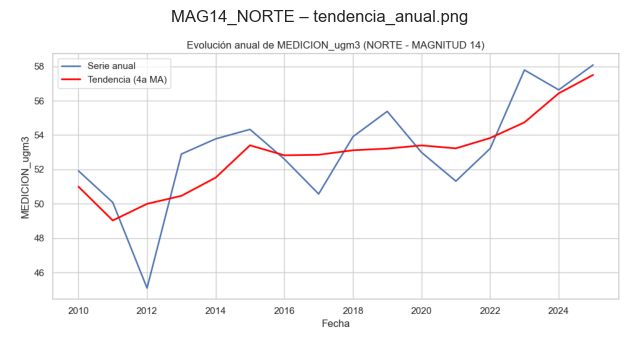

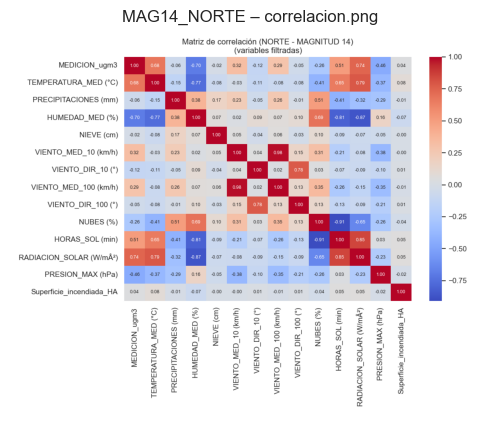



📊 Resultados para MAG14_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     48.848541
std      23.488046
min       1.750000
max     109.250000
25%      30.750000
50%      51.000000
75%      66.959843
Name: MEDICION_ugm3, dtype: float64


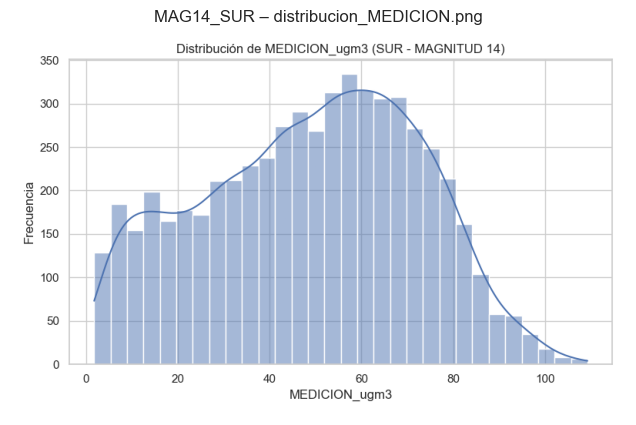

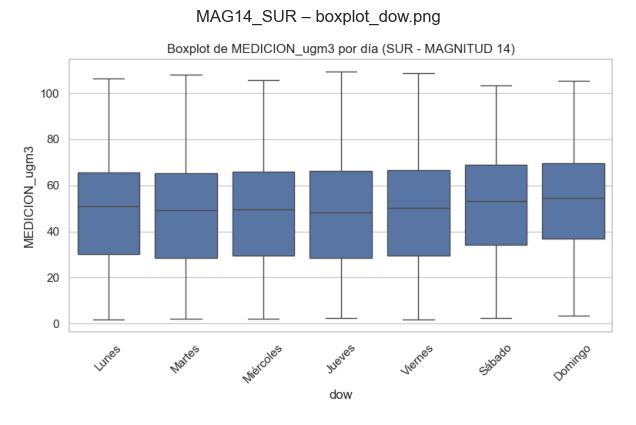

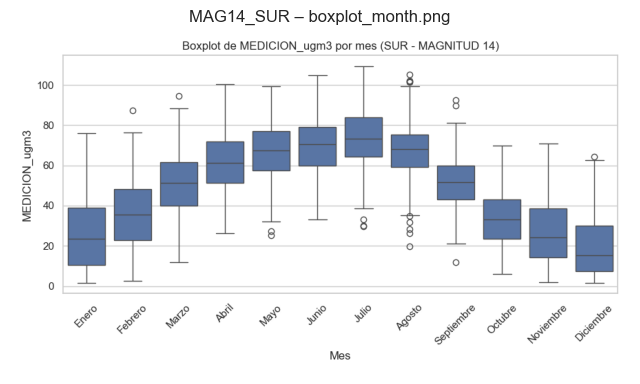

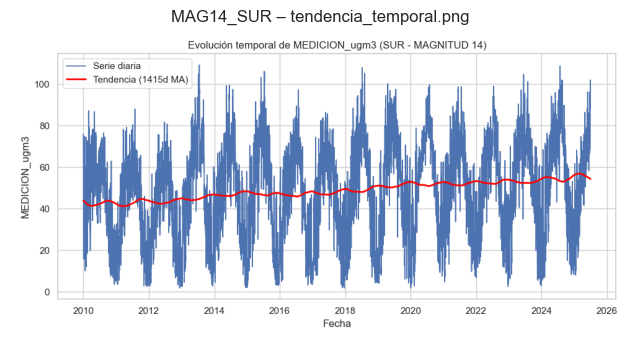

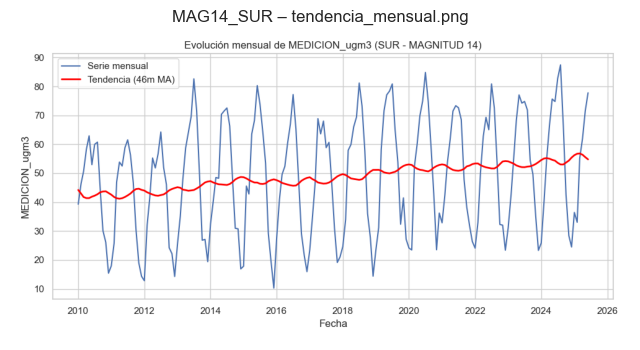

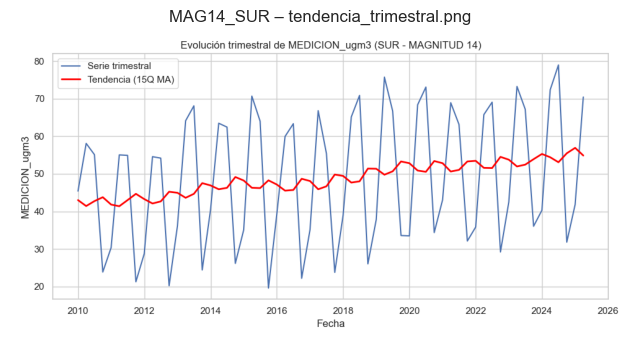

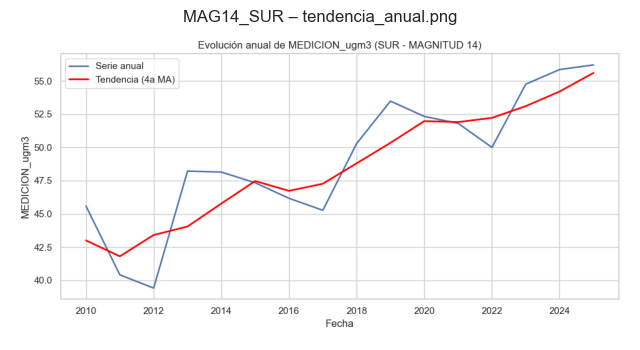

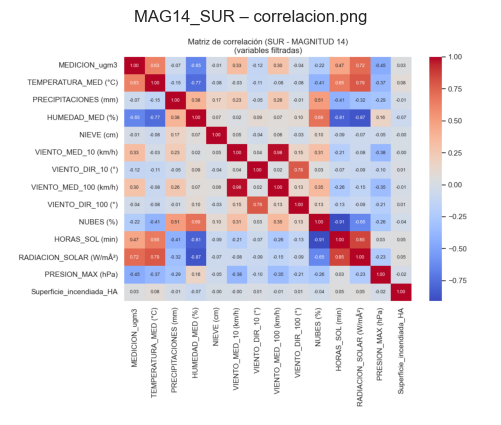



📊 Resultados para MAG1_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     5.767992
std      3.041944
min      0.000000
max     23.500000
25%      3.666667
50%      5.000000
75%      7.333333
Name: MEDICION_ugm3, dtype: float64


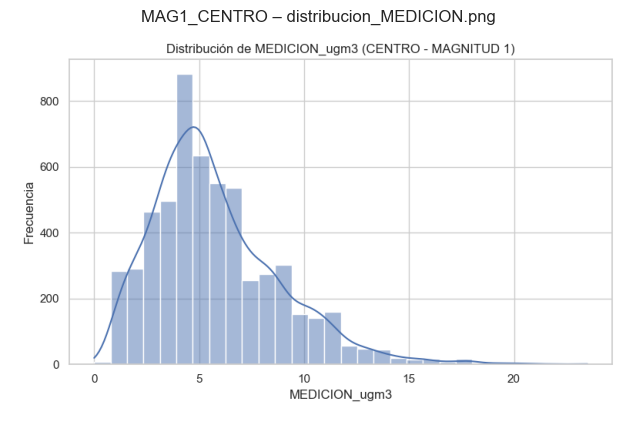

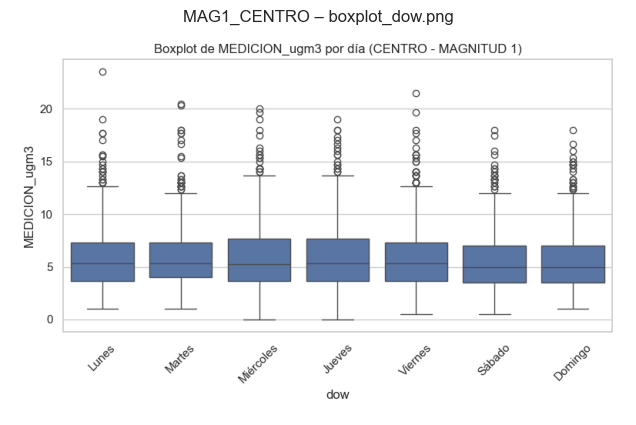

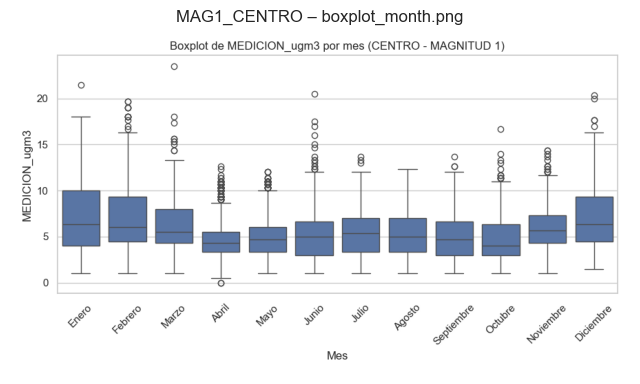

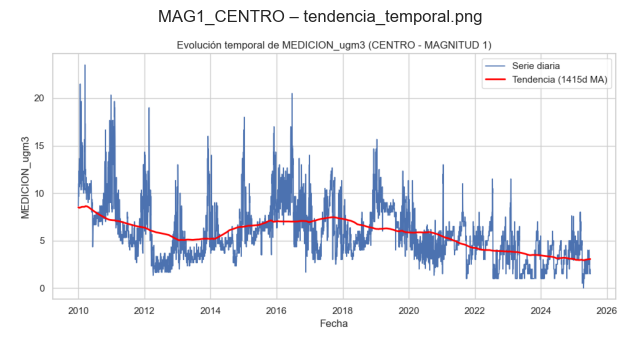

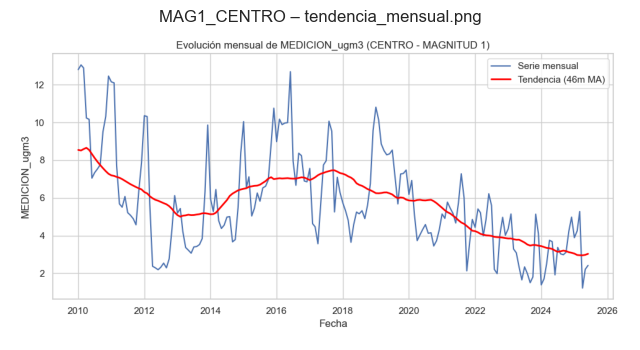

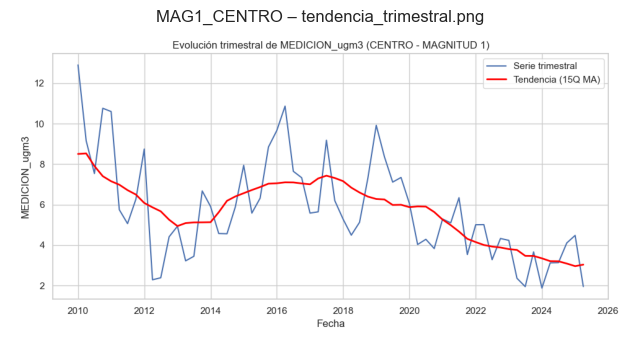

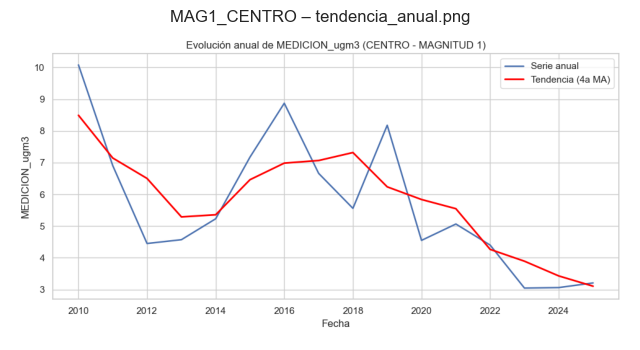

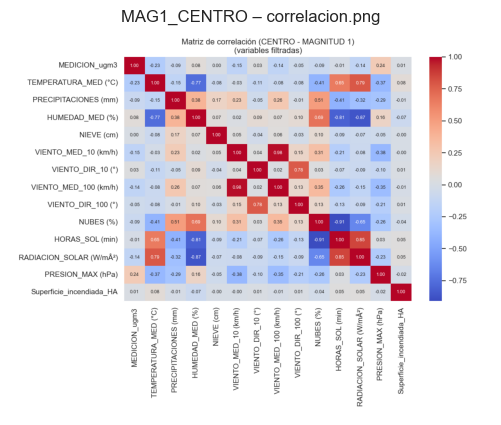



📊 Resultados para MAG1_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     5.039978
std      3.505759
min      1.000000
max     24.000000
25%      3.000000
50%      4.000000
75%      6.000000
Name: MEDICION_ugm3, dtype: float64


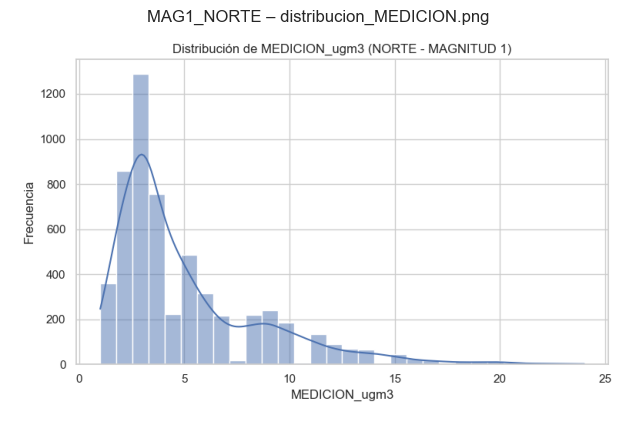

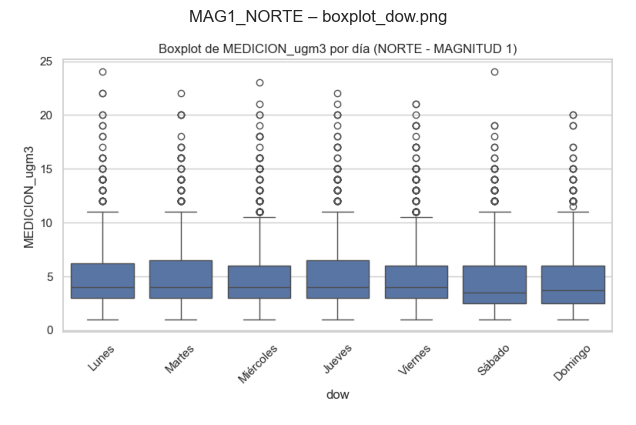

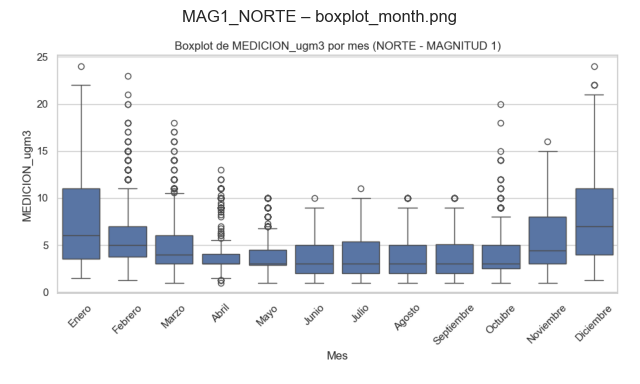

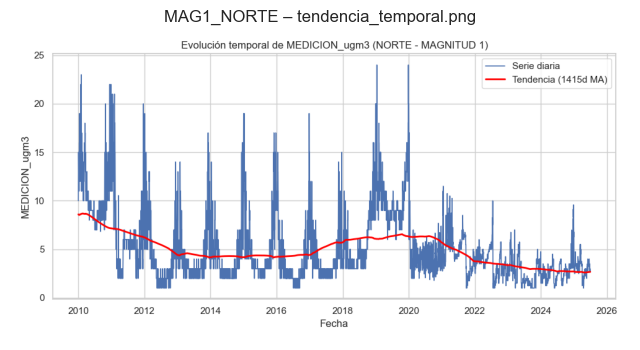

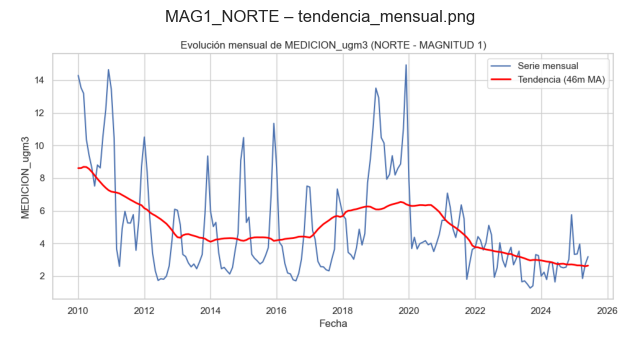

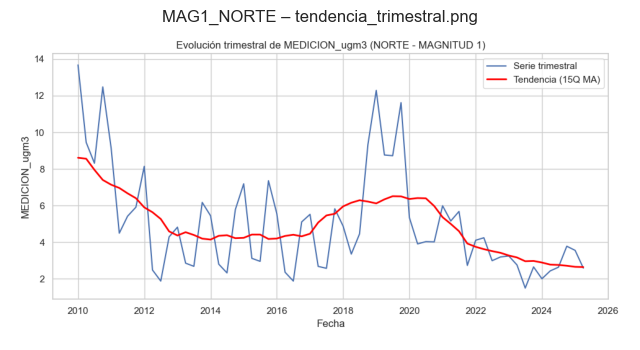

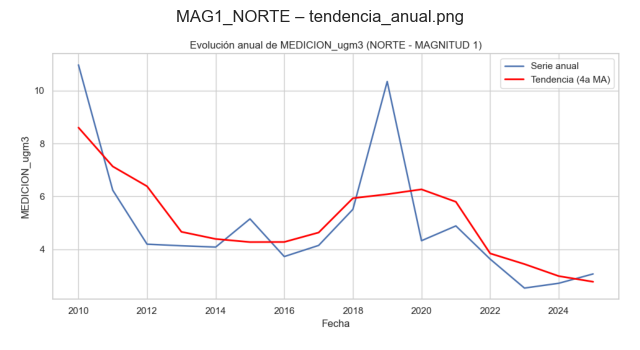

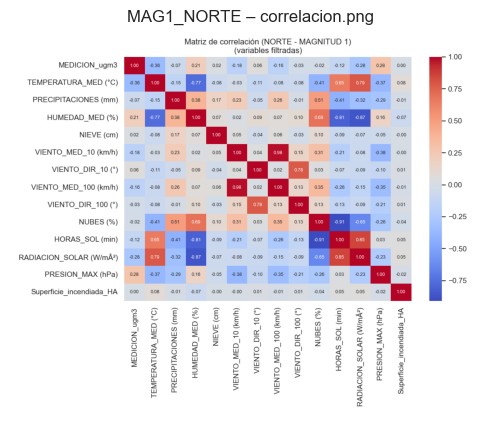



📊 Resultados para MAG1_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     5.401980
std      3.238657
min      1.000000
max     19.750000
25%      3.000000
50%      4.641584
75%      7.500000
Name: MEDICION_ugm3, dtype: float64


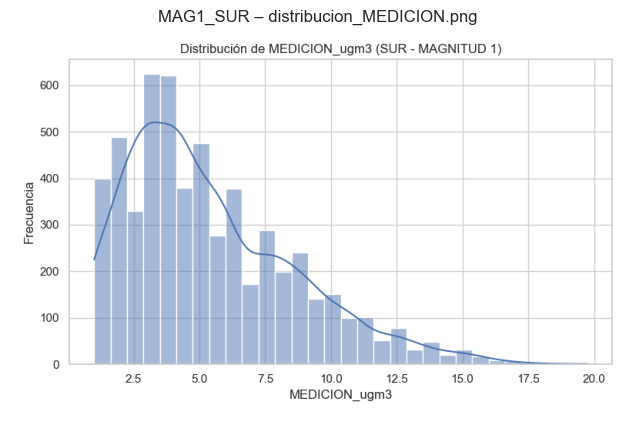

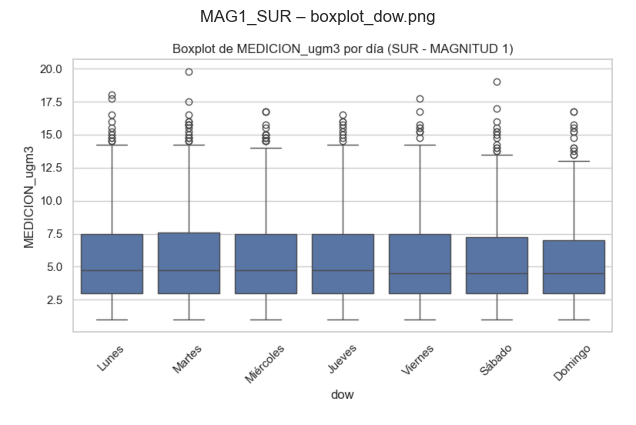

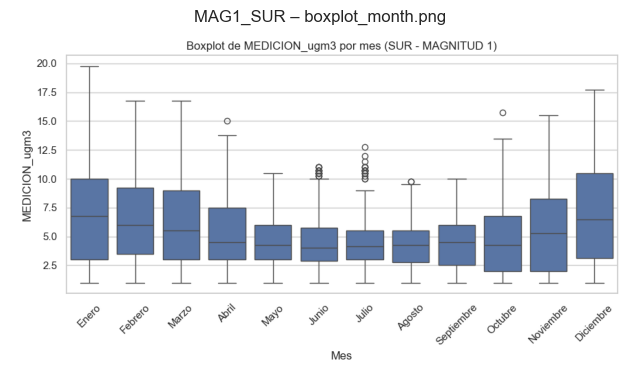

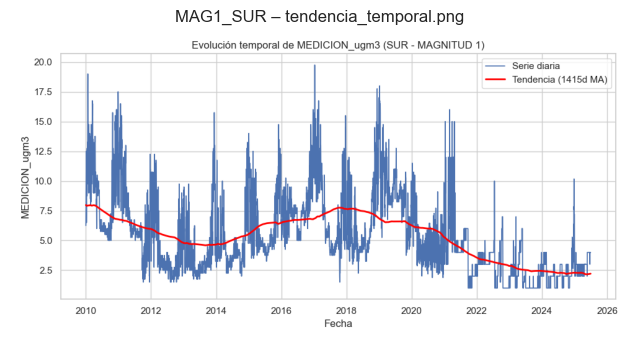

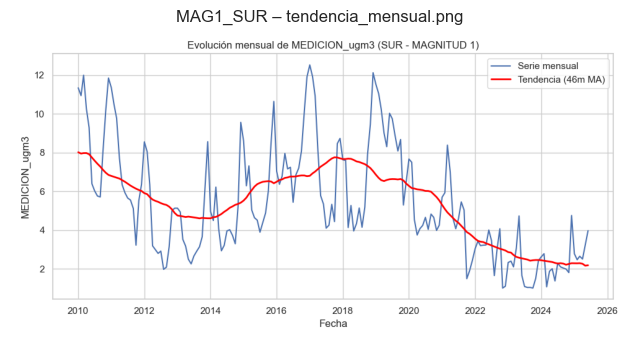

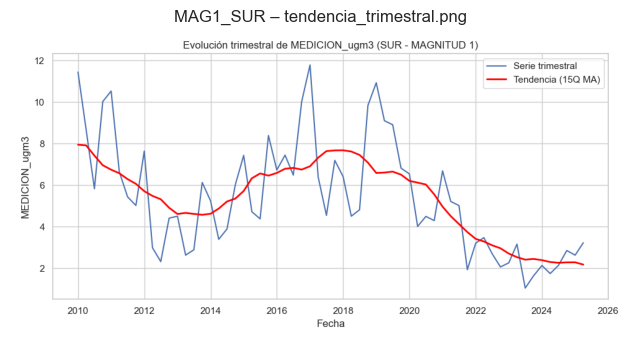

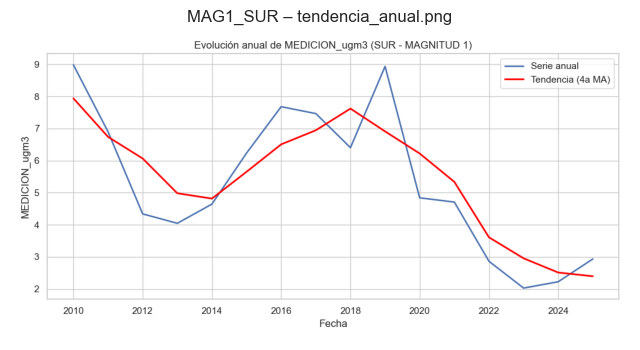

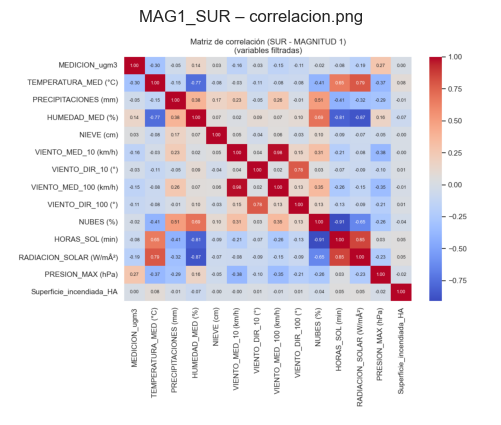



📊 Resultados para MAG20_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     2.339101
std      1.778452
min      0.100000
max     18.300000
25%      1.100000
50%      1.850000
75%      3.050000
Name: MEDICION_ugm3, dtype: float64


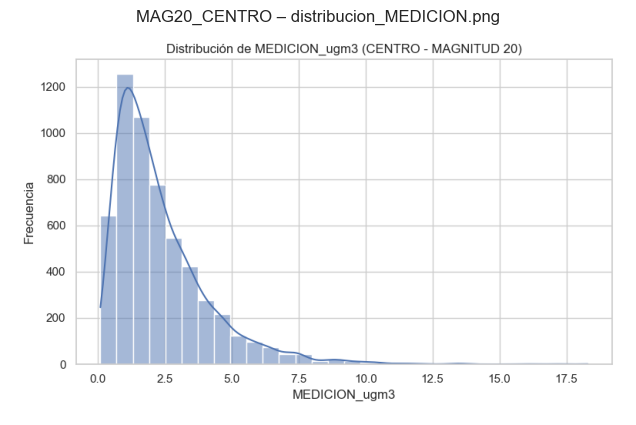

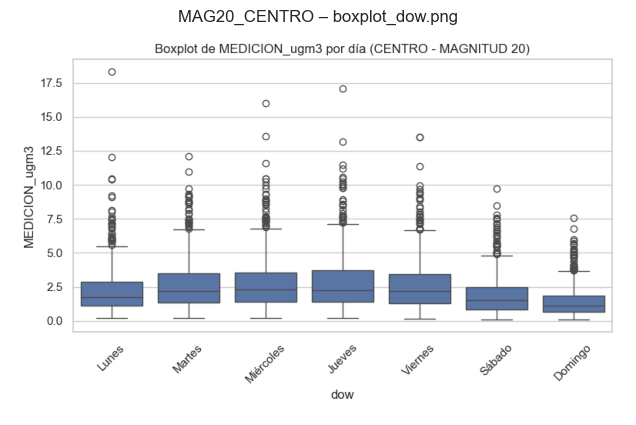

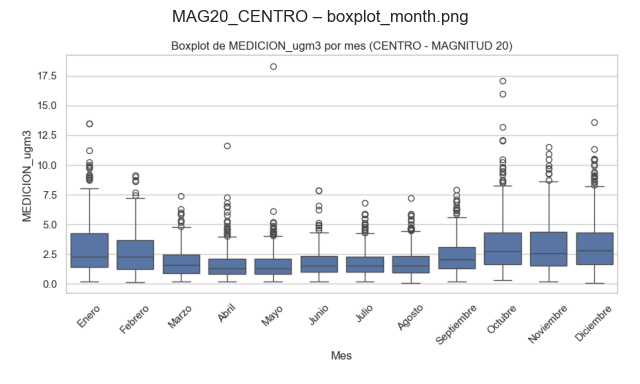

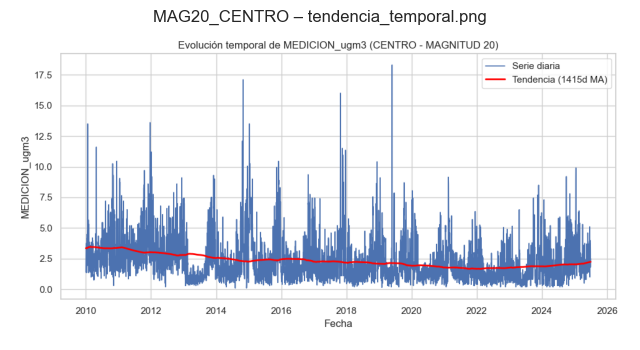

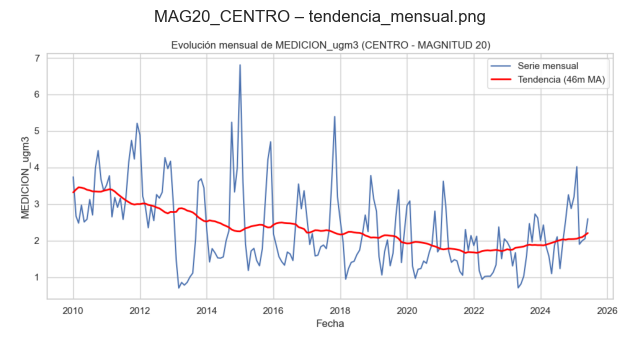

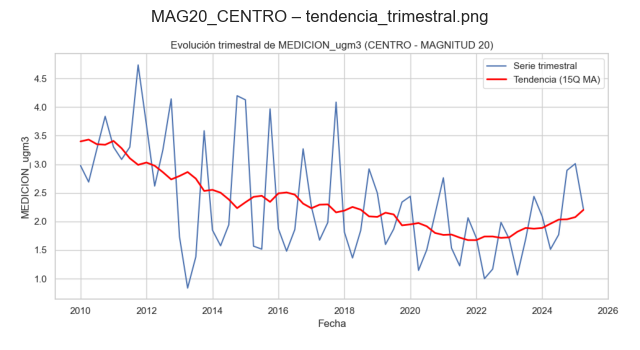

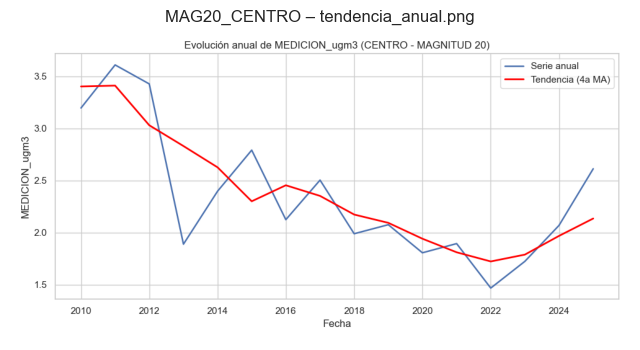

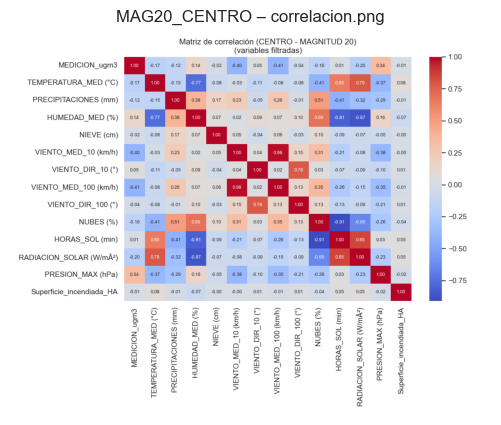



📊 Resultados para MAG20_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     2.632781
std      2.116853
min      0.125000
max     18.900000
25%      1.200000
50%      2.025000
75%      3.400000
Name: MEDICION_ugm3, dtype: float64


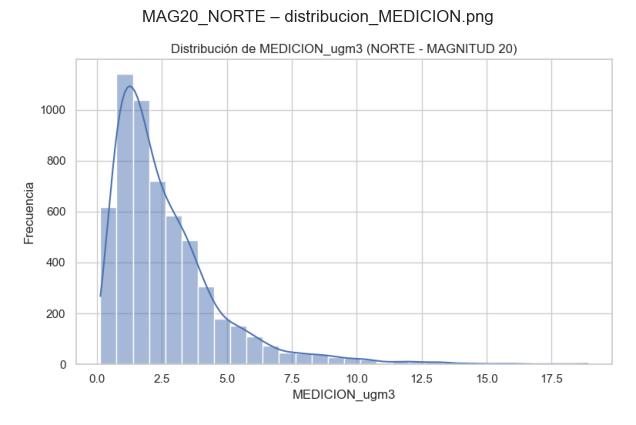

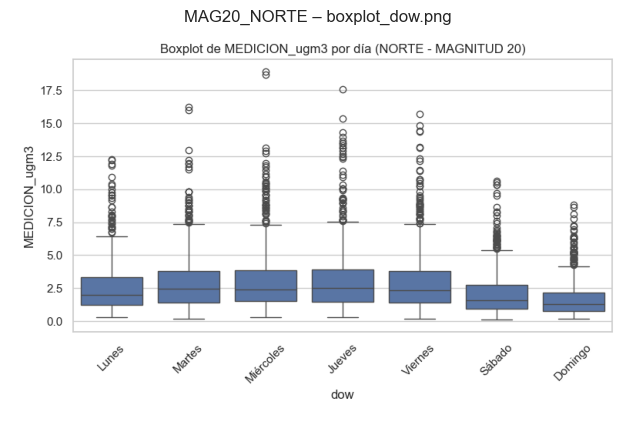

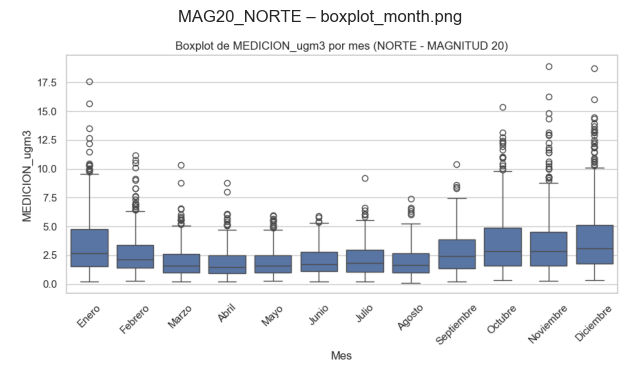

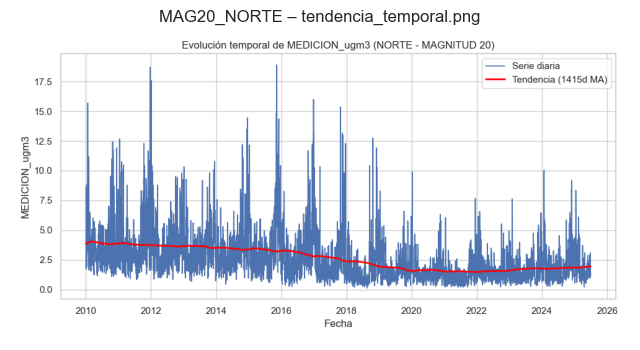

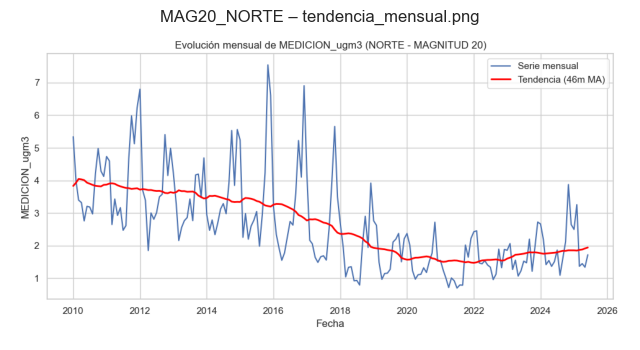

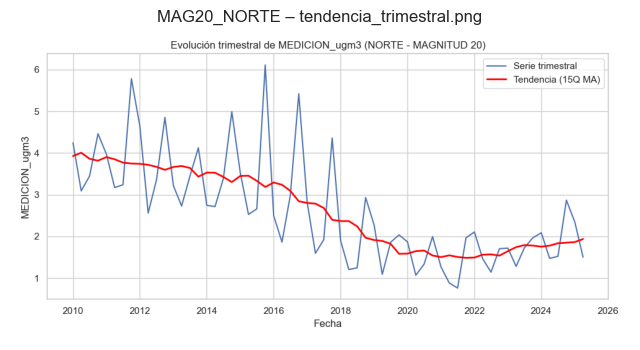

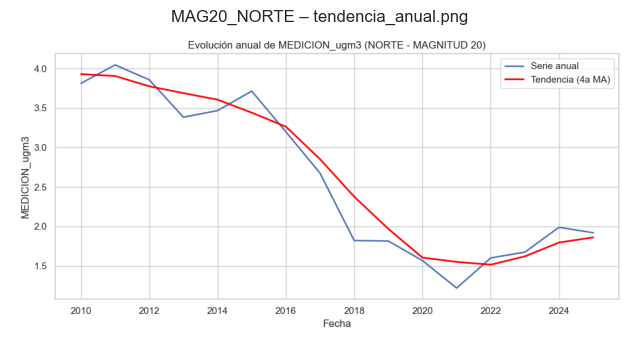

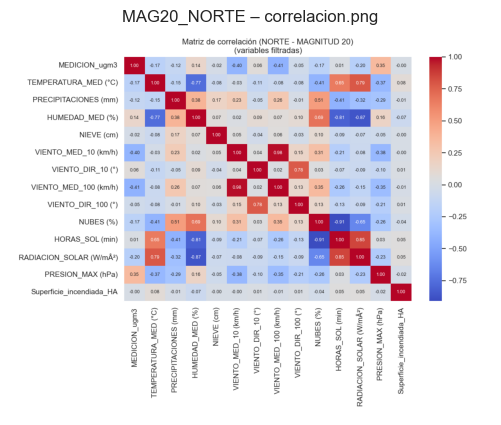



📊 Resultados para MAG20_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     1.942900
std      1.806518
min      0.100000
max     18.600000
25%      0.800000
50%      1.400000
75%      2.400000
Name: MEDICION_ugm3, dtype: float64


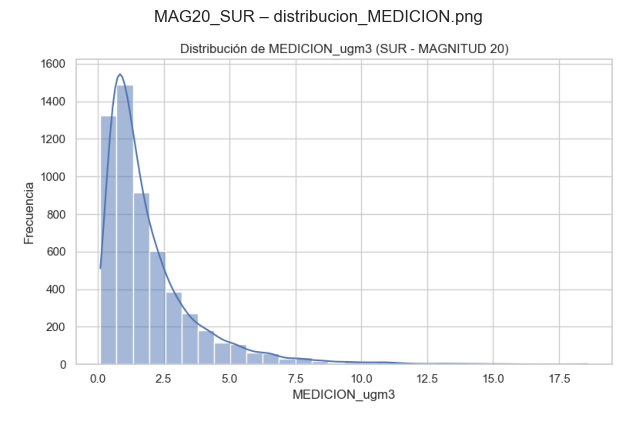

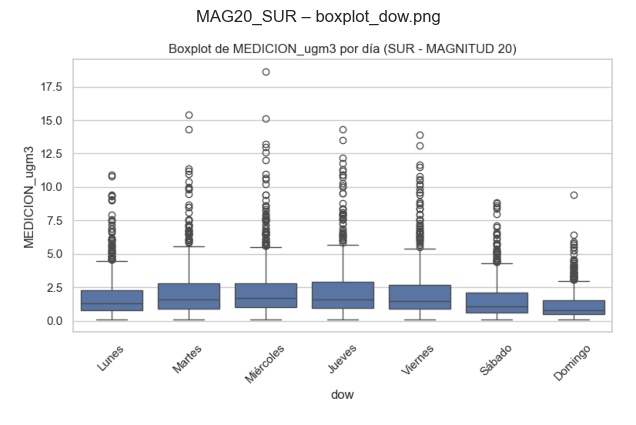

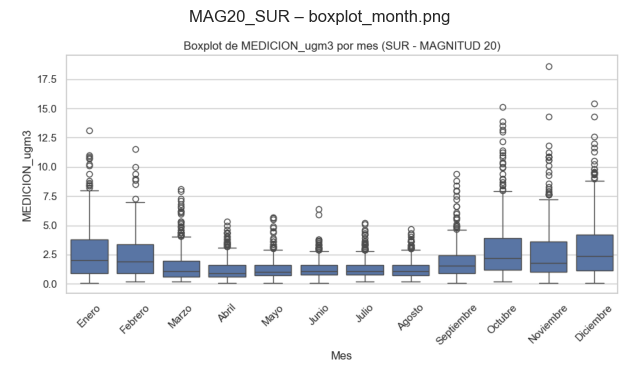

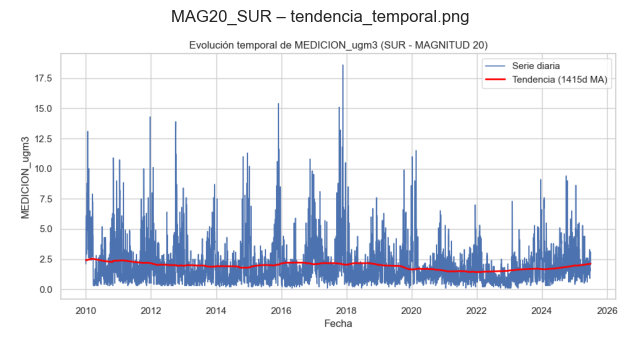

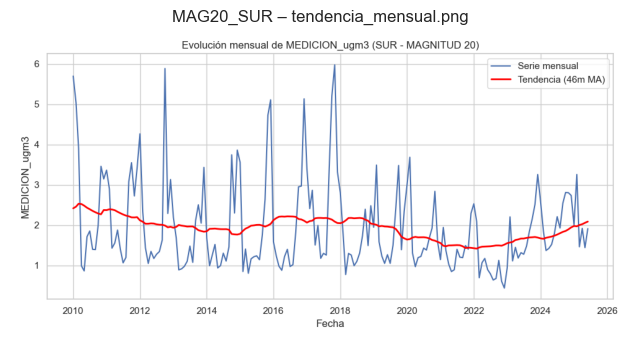

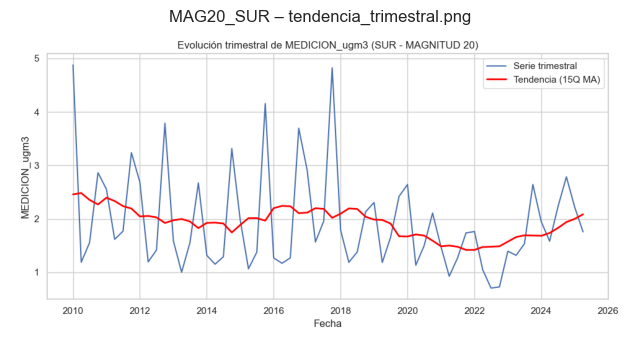

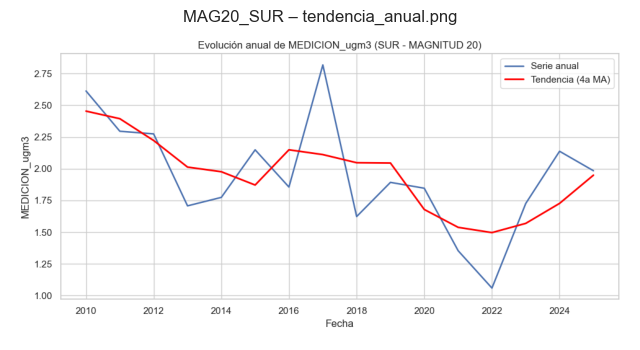

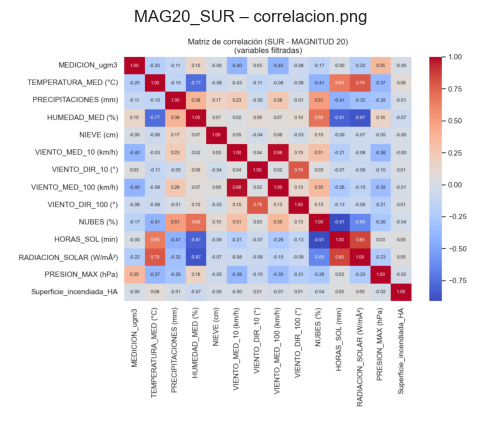



📊 Resultados para MAG30_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    0.520155
std     0.375143
min     0.100000
max     3.100000
25%     0.250000
50%     0.400000
75%     0.650000
Name: MEDICION_ugm3, dtype: float64


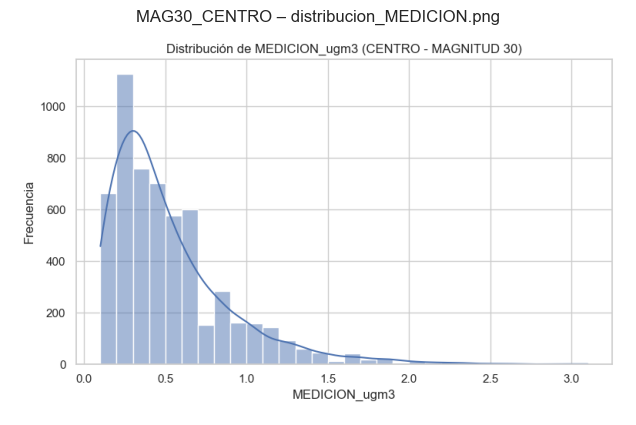

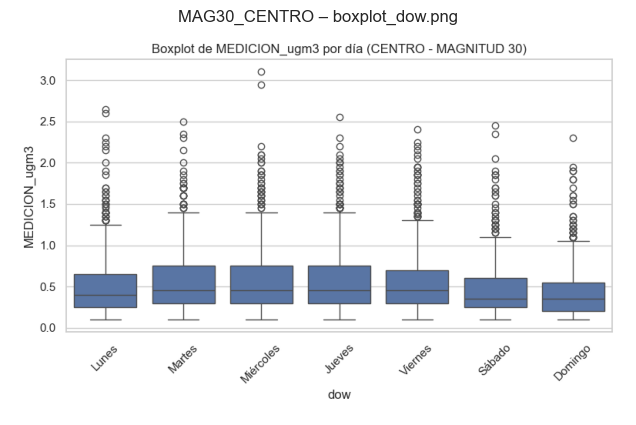

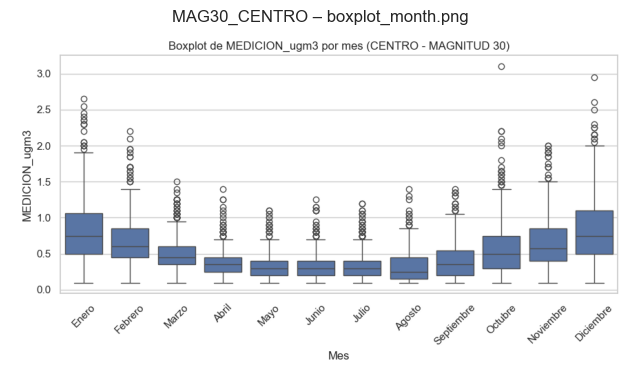

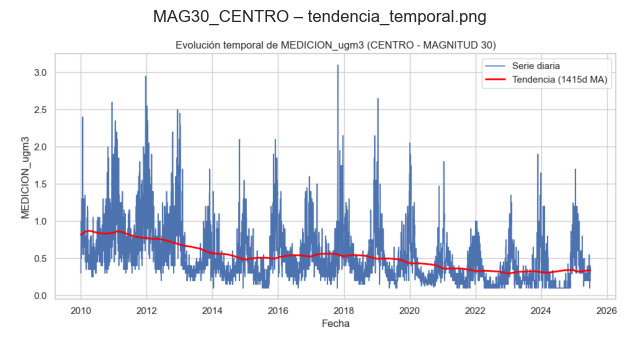

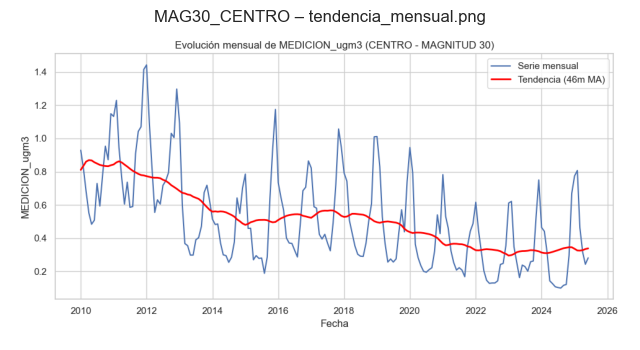

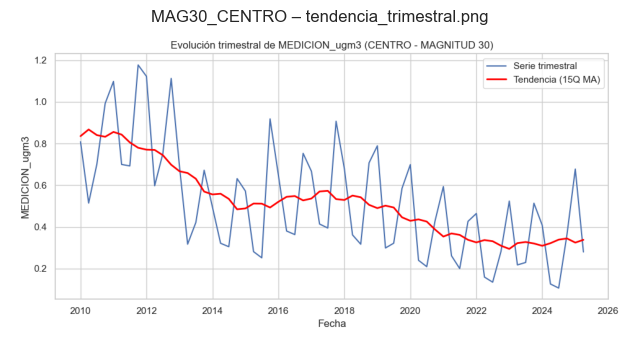

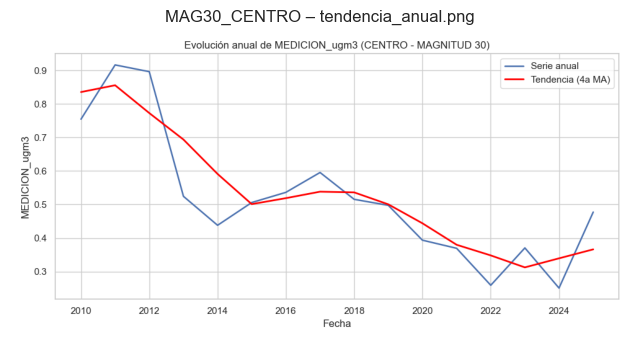

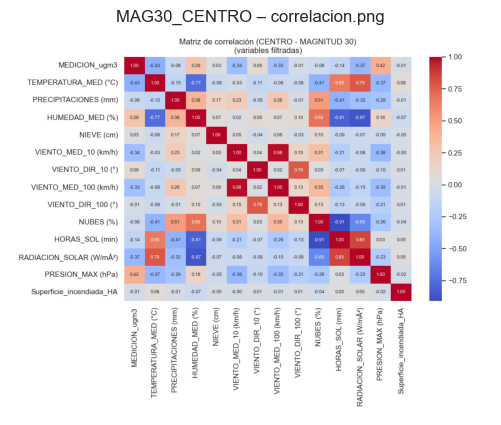



📊 Resultados para MAG30_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    0.622452
std     0.477855
min     0.100000
max     4.400000
25%     0.300000
50%     0.496164
75%     0.800000
Name: MEDICION_ugm3, dtype: float64


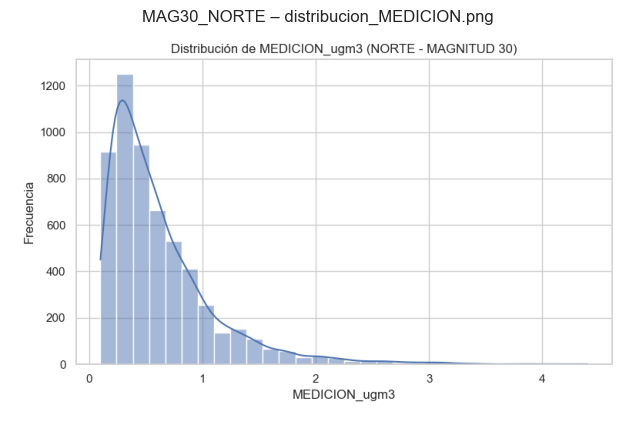

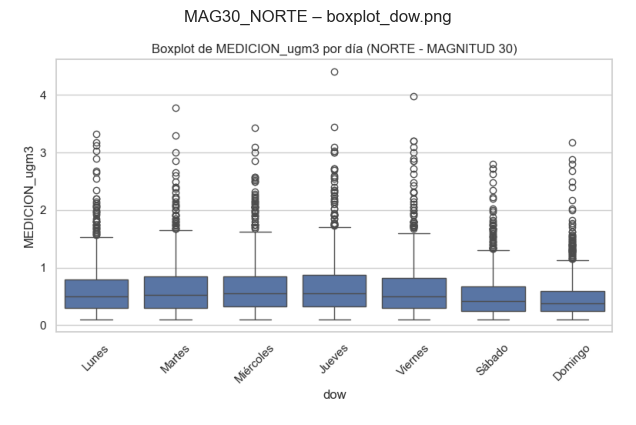

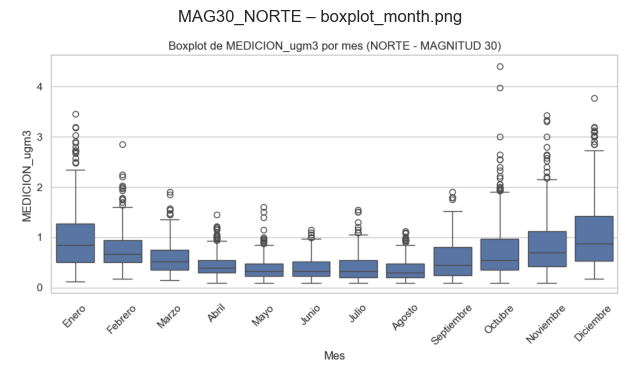

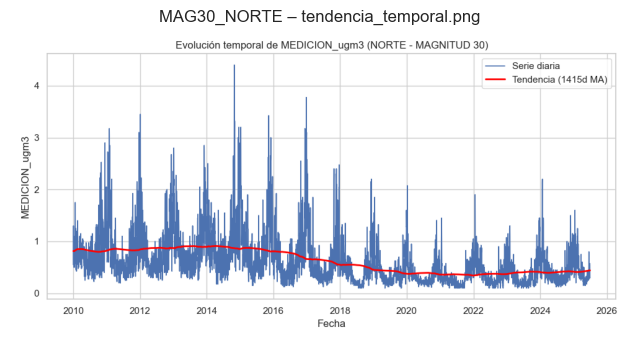

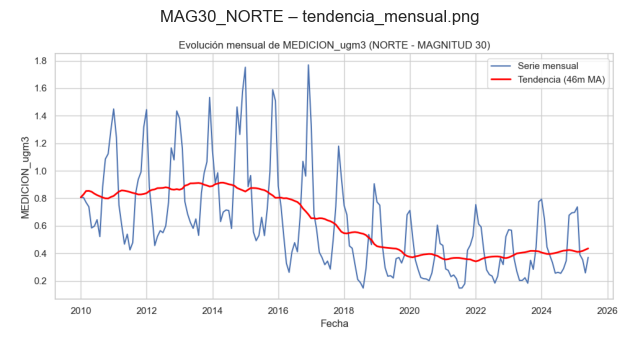

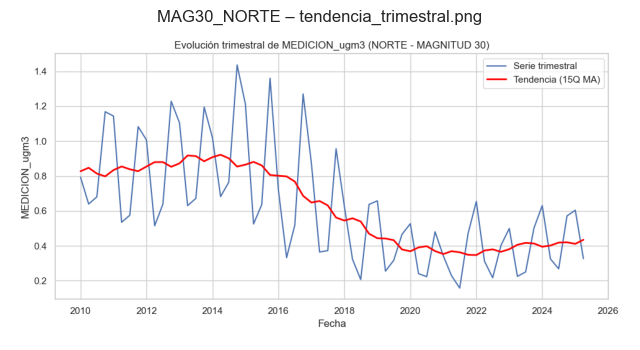

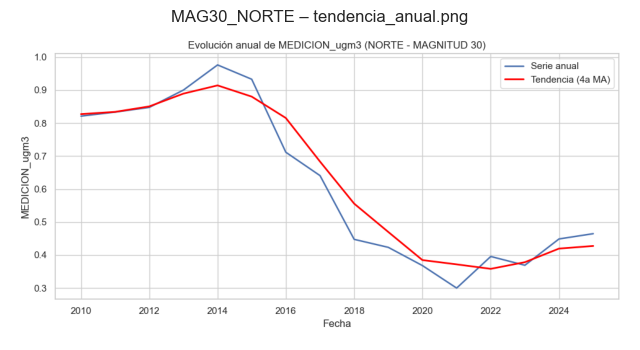

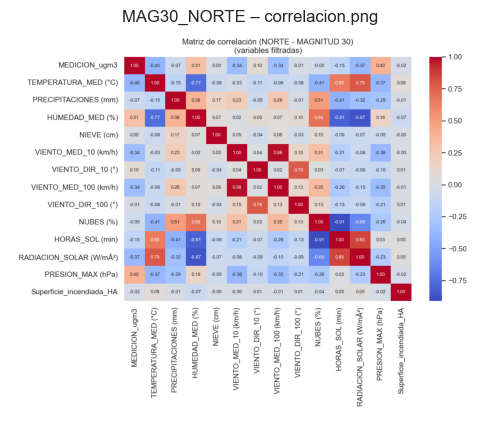



📊 Resultados para MAG30_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    0.382242
std     0.370440
min     0.000000
max     4.700000
25%     0.200000
50%     0.224647
75%     0.400000
Name: MEDICION_ugm3, dtype: float64


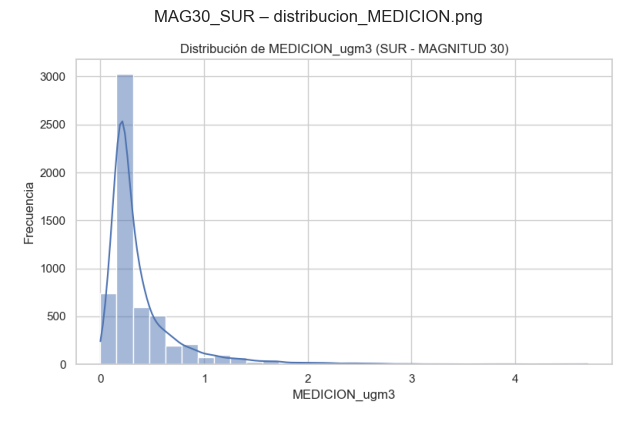

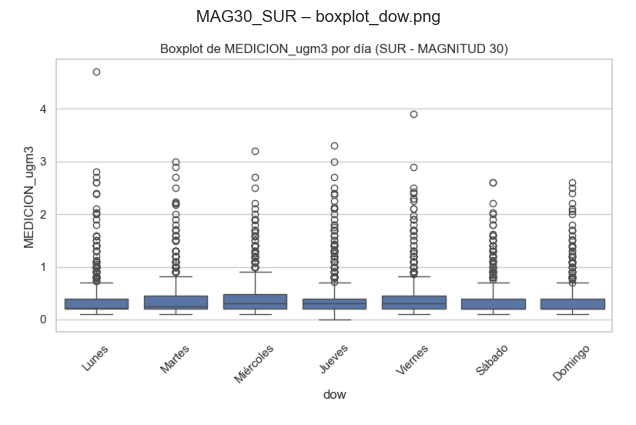

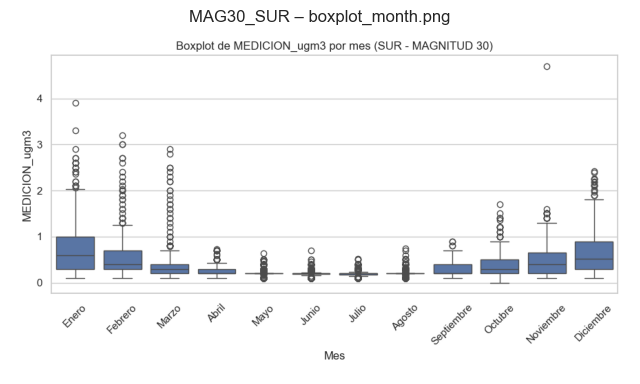

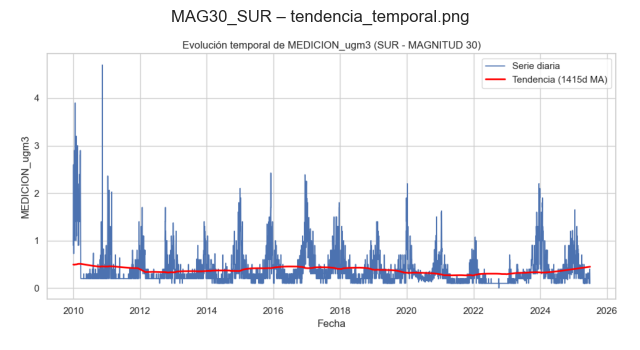

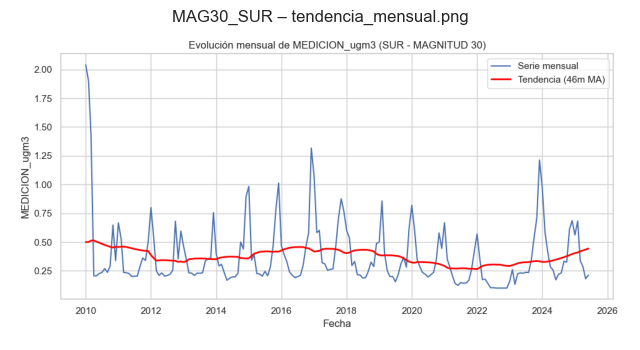

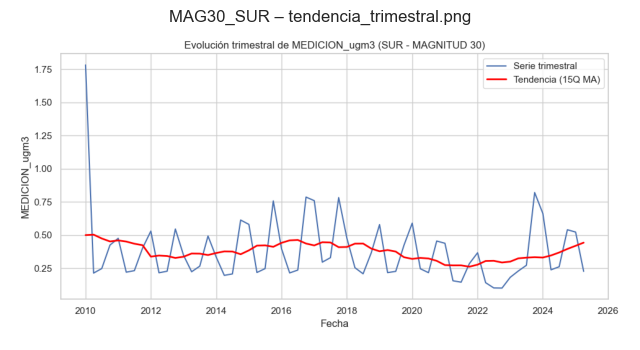

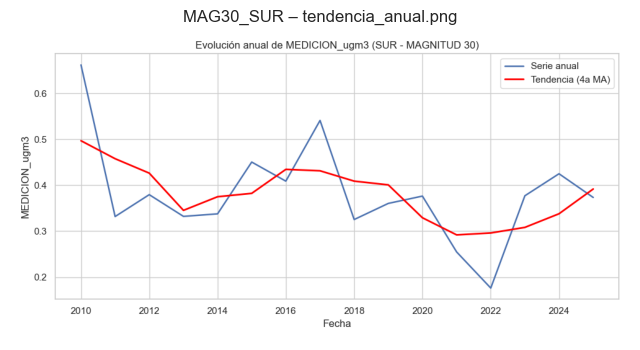

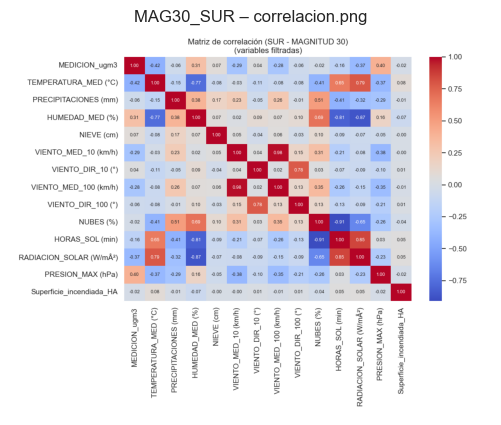



📊 Resultados para MAG35_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    0.594211
std     0.600509
min     0.050000
max     5.700000
25%     0.200000
50%     0.350000
75%     0.800000
Name: MEDICION_ugm3, dtype: float64


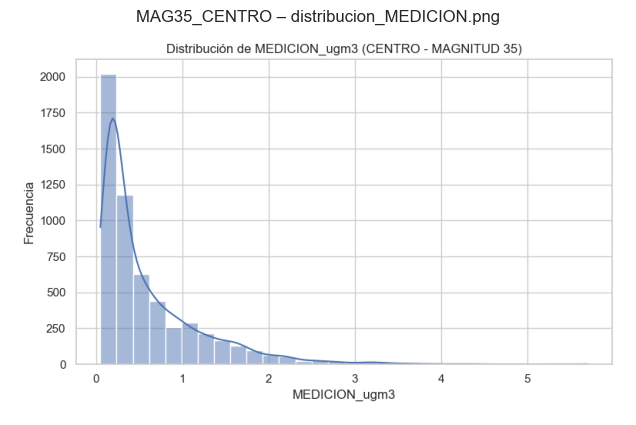

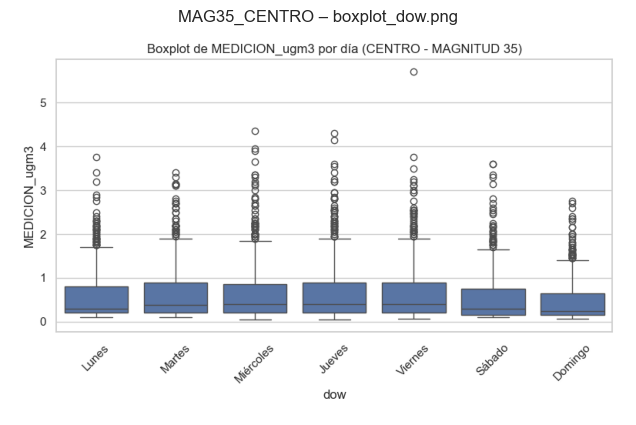

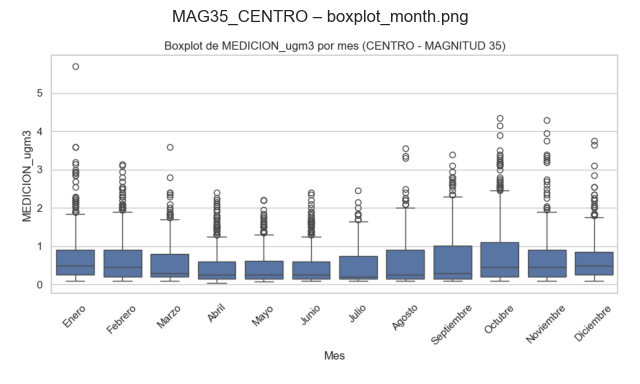

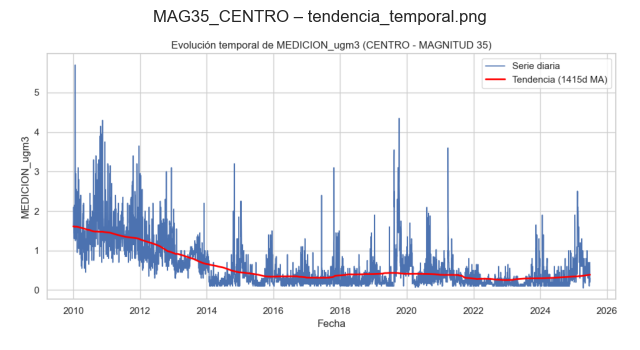

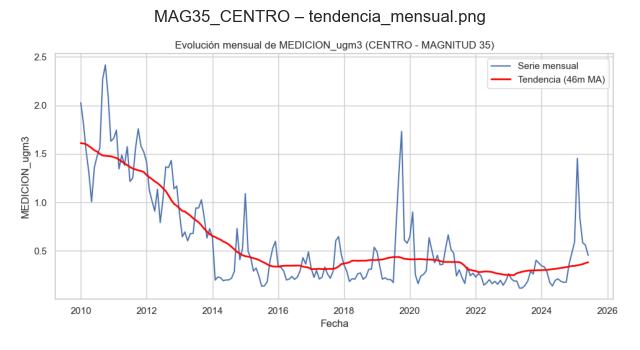

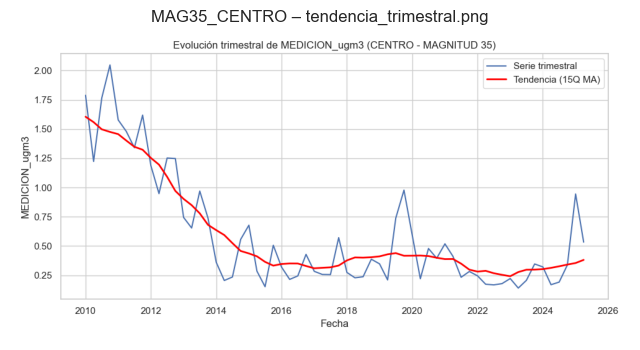

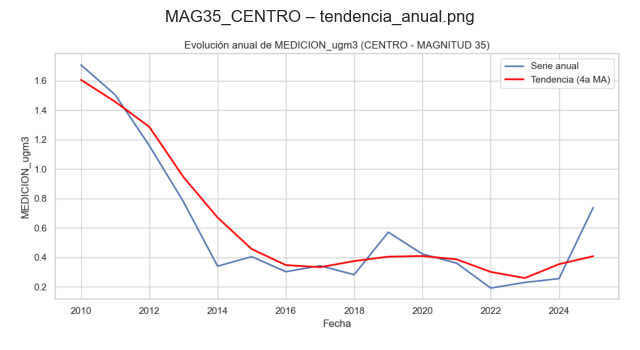

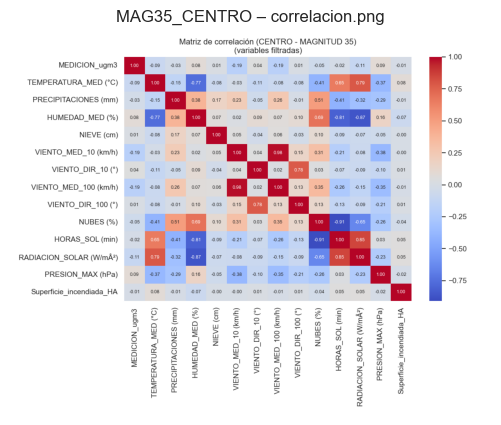



📊 Resultados para MAG35_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    0.573671
std     0.636203
min     0.000000
max     8.625000
25%     0.200000
50%     0.400000
75%     0.725000
Name: MEDICION_ugm3, dtype: float64


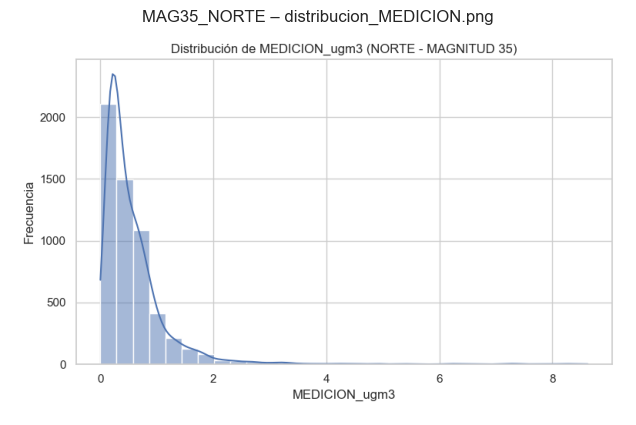

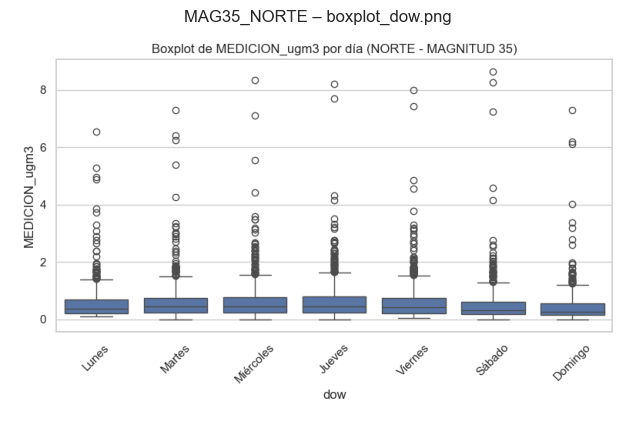

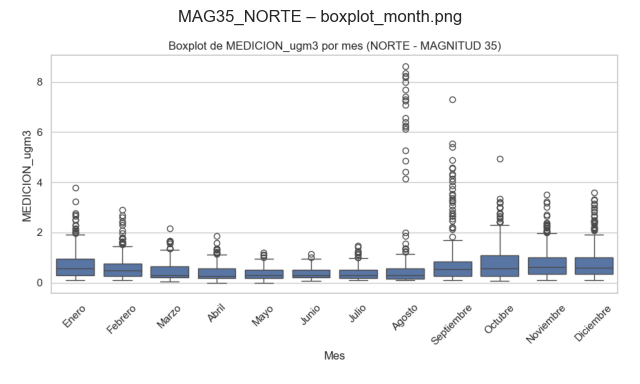

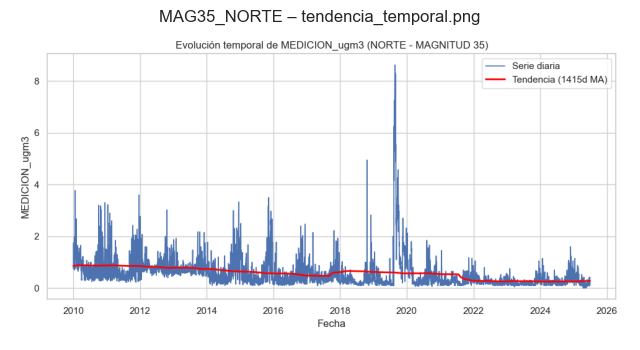

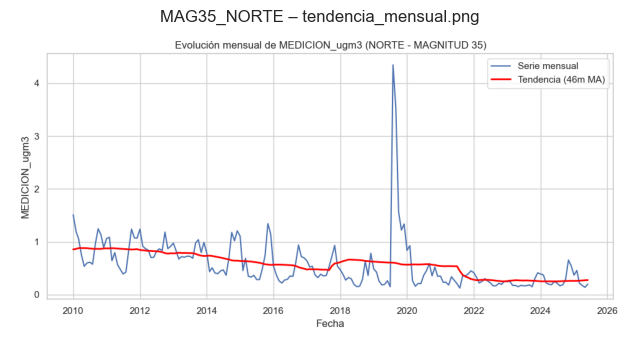

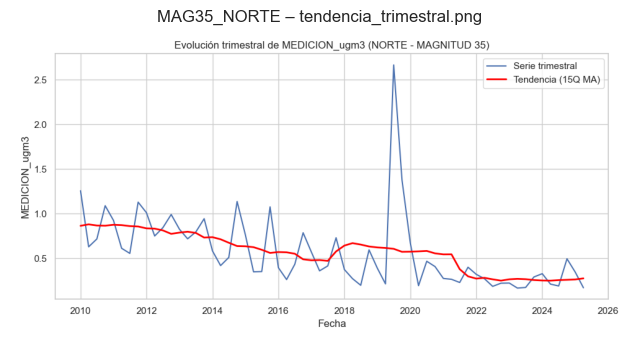

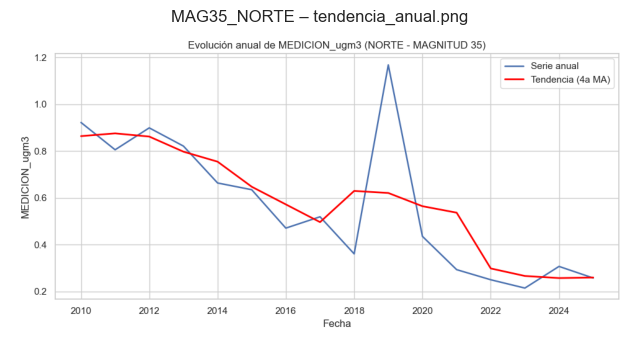

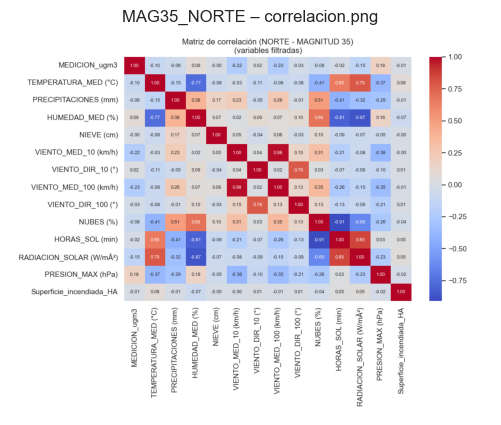



📊 Resultados para MAG35_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    0.383660
std     0.362459
min     0.000000
max     5.000000
25%     0.100000
50%     0.300000
75%     0.500000
Name: MEDICION_ugm3, dtype: float64


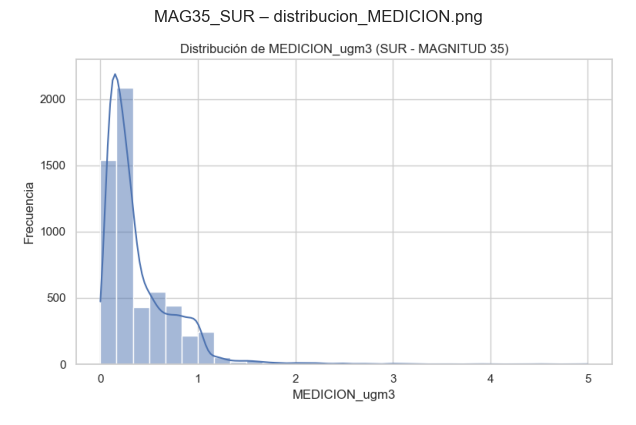

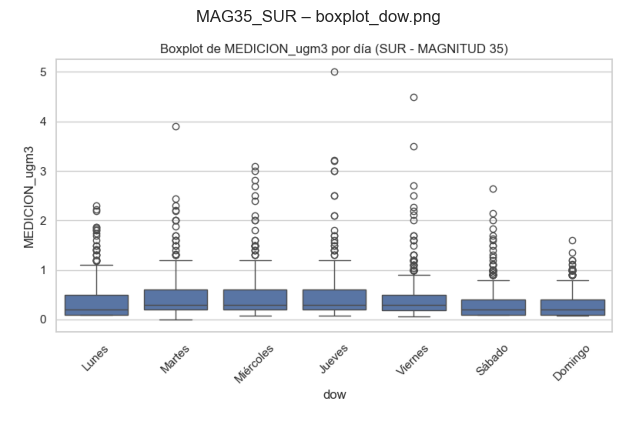

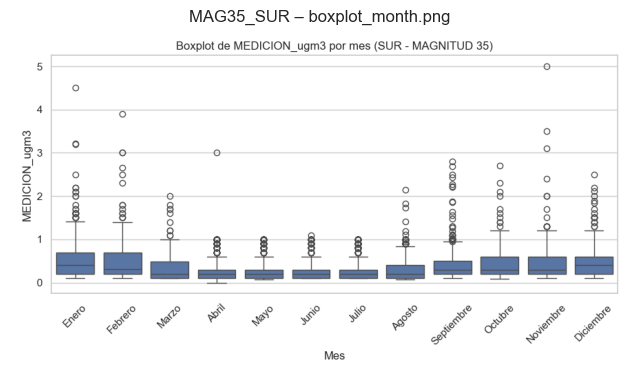

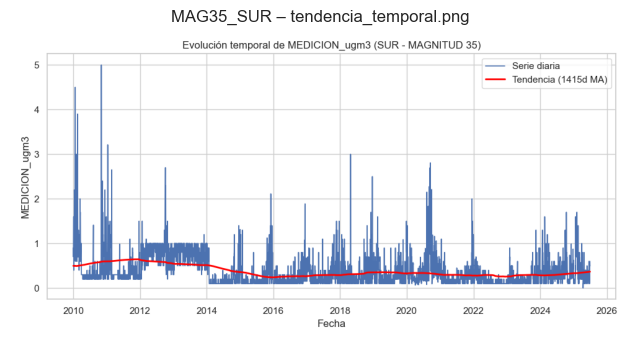

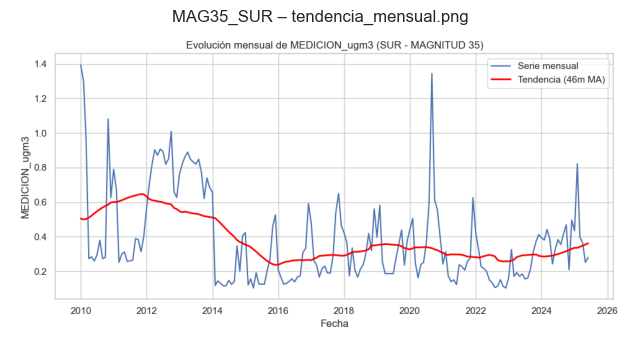

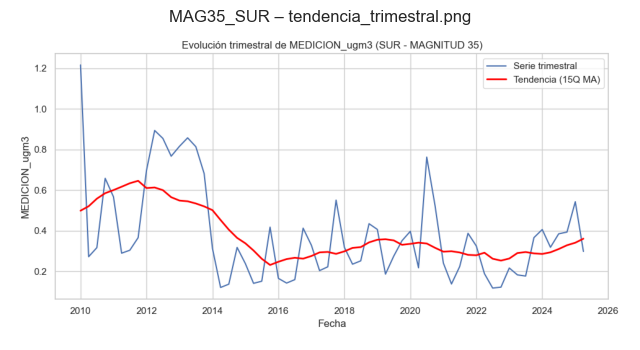

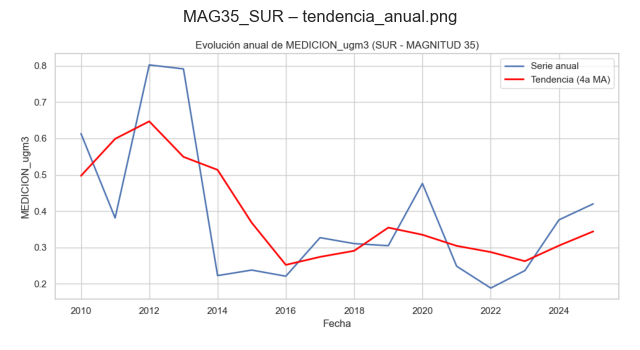

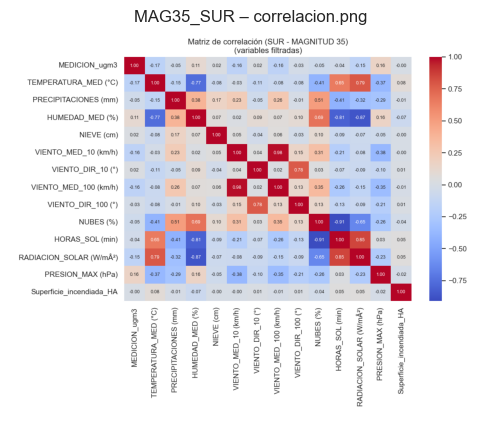



📊 Resultados para MAG6_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     329.309498
std      118.290382
min      100.000000
max     1050.000000
25%      250.000000
50%      300.000000
75%      383.333333
Name: MEDICION_ugm3, dtype: float64


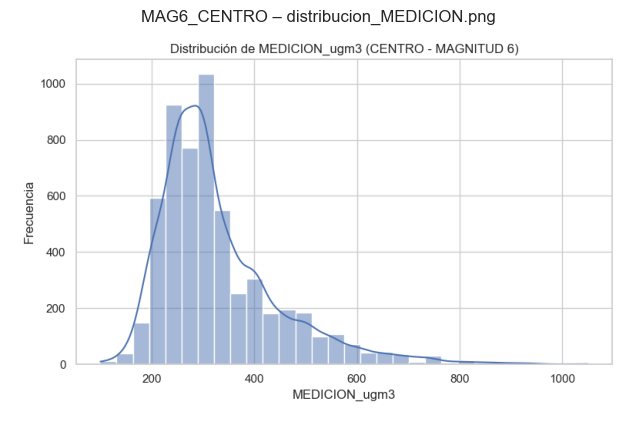

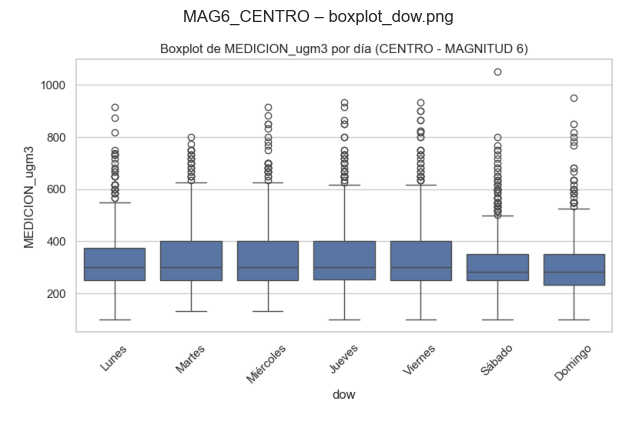

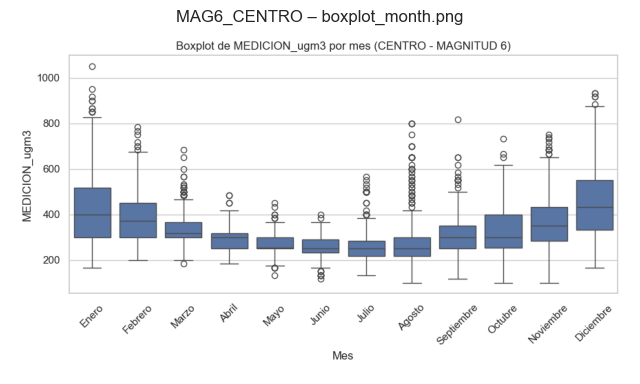

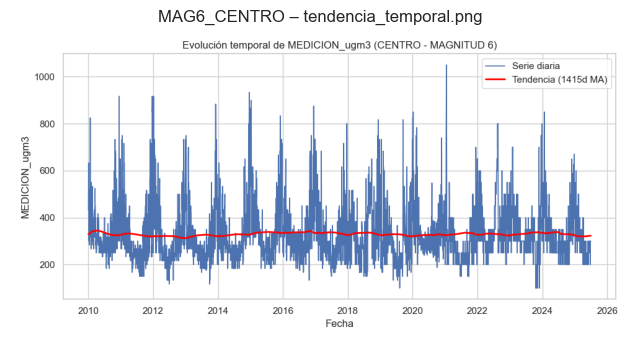

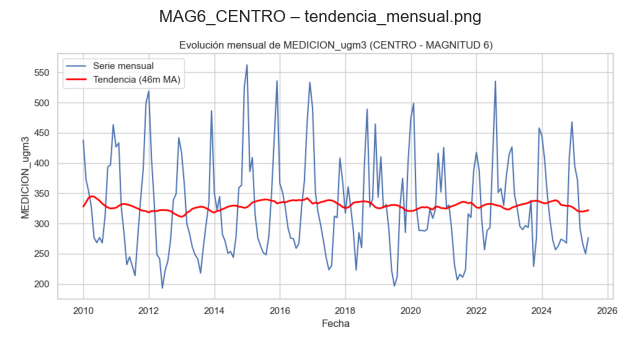

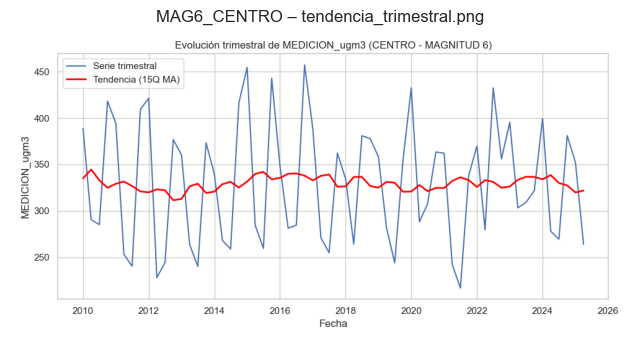

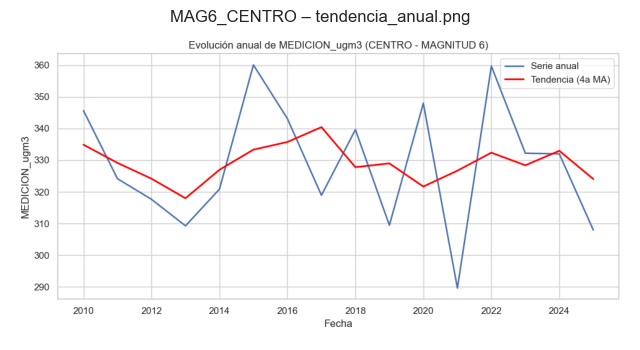

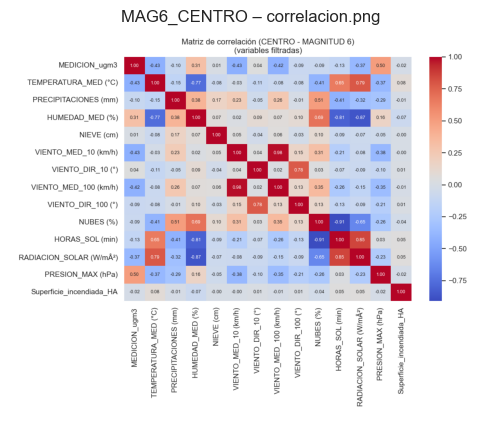



📊 Resultados para MAG6_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     355.999130
std      171.476642
min      100.000000
max     1500.000000
25%      250.000000
50%      300.000000
75%      400.000000
Name: MEDICION_ugm3, dtype: float64


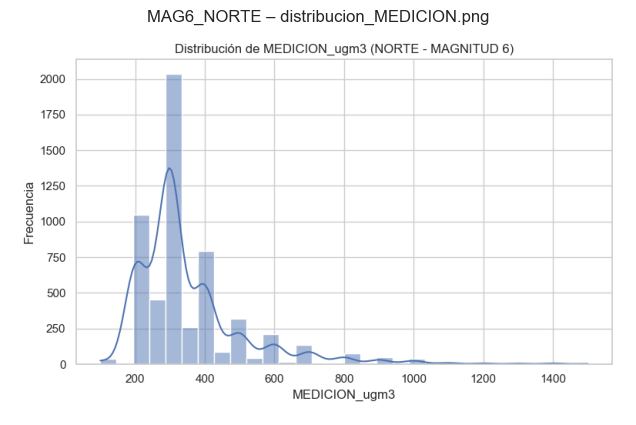

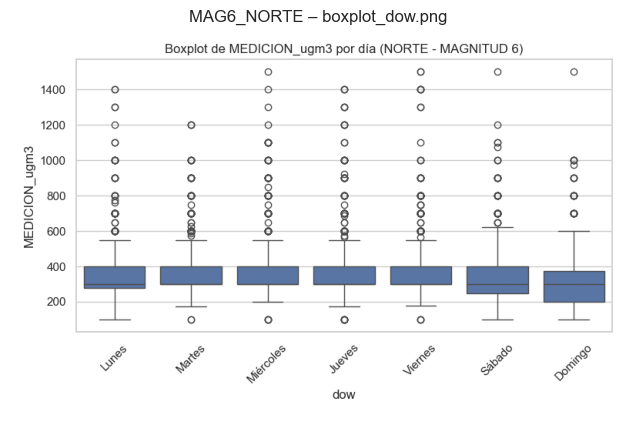

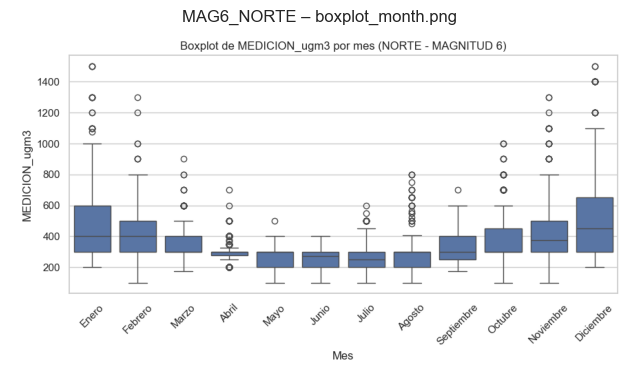

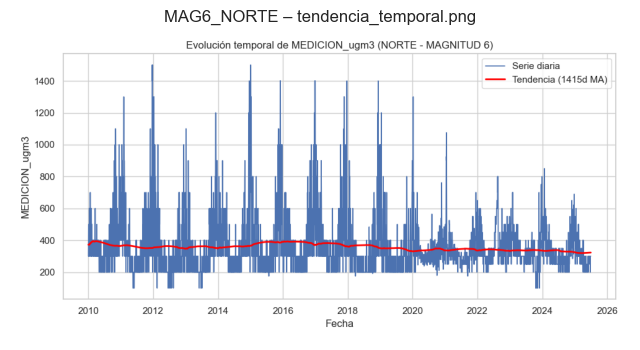

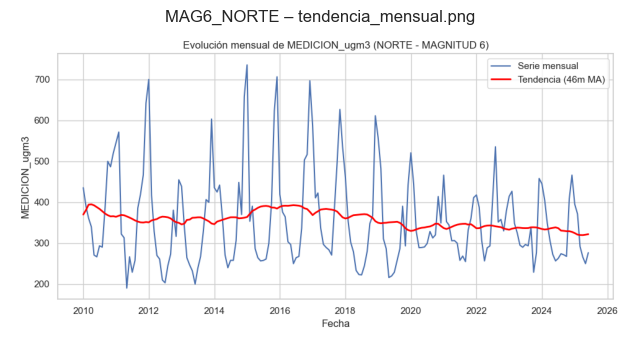

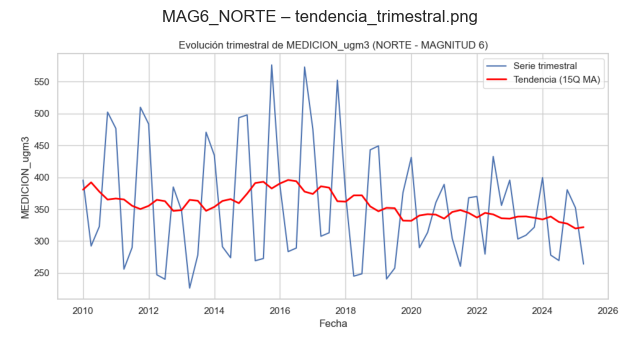

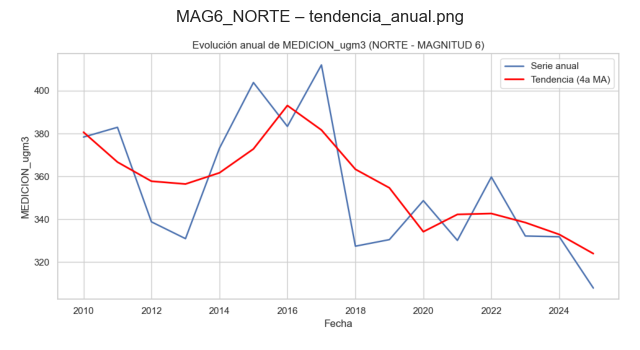

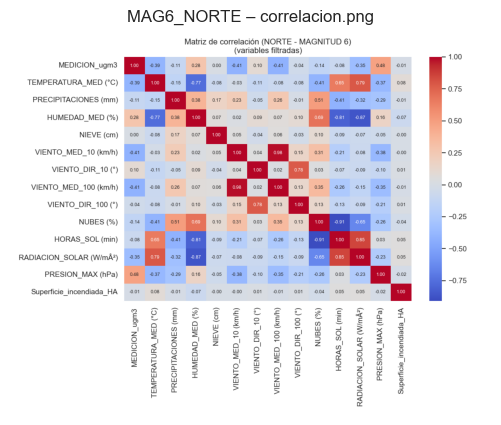



📊 Resultados para MAG6_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     356.811874
std      143.173390
min      100.000000
max     1150.000000
25%      250.000000
50%      300.000000
75%      400.000000
Name: MEDICION_ugm3, dtype: float64


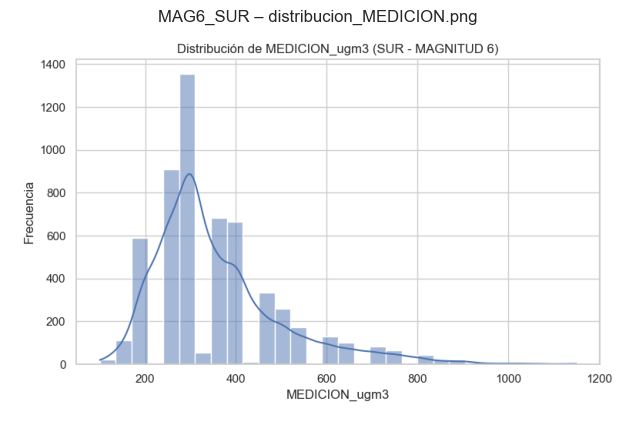

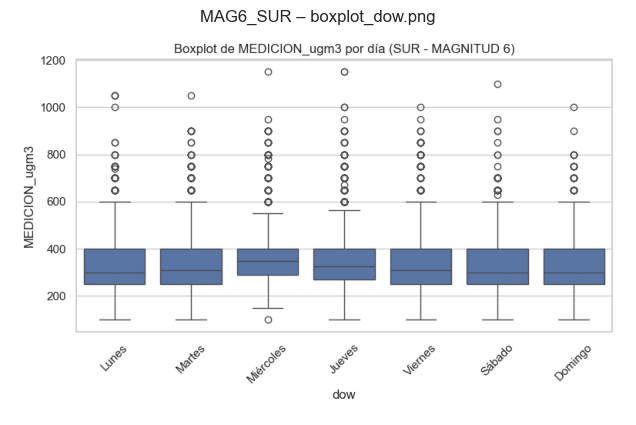

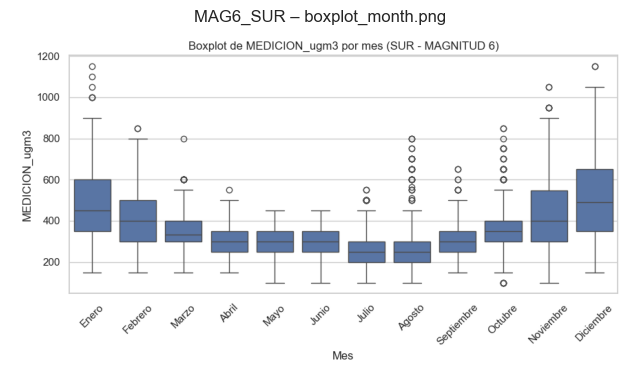

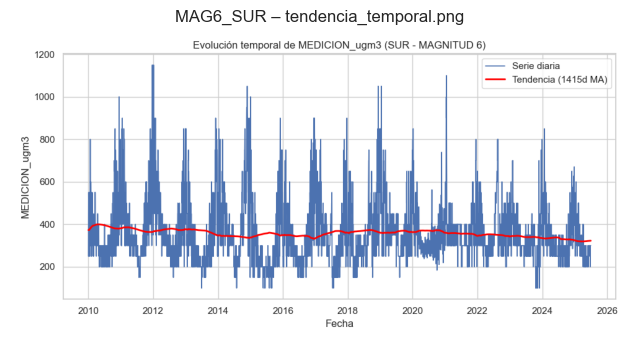

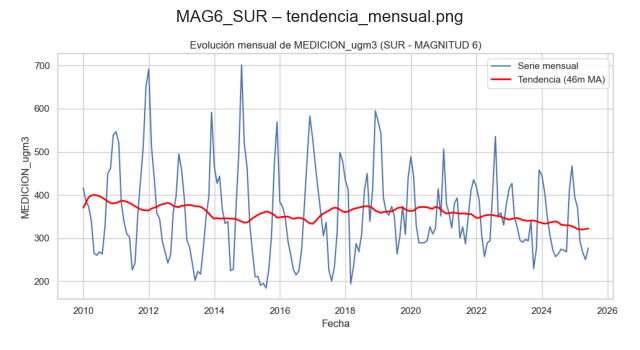

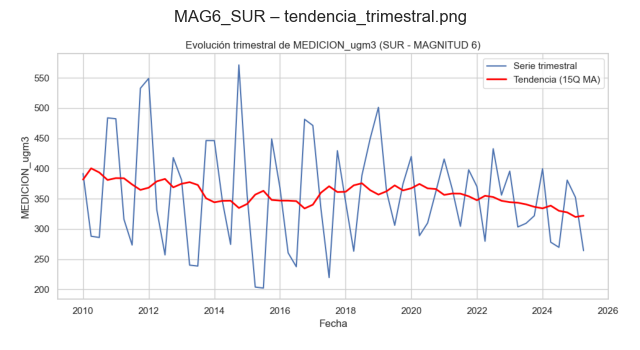

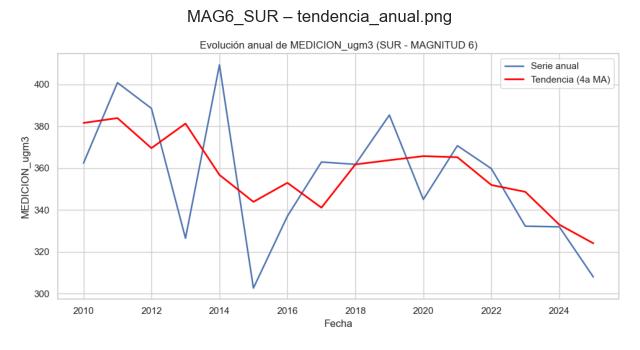

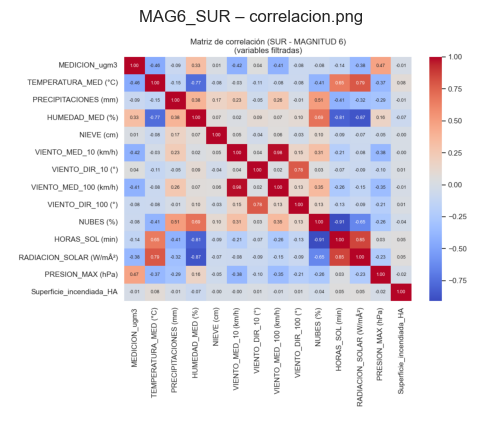



📊 Resultados para MAG7_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     14.679204
std      20.030622
min      -0.283828
max     188.000000
25%       3.696101
50%       7.500000
75%      15.666667
Name: MEDICION_ugm3, dtype: float64


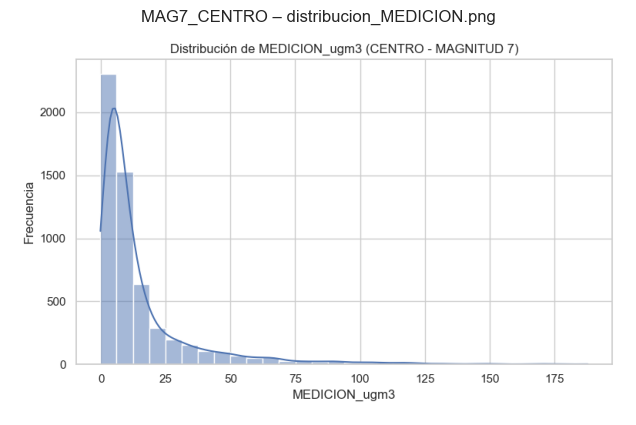

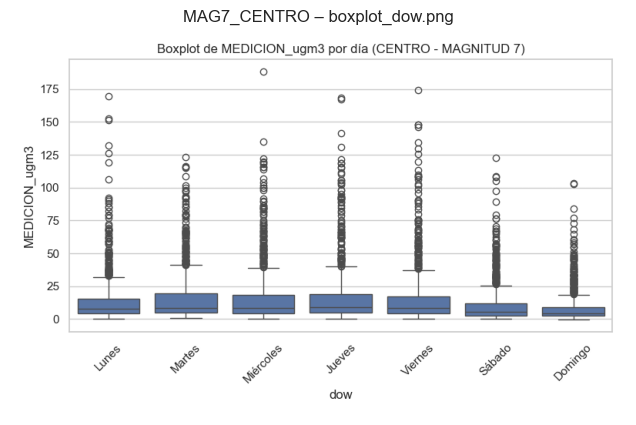

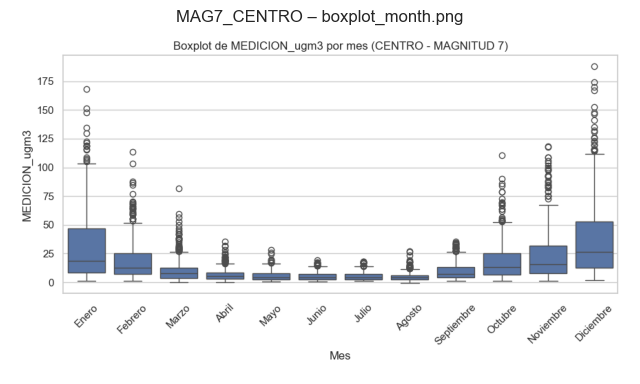

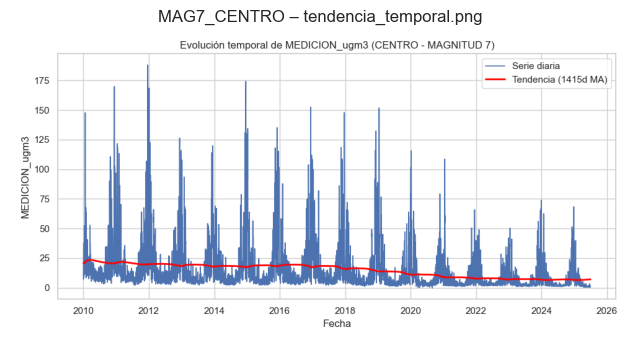

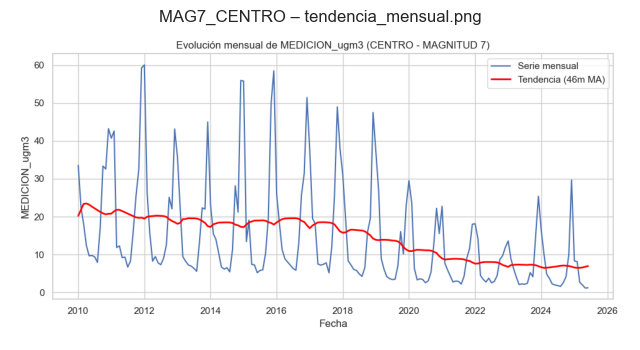

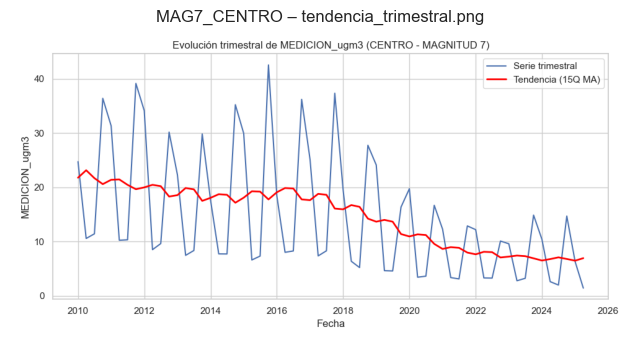

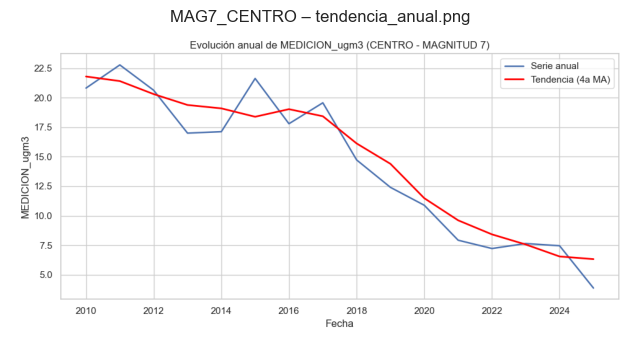

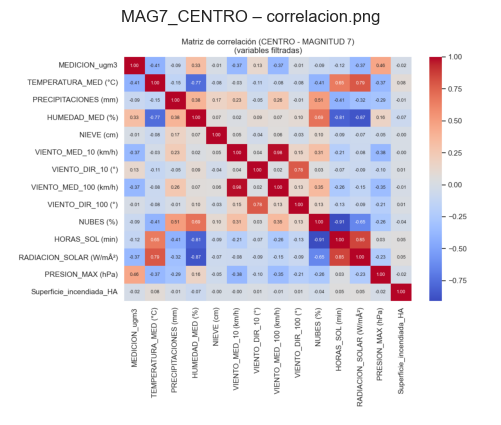



📊 Resultados para MAG7_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     18.063421
std      22.065382
min      -0.359742
max     219.638889
25%       5.138889
50%      10.694444
75%      20.645833
Name: MEDICION_ugm3, dtype: float64


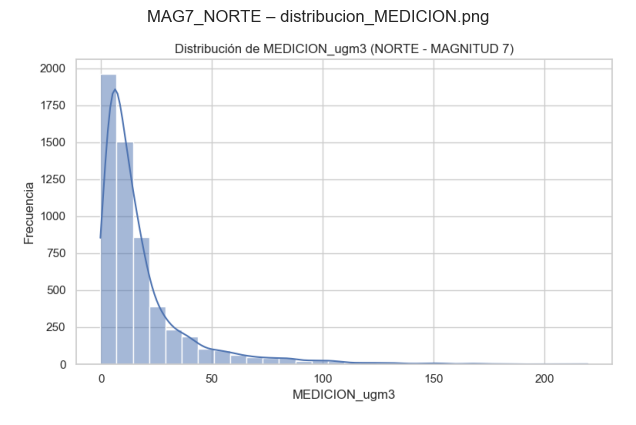

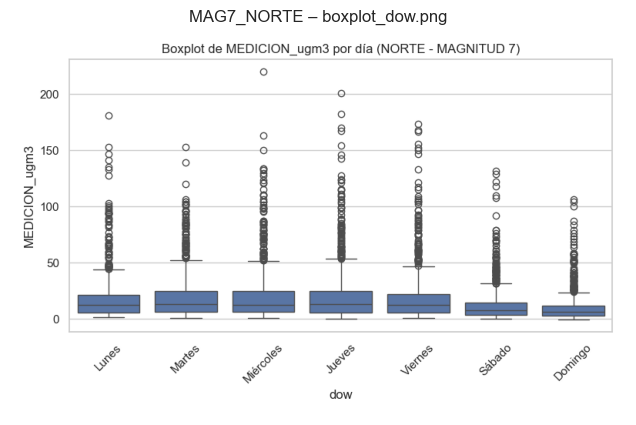

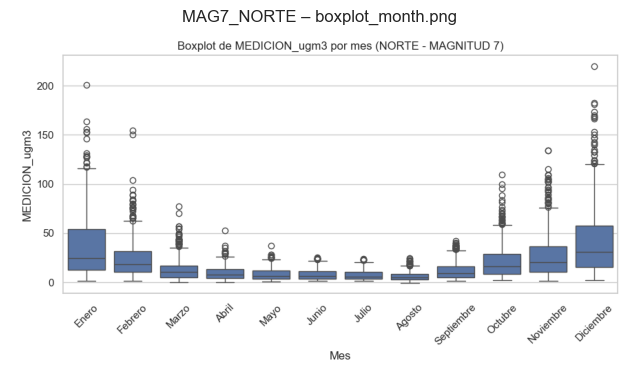

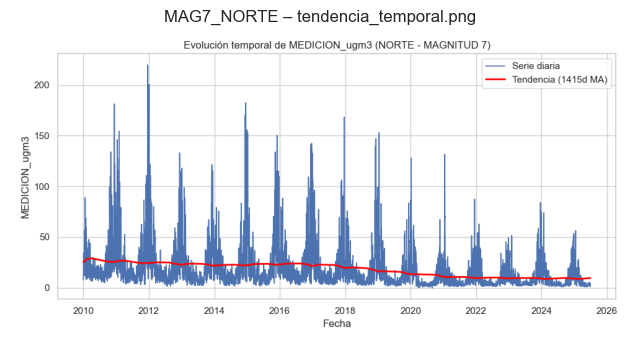

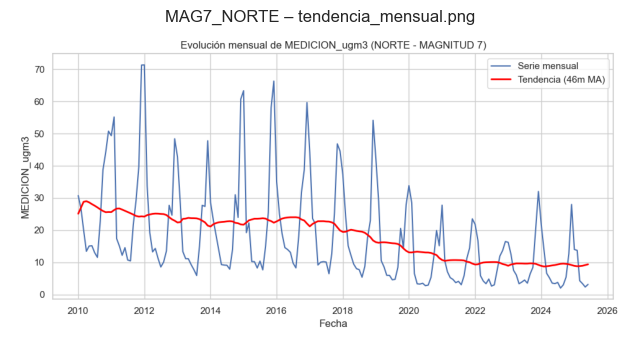

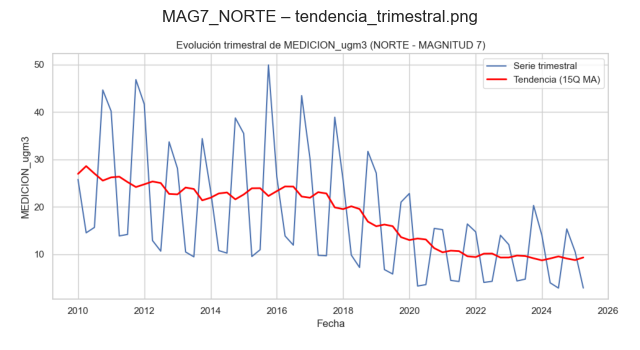

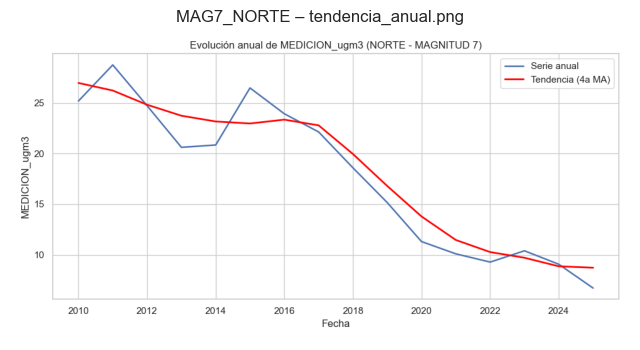

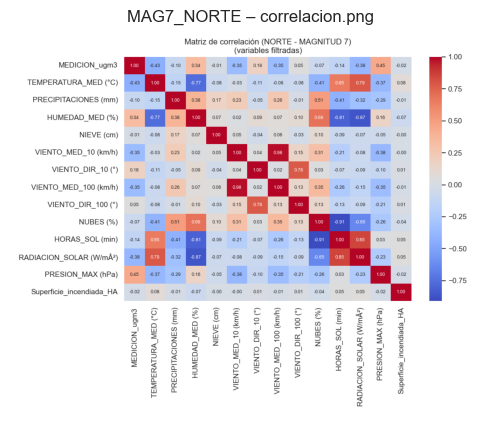



📊 Resultados para MAG7_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     17.675101
std      26.799781
min      -0.283828
max     210.833333
25%       3.166667
50%       6.666667
75%      18.833333
Name: MEDICION_ugm3, dtype: float64


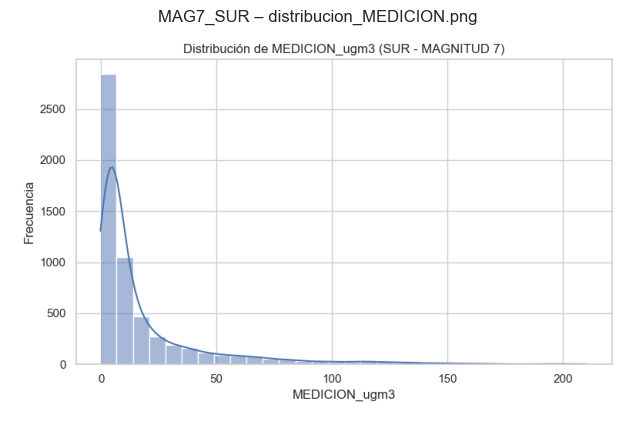

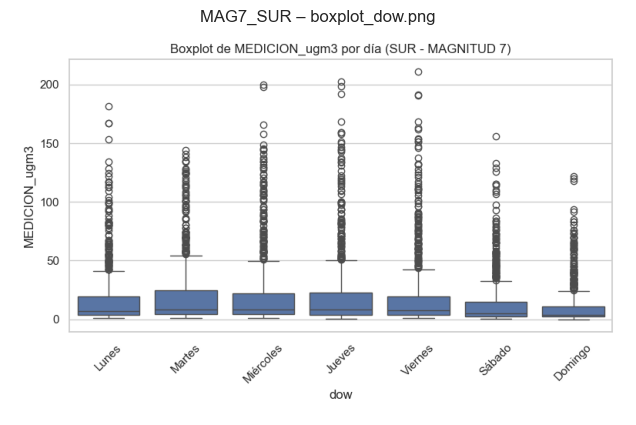

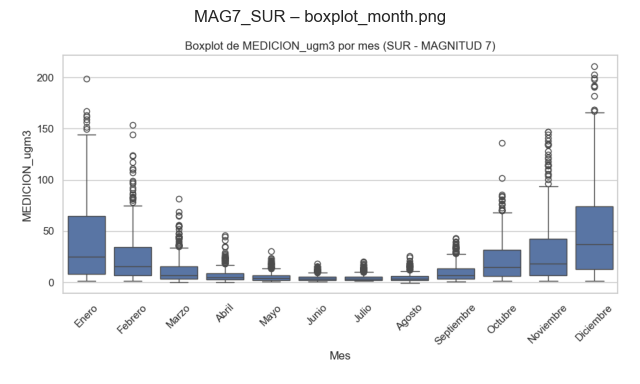

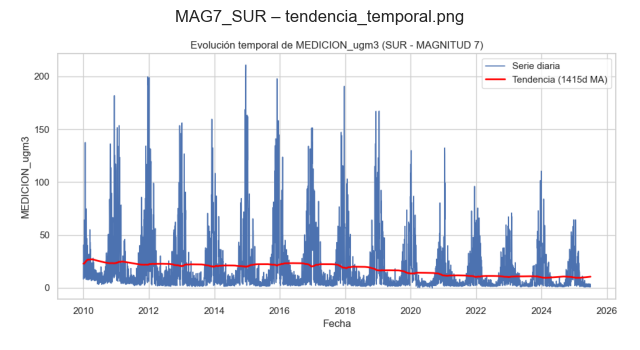

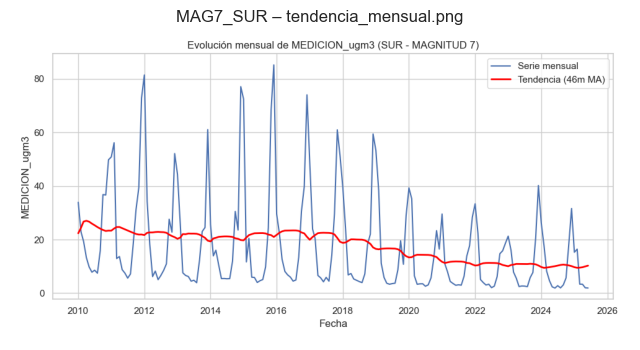

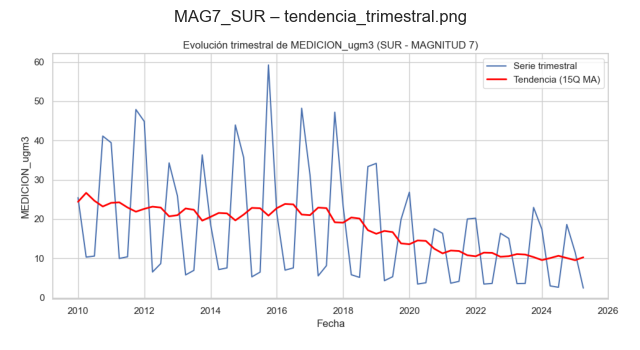

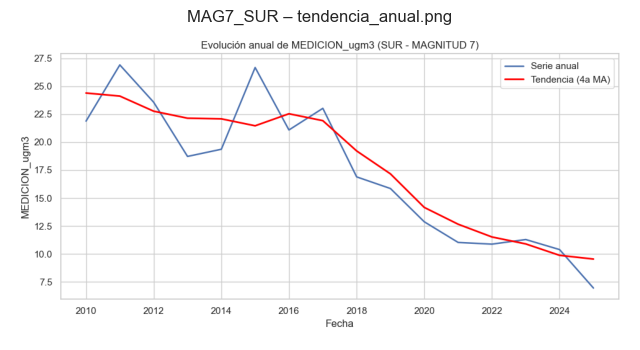

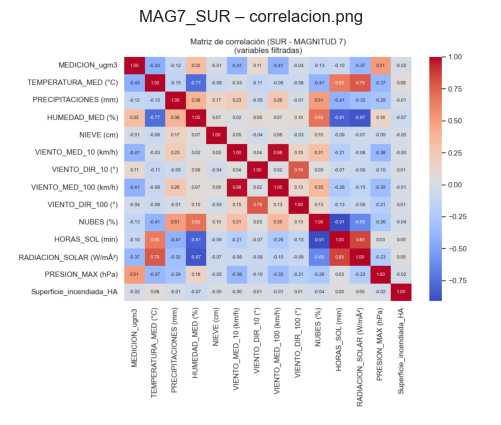



📊 Resultados para MAG8_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     33.202841
std      16.391506
min       4.833333
max     108.000000
25%      20.833333
50%      30.166667
75%      42.207975
Name: MEDICION_ugm3, dtype: float64


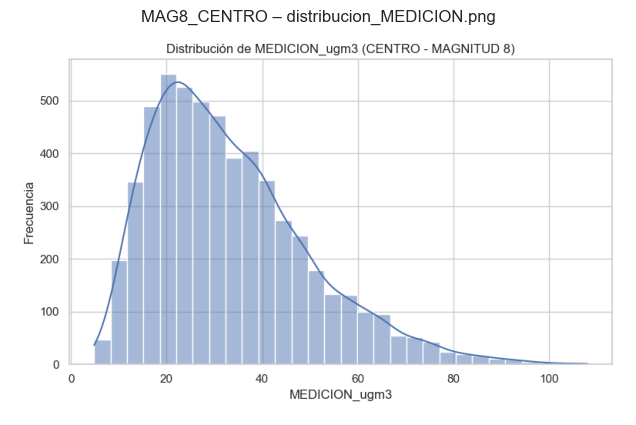

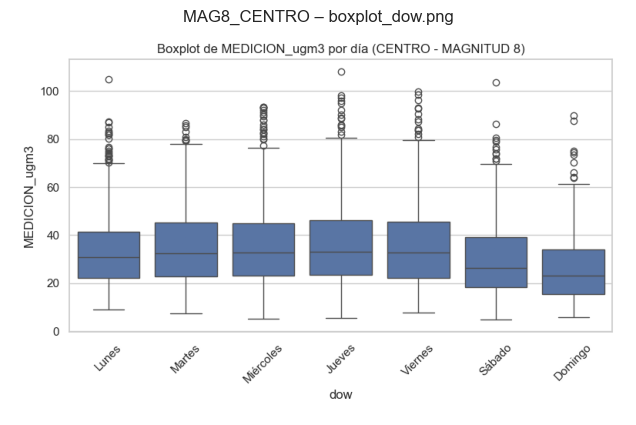

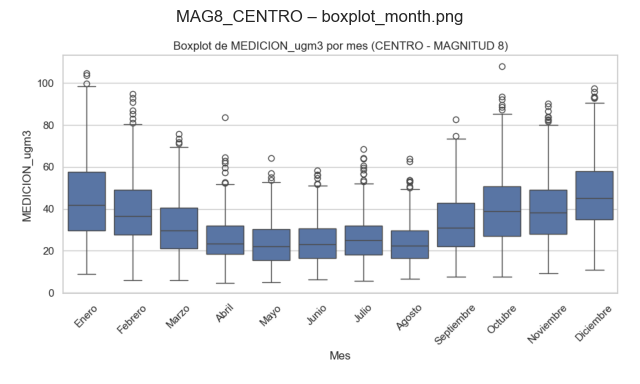

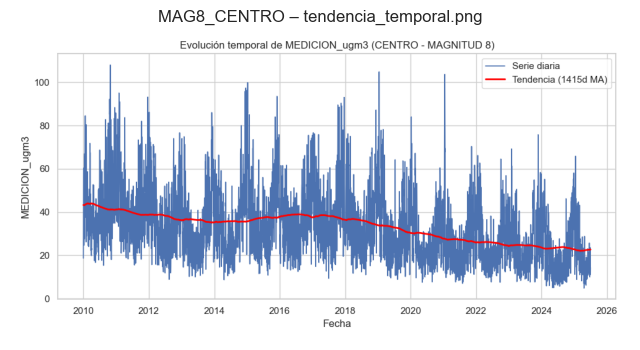

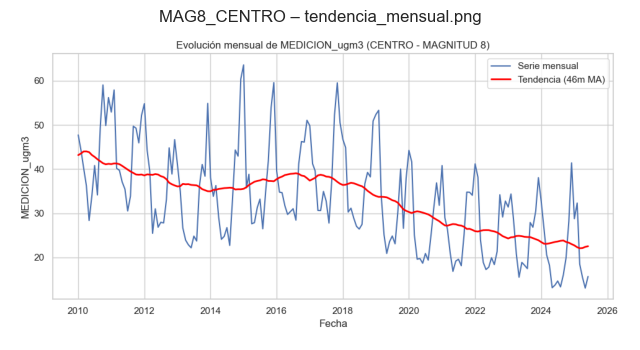

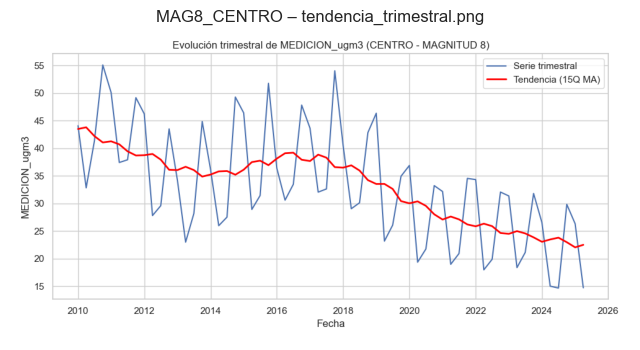

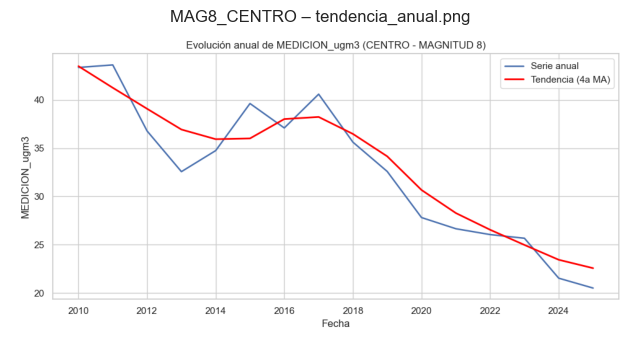

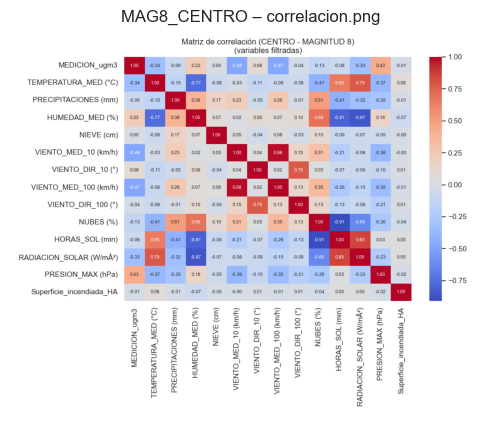



📊 Resultados para MAG8_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     34.597055
std      16.654561
min       4.361111
max     118.722222
25%      22.055556
50%      31.777778
75%      44.201389
Name: MEDICION_ugm3, dtype: float64


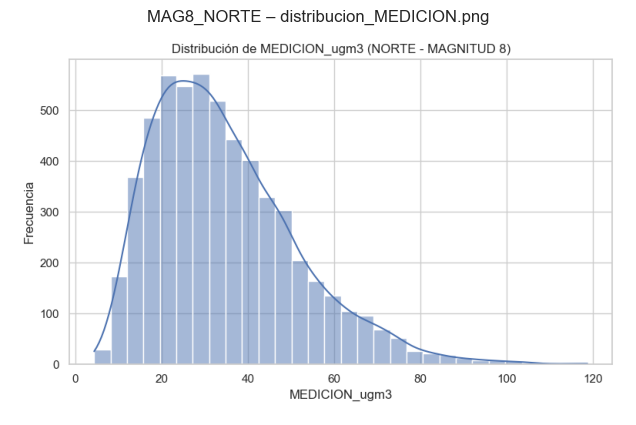

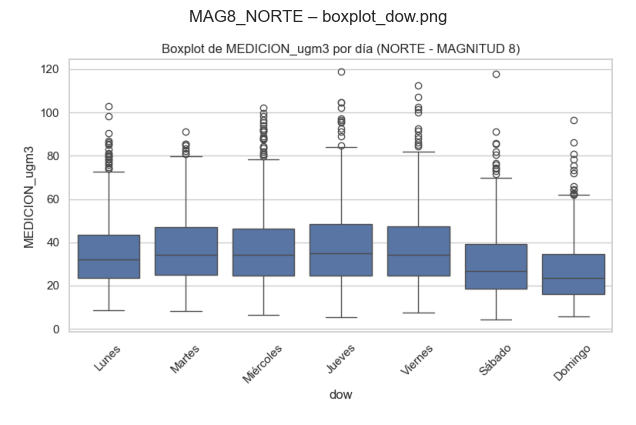

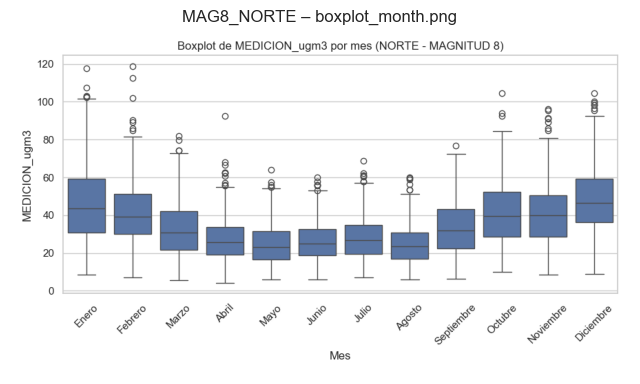

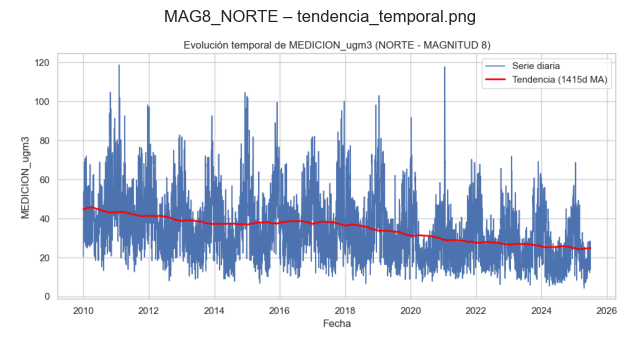

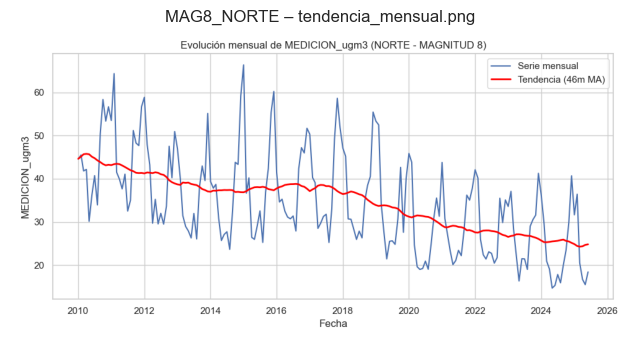

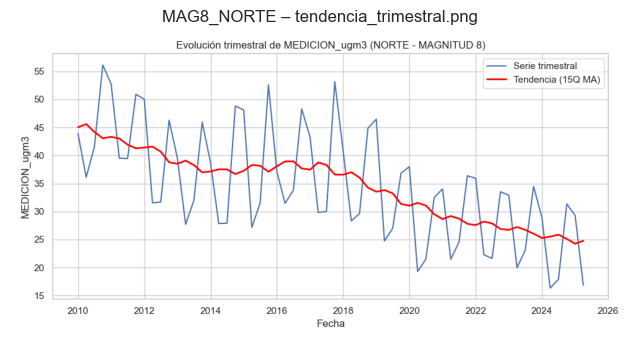

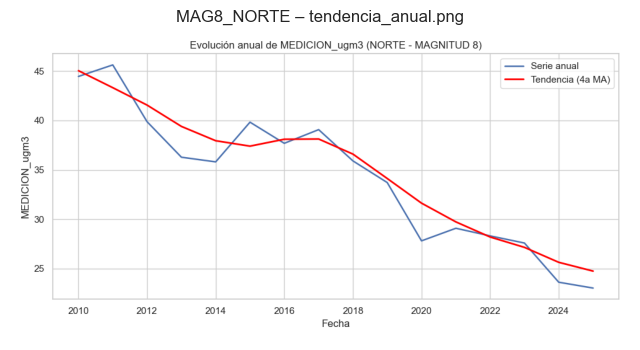

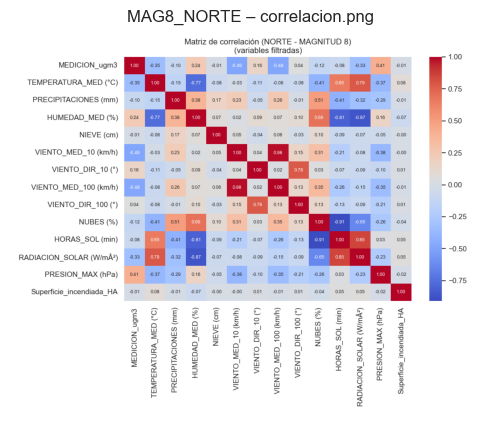



📊 Resultados para MAG8_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean     34.284599
std      17.934560
min       4.500000
max     120.166667
25%      20.833333
50%      30.333333
75%      44.323299
Name: MEDICION_ugm3, dtype: float64


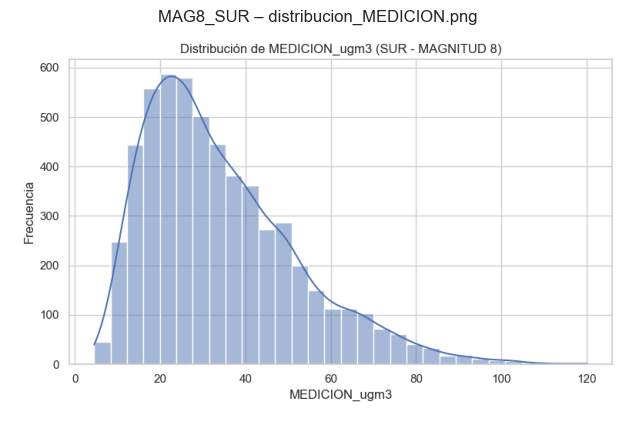

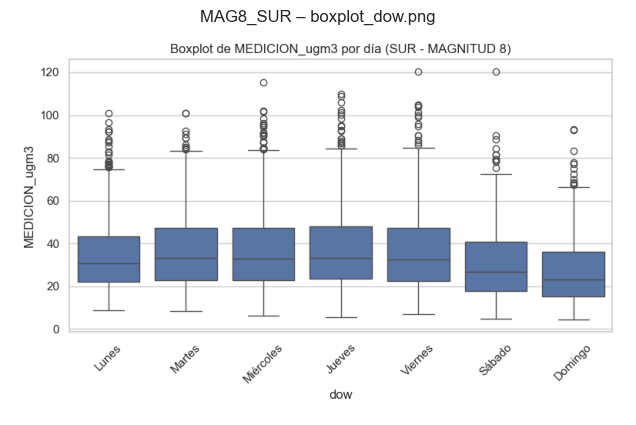

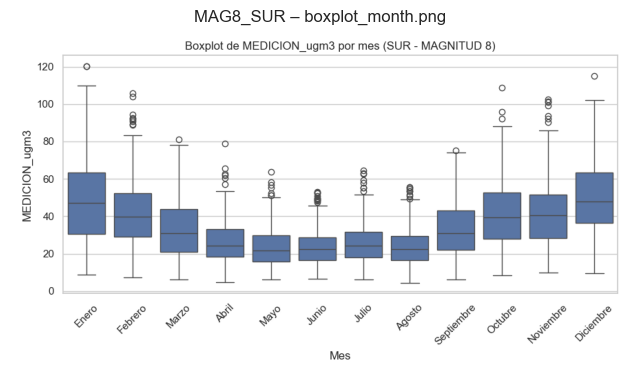

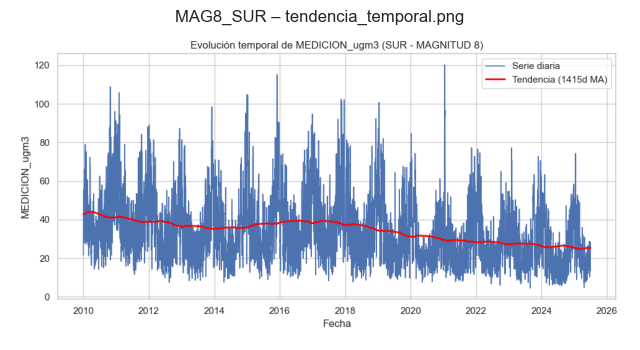

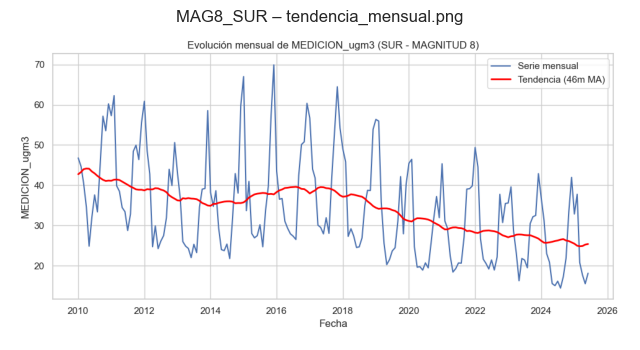

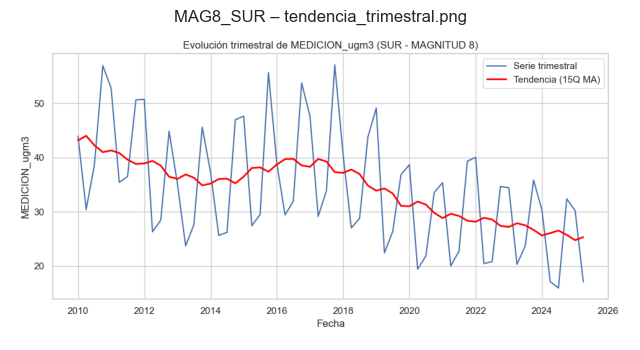

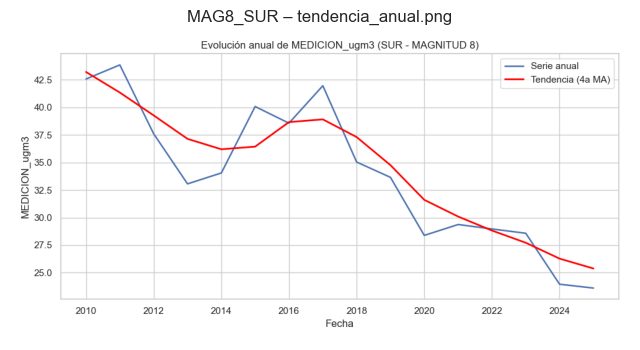

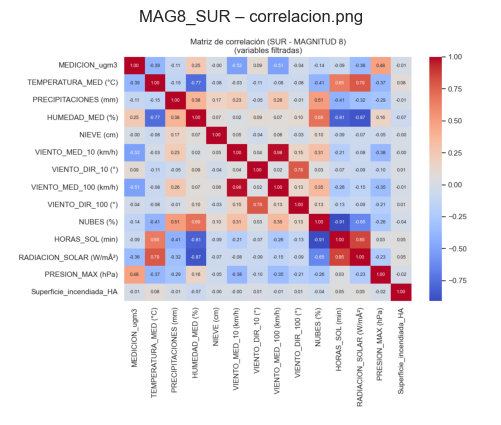



📊 Resultados para MAG9_CENTRO

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    10.112412
std      5.411861
min      2.000000
max     65.666667
25%      6.333333
50%      9.000000
75%     12.666667
Name: MEDICION_ugm3, dtype: float64


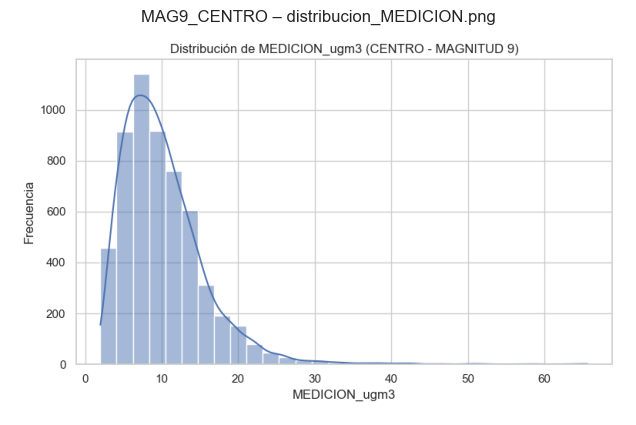

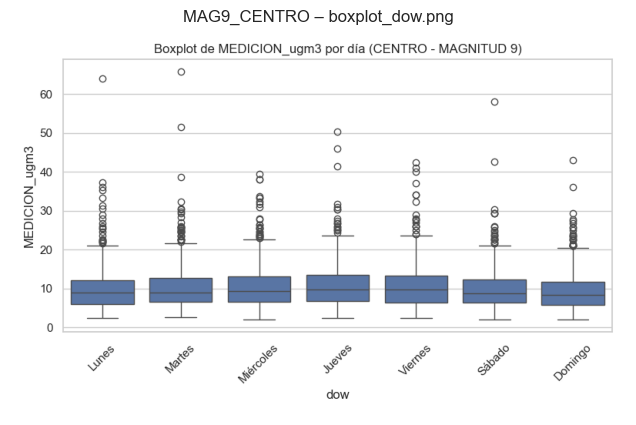

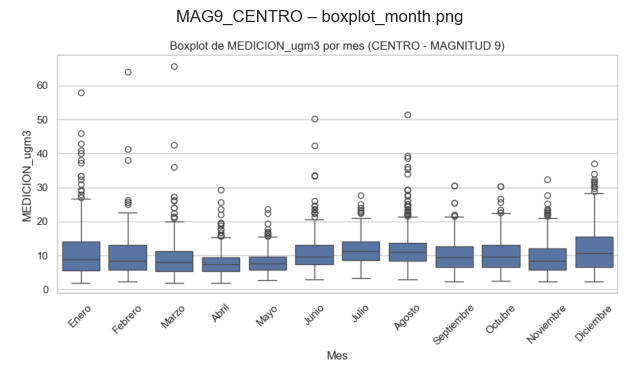

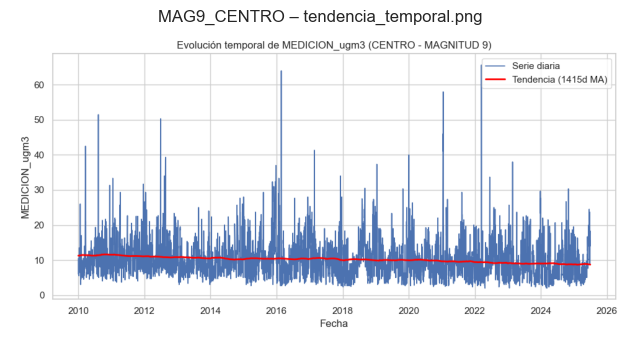

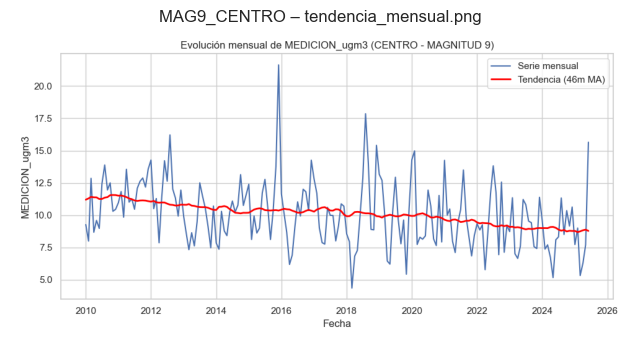

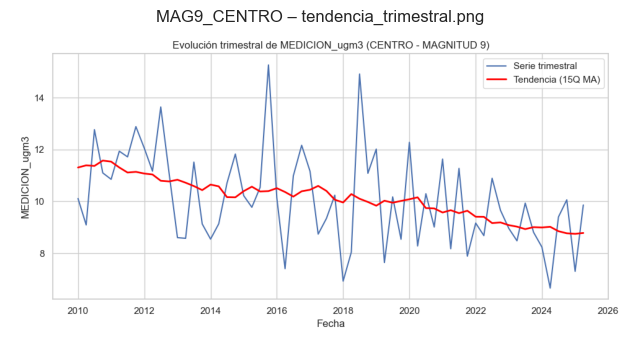

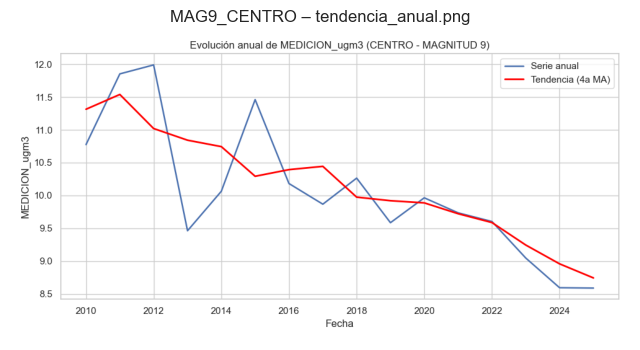

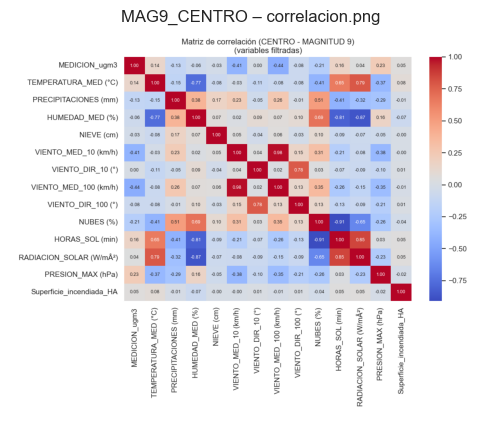



📊 Resultados para MAG9_NORTE

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    10.419557
std      5.795359
min      1.000000
max     72.000000
25%      6.500000
50%      9.500000
75%     13.000000
Name: MEDICION_ugm3, dtype: float64


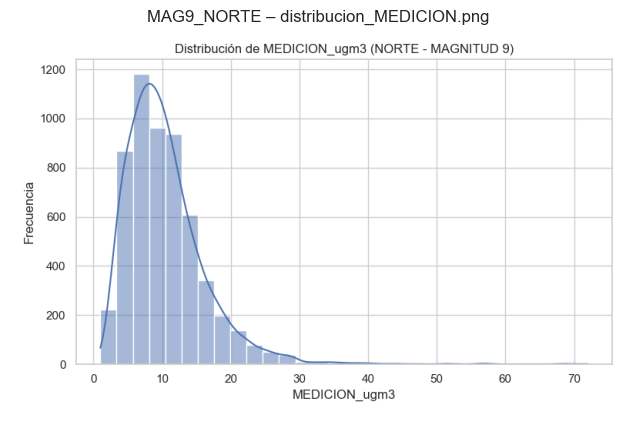

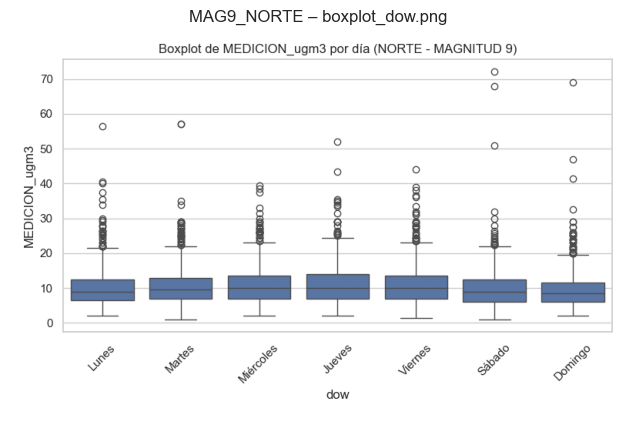

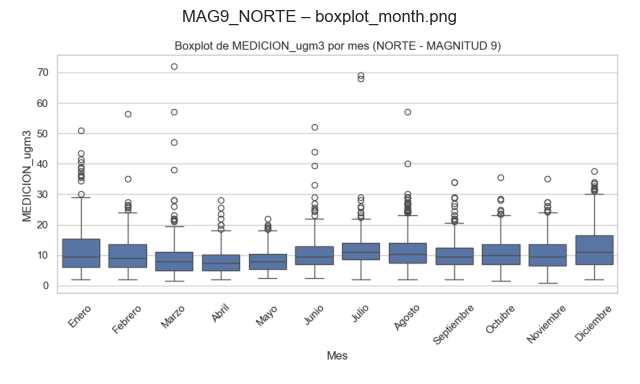

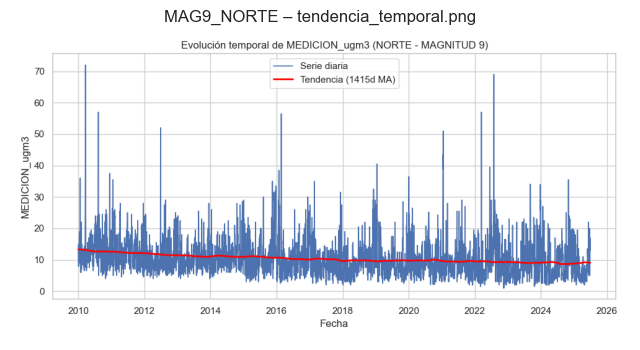

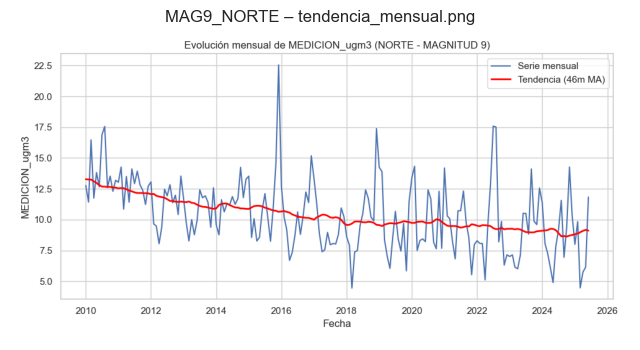

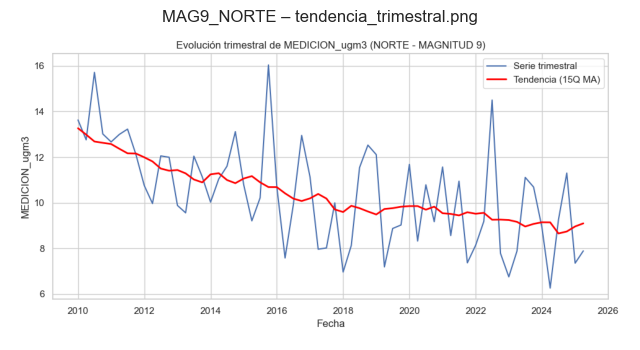

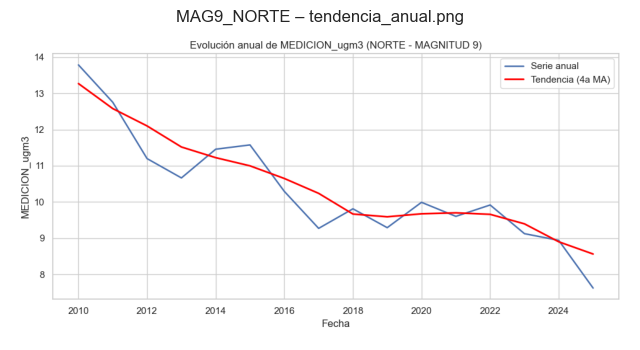

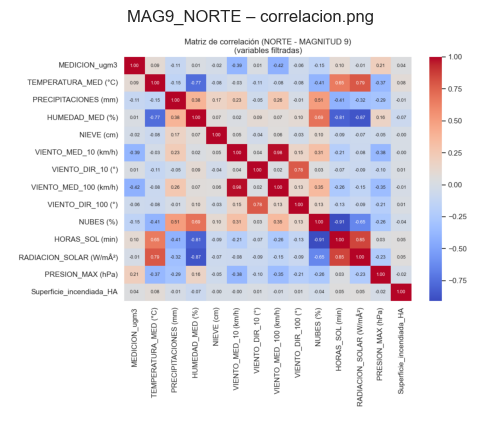



📊 Resultados para MAG9_SUR

📋 Resumen:
- Nº filas: 5660
- Rango temporal: 2010-01-01 00:00:00 → 2025-06-30 00:00:00
- Total de valores nulos (todas las variables): 0

📈 Estadísticos de 'MEDICION_ugm3':
mean    10.561051
std      6.117320
min      1.000000
max     78.000000
25%      6.000000
50%      9.000000
75%     13.717658
Name: MEDICION_ugm3, dtype: float64


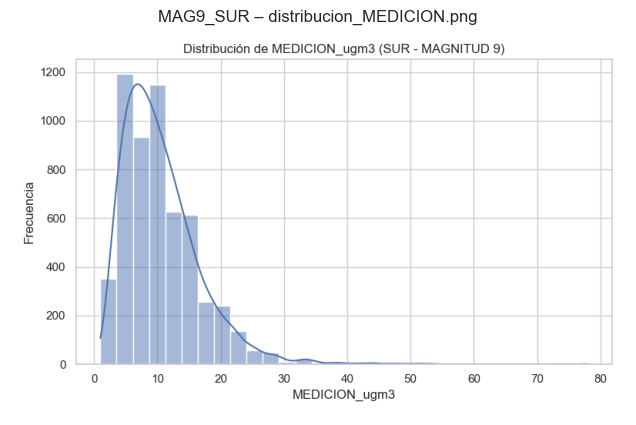

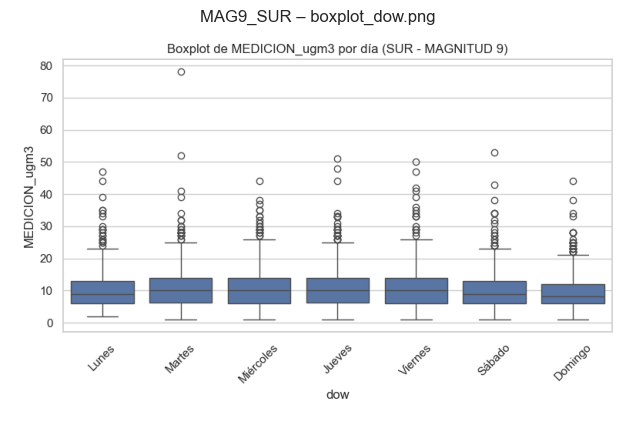

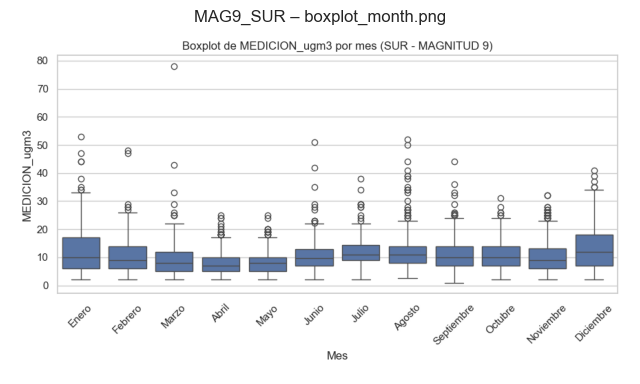

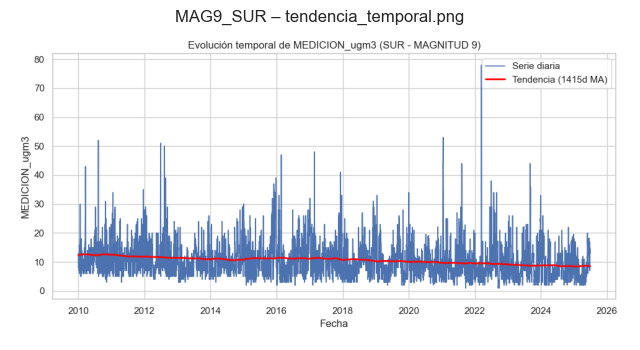

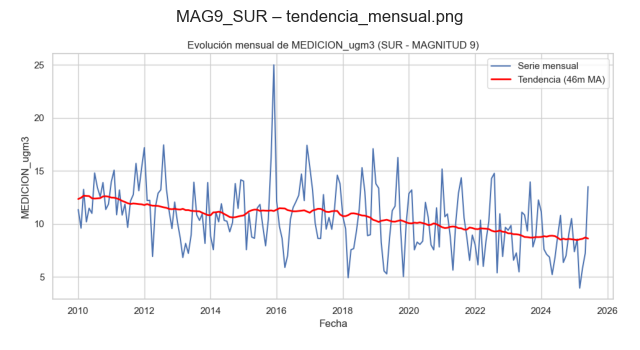

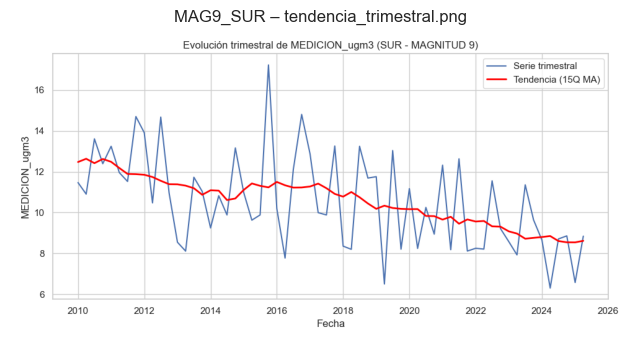

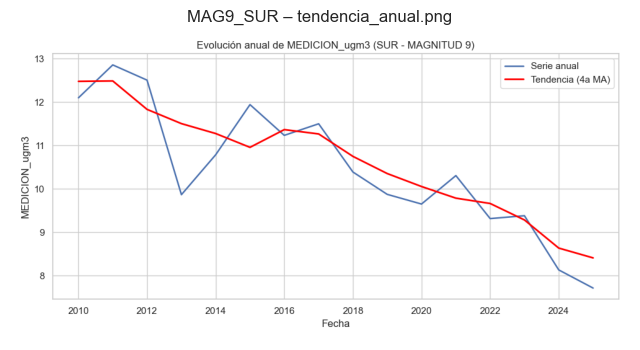

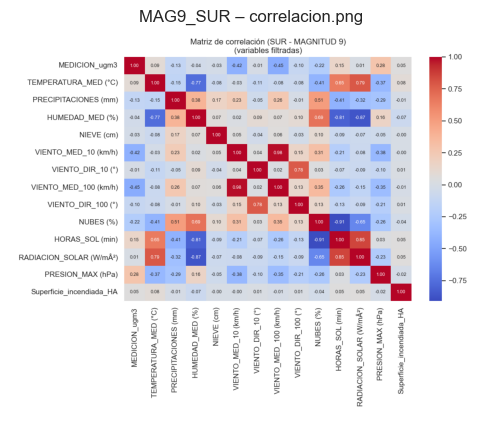

In [29]:
# Carpeta donde están los resultados
base_path = "06_EDA_resultados"

# Listo todas las combinaciones (subcarpetas)
folders = sorted([f for f in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, f))])

print(f"\n🔎 Se encontraron {len(folders)} combinaciones con resultados de EDA.\n")

# Muestro resultados uno a uno
for folder in folders:
    path = os.path.join(base_path, folder)
    print("="*80)  # 80 signos de igual (=)
    print(f"📊 Resultados para {folder}")
    print("="*80)  # 80 signos de igual (=)

    # Resumen general
    resumen_path = os.path.join(path, "resumen.json")
    if os.path.exists(resumen_path):
        with open(resumen_path, "r", encoding="utf-8") as f:
            resumen = json.load(f)

        # Soporte para ambos formatos de resumen (nuevo y antiguo)
        if "total_nulos" in resumen:
            total_nulos = resumen["total_nulos"]
        elif "n_nulos" in resumen and isinstance(resumen["n_nulos"], dict):
            total_nulos = int(sum(resumen["n_nulos"].values()))
        else:
            total_nulos = None

        print("\n📋 Resumen:")
        print(f"- Nº filas: {resumen.get('n_filas', 'NA')}")
        print(f"- Rango temporal: {resumen.get('fechas_min', 'NA')} → {resumen.get('fechas_max', 'NA')}")
        print(f"- Total de valores nulos (todas las variables): {total_nulos if total_nulos is not None else 'NA'}")
    else:
        print("⚠️ No se encontró resumen.json")

    # Estadísticos descriptivos
    stats_path = os.path.join(path, "estadisticos.csv")
    if os.path.exists(stats_path):
        desc = pd.read_csv(stats_path, index_col=0)
        if "MEDICION_ugm3" in desc.columns:
            print("\n📈 Estadísticos de 'MEDICION_ugm3':")
            print(desc["MEDICION_ugm3"].loc[["mean", "std", "min", "max","25%","50%","75%"]])
        else:
            print("\nℹ️ No hay columna 'MEDICION_ugm3' en este dataset.")
    else:
        print("⚠️ No se encontró estadisticos.csv")

    # Muestro gráficos (incluye trimestral, mensual y anual)
    for img_name in [
        "distribucion_MEDICION.png",
        "boxplot_dow.png",
        "boxplot_month.png",
        "tendencia_temporal.png",
        "tendencia_mensual.png",     
        "tendencia_trimestral.png",
        "tendencia_anual.png",
        "correlacion.png"
    ]:
        img_path = os.path.join(path, img_name)
        if os.path.exists(img_path):
            img = plt.imread(img_path)
            plt.figure(figsize=(8,5))
            plt.imshow(img)
            plt.axis("off")
            plt.title(f"{folder} – {img_name}")
            plt.show()

    print("\n")  # Espacio entre combinaciones

# VARIABLES IMPORTANTES PARA CADA SUB-DATAFRAME PARA VARIABLE DEPENDIENTE

## GENERACIÓN RESULTADOS - TEORÍA DE JUEGOS

Ahora vamos a analizar la importancia de las variables en cada uno de los dataframes, usando el **modelo LightGBM (Light Gradient Boosting Machine)**, puesto que ya vimos anteriormente que era el que mejor resultados aportaba.

Para incluir en el análisis a las variables categóricas dow y month, estas se convertiran en variables "one-hot", de modo que sus niveles también entren en el análisis.    

In [30]:
sns.set_theme(style="whitegrid")

# Intenta usar SHAP si está instalado
try:
    import shap
    _HAS_SHAP = True
except Exception:
    _HAS_SHAP = False

# Carpeta principal
BASE_PATH = "06_EDA_resultados"

# Configuración del modelo
LGB_PARAMS = dict(
    n_estimators=500,
    learning_rate=0.05,
    max_depth=-1,
    num_leaves=31,
    subsample=0.8,
    colsample_bytree=0.8,
    random_state=42,
    n_jobs=-1,
    verbose=-1,       
    verbosity=-1      
)

# Columnas a excluir explícitamente
EXCLUDE_COLS = {
    "MEDICION_ugm3", "DIA/MES/ANO", "MAGNITUD", "ZONA_ESTACION"  # target, fecha e IDs
    }

# Bucle principal sobre el diccionario ya creado: dfs_mag_zona
for (mag, zona), sub_df in dfs_mag_zona.items():
    folder = f"{BASE_PATH}/MAG{mag}_{str(zona).replace(' ', '_')}"
    os.makedirs(folder, exist_ok=True)

    # Preparar datos
    X, y = make_design_matrix(sub_df)

    # Comprobaciones mínimas
    if y is None or X.shape[0] < 50 or X.shape[1] == 0:
        # Guardar nota de por qué no se pudo calcular
        note = {
            "reason": "insufficient_data",
            "rows": int(0 if y is None else len(y)),
            "features": int(X.shape[1])
        }
        with open(os.path.join(folder, "ranking_importancias.json"), "w", encoding="utf-8") as f:
            json.dump(note, f, ensure_ascii=False, indent=2)
        continue

    if y.nunique() <= 1:
        note = {"reason": "constant_target", "unique_values": int(y.nunique())}
        with open(os.path.join(folder, "ranking_importancias.json"), "w", encoding="utf-8") as f:
            json.dump(note, f, ensure_ascii=False, indent=2)
        continue

    # Split temporal 80/20 (sin mezclar el orden)
    n = len(y)
    split = int(n * 0.8)
    X_tr, X_te = X.iloc[:split], X.iloc[split:]
    y_tr, y_te = y.iloc[:split], y.iloc[split:]

    # Entrenar LightGBM
    model = lgb.LGBMRegressor(**LGB_PARAMS)
    model.fit(X_tr, y_tr)

    # Importancias: gain y split
    try:
        imp_gain = model.booster_.feature_importance(importance_type="gain")
        imp_split = model.booster_.feature_importance(importance_type="split")
        feats = model.booster_.feature_name()
    except Exception:
        # Fallback por si no se expone booster_ (poco probable)
        imp_gain = model.feature_importances_
        imp_split = model.feature_importances_
        feats = X.columns.tolist()

    imp_df = pd.DataFrame({
        "feature": feats,
        "importance_gain": imp_gain,
        "importance_split": imp_split
    }).sort_values(["importance_gain", "importance_split"], ascending=False)

    # Si SHAP está disponible, añadimos |SHAP| medio (sobre test para ahorrar tiempo)
    if _HAS_SHAP:
        try:
            explainer = shap.TreeExplainer(model)
            shap_values = explainer.shap_values(X_te, check_additivity=False)
            # shap_values puede ser array 1D o 2D; normalizamos
            if isinstance(shap_values, list):  # (algunos modelos multiclass)
                shap_values = shap_values[0]
            shap_abs_mean = np.mean(np.abs(shap_values), axis=0)
            shap_df = pd.DataFrame({"feature": X_te.columns, "shap_mean_abs": shap_abs_mean})
            imp_df = imp_df.merge(shap_df, on="feature", how="left")
        except Exception as e:
            # No bloquear: si falla SHAP, continuamos con gain/split
            pass

    # Guardar ranking en CSV
    out_csv = os.path.join(folder, "ranking_importancias.csv")
    imp_df.to_csv(out_csv, index=False)

    # Además, guardamos un top-20 en JSON para consulta rápida
    topk = imp_df.head(20).to_dict(orient="records")
    with open(os.path.join(folder, "ranking_importancias_top20.json"), "w", encoding="utf-8") as f:
        json.dump(topk, f, ensure_ascii=False, indent=2)

# Agregar un resumen global en la carpeta raíz
summary_rows = []
for (mag, zona), _ in dfs_mag_zona.items():
    folder = f"{BASE_PATH}/MAG{mag}_{str(zona).replace(' ', '_')}"
    csv_path = os.path.join(folder, "ranking_importancias.csv")
    if os.path.exists(csv_path):
        tmp = pd.read_csv(csv_path)
        tmp.insert(0, "MAGNITUD", mag)
        tmp.insert(1, "ZONA_ESTACION", zona)
        summary_rows.append(tmp)

if summary_rows:
    summary = pd.concat(summary_rows, ignore_index=True)
    summary.to_csv(os.path.join(BASE_PATH, "ranking_importancias_GLOBAL.csv"), index=False)


## VISUALIZACIÓN RESULTADOS - TEORÍA DE JUEGOS

Se eligen las variables importantes siguiendo la "teoría de juego" (SHAP)

In [31]:

BASE_PATH = "06_EDA_resultados"

# Carga el global si existe; si no, concatena leyendo carpeta a carpeta
global_path = os.path.join(BASE_PATH, "ranking_importancias_GLOBAL.csv")
if os.path.exists(global_path):
    df_all = pd.read_csv(global_path)
else:
    rows = []
    for folder in os.listdir(BASE_PATH):
        fpath = os.path.join(BASE_PATH, folder, "ranking_importancias.csv")
        if os.path.isdir(os.path.join(BASE_PATH, folder)) and os.path.exists(fpath):
            tmp = pd.read_csv(fpath)
            # Inferir MAG y ZONA del nombre de carpeta
            try:
                mag = int(folder.split("_")[0].replace("MAG",""))
                zona = "_".join(folder.split("_")[1:]).replace("_"," ")
            except Exception:
                mag, zona = None, folder
            tmp.insert(0, "MAGNITUD", mag)
            tmp.insert(1, "ZONA_ESTACION", zona)
            rows.append(tmp)
    df_all = pd.concat(rows, ignore_index=True) if rows else pd.DataFrame()

if df_all.empty:
    print("No se encontraron rankings.")
else:
    # Elegimos la métrica de orden preferente: SHAP > gain > split
    preferred_cols = ["shap_mean_abs", "importance_gain", "importance_split"]
    score_col = next((c for c in preferred_cols if c in df_all.columns), None)
    if score_col is None:
        raise ValueError("No se encontró ninguna columna de importancia en los CSV.")

    # Mostrar Top-10 por combinación
    for (mag, zona), g in df_all.groupby(["MAGNITUD","ZONA_ESTACION"], dropna=False):
        print("="*80)
        print(f"🏷️  MAGNITUD={mag} | ZONA_ESTACION={zona}")
        print("- Top 10 variables por", score_col)
        top10 = g.sort_values(score_col, ascending=False).head(10)[["feature", score_col]]
        print(top10.to_string(index=False))
        print()


🏷️  MAGNITUD=1 | ZONA_ESTACION=CENTRO
- Top 10 variables por shap_mean_abs
                 feature  shap_mean_abs
Superficie_incendiada_HA       0.073003
           month_Octubre       0.068682
             month_Abril       0.050690
             dow_Domingo       0.050641
           month_Febrero       0.046333
             month_Marzo       0.040146
             month_Junio       0.039192
             month_Julio       0.027822
         month_Noviembre       0.027795
              dow_Sábado       0.025520

🏷️  MAGNITUD=1 | ZONA_ESTACION=NORTE
- Top 10 variables por shap_mean_abs
                 feature  shap_mean_abs
Superficie_incendiada_HA       0.152327
         month_Diciembre       0.087049
             dow_Domingo       0.074769
              dow_Sábado       0.043099
         month_Noviembre       0.029693
             month_Marzo       0.028525
             dow_Viernes       0.025238
           month_Octubre       0.014263
           month_Febrero       0.013189
          

## GENERACIÓN RESULTADOS - RMSE

## VISUALIZACIÓN RESULTADOS - RMSE

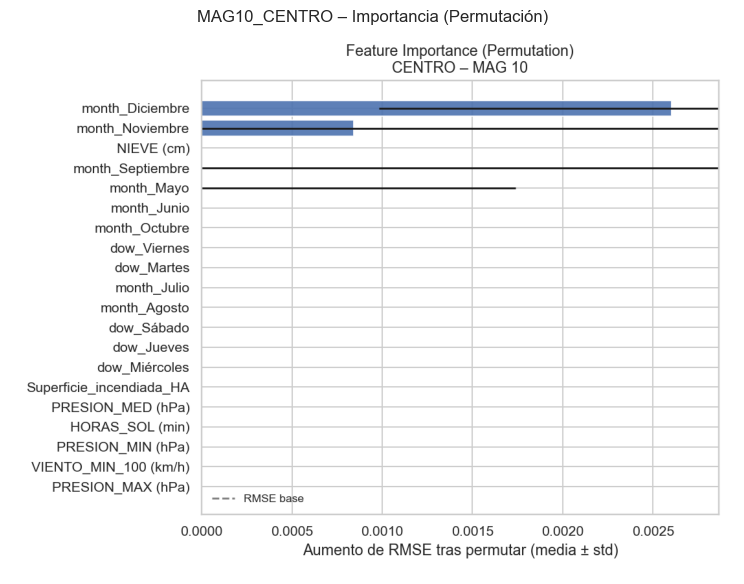

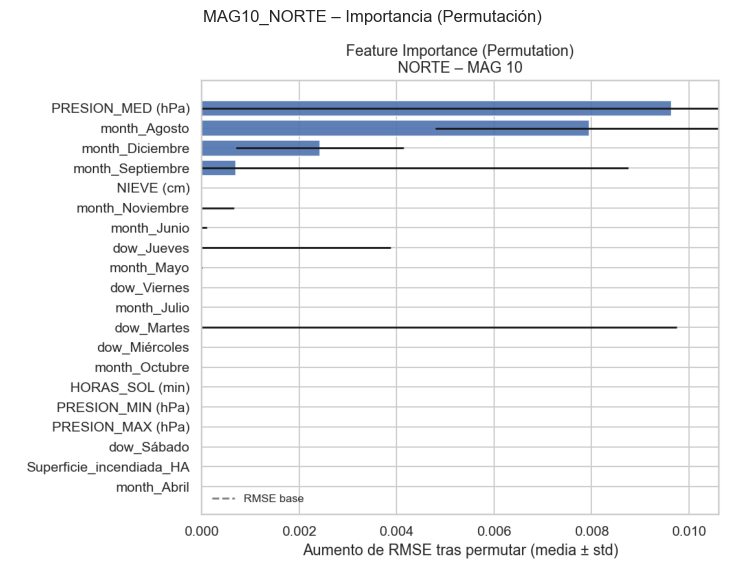

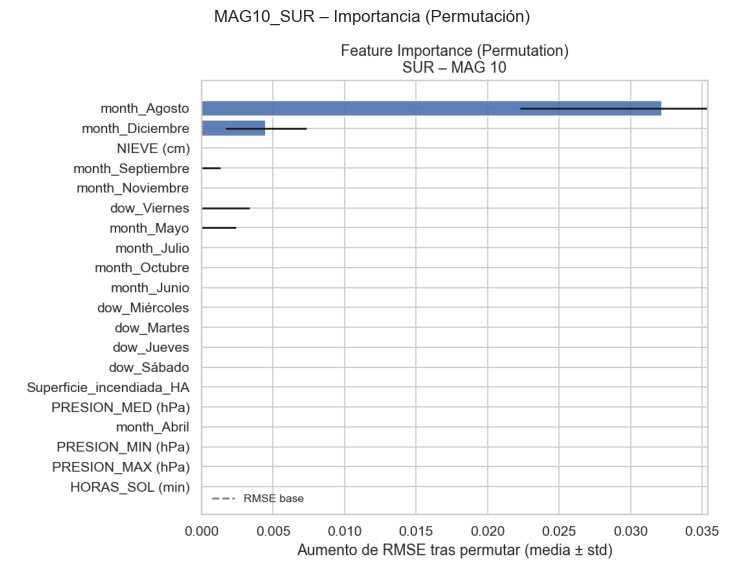

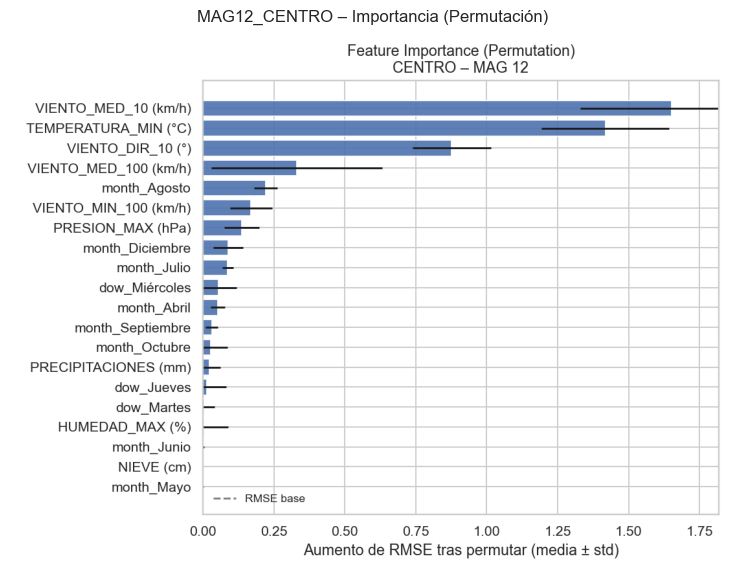

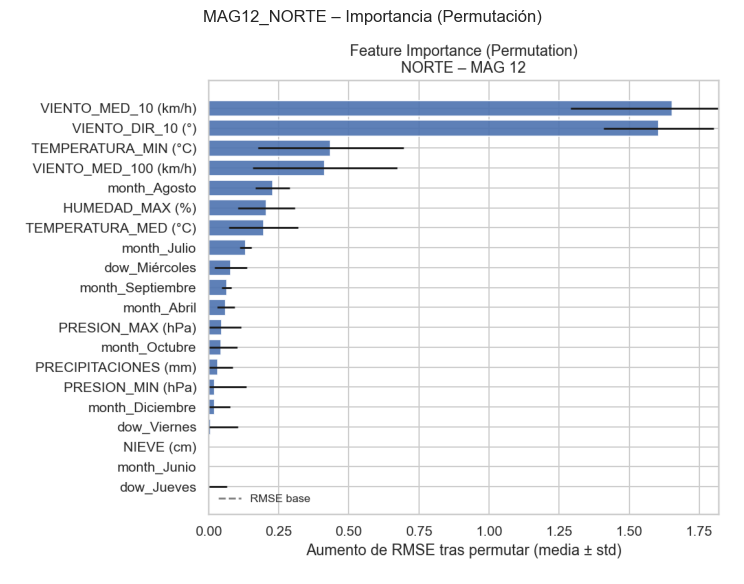

...

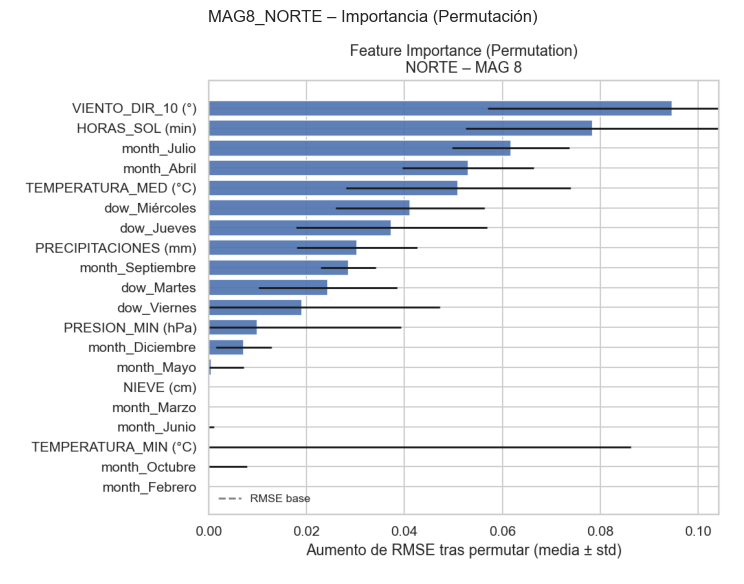

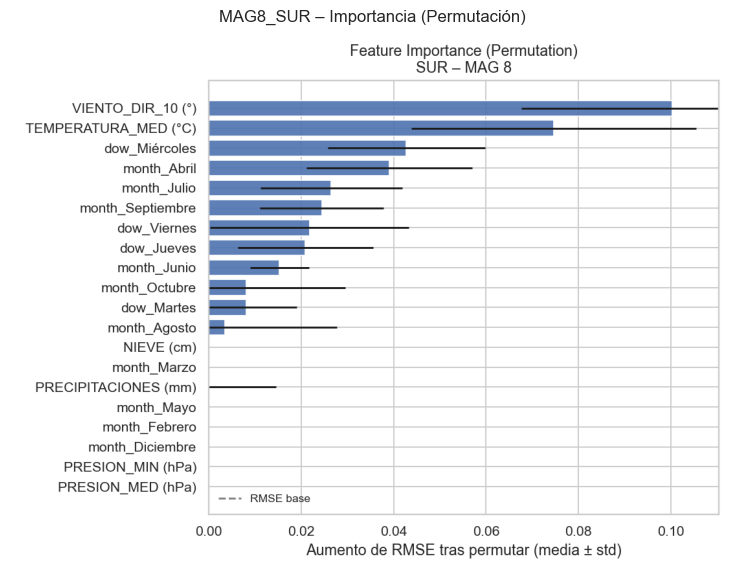

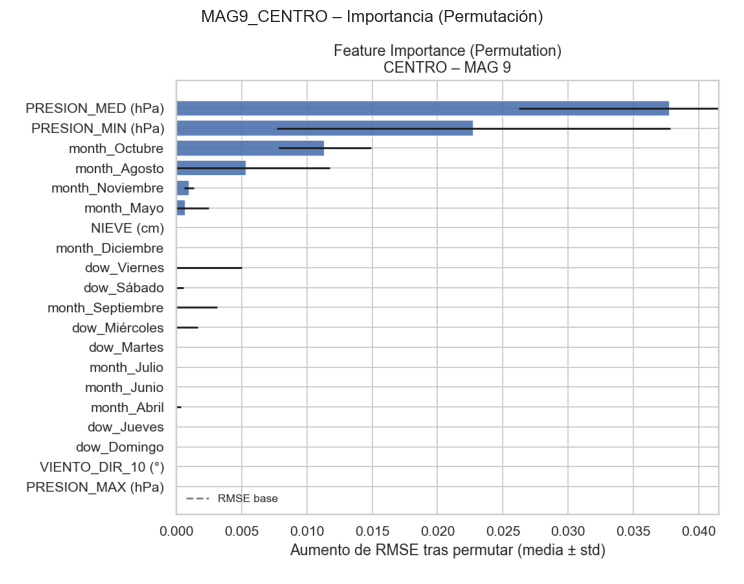

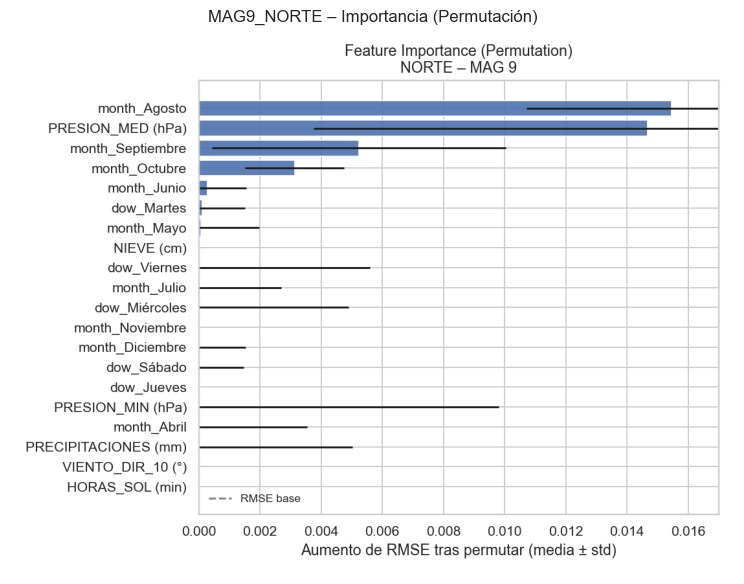

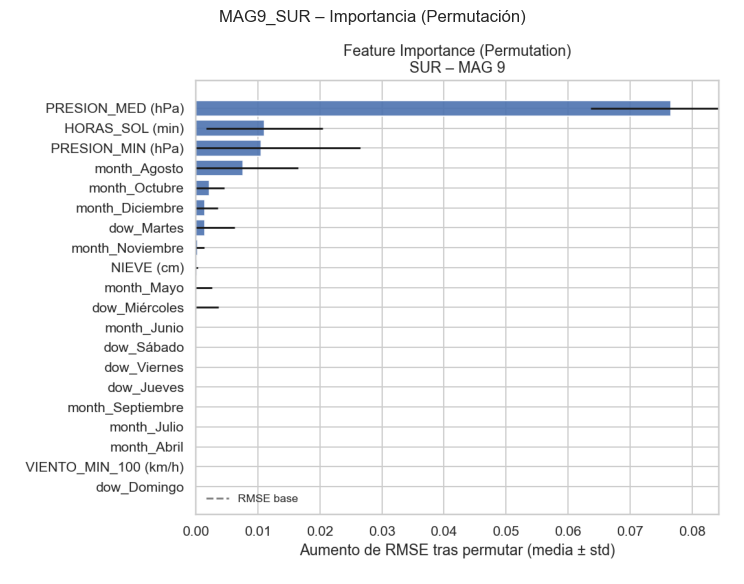

In [33]:
BASE_PATH = "06_EDA_resultados"

for folder in sorted(os.listdir(BASE_PATH)):
    folder_path = os.path.join(BASE_PATH, folder)
    if not os.path.isdir(folder_path):
        continue  # ignora ficheros sueltos

    img_path = os.path.join(folder_path, "ranking_importancias_permutacion.png")
    if os.path.exists(img_path):
        img = plt.imread(img_path)
        plt.figure(figsize=(8,6))
        plt.imshow(img)
        plt.axis("off")
        plt.title(f"{folder} – Importancia (Permutación)")
        plt.tight_layout()
        plt.show()
        

# CONCLUSIONES

## VALORES ESTADÍSTICOS

In [34]:
# === Configuración ===
base_path = "06_EDA_resultados"

MAGNITUD_NOM = {
    1: "Dióxido de Azufre",
    6: "Monóxido de Carbono",
    7: "Monóxido de Nitrógeno",
    8: "Dióxido de Nitrógeno",
    9: "Partículas < 2,5 μm",
    10: "Partículas < 10 μm",
    12: "Óxidos de Nitrógeno",
    14: "Ozono",
    20: "Tolueno",
    30: "Benceno",
    35: "Etilbenceno"
}

ZONAS = ["SUR", "CENTRO", "NORTE"]

# === Listar subcarpetas ===
folders = sorted([f for f in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, f))])
resumen_rows = []

# === Función para extraer magnitud de forma flexible ===
def extraer_magnitud(nombre):
    match = re.search(r"(\d{1,2}|\d{2})", nombre)
    if match:
        num = int(match.group(1))
        return num, MAGNITUD_NOM.get(num, "Desconocido")
    return None, None

# === Extraer estadísticas ===
for i, folder in enumerate(folders, start=1):
    path = os.path.join(base_path, folder)
    stats_path = os.path.join(path, "estadisticos.csv")

    zona_estacion = next((z for z in ZONAS if z in folder.upper()), None)
    magnitud_num, magnitud_nom = extraer_magnitud(folder)

    if os.path.exists(stats_path):
        desc = pd.read_csv(stats_path, index_col=0)
        if "MEDICION_ugm3" in desc.columns:
            row = {
                "COMBINACIÓN": i,
                "ZONA_ESTACIÓN": zona_estacion,
                "MAGNITUD - NUM": magnitud_num,
                "MAGNITUD - NOM": magnitud_nom,
                "VALOR MEDIO (µg/m³)": round(desc.loc["mean", "MEDICION_ugm3"], 2),
                "DESVIACIÓN TÍPICA": round(desc.loc["std", "MEDICION_ugm3"], 2),
                "VALOR MÍNIMO": round(desc.loc["min", "MEDICION_ugm3"], 2),
                "VALOR MÁXIMO": round(desc.loc["max", "MEDICION_ugm3"], 2),
                "MODA (PERCENTIL 50%)": round(desc.loc["50%", "MEDICION_ugm3"], 2),
                "PERCENTIL 25%": round(desc.loc["25%", "MEDICION_ugm3"], 2),
                "PERCENTIL 75%": round(desc.loc["75%", "MEDICION_ugm3"], 2)
            }
            resumen_rows.append(row)
        else:
            print(f"⚠️ No hay columna MEDICION_ugm3 en {folder}")
    else:
        print(f"⚠️ No se encontró estadisticos.csv en {folder}")

# === Crear tabla resumen ===
tabla_resumen = pd.DataFrame(resumen_rows)

# Ordenar por magnitud y zona
tabla_resumen_ordenada = tabla_resumen.sort_values(by="COMBINACIÓN").reset_index(drop=True)

# Mostrar
print("\n✅ Tabla resumen consolidada:\n")
display (tabla_resumen_ordenada)

# Guardar Excel
tabla_resumen_ordenada.to_excel("06_tabla_resumen_EDA_estadísticos.xlsx", index=False)



✅ Tabla resumen consolidada:



,COMBINACIÓN,ZONA_ESTACIÓN,MAGNITUD - NUM,MAGNITUD - NOM,VALOR MEDIO (µg/m³),DESVIACIÓN TÍPICA,VALOR MÍNIMO,VALOR MÁXIMO,MODA (PERCENTIL 50%),PERCENTIL 25%,PERCENTIL 75%
0,1,CENTRO,10,Partículas < 10 μm,19.73,12.50,2.67,299.33,17.33,11.67,24.67
1,2,NORTE,10,Partículas < 10 μm,20.63,13.07,1.67,381.67,18.33,12.67,25.67
2,3,SUR,10,Partículas < 10 μm,20.22,13.00,3.00,373.00,18.00,12.00,25.34
3,4,CENTRO,12,Óxidos de Nitrógeno,55.70,45.17,6.00,381.67,41.83,27.00,66.50
4,5,NORTE,12,Óxidos de Nitrógeno,62.27,48.68,6.28,434.69,48.61,30.44,75.73
5,6,SUR,12,Óxidos de Nitrógeno,61.38,57.06,5.83,418.50,40.33,25.83,73.21
6,7,CENTRO,14,Ozono,50.03,23.06,1.83,114.00,51.71,32.64,67.67
7,8,NORTE,14,Ozono,53.00,23.59,2.75,118.50,55.16,34.75,71.50
8,9,SUR,14,Ozono,48.85,23.49,1.75,109.25,51.00,30.75,66.96
9,10,CENTRO,1,Dióxido de Azufre,5.77,3.04,0.00,23.50,5.00,3.67,7.33


## CRITERIOS Y RESUMEN

Vamos a tratar de sacar una conclusión clara de los resultados obtenidos y para ello tomaremos los siguientes criterios tomados de la normativa vigente:

In [35]:
# 1) Leer la hoja "CRITERIOS"
df_criterios = pd.read_excel("90_Resumen EDA Resultados.xlsx", sheet_name="CRITERIOS", engine="openpyxl")

# 2) Limpieza suave de encabezados y strings
df_criterios.columns = df_criterios.columns.map(lambda c: str(c).strip())
for col in df_criterios.select_dtypes(include=["object"]).columns:
    df_criterios[col] = df_criterios[col].astype(str).str.strip()

# 3) Eliminar columna innecesaria
if "Unnamed: 6" in df_criterios.columns:
    df_criterios = df_criterios.drop(columns=["Unnamed: 6"])

# 4) Reemplazar '\\n' por saltos de línea reales '\n'
for col in df_criterios.select_dtypes(include=["object"]).columns:
    df_criterios[col] = df_criterios[col].str.replace(r"\\n", "\n", regex=True)

# 5) Rellenar valores faltantes hacia adelante en columnas clave
cols_ffill = ["MAGNITUD - NUM"]
df_criterios[cols_ffill] = df_criterios[cols_ffill].ffill()

# 6) Convertir MAGNITUD - NUM a tipo entero
df_criterios["MAGNITUD - NUM"] = df_criterios["MAGNITUD - NUM"].astype("Int64")

# 7) Mostrar tabla con saltos de línea visibles
pd.set_option('display.max_colwidth', None)
df_criterios.style.set_properties(**{'white-space': 'pre-wrap'})

,MAGNITUD - NUM,MAGNITUD - NOM,NORMATIVA,SALUD HUMANA - LÍMITE (µg/m³),VEGETACIÓN - LÍMITE (µg/m³),UMBRAL ALERTA (µg/m³),CONCLUSIONES
0,10,Partículas < 10 μm,Directiva 2008/50/CE ANEXO XI,50 (diario) 40 (anual),-,-,-
1,10,Partículas < 10 μm,Real Decreto 102/2011,50 (diario) 40 (anual),-,80 (diario),Valores máximos superiores al umbral de alerta.
2,10,Partículas < 10 μm,Guía OMS,45 (diario) 15 (anual),-,-,"En términos de valores anuales, en este 2025 se esperan registros por encima de lo recomendado por la OMS"
3,12,Óxidos de Nitrógeno,Directiva 2008/50/CE ANEXO XI,-,30,-,Este componente afecta principalmente a las zonas rurales. Muchos días se superan los valores de protección de la vegetación. No creo que sea de estudio puesto que se analiza zona urbana
4,12,Óxidos de Nitrógeno,Real Decreto 102/2011,-,30,-,Este componente afecta principalmente a las zonas rurales. Muchos días se superan los valores de protección de la vegetación. No creo que sea de estudio puesto que se analiza zona urbana
5,12,Óxidos de Nitrógeno,Guía OMS,-,-,-,-
6,14,Ozono,Directiva 2008/50/CE ANEXO VII,120,-,240,Evolución ascendente
7,14,Ozono,Real Decreto 102/2011,120,-,240,Evolución ascendente
8,14,Ozono,Guía OMS,60,-,-,"Valores máximos y percentiles 75% por encima de valores recomendados por la OMS. Además, evolución ascendente"
9,1,Dióxido de Azufre,Directiva 2008/50/CE ANEXO XI,125 (diario),20 (año civil e invierno - 01/10 - 31/03-),500,Nada interesante que estudiar


En base a los criterios anteriores, se han sacado las siguientes conslusiones

In [36]:
# 1) Leer la hoja "CONCLUSIONES"
df_conclusiones = pd.read_excel("90_Resumen EDA Resultados.xlsx", sheet_name="CONCLUSIONES", engine="openpyxl")

# 2) Limpieza suave de encabezados y strings
df_conclusiones.columns = df_conclusiones.columns.map(lambda c: str(c).strip())
for col in df_conclusiones.select_dtypes(include=["object"]).columns:
    df_conclusiones[col] = df_conclusiones[col].astype(str).str.strip()

# 3) Reemplazar '\\n' por saltos de línea reales '\n'
for col in df_conclusiones.select_dtypes(include=["object"]).columns:
    df_conclusiones[col] = df_conclusiones[col].str.replace(r"\\n", "\n", regex=True)

# 4) Convertir MAGNITUD - NUM a tipo entero nulo-compatible
df_conclusiones["MAGNITUD - NUM"] = df_conclusiones["MAGNITUD - NUM"].astype("Int64")

# 5) Mostrar tabla con estilo aplicado y saltos de línea visibles
pd.set_option('display.max_colwidth', None)
df_conclusiones.style.apply(resaltar_columnas_rojas, axis=1).set_properties(**{'white-space': 'pre-wrap'})


,COMBINACIÓN,ZONA_ESTACIÓN,MAGNITUD - NUM,MAGNITUD - NOM,VALOR MEDIO (µg/m³),DESVIACIÓN TÍPICA,VALOR MÍNIMO,VALOR MÁXIMO,MODA (PERCENTIL 50%),PERCENTIL 25%,PERCENTIL 75%,DISTRIBUCIÓN,BOXPLOT - MENSUAL,BOXPLOT - DIARIO,TENDENCIA GENERAL,VALORES 2025 (µg/m³),TOP 3 - VARIABLE MAYOR CORRELACIÓN,TOP 3 - VARIABLE MÁS IMPORTANTE - TEORÍA DE JUEGOS,TOP 3 - VARIABLE MÁS IMPORTANTE - RMSE
0,1,CENTRO,10,Partículas < 10 μm,Supera el límite recomendado por la OMS,Alta,Bajo/Saludable,Muy alto/Supera umbral de alerta,Supera el límite recomendado por la OMS,Bajo/Saludable,Supera el límite recomendado por la OMS,Asimétrica Pos,"Verano alto, resto bajo",Ausencia de patrón semanal,Descenso hasta 2017/Estabilización posterior,~18–20 µg/m³,1. Temperatura 2. Viento - 100m 3. Horas de sol / Viento 10m,1. Mes - marzo 2. Mes - febrero 3. Día semana - domingo,1. Presión media 2. Mes - diciembre 2. Mes - junio
1,2,NORTE,10,Partículas < 10 μm,Supera el límite recomendado por la OMS,Alta,Bajo/Saludable,Muy alto/Supera umbral de alerta,Supera el límite recomendado por la OMS,Bajo/Saludable,Supera el límite recomendado por la OMS,Asimétrica Pos,"Verano alto, resto bajo",Ligera disminución fin de semana,Descenso hasta 2014/Estabilización posterior,~17–19 µg/m³,1. Viento 100m 2. Viento 10m / Temperatura 3. %Nubes,1. Mes - marzo 2. Día semana - domingo 3. Mes - febrero,1. Mes - agosto 2. Mes - diciembre 3. Nieve
2,3,SUR,10,Partículas < 10 μm,Supera el límite recomendado por la OMS,Alta,Bajo/Saludable,Muy alto/Supera umbral de alerta,Supera el límite recomendado por la OMS,Bajo/Saludable,Supera el límite recomendado por la OMS,Asimétrica Pos,"Verano alto, resto bajo",Ligera disminución fin de semana,Descenso hasta 2014/Estabilización posterior,~18–19 µg/m³,1. Viento - 100m 2. Viento 10m 3. Temperatura,1. Mes - marzo 2. Día semana - domingo 3. Mes - febrero,1. Mes - agosto 2. Mes - octubre 3. Mes - diciembre
3,4,CENTRO,12,Óxidos de Nitrógeno,Alto/Supera VL vegetación,Muy alta,Bajo,Muy alto/Supera VL vegetación,Alto/Supera VL vegetación,Moderado,Alto/Supera VL vegetación,Asimétrica Pos,"Invierno alto, verano bajo",Disminución fin de semana,Descenso sostenido,~30 µg/m³,Presión,1. Día semana - domingo 2. Día semana - sábado 3. Superficie incendiada,1. Viento medio - 10 m 2. Temperatura mínima 3. Dirección viento - 10 m
4,5,NORTE,12,Óxidos de Nitrógeno,Alto/Supera VL vegetación,Muy alta,Bajo,Muy alto/Supera VL vegetación,Alto/Supera VL vegetación,Alto/Supera VL vegetación,Alto/Supera VL vegetación,Asimétrica Pos,"Invierno alto, verano bajo",Disminución fin de semana,Descenso sostenido,~38 µg/m³,Presión,1. Día semana - domingo 2. Día semana - sábado 3. Superficie incendiada,1. Dirección viento - 10 m 2. Temperatura media 3. Viento medio - 10m
5,6,SUR,12,Óxidos de Nitrógeno,Alto/Supera VL vegetación,Muy alta,Bajo,Muy alto/Supera VL vegetación,Alto/Supera VL vegetación,Moderado,Alto/Supera VL vegetación,Asimétrica Pos,"Invierno alto, verano bajo",Disminución fin de semana,Descenso sostenido,~40 µg/m³,Presión,1. Día semana - domingo 2. Día semana - sábado 3. Superficie incendiada,1. Temperatura media 2. Viento medio - 10m 3. Dirección viento - 10 m
6,7,CENTRO,14,Ozono,Bajo/Saludable,Moderada,Bajo/Saludable,Alto/Supera valor recomendado OMS,Bajo/Saludable,Bajo/Saludable,Alto/Supera valor recomendado OMS,Asimétrica Pos,"Verano alto, invierno bajo",Aumento fin de semana,Ascenso sostenido,~55–60 µg/m³,1. Radiación Solar 2. Temperatura / Humedad 3. Horas de Sol,1. Día semana - domingo 2. Dia semana - abril 3. Mes - abril,1. Mes - agosto 2. Mes - junio 3. Dirección viento - 10 m
7,8,NORTE,14,Ozono,Bajo/Saludable,Moderada,Bajo/Saludable,Alto/Supera valor recomendado OMS,Bajo/Saludable,Bajo/Saludable,Alto/Supera valor recomendado OMS,Asimétrica Pos,"Verano alto, invierno bajo",Ligero aumento fin de semana,Ligero asceso sostenido,~56–58 µg/m³,1. Radiación Solar 2. Humedad 3. Temperatura,1. Día semana - domingo 2. Dia semana - abril 3. Mes - abril,1. Viento máximo 100m 2.Mes - ag

A partir de los resultados obtenidos y los límites establecidos por la normativa vigente (Directiva 2008/50/CE, Real Decreto 102/2011 y Guías OMS), se concluye que las magnitudes que presentan un riesgo significativo para la salud humana en el entorno urbano de Madrid son: **partículas < 10 μm**, **partículas < 2,5 μm**, **ozono** y **dióxido de nitrógeno**. Estas sustancias superan de forma recurrente los valores límite o recomendados, ya sea en términos de medias anuales, percentiles altos o umbrales de alerta, y muestran además tendencias sostenidas o ascendentes en las tres zonas analizadas (norte, centro y sur). En cambio, otras magnitudes como dióxido de azufre, monóxido de carbono, tolueno, benceno, etilbenceno y óxidos de nitrógeno presentan valores bajos o están vinculadas a criterios de protección vegetal en zonas rurales, por lo que se consideran no prioritarias en este estudio. Por tanto, el análisis se centrará en la evolución futura de las magnitudes críticas en las distintas zonas de la ciudad, en línea con los objetivos del PNIEC 2023–2030 y la Agenda 2030, que promueven la mejora de la calidad del aire y la protección de la salud pública en entornos urbanos.

## EXPORTACIÓN SUB-DATAFRAMES PARA ESTUDIO

In [37]:
for var in ["8", "9", "10", "14"]:
    for zona in ["NORTE", "SUR", "CENTRO"]:
        nombre_archivo = f"06_dfs_mag_zona_{var}_{zona}.parquet"
        dfs_mag_zona[(var, zona)].to_parquet(nombre_archivo, index=False)